In [1]:
import os
import sys
import pickle
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from scipy.linalg import block_diag

module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = os.path.abspath(os.path.join('../../data'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from dynamics import Dynamics
from utils import get_form_initial_conditions
from gauss_newton import GaussNewton

In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
K = 395  # Duration [min]
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6 
n_p = 3  
n = N * n_x
o = 3 + 3 + 2 + 1 
H = 40 # Window size [min]
invalid_rmse = 1e20 # [m]
grad_norm_order_mag = True
grad_norm_tol = 1e-6
max_iterations = 20
dyn = Dynamics()

In [4]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P_0 = np.diag(np.concatenate([p_pos_initial * np.ones(3), p_vel_initial * np.ones(3)])) ** 2
P_0 = block_diag(P_0, P_0, P_0, P_0)

In [5]:
def plots(k, algorithm_class):
    iterations = np.arange(0, algorithm_class.iterations + 1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot 1
    axs[0].semilogy(iterations, 1 / H * np.array(algorithm_class.cost_values), '.-')
    axs[0].set_xlabel(r'$n$')
    axs[0].set_ylabel(r'$\frac{1}{H}J(x_n)$')
    axs[0].set_title('Normalized Cost Function') 
    axs[0].grid()

    # Plot 2
    axs[1].semilogy(iterations, 1 / H * np.array(algorithm_class.gradient_norm_values), '.-')
    axs[1].set_xlabel(r'$n$')
    axs[1].set_ylabel(r'$\frac{1}{H}||\nabla J(x_n)||_2$')
    axs[1].set_title('Normalized Gradient Norm')
    axs[1].grid()
    
    fig.suptitle(f'Solving MHE problem J(k) with k = {k}', fontsize=14)

    plt.tight_layout()
    plt.show()

In [6]:
# Seed for reproducibility
np.random.seed(42)

# Initial conditions for the state vector and true state vectors
X_initial = get_form_initial_conditions(formation)
with open(f"../../data/tudatpy_form{formation}.pkl", "rb") as file:
    X_true = pickle.load(file)[:, :, :K]

# Initial position estimation error
X_est = np.zeros_like(X_true)
X_est[:, :, 0] = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))
for k in range(K - 1):
    X_est[:, :, k + 1] = dyn.f(dt, X_est[:, :, k])
position_estimation_error_1_initial, position_estimation_error_2_initial, position_estimation_error_3_initial, position_estimation_error_4_initial = position_estimation_error(X_est, X_true)

# Algorithm class to use
centralized_newton = GaussNewton(H, K, o, R, grad_norm_order_mag, grad_norm_tol, max_iterations)

# Observations
Y = np.zeros((o, 1, K))
for k in range(K):
    Y[:, :, k] = centralized_newton.h(X_true[:, :, k]) + np.random.multivariate_normal(np.zeros(o), R).reshape((o, 1))

Windows:   0%|          | 0/356 [00:00<?, ?it/s]

[Gauss-Newton] Before applying the algorithm
Cost function: 998110869.0892698
Gradient norm: 8254408024.207337
Global estimation error: 429.50490519551005
Initial conditions estimation errors: 272.4697073631671 m, 173.20827048054102 m, 227.7797328342984 m, 168.37460816595575 m
Position estimation errors: 1405.0539065424978 m, 2008.6366571551264 m, 678.1566618990299 m, 490.97414016933897 m

[Gauss-Newton] Iteration 1
Cost function: 807720.5871188573 (-99.92%)
Gradient norm: 2522997.0124705583 (-99.97%)
Global estimation error: 149.0509952769829 (-65.30%)
Initial conditions estimation errors: 44.306253342914914 m, 104.54979490756646 m, 81.81212720376443 m, 51.27521161496645 m
Position estimation errors: 30.915962006847174 m, 24.31953193319905 m, 103.7834691491506 m, 97.36215898146163 m

[Gauss-Newton] Iteration 2
Cost function: 780443.6802562606 (-3.38%)
Gradient norm: 24565.0465473325 (-99.03%)
Global estimation error: 79.59185177942439 (-46.60%)
Initial conditions estimation errors: 44

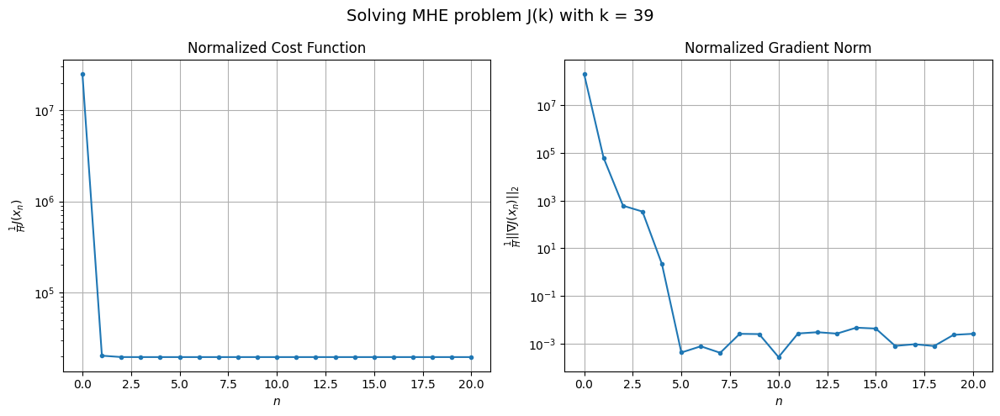

Windows:   0%|          | 1/356 [00:22<2:14:06, 22.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 738202.695167083
Gradient norm: 11299670.614962542
Global estimation error: 74.32197477134049
Initial conditions estimation errors: 37.90823232404665 m, 36.9789846466594 m, 37.179600404381254 m, 36.56327771348936 m
Position estimation errors: 33.477678394086155 m, 35.68863939553549 m, 34.42904631323361 m, 34.83851339916938 m

[Gauss-Newton] Iteration 1
Cost function: 717699.2946681331 (-2.78%)
Gradient norm: 42.733443799144894 (-100.00%)
Global estimation error: 83.78936119304635 (12.74%)
Initial conditions estimation errors: 43.26611529721087 m, 42.32883856770564 m, 41.2595832346162 m, 40.67590156455442 m
Position estimation errors: 28.903818878304012 m, 31.208897768080142 m, 30.698209331646954 m, 31.330801312032218 m

[Gauss-Newton] Iteration 2
Cost function: 717699.2946018836 (-0.00%)
Gradient norm: 0.060847748362583144 (-99.86%)
Global estimation error: 83.78295416494079 (-0.01%)
Initial conditions estimation errors: 43.26

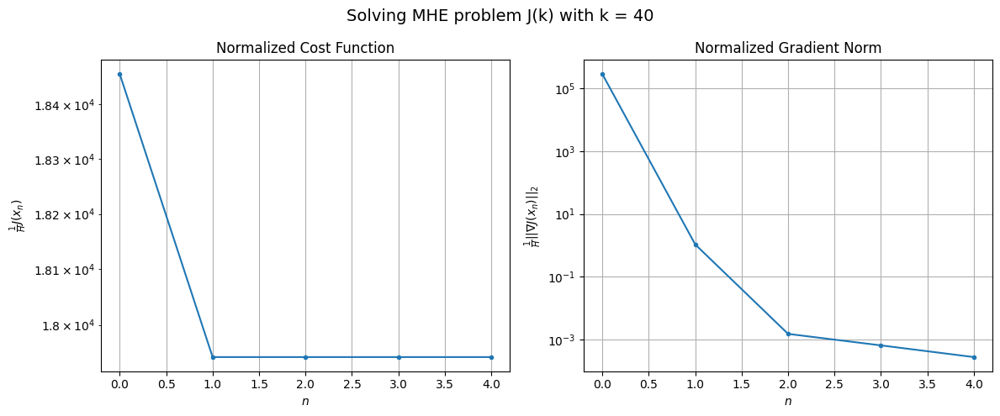

Windows:   1%|          | 2/356 [00:28<1:14:40, 12.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 674338.4701826333
Gradient norm: 11354401.443932947
Global estimation error: 71.15231250032289
Initial conditions estimation errors: 37.098972542487864 m, 36.23745372984756 m, 34.95143861316187 m, 33.93363722527912 m
Position estimation errors: 31.498754303977393 m, 33.66495596069071 m, 33.37446141262835 m, 34.05323199351295 m

[Gauss-Newton] Iteration 1
Cost function: 655616.0913573533 (-2.78%)
Gradient norm: 92.04090290656549 (-100.00%)
Global estimation error: 85.15755887368243 (19.68%)
Initial conditions estimation errors: 42.06580632432713 m, 41.72034976647435 m, 43.348075177365246 m, 43.1573731568828 m
Position estimation errors: 26.998018745656942 m, 28.88982991361614 m, 27.150372228471042 m, 27.209522005508795 m

[Gauss-Newton] Iteration 2
Cost function: 655616.0908370599 (-0.00%)
Gradient norm: 0.035927059984318076 (-99.96%)
Global estimation error: 85.13588395492347 (-0.03%)
Initial conditions estimation errors: 42.0

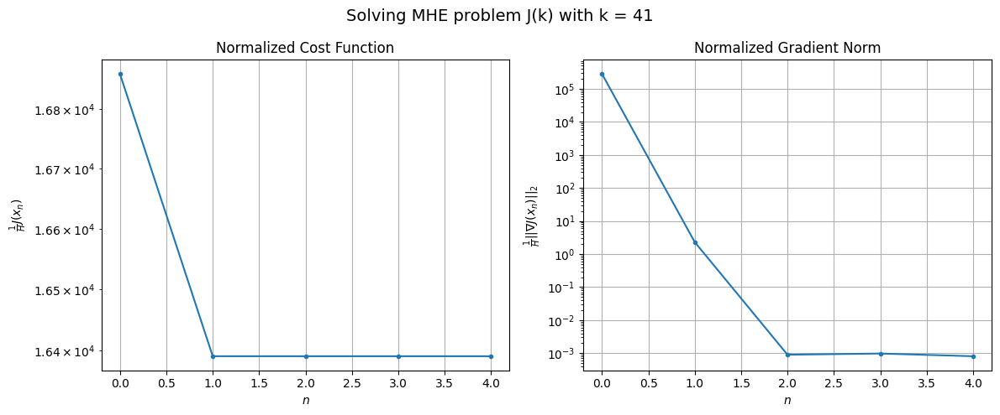

Windows:   1%|          | 3/356 [00:34<57:27,  9.77s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 610476.537111833
Gradient norm: 11300213.209921308
Global estimation error: 73.11555243532803
Initial conditions estimation errors: 36.10960467362437 m, 35.83458289967781 m, 37.179146757201174 m, 37.08792612764798 m
Position estimation errors: 29.704313967766783 m, 31.59877510960313 m, 30.016236319256258 m, 29.944490252866018 m

[Gauss-Newton] Iteration 1
Cost function: 593514.7348465687 (-2.78%)
Gradient norm: 65.98580932226741 (-100.00%)
Global estimation error: 81.075802475731 (10.89%)
Initial conditions estimation errors: 40.71696282804771 m, 39.12316870241131 m, 42.25520287983004 m, 39.99033613017985 m
Position estimation errors: 25.315222792496858 m, 28.265748162602225 m, 26.221078865439598 m, 26.299259053337348 m

[Gauss-Newton] Iteration 2
Cost function: 593514.7346773298 (-0.00%)
Gradient norm: 0.009729783952618866 (-99.99%)
Global estimation error: 81.05671199884061 (-0.02%)
Initial conditions estimation errors: 40.7

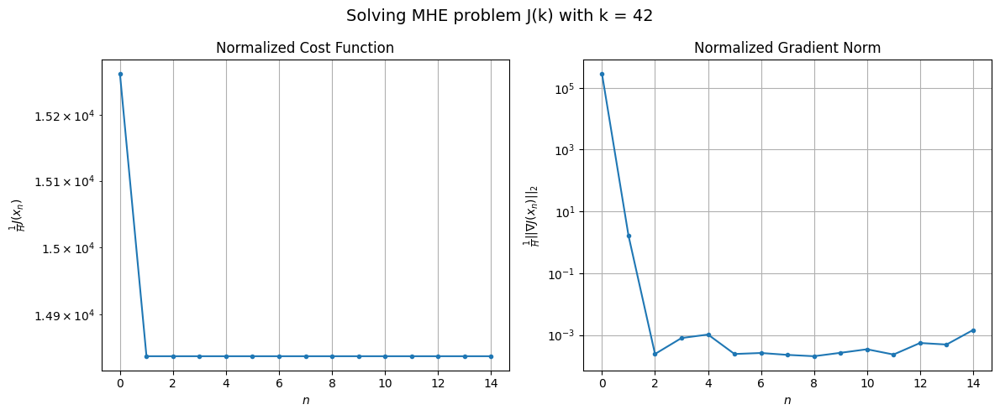

Windows:   1%|          | 4/356 [00:51<1:12:36, 12.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 550000.2356311956
Gradient norm: 11107440.502002412
Global estimation error: 69.67016534178146
Initial conditions estimation errors: 34.96049194334712 m, 33.44367368644747 m, 36.19615522333193 m, 34.6843578156065 m
Position estimation errors: 28.175282365762296 m, 31.085628590870265 m, 29.11993698691432 m, 29.09710890005486 m

[Gauss-Newton] Iteration 1
Cost function: 534783.3223363954 (-2.77%)
Gradient norm: 40.31520967322686 (-100.00%)
Global estimation error: 77.22881536568 (10.85%)
Initial conditions estimation errors: 39.236000882292196 m, 38.029621427222054 m, 39.36202313844014 m, 37.804125875183196 m
Position estimation errors: 23.943049521230694 m, 26.325836175747135 m, 24.753362613225413 m, 24.930259913402445 m

[Gauss-Newton] Iteration 2
Cost function: 534783.322319779 (-0.00%)
Gradient norm: 0.04049808437697795 (-99.90%)
Global estimation error: 77.23161264279773 (0.00%)
Initial conditions estimation errors: 39.2360

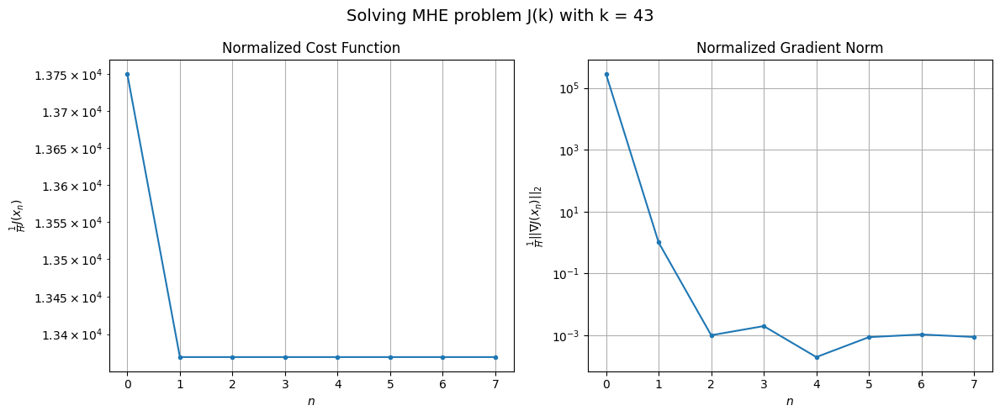

Windows:   1%|▏         | 5/356 [01:00<1:05:31, 11.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 494437.7630755531
Gradient norm: 11085696.077156637
Global estimation error: 66.30060822724171
Initial conditions estimation errors: 33.65873017011367 m, 32.60104593187911 m, 33.71020195214264 m, 32.6130530047505 m
Position estimation errors: 26.94970031478191 m, 29.20180229059594 m, 27.761064839419078 m, 27.867163371993296 m

[Gauss-Newton] Iteration 1
Cost function: 480618.7367681996 (-2.79%)
Gradient norm: 181.6853252154957 (-100.00%)
Global estimation error: 70.51811765716603 (6.36%)
Initial conditions estimation errors: 37.6592764315842 m, 35.16497502846159 m, 35.93424212327221 m, 32.04204781608157 m
Position estimation errors: 22.849714700473683 m, 26.687914789047284 m, 24.189588298519514 m, 23.850356255313248 m

[Gauss-Newton] Iteration 2
Cost function: 480618.7353720596 (-0.00%)
Gradient norm: 0.035044063343394126 (-99.98%)
Global estimation error: 70.49761374475217 (-0.03%)
Initial conditions estimation errors: 37.659

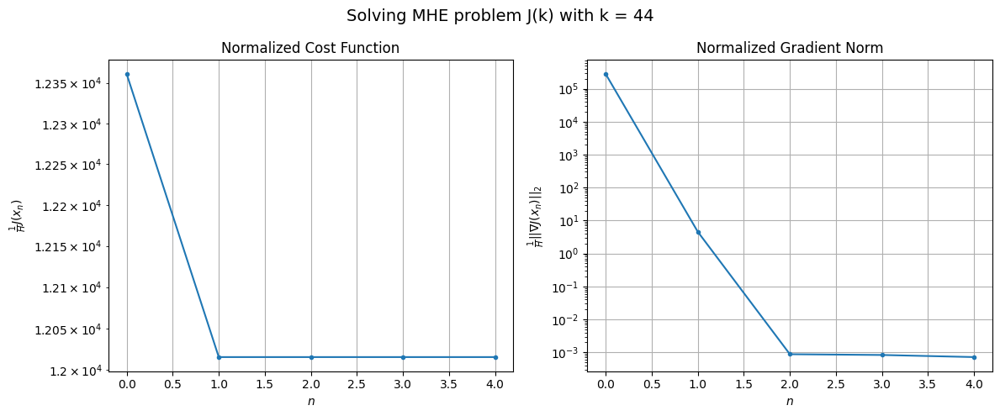

Windows:   2%|▏         | 6/356 [01:06<56:06,  9.62s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 442920.1676706304
Gradient norm: 10741162.028213302
Global estimation error: 60.02160206978526
Initial conditions estimation errors: 32.23850941848049 m, 29.93371232517988 m, 30.13354660177767 m, 27.553132802163432 m
Position estimation errors: 25.946429303986704 m, 29.587160206297934 m, 27.429285428289653 m, 26.990111865909036 m

[Gauss-Newton] Iteration 1
Cost function: 430400.13133147865 (-2.83%)
Gradient norm: 38.8198415789379 (-100.00%)
Global estimation error: 68.46995045512512 (14.08%)
Initial conditions estimation errors: 36.00244954351196 m, 34.26324144437486 m, 34.68884020720373 m, 31.853284422024682 m
Position estimation errors: 22.006810370866013 m, 24.78715958143134 m, 23.13892971165261 m, 22.72624007352885 m

[Gauss-Newton] Iteration 2
Cost function: 430400.13132171985 (-0.00%)
Gradient norm: 0.12619329718713115 (-99.67%)
Global estimation error: 68.4684069442189 (-0.00%)
Initial conditions estimation errors: 36.

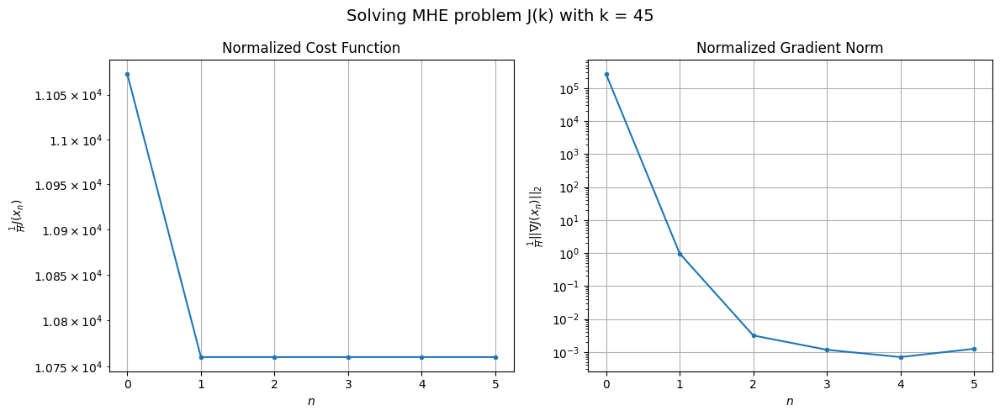

Windows:   2%|▏         | 7/356 [01:14<52:07,  8.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 396828.521054186
Gradient norm: 10754083.873547409
Global estimation error: 58.13135600022171
Initial conditions estimation errors: 30.71720783677034 m, 29.176788348755615 m, 29.11174648003186 m, 27.14579537848658 m
Position estimation errors: 25.129379456115128 m, 27.641034518062234 m, 26.37306536167487 m, 25.845645777397177 m

[Gauss-Newton] Iteration 1
Cost function: 385258.44868271437 (-2.92%)
Gradient norm: 210.47465147807017 (-100.00%)
Global estimation error: 60.23176267446097 (3.61%)
Initial conditions estimation errors: 34.28955054891446 m, 32.84966684797434 m, 27.87429540952492 m, 24.4126591967759 m
Position estimation errors: 21.292065232385525 m, 24.283857985523316 m, 23.99448514285078 m, 23.76257477034651 m

[Gauss-Newton] Iteration 2
Cost function: 385258.4478857141 (-0.00%)
Gradient norm: 0.021692898266689433 (-99.99%)
Global estimation error: 60.23190361596701 (0.00%)
Initial conditions estimation errors: 34.28

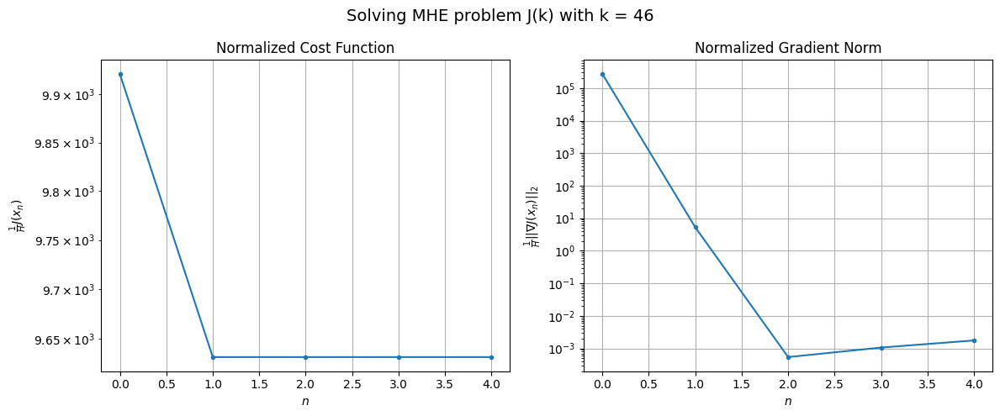

Windows:   2%|▏         | 8/356 [01:20<47:47,  8.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 356150.5885738256
Gradient norm: 10422533.584677875
Global estimation error: 50.2576672209918
Initial conditions estimation errors: 29.107934181089714 m, 27.942538402661853 m, 22.485619540889616 m, 19.802522950257302 m
Position estimation errors: 24.37859202953171 m, 27.046926951339277 m, 27.338449013593195 m, 27.293288780511137 m

[Gauss-Newton] Iteration 1
Cost function: 345609.23089396796 (-2.96%)
Gradient norm: 23.13932542129006 (-100.00%)
Global estimation error: 57.10191589172574 (13.62%)
Initial conditions estimation errors: 32.49252656081783 m, 31.364604800461194 m, 25.95363084279698 m, 23.398730363814156 m
Position estimation errors: 20.68348157272205 m, 23.518630428690596 m, 22.963538237189727 m, 22.518739770436156 m

[Gauss-Newton] Iteration 2
Cost function: 345609.2308815133 (-0.00%)
Gradient norm: 0.009310348874145493 (-99.96%)
Global estimation error: 57.10946031060996 (0.01%)
Initial conditions estimation errors

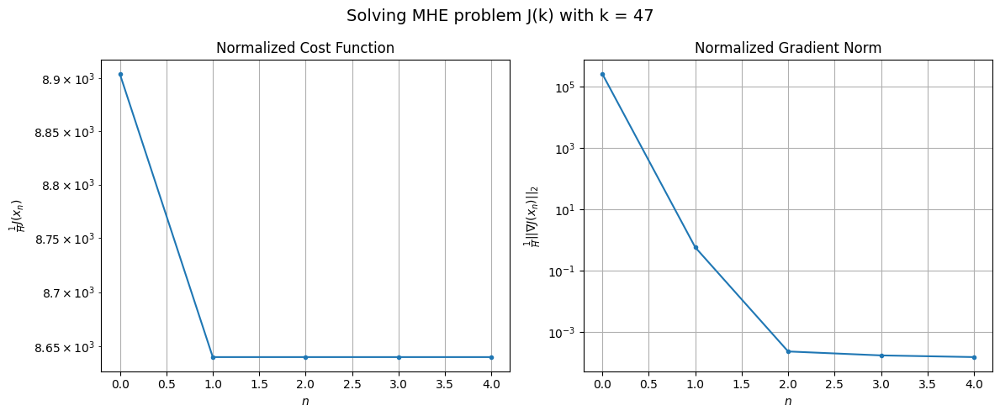

Windows:   3%|▎         | 9/356 [01:27<45:03,  7.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 320612.727089345
Gradient norm: 10238737.001690352
Global estimation error: 47.266500136735026
Initial conditions estimation errors: 27.374703547219347 m, 26.545335248296933 m, 20.684551002976676 m, 18.767267912063012 m
Position estimation errors: 23.690378350480746 m, 26.215489535892495 m, 26.278230274912794 m, 25.996358695523245 m

[Gauss-Newton] Iteration 1
Cost function: 310933.2453122394 (-3.02%)
Gradient norm: 32.510929152157644 (-100.00%)
Global estimation error: 55.189465530198575 (16.76%)
Initial conditions estimation errors: 30.589007462320744 m, 29.389297173463415 m, 25.77532995196104 m, 24.125891936317366 m
Position estimation errors: 20.113438973405955 m, 22.96498743323077 m, 21.968580704429055 m, 21.26665618742523 m

[Gauss-Newton] Iteration 2
Cost function: 310933.2452945146 (-0.00%)
Gradient norm: 0.05282073054540812 (-99.84%)
Global estimation error: 55.19976980086443 (0.02%)
Initial conditions estimation erro

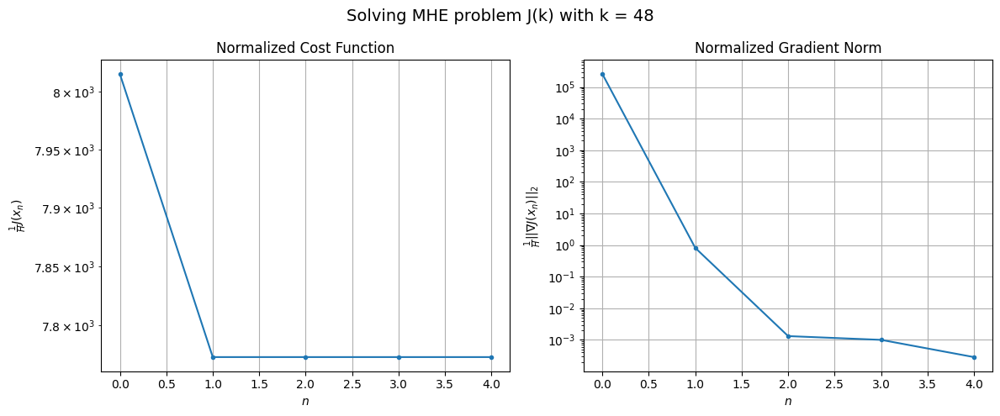

Windows:   3%|▎         | 10/356 [01:34<42:28,  7.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 291065.62589756836
Gradient norm: 10052468.95362326
Global estimation error: 45.50740051654846
Initial conditions estimation errors: 25.51225253189708 m, 24.606219106914182 m, 20.52566212145004 m, 19.830508458512284 m
Position estimation errors: 22.997370673072012 m, 25.57687156626602 m, 25.13163320806888 m, 24.392553714279245 m

[Gauss-Newton] Iteration 1
Cost function: 282160.124017807 (-3.06%)
Gradient norm: 236.85687241989925 (-100.00%)
Global estimation error: 54.57802971891999 (19.93%)
Initial conditions estimation errors: 28.564952818203494 m, 27.790276059252953 m, 26.901782410435548 m, 25.82186607539247 m
Position estimation errors: 19.53200697042186 m, 21.703421408353822 m, 21.856623684655123 m, 21.594664327413934 m

[Gauss-Newton] Iteration 2
Cost function: 282160.1236673301 (-0.00%)
Gradient norm: 0.06997569038708884 (-99.97%)
Global estimation error: 54.589692311411646 (0.02%)
Initial conditions estimation errors: 

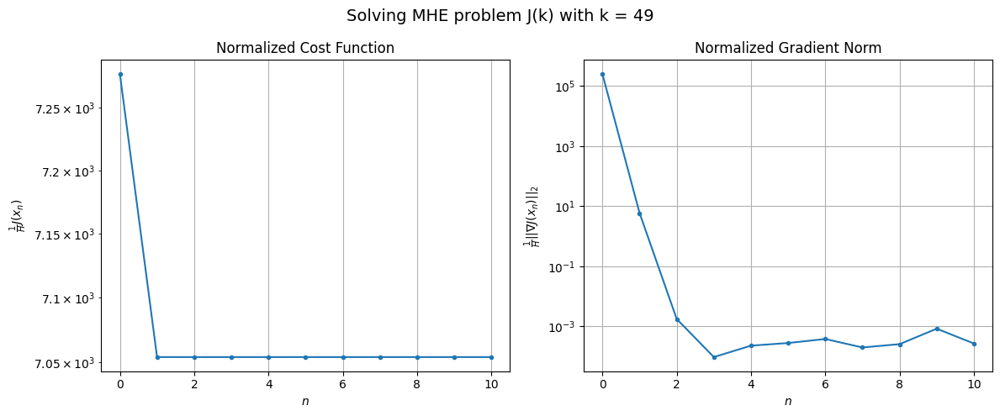

Windows:   3%|▎         | 11/356 [01:47<52:00,  9.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 265914.26335520553
Gradient norm: 9345380.894056333
Global estimation error: 44.96421799134788
Initial conditions estimation errors: 23.55940234227201 m, 23.032540898434213 m, 21.883981283813423 m, 21.38459159219649 m
Position estimation errors: 22.266588617817156 m, 24.278837979587376 m, 24.62845415016691 m, 24.286735865921578 m

[Gauss-Newton] Iteration 1
Cost function: 257974.10891872534 (-2.99%)
Gradient norm: 44.606784893554874 (-100.00%)
Global estimation error: 54.30322803778174 (20.77%)
Initial conditions estimation errors: 26.43078473496401 m, 26.43451780706109 m, 27.558029383284016 m, 28.142433993591872 m
Position estimation errors: 18.985298022473746 m, 20.150989464627905 m, 19.196367499160186 m, 18.05494604646877 m

[Gauss-Newton] Iteration 2
Cost function: 257974.1088738818 (-0.00%)
Gradient norm: 0.022481740678421003 (-99.95%)
Global estimation error: 54.30674568702282 (0.01%)
Initial conditions estimation errors

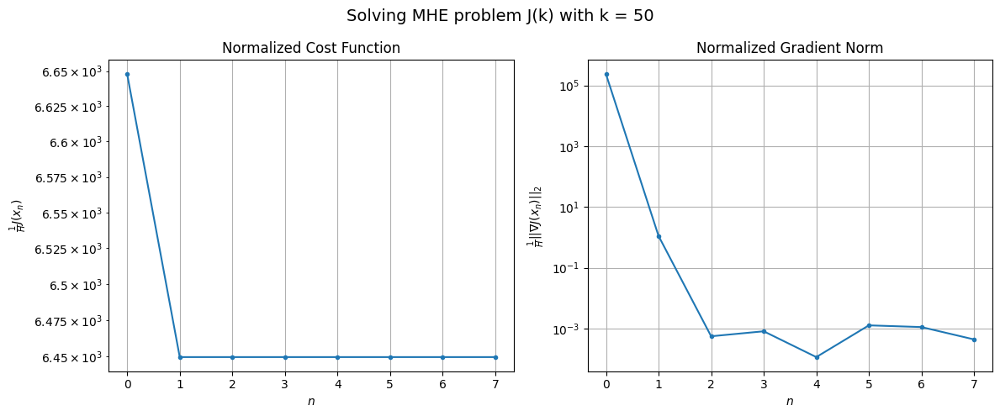

Windows:   3%|▎         | 12/356 [01:56<53:00,  9.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 245957.06092729987
Gradient norm: 8998206.061183592
Global estimation error: 45.1297947247698
Initial conditions estimation errors: 21.580461207520923 m, 21.767560201354232 m, 22.934164458187592 m, 23.898824654638478 m
Position estimation errors: 21.577013596356306 m, 22.582803923006445 m, 21.711023466053444 m, 20.236797972804514 m

[Gauss-Newton] Iteration 1
Cost function: 238886.20932290197 (-2.87%)
Gradient norm: 567.1343319884559 (-99.99%)
Global estimation error: 42.96960736756455 (-4.79%)
Initial conditions estimation errors: 24.262191681671272 m, 24.97819314874656 m, 19.02431592891781 m, 16.4884572870706 m
Position estimation errors: 18.453376656673836 m, 19.85450183786693 m, 21.12638603658227 m, 20.078773551299573 m

[Gauss-Newton] Iteration 2
Cost function: 238886.20595692465 (-0.00%)
Gradient norm: 0.12188909766837648 (-99.98%)
Global estimation error: 42.978218207063044 (0.02%)
Initial conditions estimation errors: 

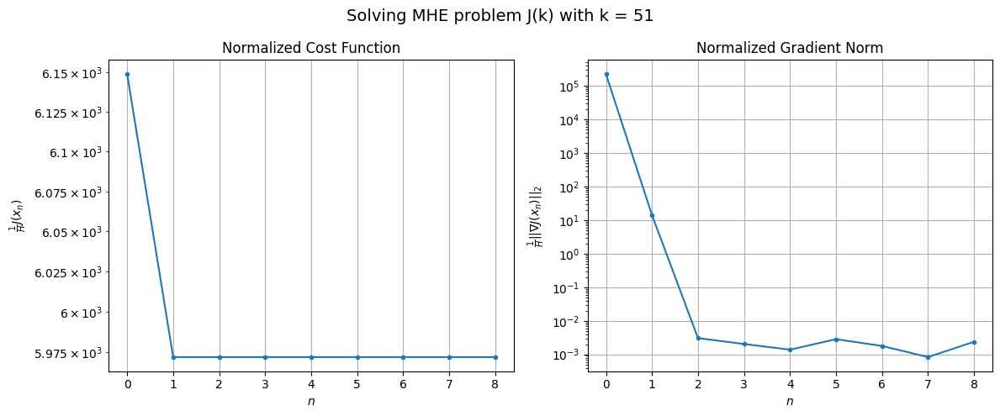

Windows:   4%|▎         | 13/356 [02:07<56:03,  9.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 231457.52734276303
Gradient norm: 8580521.105035516
Global estimation error: 34.023275683217854
Initial conditions estimation errors: 19.660295816355685 m, 20.626785082873965 m, 13.856920657141643 m, 12.391625364286046 m
Position estimation errors: 20.92703801689108 m, 22.007974689566144 m, 24.060502983515033 m, 23.07827044183749 m

[Gauss-Newton] Iteration 1
Cost function: 225162.1468266815 (-2.72%)
Gradient norm: 38.63228461313308 (-100.00%)
Global estimation error: 38.7558070047623 (13.91%)
Initial conditions estimation errors: 22.168170605798554 m, 23.514115512441528 m, 14.933951580667717 m, 15.317408703749114 m
Position estimation errors: 17.963050277820113 m, 19.086918795683758 m, 22.09454599307413 m, 21.44665678057633 m

[Gauss-Newton] Iteration 2
Cost function: 225162.1468001017 (-0.00%)
Gradient norm: 0.0440939319023355 (-99.89%)
Global estimation error: 38.75560975037338 (-0.00%)
Initial conditions estimation errors:

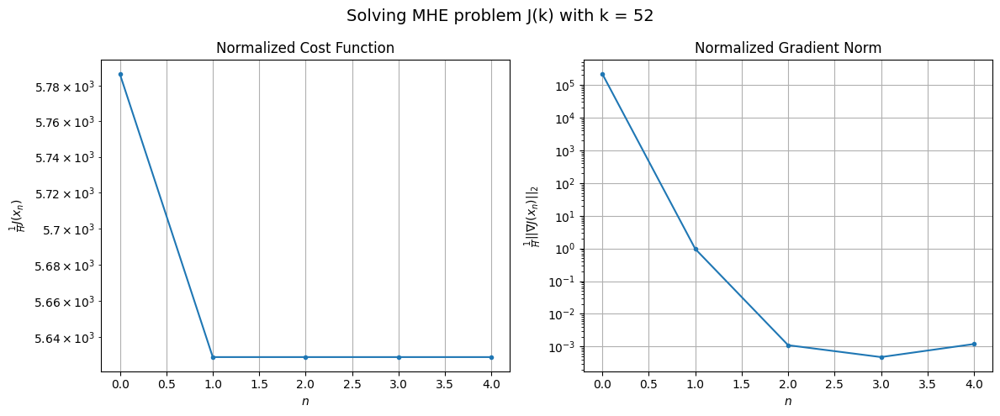

Windows:   4%|▍         | 14/356 [02:14<50:34,  8.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 221408.82213637058
Gradient norm: 8056601.667763261
Global estimation error: 31.022457479221064
Initial conditions estimation errors: 17.89240798847421 m, 19.406199214836217 m, 10.240821587672569 m, 12.679052658357152 m
Position estimation errors: 20.354566432333904 m, 21.20567106880166 m, 24.80947588458961 m, 24.229073455235227 m

[Gauss-Newton] Iteration 1
Cost function: 215921.93242357566 (-2.48%)
Gradient norm: 14.414506855246612 (-100.00%)
Global estimation error: 34.49217767514627 (11.18%)
Initial conditions estimation errors: 20.217080269013486 m, 21.53081280197769 m, 12.969393255770154 m, 12.213805333995822 m
Position estimation errors: 17.582738959107655 m, 18.645265127826075 m, 21.891226339135013 m, 21.38700021739091 m

[Gauss-Newton] Iteration 2
Cost function: 215921.93240828134 (-0.00%)
Gradient norm: 0.0036822612568207253 (-99.97%)
Global estimation error: 34.49490636079287 (0.01%)
Initial conditions estimation er

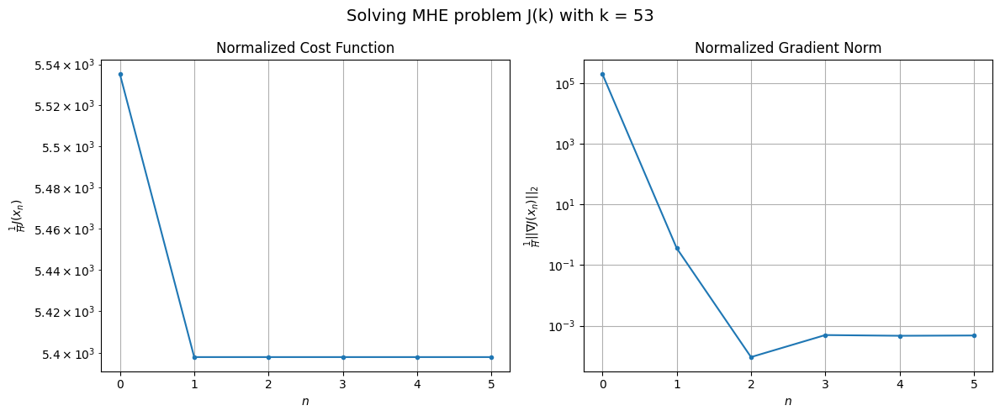

Windows:   4%|▍         | 15/356 [02:21<47:40,  8.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 215604.68319666485
Gradient norm: 7675450.529482584
Global estimation error: 27.42014552881046
Initial conditions estimation errors: 16.33505339895179 m, 17.869579933529344 m, 8.766393506387448 m, 9.425552276558099 m
Position estimation errors: 19.934263616307415 m, 20.699073927888385 m, 24.566765970414526 m, 24.217557657747953 m

[Gauss-Newton] Iteration 1
Cost function: 210727.97799561446 (-2.26%)
Gradient norm: 96.02709619915531 (-100.00%)
Global estimation error: 33.004048719126224 (20.36%)
Initial conditions estimation errors: 18.51680325204933 m, 20.068415573824893 m, 13.220575238999015 m, 12.994346933980163 m
Position estimation errors: 17.323885831304903 m, 17.790881185529102 m, 21.706869988571185 m, 21.399206530762164 m

[Gauss-Newton] Iteration 2
Cost function: 210727.9779593069 (-0.00%)
Gradient norm: 0.05333321590808517 (-99.94%)
Global estimation error: 32.99981962836176 (-0.01%)
Initial conditions estimation erro

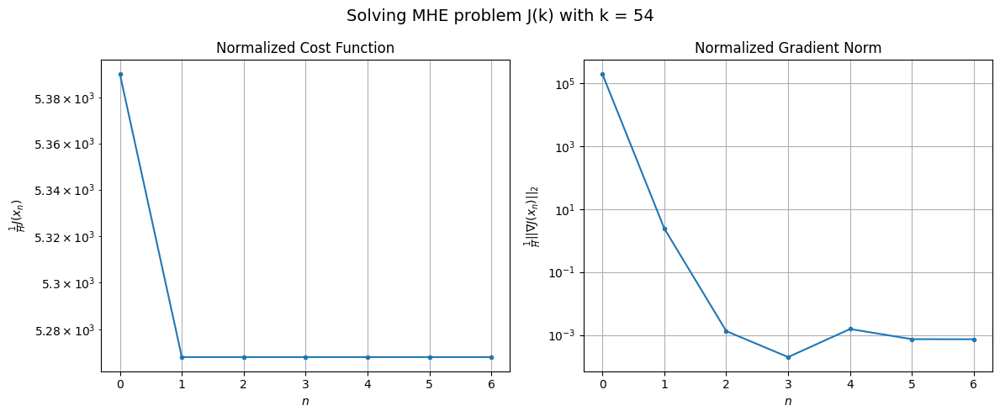

Windows:   4%|▍         | 16/356 [02:30<47:08,  8.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 213495.5886354193
Gradient norm: 7618025.83547391
Global estimation error: 26.61442549284225
Initial conditions estimation errors: 15.078581186804184 m, 16.78491499021308 m, 9.800615349205009 m, 10.157016117247077 m
Position estimation errors: 19.677279377734422 m, 19.88744880288555 m, 24.09061002933485 m, 23.86475698265541 m

[Gauss-Newton] Iteration 1
Cost function: 209024.3222663648 (-2.09%)
Gradient norm: 5.07507328628331 (-100.00%)
Global estimation error: 30.91634398785866 (16.16%)
Initial conditions estimation errors: 17.14817945248665 m, 18.641163536156036 m, 12.424958429409564 m, 12.64411924097018 m
Position estimation errors: 17.17539524034801 m, 17.461084773292054 m, 21.119210423585088 m, 20.827576628496317 m

[Gauss-Newton] Iteration 2
Cost function: 209024.32227646784 (0.00%)
Gradient norm: 0.0114634268368261 (-99.77%)
Global estimation error: 30.91453655346645 (-0.01%)
Initial conditions estimation errors: 17.148

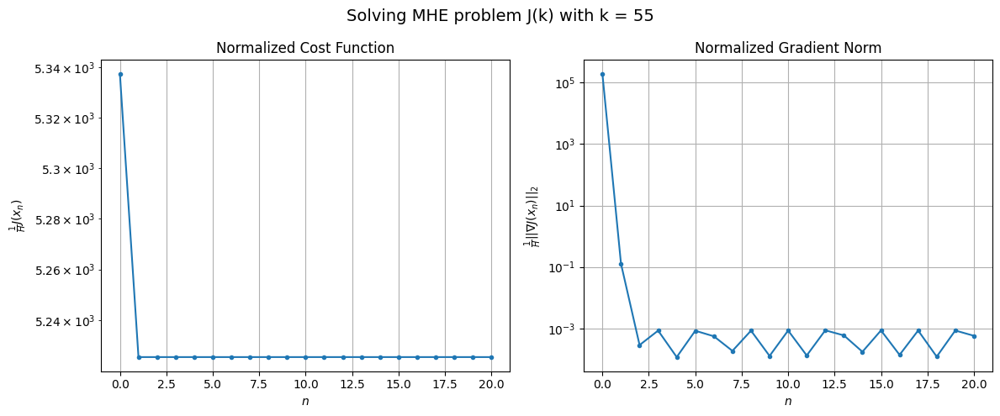

Windows:   5%|▍         | 17/356 [02:53<1:12:40, 12.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 213578.53402852145
Gradient norm: 7441627.755993644
Global estimation error: 25.37113410328947
Initial conditions estimation errors: 14.146579066295299 m, 15.78779803152177 m, 9.561422311917008 m, 10.143098028849057 m
Position estimation errors: 19.54917971151229 m, 19.581567971133076 m, 23.467290212865393 m, 23.2443559919013 m

[Gauss-Newton] Iteration 1
Cost function: 209509.55029909732 (-1.91%)
Gradient norm: 18.295802737500402 (-100.00%)
Global estimation error: 29.91241861982768 (17.90%)
Initial conditions estimation errors: 16.11196821047757 m, 18.601842995850177 m, 12.171660627929436 m, 11.872994237919606 m
Position estimation errors: 17.167238986457154 m, 16.26900630986188 m, 21.35457243664758 m, 21.131404566427562 m

[Gauss-Newton] Iteration 2
Cost function: 209509.55026957268 (-0.00%)
Gradient norm: 0.0245784680005497 (-99.87%)
Global estimation error: 29.919197212333764 (0.02%)
Initial conditions estimation errors: 

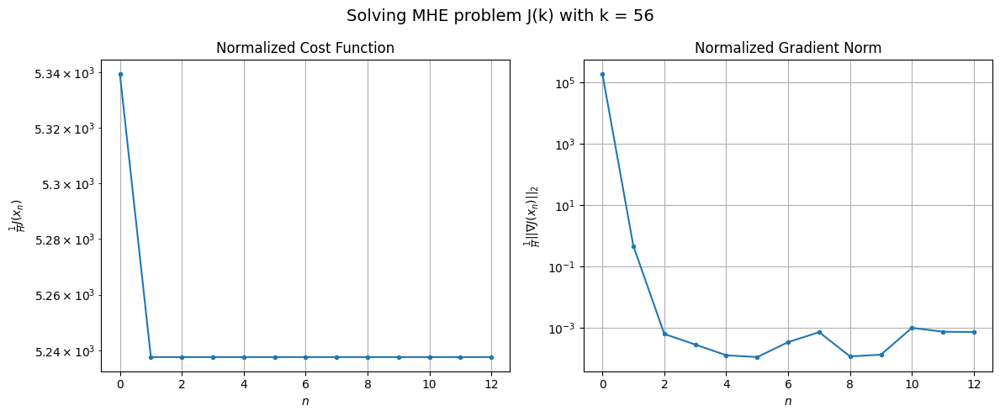

Windows:   5%|▌         | 18/356 [03:07<1:14:52, 13.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 215847.35440480118
Gradient norm: 7379339.42885781
Global estimation error: 25.136615499588363
Initial conditions estimation errors: 13.49273802701987 m, 16.022159840263924 m, 9.890103458796379 m, 9.760258233424194 m
Position estimation errors: 19.560289494301376 m, 18.460109582205764 m, 23.755977231318617 m, 23.624993716098707 m

[Gauss-Newton] Iteration 1
Cost function: 211948.1465665249 (-1.81%)
Gradient norm: 106.9625437483707 (-100.00%)
Global estimation error: 30.37471703928545 (20.84%)
Initial conditions estimation errors: 15.424455325638322 m, 16.18085416090976 m, 14.496698663447836 m, 14.585164800130709 m
Position estimation errors: 17.242860982341252 m, 17.995754783463852 m, 20.21619601079964 m, 20.316036015188875 m

[Gauss-Newton] Iteration 2
Cost function: 211948.14641617137 (-0.00%)
Gradient norm: 0.08964300169092726 (-99.92%)
Global estimation error: 30.36988608941551 (-0.02%)
Initial conditions estimation errors

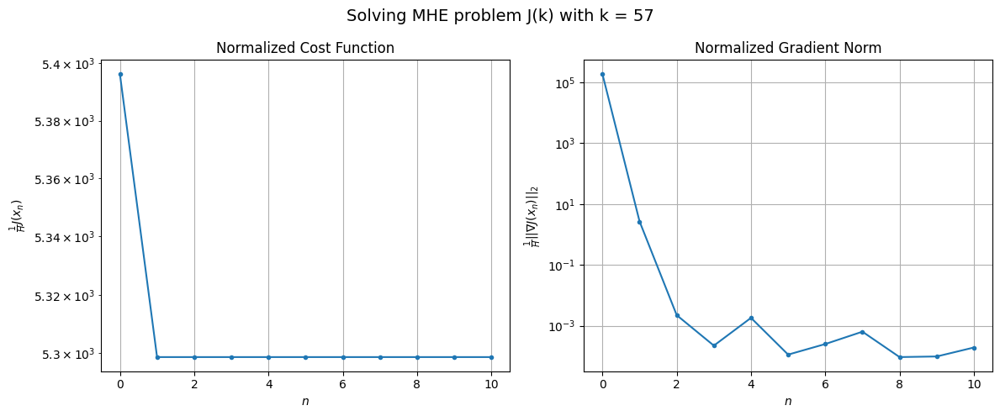

Windows:   5%|▌         | 19/356 [03:20<1:14:23, 13.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 219015.4037662456
Gradient norm: 7616357.57309441
Global estimation error: 26.159331239277282
Initial conditions estimation errors: 13.132666131470552 m, 14.008490713181903 m, 12.544900430154357 m, 12.578741582055045 m
Position estimation errors: 19.65030731636224 m, 20.20352614255492 m, 22.24854189025173 m, 22.345738091297903 m

[Gauss-Newton] Iteration 1
Cost function: 215259.08114406804 (-1.72%)
Gradient norm: 55.6341477671012 (-100.00%)
Global estimation error: 31.001242606374642 (18.51%)
Initial conditions estimation errors: 15.029420181009387 m, 16.917134077712042 m, 15.37576255087298 m, 14.58023812702917 m
Position estimation errors: 17.376644746146557 m, 16.235159072130802 m, 20.349093400751592 m, 20.409812692539838 m

[Gauss-Newton] Iteration 2
Cost function: 215259.0811224595 (-0.00%)
Gradient norm: 0.012126270513818486 (-99.98%)
Global estimation error: 31.00836264844104 (0.02%)
Initial conditions estimation errors:

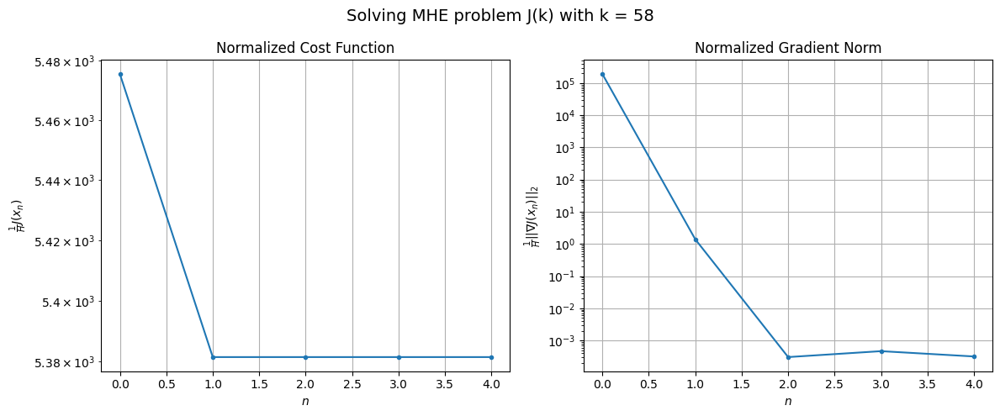

Windows:   6%|▌         | 20/356 [03:27<1:02:50, 11.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 223267.80124810338
Gradient norm: 7784068.203583424
Global estimation error: 27.2718017355885
Initial conditions estimation errors: 13.02245191600229 m, 14.855036323216945 m, 13.738528724738051 m, 12.83519050962144 m
Position estimation errors: 19.80298179038108 m, 18.512038339964565 m, 22.33674082092353 m, 22.281672916229628 m

[Gauss-Newton] Iteration 1
Cost function: 219602.4672663179 (-1.64%)
Gradient norm: 94.94666979559159 (-100.00%)
Global estimation error: 31.64859233986366 (16.05%)
Initial conditions estimation errors: 14.922778403712062 m, 16.910274567151912 m, 16.7677469660916 m, 14.554179518222998 m
Position estimation errors: 17.568340749976922 m, 15.890349602101791 m, 21.340444124215125 m, 21.825949342126602 m

[Gauss-Newton] Iteration 2
Cost function: 219602.46725941164 (-0.00%)
Gradient norm: 0.026877258032862318 (-99.97%)
Global estimation error: 31.649460511969274 (0.00%)
Initial conditions estimation errors:

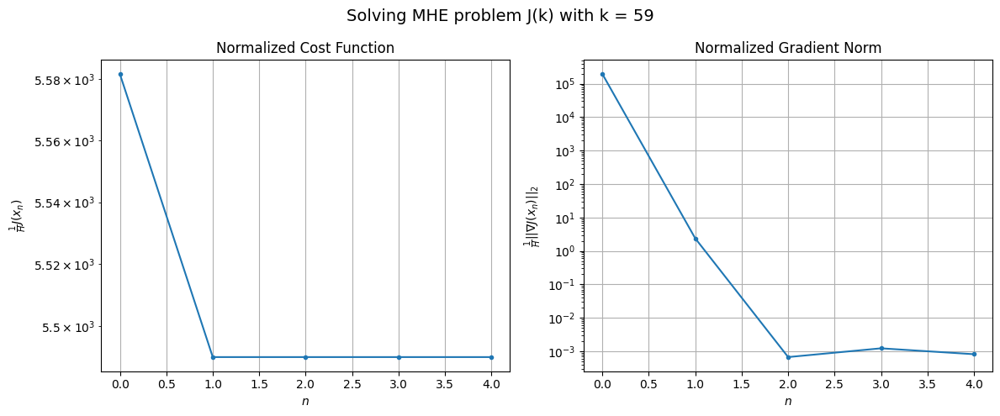

Windows:   6%|▌         | 21/356 [03:33<54:18,  9.73s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 228317.87898322893
Gradient norm: 8225159.081182738
Global estimation error: 28.424639713827023
Initial conditions estimation errors: 13.120639574409724 m, 14.992651089381937 m, 15.424375695820892 m, 13.157254082215253 m
Position estimation errors: 20.03351743978553 m, 18.276405441126713 m, 23.171919997328743 m, 23.34841234237025 m

[Gauss-Newton] Iteration 1
Cost function: 224564.79821402277 (-1.64%)
Gradient norm: 602.7867663640952 (-99.99%)
Global estimation error: 30.466121201627644 (7.18%)
Initial conditions estimation errors: 15.086146342711563 m, 17.69692112211093 m, 14.007334613109208 m, 13.827513761016407 m
Position estimation errors: 17.781811391063478 m, 15.36718132332773 m, 17.91629048201823 m, 18.180745044486596 m

[Gauss-Newton] Iteration 2
Cost function: 224564.7974901682 (-0.00%)
Gradient norm: 0.013343705003995005 (-100.00%)
Global estimation error: 30.471910326364057 (0.02%)
Initial conditions estimation erro

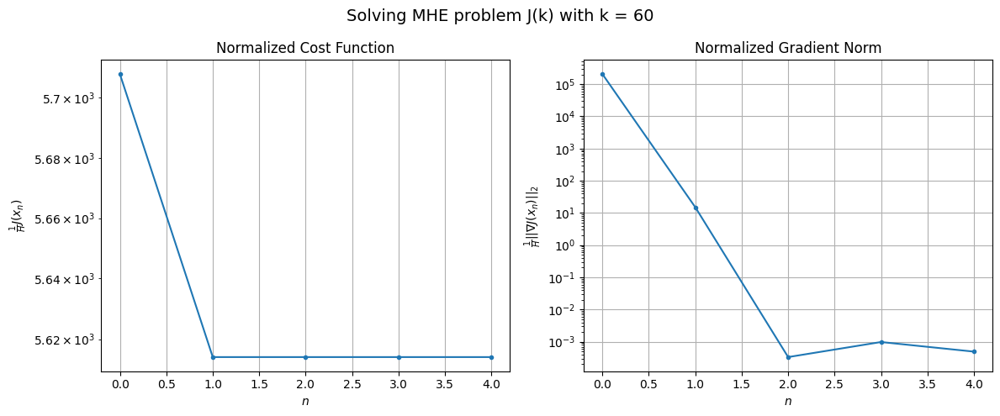

Windows:   6%|▌         | 22/356 [03:40<49:18,  8.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 234052.10978940479
Gradient norm: 8434881.977339366
Global estimation error: 26.941044929348433
Initial conditions estimation errors: 13.353418146291688 m, 15.843542794531748 m, 12.357323481979778 m, 11.990774143544348 m
Position estimation errors: 20.305466349121044 m, 17.716028312975457 m, 20.334760457938486 m, 20.770461815666955 m

[Gauss-Newton] Iteration 1
Cost function: 230188.01253905622 (-1.65%)
Gradient norm: 38.480020006160075 (-100.00%)
Global estimation error: 34.459923270198466 (27.91%)
Initial conditions estimation errors: 15.427134710849694 m, 17.806641320557986 m, 17.562461641462367 m, 17.999087673667063 m
Position estimation errors: 18.038511085853784 m, 15.715620613212348 m, 17.176715508283465 m, 16.974603837171276 m

[Gauss-Newton] Iteration 2
Cost function: 230188.0125325239 (-0.00%)
Gradient norm: 0.04047415306435706 (-99.89%)
Global estimation error: 34.461048542620816 (0.00%)
Initial conditions estimatio

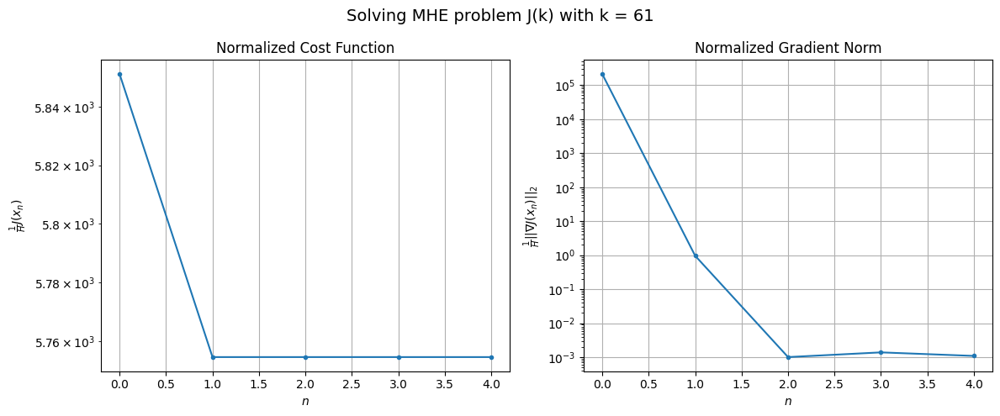

Windows:   6%|▋         | 23/356 [03:46<44:48,  8.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 239787.4428347699
Gradient norm: 8774108.960550554
Global estimation error: 30.85795851615166
Initial conditions estimation errors: 13.635082144527745 m, 15.962003002180376 m, 15.771760690762248 m, 16.209784447266983 m
Position estimation errors: 20.646098558158002 m, 18.19900797249272 m, 19.696171410194275 m, 19.53490951737133 m

[Gauss-Newton] Iteration 1
Cost function: 235575.6001434207 (-1.76%)
Gradient norm: 35.89859848764535 (-100.00%)
Global estimation error: 37.165434483427404 (20.44%)
Initial conditions estimation errors: 15.933068839428788 m, 16.98596886810978 m, 19.654252089719268 m, 21.2740930497963 m
Position estimation errors: 18.318182225436253 m, 16.821855916316142 m, 16.895024596558667 m, 16.117337273488662 m

[Gauss-Newton] Iteration 2
Cost function: 235575.60011518857 (-0.00%)
Gradient norm: 0.03376529176627841 (-99.91%)
Global estimation error: 37.16909997737858 (0.01%)
Initial conditions estimation errors:

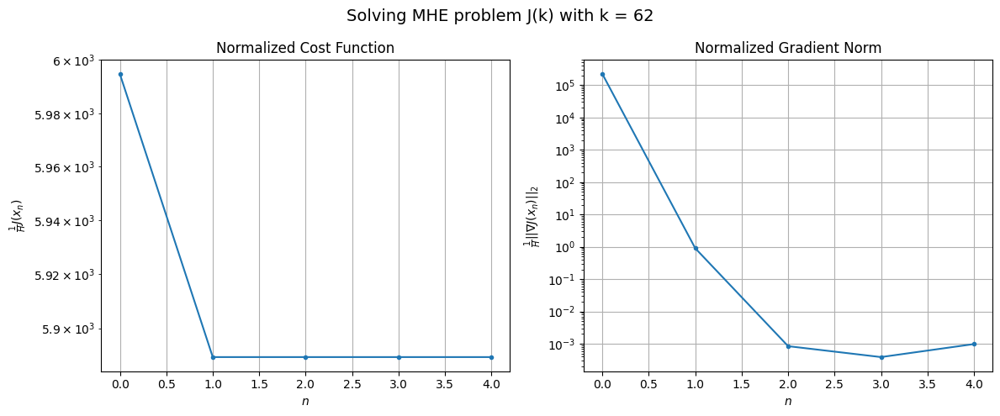

Windows:   7%|▋         | 24/356 [03:52<41:22,  7.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 245062.6166654439
Gradient norm: 9266256.959154792
Global estimation error: 33.623888970440866
Initial conditions estimation errors: 14.020264398948367 m, 15.127590626826967 m, 17.86056505481811 m, 19.65059048508738 m
Position estimation errors: 21.04713267827233 m, 19.420907617662795 m, 19.431196556101458 m, 18.596307599998752 m

[Gauss-Newton] Iteration 1
Cost function: 240400.2181445289 (-1.90%)
Gradient norm: 35.41558512536036 (-100.00%)
Global estimation error: 41.55303525143981 (23.58%)
Initial conditions estimation errors: 16.56875758026221 m, 17.05069390316522 m, 21.308413276650402 m, 26.59599734989529 m
Position estimation errors: 18.628358357295212 m, 17.697617018681324 m, 15.302623233400448 m, 13.805287337468432 m

[Gauss-Newton] Iteration 2
Cost function: 240400.2181309974 (-0.00%)
Gradient norm: 0.11186898317682209 (-99.68%)
Global estimation error: 41.55852057883485 (0.01%)
Initial conditions estimation errors: 1

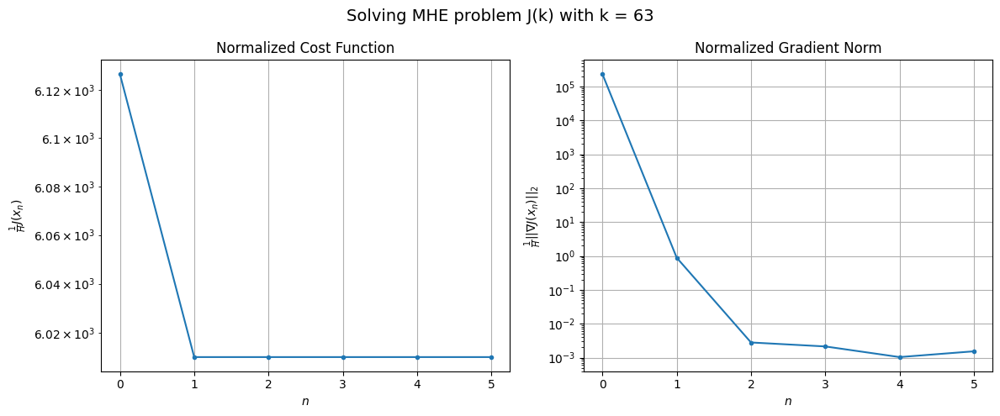

Windows:   7%|▋         | 25/356 [03:59<39:47,  7.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 249934.37853378613
Gradient norm: 9677591.15430441
Global estimation error: 37.958382039369695
Initial conditions estimation errors: 14.53228467439055 m, 15.130212838083292 m, 19.62534639359181 m, 24.810534431040868 m
Position estimation errors: 21.5322861732774 m, 20.502915847963756 m, 18.00559214384855 m, 16.54470948766957 m

[Gauss-Newton] Iteration 1
Cost function: 244753.20014911008 (-2.07%)
Gradient norm: 31.037307051329613 (-100.00%)
Global estimation error: 41.365991003274246 (8.98%)
Initial conditions estimation errors: 17.325480159187023 m, 17.93382546127956 m, 21.35457895418338 m, 25.165873883736833 m
Position estimation errors: 18.99636391306165 m, 17.66374589026269 m, 14.999188399489194 m, 12.95984090105767 m

[Gauss-Newton] Iteration 2
Cost function: 244753.20015035264 (0.00%)
Gradient norm: 0.05664670467733179 (-99.82%)
Global estimation error: 41.36691030795786 (0.00%)
Initial conditions estimation errors: 17.3

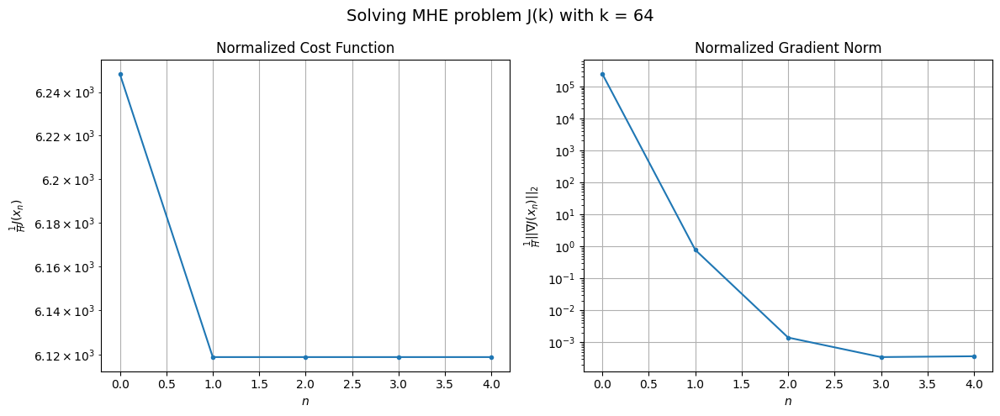

Windows:   7%|▋         | 26/356 [04:05<38:04,  6.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 254376.89108162525
Gradient norm: 10173689.81785236
Global estimation error: 37.96279322337926
Initial conditions estimation errors: 15.187653424339828 m, 15.962500411215824 m, 19.833556038793574 m, 23.71336806749659 m
Position estimation errors: 22.147008241354598 m, 20.73880910213323 m, 17.789311393025187 m, 15.605083955692331 m

[Gauss-Newton] Iteration 1
Cost function: 248738.90065107454 (-2.22%)
Gradient norm: 683.1159598727471 (-99.99%)
Global estimation error: 43.42701478563122 (14.39%)
Initial conditions estimation errors: 18.151755850933046 m, 17.47151076134577 m, 20.5259887402959 m, 28.806834608784698 m
Position estimation errors: 19.487721357076637 m, 20.273040882597343 m, 11.435881287153022 m, 9.778486413845892 m

[Gauss-Newton] Iteration 2
Cost function: 248738.90005112207 (-0.00%)
Gradient norm: 0.03178551076789309 (-100.00%)
Global estimation error: 43.43429886135419 (0.02%)
Initial conditions estimation errors:

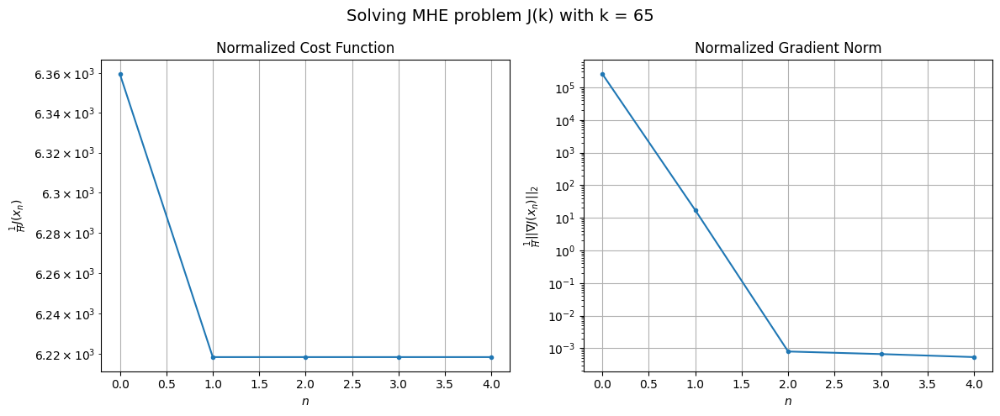

Windows:   8%|▊         | 27/356 [04:11<36:51,  6.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 258236.7405164396
Gradient norm: 10804189.740051934
Global estimation error: 39.287629294968085
Initial conditions estimation errors: 15.940546991045817 m, 15.52700380264871 m, 19.199238650789802 m, 26.071076295417857 m
Position estimation errors: 22.974895478420954 m, 23.49232374634674 m, 14.651694455564582 m, 13.298072594517775 m

[Gauss-Newton] Iteration 1
Cost function: 251894.58799215464 (-2.46%)
Gradient norm: 1083.2010119557917 (-99.99%)
Global estimation error: 45.34576541768691 (15.42%)
Initial conditions estimation errors: 19.07392580910352 m, 19.21388223437831 m, 23.46163165870359 m, 27.798997215606267 m
Position estimation errors: 20.114484526345123 m, 20.010698591654513 m, 16.67312308128005 m, 14.102217828545559 m

[Gauss-Newton] Iteration 2
Cost function: 251894.58644906434 (-0.00%)
Gradient norm: 0.047824048077802016 (-100.00%)
Global estimation error: 45.355190478074746 (0.02%)
Initial conditions estimation err

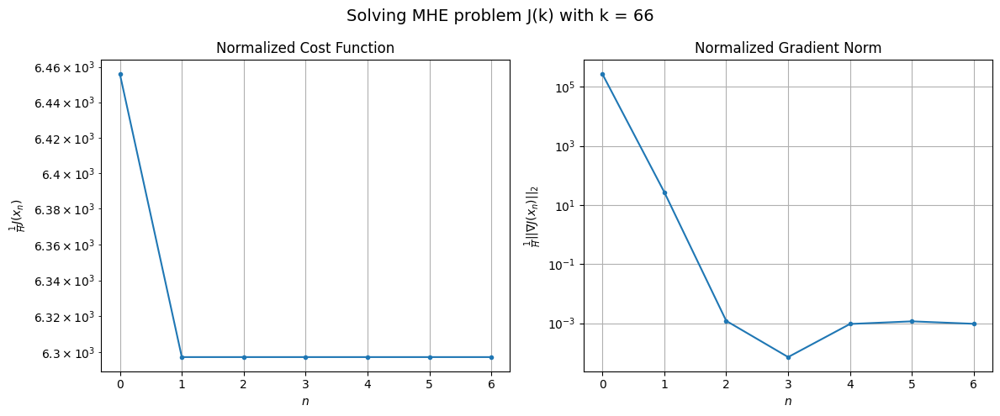

Windows:   8%|▊         | 28/356 [04:19<38:52,  7.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 262778.479852779
Gradient norm: 11793144.144494781
Global estimation error: 42.12870827112466
Initial conditions estimation errors: 16.81187776624006 m, 17.06403689026372 m, 22.22328004813253 m, 26.591632104862374 m
Position estimation errors: 24.02685655777376 m, 23.75310392026642 m, 20.045138023544773 m, 17.035247105487763 m

[Gauss-Newton] Iteration 1
Cost function: 255677.8539706858 (-2.70%)
Gradient norm: 21.8019050479629 (-100.00%)
Global estimation error: 44.753019846416485 (6.23%)
Initial conditions estimation errors: 20.0191941610279 m, 19.6770693459002 m, 23.214518995057563 m, 25.998925909111808 m
Position estimation errors: 20.899079885678905 m, 20.757289750304498 m, 18.373259089701822 m, 16.24217758134613 m

[Gauss-Newton] Iteration 2
Cost function: 255677.8539620791 (-0.00%)
Gradient norm: 0.0405399329883294 (-99.81%)
Global estimation error: 44.75270283365286 (-0.00%)
Initial conditions estimation errors: 20.0191

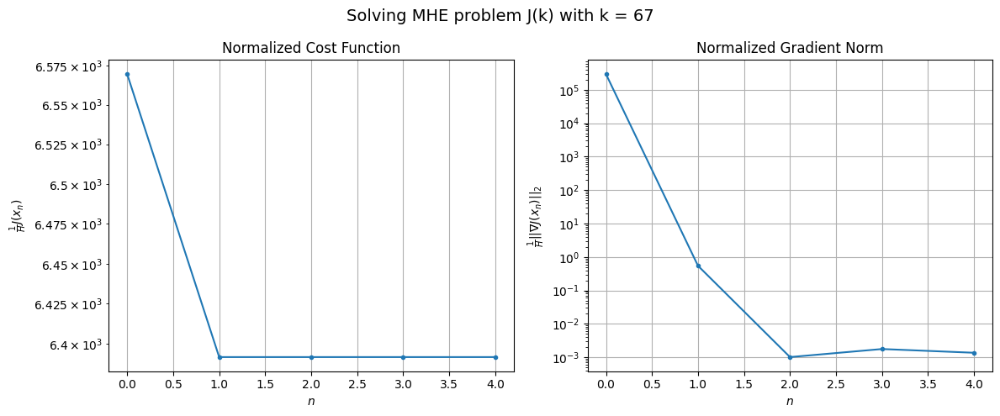

Windows:   8%|▊         | 29/356 [04:26<37:23,  6.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 267913.4047529724
Gradient norm: 12606604.463251807
Global estimation error: 41.67119605851621
Initial conditions estimation errors: 17.723893128124995 m, 17.72332899629357 m, 21.96564225922388 m, 25.01456281843637 m
Position estimation errors: 25.27891140829863 m, 24.939250232678305 m, 22.19935863060731 m, 19.429551570813945 m

[Gauss-Newton] Iteration 1
Cost function: 260098.33274317178 (-2.92%)
Gradient norm: 171.8047388363161 (-100.00%)
Global estimation error: 45.720355821546576 (9.72%)
Initial conditions estimation errors: 20.95306900982352 m, 20.624713629713458 m, 23.200376307357168 m, 26.22333548527075 m
Position estimation errors: 21.89475908819205 m, 22.357148180509714 m, 17.859463206176304 m, 15.727739852535379 m

[Gauss-Newton] Iteration 2
Cost function: 260098.33266921272 (-0.00%)
Gradient norm: 0.015783133912946036 (-99.99%)
Global estimation error: 45.72680985957029 (0.01%)
Initial conditions estimation errors: 

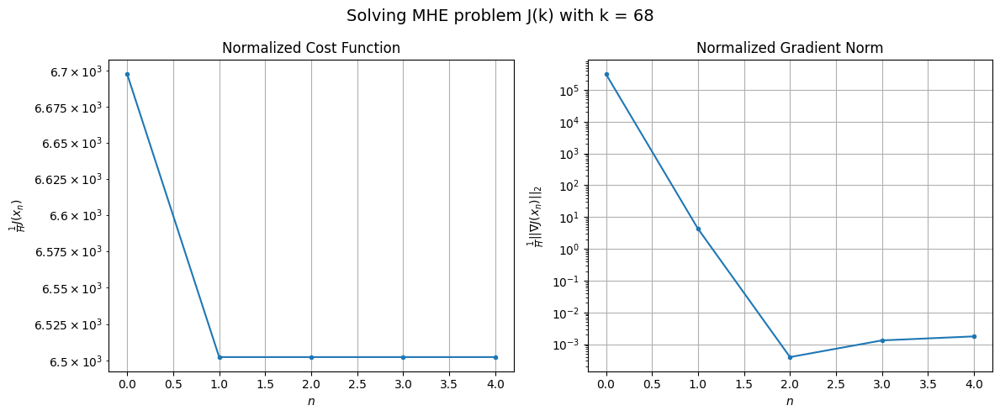

Windows:   8%|▊         | 30/356 [04:32<36:45,  6.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 273668.79789260606
Gradient norm: 13426275.102630049
Global estimation error: 41.91656980226293
Initial conditions estimation errors: 18.614165813959936 m, 18.647265109798333 m, 21.74488076083957 m, 24.288562761162133 m
Position estimation errors: 26.723634889566785 m, 26.88540260666396 m, 22.260993966504422 m, 20.091750877470247 m

[Gauss-Newton] Iteration 1
Cost function: 265065.83174144616 (-3.14%)
Gradient norm: 52.28672737125171 (-100.00%)
Global estimation error: 47.45669609652483 (13.22%)
Initial conditions estimation errors: 21.85459898722387 m, 21.294679746928757 m, 24.429976585909984 m, 26.91113069273843 m
Position estimation errors: 23.061030731832442 m, 23.887176317012354 m, 16.061985776712174 m, 14.60895975295575 m

[Gauss-Newton] Iteration 2
Cost function: 265065.83172899386 (-0.00%)
Gradient norm: 0.055813994372784566 (-99.89%)
Global estimation error: 47.45602612513587 (-0.00%)
Initial conditions estimation err

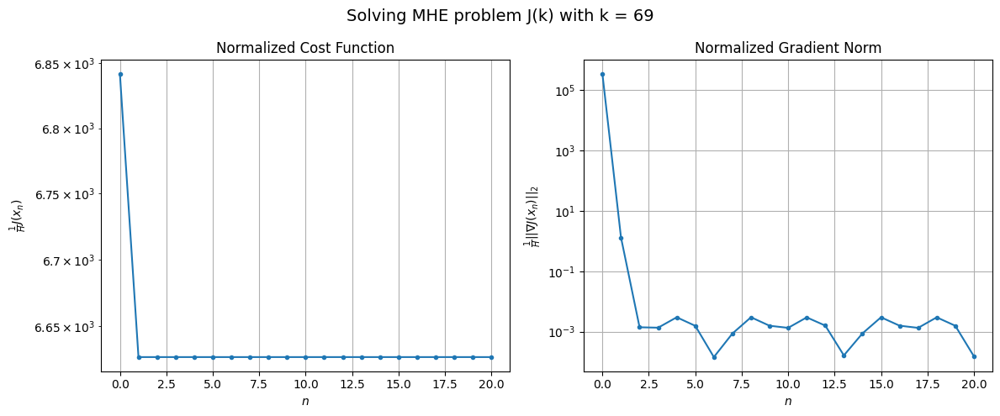

Windows:   9%|▊         | 31/356 [04:56<1:03:58, 11.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 281135.97234719864
Gradient norm: 14310437.889836801
Global estimation error: 43.47990249758093
Initial conditions estimation errors: 19.4513867129235 m, 19.334506941296457 m, 22.96680765974281 m, 24.71504547339168 m
Position estimation errors: 28.263975138767368 m, 28.75352567822034 m, 20.667675805795888 m, 19.43630225512398 m

[Gauss-Newton] Iteration 1
Cost function: 271672.02642416634 (-3.37%)
Gradient norm: 48.23988177095813 (-100.00%)
Global estimation error: 49.46803379550838 (13.77%)
Initial conditions estimation errors: 22.707034004098674 m, 22.613893041680715 m, 25.452333639907067 m, 27.789401260864295 m
Position estimation errors: 24.315408773076577 m, 24.225993213107724 m, 17.319492187884777 m, 15.499937518855484 m

[Gauss-Newton] Iteration 2
Cost function: 271672.0264219058 (-0.00%)
Gradient norm: 0.07268500290751452 (-99.85%)
Global estimation error: 49.47016084507467 (0.00%)
Initial conditions estimation errors:

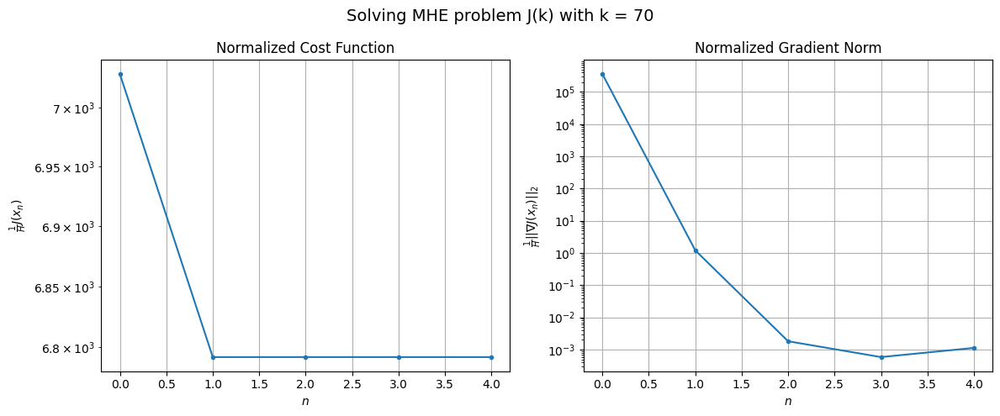

Windows:   9%|▉         | 32/356 [05:02<54:40, 10.13s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 290251.409532649
Gradient norm: 14977881.331115104
Global estimation error: 44.835801982924195
Initial conditions estimation errors: 20.218210944209392 m, 20.522320832940295 m, 23.568217413256253 m, 24.99666891125366 m
Position estimation errors: 29.813281859975877 m, 29.413945955362777 m, 22.33895133643977 m, 21.009508501069917 m

[Gauss-Newton] Iteration 1
Cost function: 280005.2597303945 (-3.53%)
Gradient norm: 20.27069494748754 (-100.00%)
Global estimation error: 50.9266908564377 (13.58%)
Initial conditions estimation errors: 23.491375049621034 m, 24.59869716496055 m, 25.991089065013032 m, 27.58687818578666 m
Position estimation errors: 25.61904491557154 m, 24.655484967197932 m, 20.47774415351565 m, 19.041856110098124 m

[Gauss-Newton] Iteration 2
Cost function: 280005.25972542854 (-0.00%)
Gradient norm: 0.07666085563614293 (-99.62%)
Global estimation error: 50.92687007150419 (0.00%)
Initial conditions estimation errors: 2

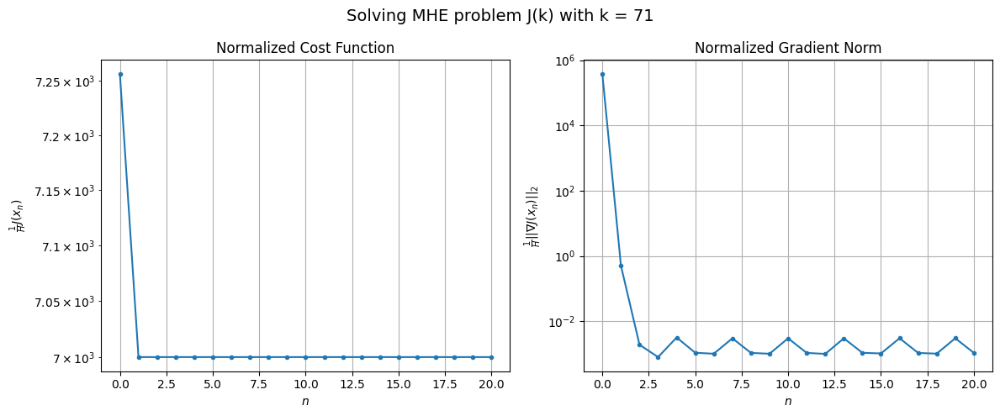

Windows:   9%|▉         | 33/356 [05:25<1:14:34, 13.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 301022.3969009211
Gradient norm: 15347654.045822665
Global estimation error: 45.888778632869275
Initial conditions estimation errors: 20.899451662390778 m, 22.35567538967821 m, 23.77470768582648 m, 24.575759886006058 m
Position estimation errors: 31.33821845341069 m, 30.138199591956 m, 25.877499237691925 m, 24.95586743649057 m

[Gauss-Newton] Iteration 1
Cost function: 290041.0163262535 (-3.65%)
Gradient norm: 142.3502582103798 (-100.00%)
Global estimation error: 51.62426183940037 (12.50%)
Initial conditions estimation errors: 24.223509063774813 m, 24.573647494756152 m, 26.32050463106802 m, 27.95780044976594 m
Position estimation errors: 26.954424336054235 m, 26.909349626328762 m, 20.551093709156234 m, 19.937718624333492 m

[Gauss-Newton] Iteration 2
Cost function: 290041.01630031853 (-0.00%)
Gradient norm: 0.12980526629515138 (-99.91%)
Global estimation error: 51.62471851894291 (0.00%)
Initial conditions estimation errors: 24

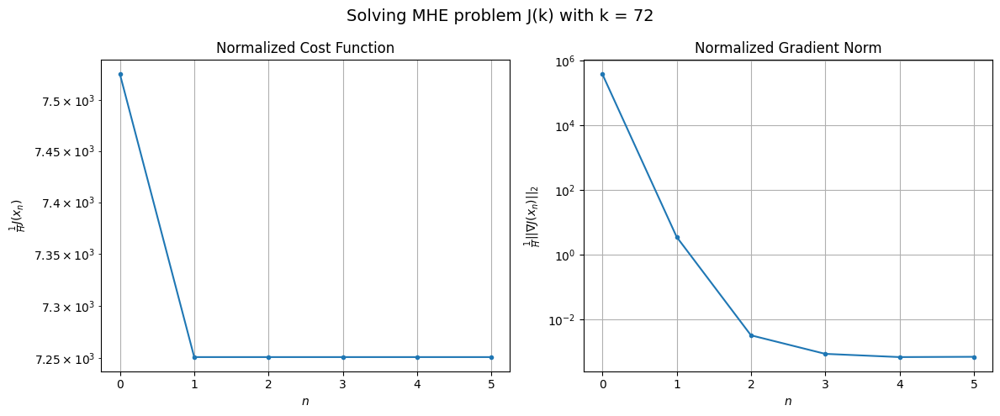

Windows:  10%|▉         | 34/356 [05:32<1:03:18, 11.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 314629.67585766356
Gradient norm: 15679425.040905084
Global estimation error: 45.75431537665878
Initial conditions estimation errors: 21.48718788929386 m, 22.01043185628625 m, 23.67525300646328 m, 24.223303054060704 m
Position estimation errors: 32.81228320244604 m, 32.59047433570215 m, 26.07349799173844 m, 26.30270078789033 m

[Gauss-Newton] Iteration 1
Cost function: 302829.454173998 (-3.75%)
Gradient norm: 128.4592372351203 (-100.00%)
Global estimation error: 51.36381899318503 (12.26%)
Initial conditions estimation errors: 24.893529291694573 m, 25.380757085530586 m, 26.39958830692698 m, 26.027285996208306 m
Position estimation errors: 28.258014290256884 m, 28.40307402768859 m, 23.89348007774543 m, 23.35263049358726 m

[Gauss-Newton] Iteration 2
Cost function: 302829.45414746745 (-0.00%)
Gradient norm: 0.05803892399572511 (-99.95%)
Global estimation error: 51.366359692929535 (0.00%)
Initial conditions estimation errors: 24.8

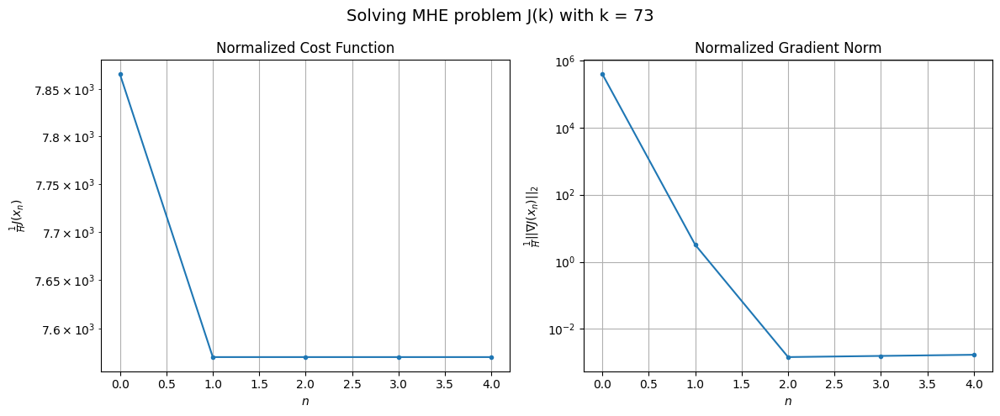

Windows:  10%|▉         | 35/356 [05:37<53:40, 10.03s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 330039.37846948486
Gradient norm: 15501551.178450646
Global estimation error: 45.29488241606586
Initial conditions estimation errors: 21.94503208999875 m, 22.55534676394244 m, 23.48156996822741 m, 22.580984334646427 m
Position estimation errors: 34.14717980444971 m, 34.15617583375761 m, 29.58224205048683 m, 29.610146942984656 m

[Gauss-Newton] Iteration 1
Cost function: 317470.20767834265 (-3.81%)
Gradient norm: 50.92843590277403 (-100.00%)
Global estimation error: 51.46476342662704 (13.62%)
Initial conditions estimation errors: 25.47809257250181 m, 26.520373919446946 m, 25.933171853216635 m, 24.97227424960411 m
Position estimation errors: 29.497675349425254 m, 29.40798331210421 m, 28.795651767372636 m, 27.657462509417368 m

[Gauss-Newton] Iteration 2
Cost function: 317470.20765690116 (-0.00%)
Gradient norm: 0.03243101802770889 (-99.94%)
Global estimation error: 51.463259572374334 (-0.00%)
Initial conditions estimation errors:

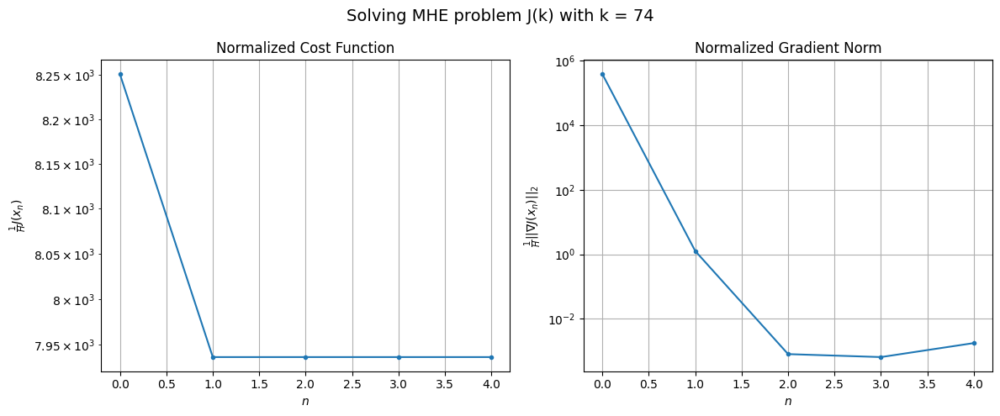

Windows:  10%|█         | 36/356 [05:43<46:47,  8.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 346852.29480072774
Gradient norm: 14991942.638309713
Global estimation error: 44.777847072493216
Initial conditions estimation errors: 22.248888662451343 m, 23.329489872657035 m, 22.60664749162186 m, 21.32373490067609 m
Position estimation errors: 35.32792505880352 m, 35.18108640774991 m, 34.63033396209897 m, 33.90889869238221 m

[Gauss-Newton] Iteration 1
Cost function: 333740.6095804614 (-3.78%)
Gradient norm: 81.69132248770126 (-100.00%)
Global estimation error: 50.660097571390345 (13.14%)
Initial conditions estimation errors: 25.888366018438692 m, 27.282555538474696 m, 25.116557204996685 m, 22.826324907682906 m
Position estimation errors: 30.657600983444656 m, 30.313203711002206 m, 30.248158690278693 m, 30.98137862812519 m

[Gauss-Newton] Iteration 2
Cost function: 333740.60956804134 (-0.00%)
Gradient norm: 0.022682528647695006 (-99.97%)
Global estimation error: 50.65985800045563 (-0.00%)
Initial conditions estimation erro

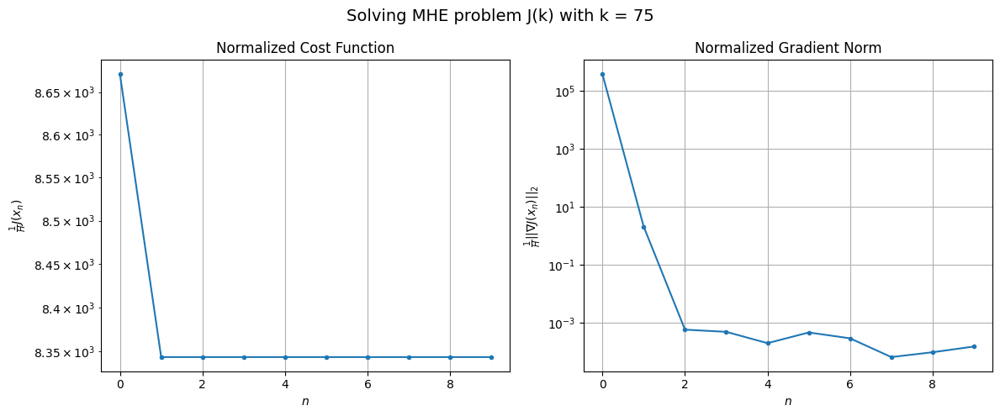

Windows:  10%|█         | 37/356 [05:54<49:44,  9.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 365940.0674434189
Gradient norm: 14350121.152267456
Global estimation error: 43.16533038525524
Initial conditions estimation errors: 22.349052088990074 m, 23.788688097170116 m, 21.310414805882253 m, 18.53945740416724 m
Position estimation errors: 36.390530153802345 m, 35.983188685170035 m, 36.12818797692774 m, 37.58431364349698 m

[Gauss-Newton] Iteration 1
Cost function: 352464.6343403435 (-3.68%)
Gradient norm: 32.77975118458102 (-100.00%)
Global estimation error: 48.91253793331275 (13.31%)
Initial conditions estimation errors: 26.076193395120303 m, 26.475505986282496 m, 23.727186214439616 m, 21.17821183147387 m
Position estimation errors: 31.762668272630368 m, 32.23672282962079 m, 34.18841182987415 m, 34.355913474619186 m

[Gauss-Newton] Iteration 2
Cost function: 352464.63430982543 (-0.00%)
Gradient norm: 0.07216903163024252 (-99.78%)
Global estimation error: 48.90166548063028 (-0.02%)
Initial conditions estimation errors:

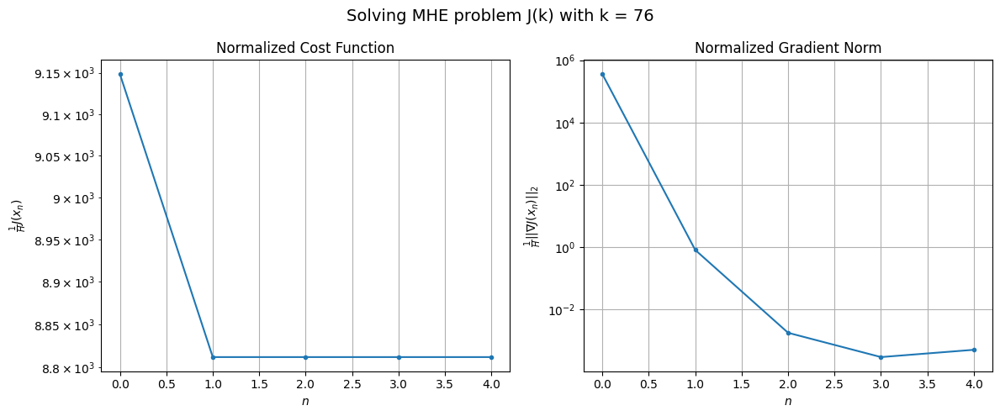

Windows:  11%|█         | 38/356 [06:00<44:11,  8.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 388522.2237433961
Gradient norm: 13290008.588341821
Global estimation error: 40.897724890079125
Initial conditions estimation errors: 22.249543982773815 m, 22.63702005608038 m, 19.625214247346 m, 16.73252092070875 m
Position estimation errors: 37.40826235746784 m, 37.898049638154056 m, 40.13060711028714 m, 40.935231956063284 m

[Gauss-Newton] Iteration 1
Cost function: 374879.5201462681 (-3.51%)
Gradient norm: 203.07436429820078 (-100.00%)
Global estimation error: 48.519710491620124 (18.64%)
Initial conditions estimation errors: 26.050984762729836 m, 27.441977640422454 m, 22.601681763508978 m, 20.287590703494377 m
Position estimation errors: 32.88201396163276 m, 32.485066605434966 m, 35.213384269938075 m, 35.30840932856373 m

[Gauss-Newton] Iteration 2
Cost function: 374879.5200861109 (-0.00%)
Gradient norm: 0.0280742894575484 (-99.99%)
Global estimation error: 48.52070235356972 (0.00%)
Initial conditions estimation errors: 26

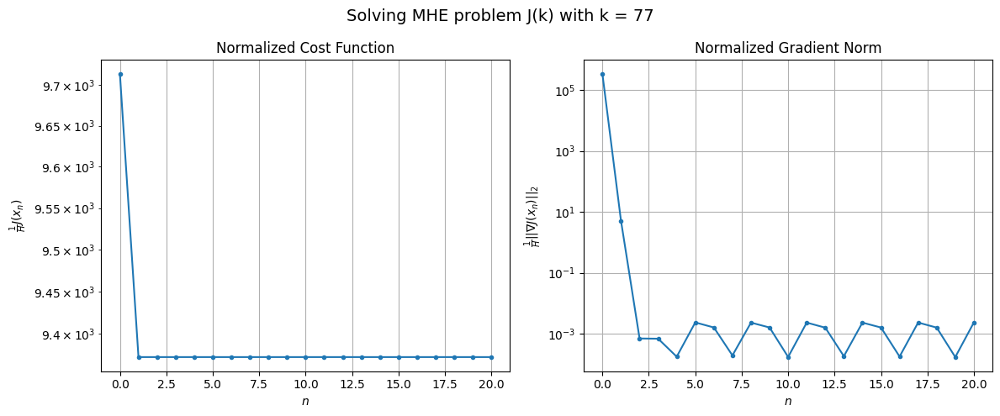

Windows:  11%|█         | 39/356 [06:22<1:06:08, 12.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 415799.2982395757
Gradient norm: 12020005.143152291
Global estimation error: 40.027822315095435
Initial conditions estimation errors: 22.019612322884406 m, 23.40120180750957 m, 18.223952614467056 m, 15.414632618959127 m
Position estimation errors: 38.45851938999341 m, 38.03002795472036 m, 41.22107497541499 m, 42.18028696059993 m

[Gauss-Newton] Iteration 1
Cost function: 402154.1607970519 (-3.28%)
Gradient norm: 44.36198579746866 (-100.00%)
Global estimation error: 48.30179276132572 (20.67%)
Initial conditions estimation errors: 25.870006341099675 m, 26.954732217712024 m, 23.003965359848856 m, 20.20004156762094 m
Position estimation errors: 34.06639856658934 m, 33.71447971508956 m, 36.38273990652941 m, 36.2919151511926 m

[Gauss-Newton] Iteration 2
Cost function: 402154.16081160126 (0.00%)
Gradient norm: 0.030837288392129607 (-99.93%)
Global estimation error: 48.300530736586914 (-0.00%)
Initial conditions estimation errors: 25

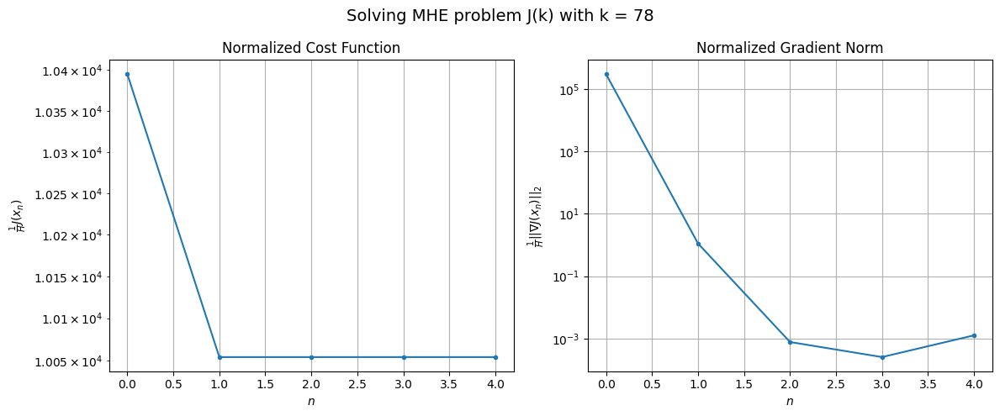

Windows:  11%|█         | 40/356 [06:28<55:24, 10.52s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 446678.236521385
Gradient norm: 10847295.849228926
Global estimation error: 39.73138426639589
Initial conditions estimation errors: 21.760357268901714 m, 22.845675808869224 m, 18.593016838683507 m, 15.40850176331782 m
Position estimation errors: 39.57517359026361 m, 39.17762469763729 m, 42.25120495342566 m, 42.854062641915135 m

[Gauss-Newton] Iteration 1
Cost function: 432818.08896227315 (-3.10%)
Gradient norm: 324.77202418377476 (-100.00%)
Global estimation error: 49.672940356962094 (25.02%)
Initial conditions estimation errors: 25.692313293152793 m, 27.40335511972496 m, 24.114130471900356 m, 21.791032550702173 m
Position estimation errors: 35.28637437093992 m, 34.36109496518067 m, 38.04568505076386 m, 39.09936201361767 m

[Gauss-Newton] Iteration 2
Cost function: 432818.088752473 (-0.00%)
Gradient norm: 0.09485910903162428 (-99.97%)
Global estimation error: 49.68618567878912 (0.03%)
Initial conditions estimation errors: 25.

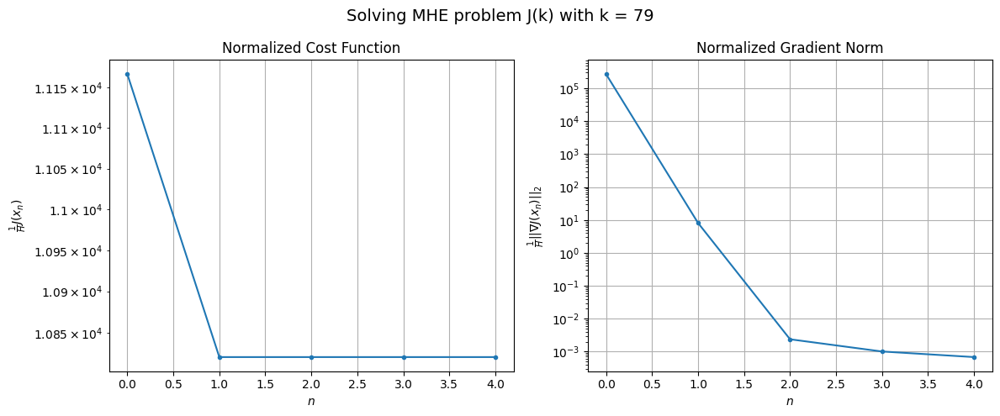

Windows:  12%|█▏        | 41/356 [06:34<48:30,  9.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 483218.8771672741
Gradient norm: 9426273.190001786
Global estimation error: 41.54352620386325
Initial conditions estimation errors: 21.636947646586496 m, 23.44890229334584 m, 19.995026754990736 m, 17.550944958428758 m
Position estimation errors: 40.71995464836291 m, 39.651321465500466 m, 43.57350479980804 m, 44.9124609817758 m

[Gauss-Newton] Iteration 1
Cost function: 469358.4742758956 (-2.87%)
Gradient norm: 34.217147779649814 (-100.00%)
Global estimation error: 50.01196406353767 (20.38%)
Initial conditions estimation errors: 25.60836440763619 m, 27.213438536669265 m, 24.283988372135315 m, 22.695903415529752 m
Position estimation errors: 36.55371909069613 m, 35.24633873899214 m, 37.78102780082813 m, 38.31785949443558 m

[Gauss-Newton] Iteration 2
Cost function: 469358.47427124094 (-0.00%)
Gradient norm: 0.05531007208561064 (-99.84%)
Global estimation error: 50.00673838096676 (-0.01%)
Initial conditions estimation errors: 25.

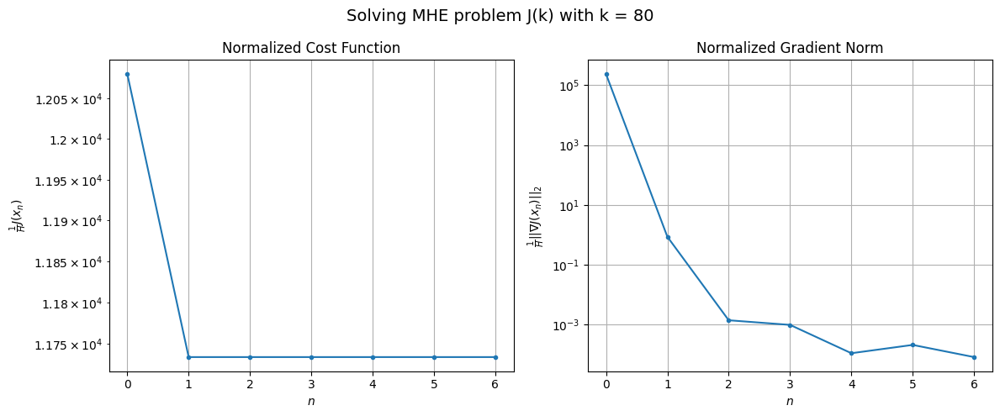

Windows:  12%|█▏        | 42/356 [06:42<46:22,  8.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 524365.1814132315
Gradient norm: 7797984.592659376
Global estimation error: 42.15275117609849
Initial conditions estimation errors: 21.712334782358848 m, 23.43396680296779 m, 20.343311706052944 m, 18.50432430738483 m
Position estimation errors: 41.92381258845829 m, 40.47915028475595 m, 43.24622526140142 m, 44.04991826747795 m

[Gauss-Newton] Iteration 1
Cost function: 510464.434267547 (-2.65%)
Gradient norm: 165.69198286196252 (-100.00%)
Global estimation error: 51.867087944699804 (23.05%)
Initial conditions estimation errors: 25.71470452829579 m, 30.10913779058268 m, 23.97576239905852 m, 23.39938173517984 m
Position estimation errors: 37.850838138292936 m, 33.85899117038951 m, 38.68690168713993 m, 36.13271860043095 m

[Gauss-Newton] Iteration 2
Cost function: 510464.4342010021 (-0.00%)
Gradient norm: 0.06619748728242213 (-99.96%)
Global estimation error: 51.878333638930386 (0.02%)
Initial conditions estimation errors: 25.7147

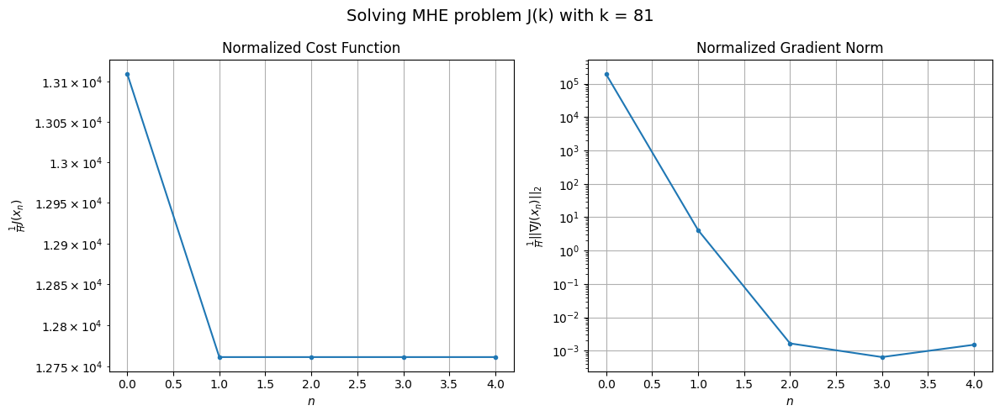

Windows:  12%|█▏        | 43/356 [06:49<42:55,  8.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 570066.3788331285
Gradient norm: 6264162.419621764
Global estimation error: 44.26053374002151
Initial conditions estimation errors: 22.043656656128324 m, 26.54266223678619 m, 20.142135596978356 m, 19.04826912625308 m
Position estimation errors: 43.19549879193923 m, 38.95783524079419 m, 44.22789059758296 m, 42.05417491177686 m

[Gauss-Newton] Iteration 1
Cost function: 556097.5823460558 (-2.45%)
Gradient norm: 212.06899420165007 (-100.00%)
Global estimation error: 55.58380699548458 (25.58%)
Initial conditions estimation errors: 26.08129788308612 m, 30.391899855767107 m, 27.219184891520733 m, 27.29023586517772 m
Position estimation errors: 39.19790353112357 m, 35.189035575686304 m, 38.03261092950599 m, 37.18052232106786 m

[Gauss-Newton] Iteration 2
Cost function: 556097.582243909 (-0.00%)
Gradient norm: 0.03627155377332832 (-99.98%)
Global estimation error: 55.59540135396806 (0.02%)
Initial conditions estimation errors: 26.0812

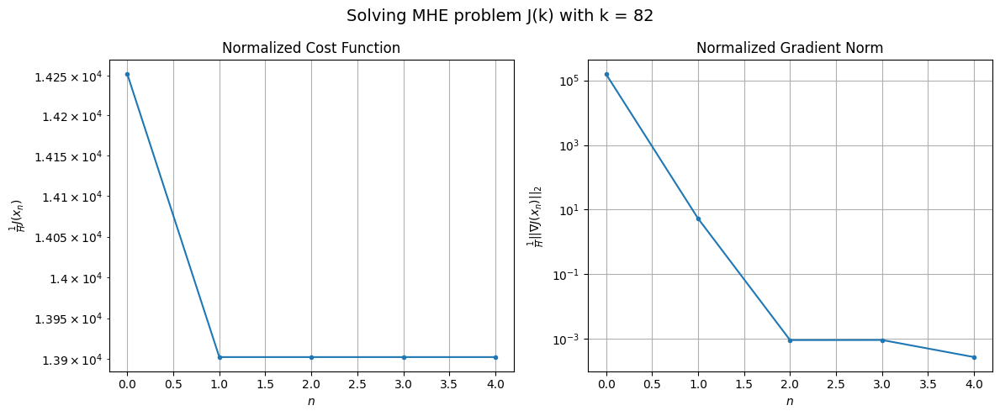

Windows:  12%|█▏        | 44/356 [06:55<39:03,  7.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 621628.5500893873
Gradient norm: 4869814.454596417
Global estimation error: 48.76981908805295
Initial conditions estimation errors: 22.65984320605891 m, 27.117202127420793 m, 23.838398692936003 m, 23.69390430307328 m
Position estimation errors: 44.572359260431114 m, 40.35333306139135 m, 43.40005157571545 m, 42.63861724978381 m

[Gauss-Newton] Iteration 1
Cost function: 607138.281929991 (-2.33%)
Gradient norm: 84.17676579959489 (-100.00%)
Global estimation error: 54.00137156207195 (10.73%)
Initial conditions estimation errors: 26.783631655494275 m, 29.990624687849046 m, 27.224612290313438 m, 23.625275583847976 m
Position estimation errors: 40.555283746634444 m, 37.64039686023894 m, 40.634561948357536 m, 43.60437381174989 m

[Gauss-Newton] Iteration 2
Cost function: 607138.2819270795 (-0.00%)
Gradient norm: 0.0634218224773113 (-99.92%)
Global estimation error: 53.99710231016098 (-0.01%)
Initial conditions estimation errors: 26.7

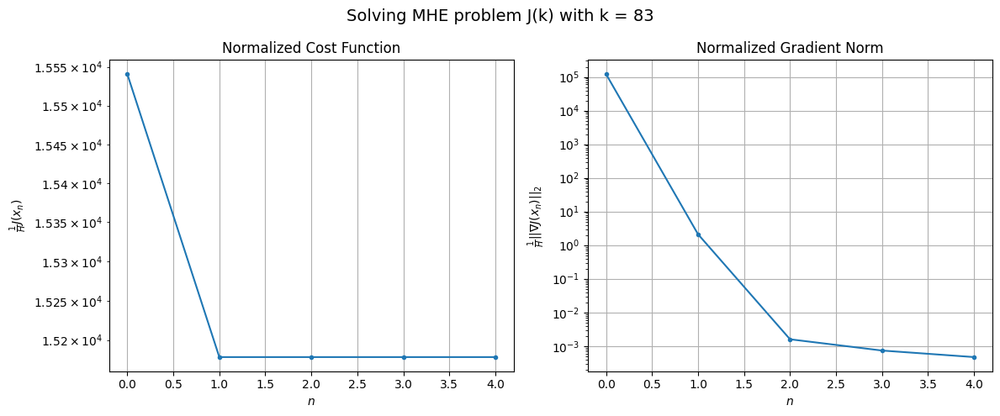

Windows:  13%|█▎        | 45/356 [07:01<37:26,  7.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 677176.8318792231
Gradient norm: 3675011.1297865636
Global estimation error: 47.73716742981943
Initial conditions estimation errors: 23.60366860098463 m, 26.93760909270875 m, 24.051695103664372 m, 20.43461608683416 m
Position estimation errors: 46.01075156289194 m, 42.93485553044191 m, 46.080458270378166 m, 49.156660616450715 m

[Gauss-Newton] Iteration 1
Cost function: 661946.8070355735 (-2.25%)
Gradient norm: 20.238590655058957 (-100.00%)
Global estimation error: 57.5986954276908 (20.66%)
Initial conditions estimation errors: 27.834147316495955 m, 32.01790793264684 m, 28.716346670072248 m, 26.326457779979066 m
Position estimation errors: 41.9221783231879 m, 38.26807838192857 m, 41.56597634319298 m, 43.740901027810764 m

[Gauss-Newton] Iteration 2
Cost function: 661946.8070270846 (-0.00%)
Gradient norm: 0.025834671363419996 (-99.87%)
Global estimation error: 57.609481140592315 (0.02%)
Initial conditions estimation errors: 27.

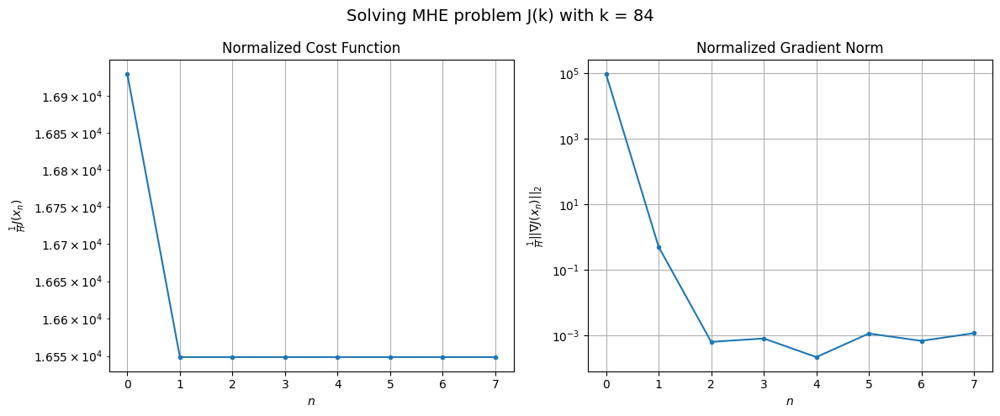

Windows:  13%|█▎        | 46/356 [07:11<40:32,  7.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 736151.5445334787
Gradient norm: 2831122.7361607235
Global estimation error: 51.7955585852915
Initial conditions estimation errors: 24.849866308572555 m, 29.131345871764225 m, 25.828208625376668 m, 23.441887357003598 m
Position estimation errors: 47.493990430686395 m, 43.64917251762934 m, 47.08178275413716 m, 49.31699336553 m

[Gauss-Newton] Iteration 1
Cost function: 719903.7095150611 (-2.21%)
Gradient norm: 25.092556299084563 (-100.00%)
Global estimation error: 58.95616749896303 (13.82%)
Initial conditions estimation errors: 29.219115206992235 m, 32.56170543412176 m, 28.958344663193046 m, 26.892585187363853 m
Position estimation errors: 43.281384132220595 m, 40.117463213669645 m, 43.84732637752439 m, 45.20512652648629 m

[Gauss-Newton] Iteration 2
Cost function: 719903.7095051899 (-0.00%)
Gradient norm: 0.14758240711697174 (-99.41%)
Global estimation error: 58.9490910019555 (-0.01%)
Initial conditions estimation errors: 29.2

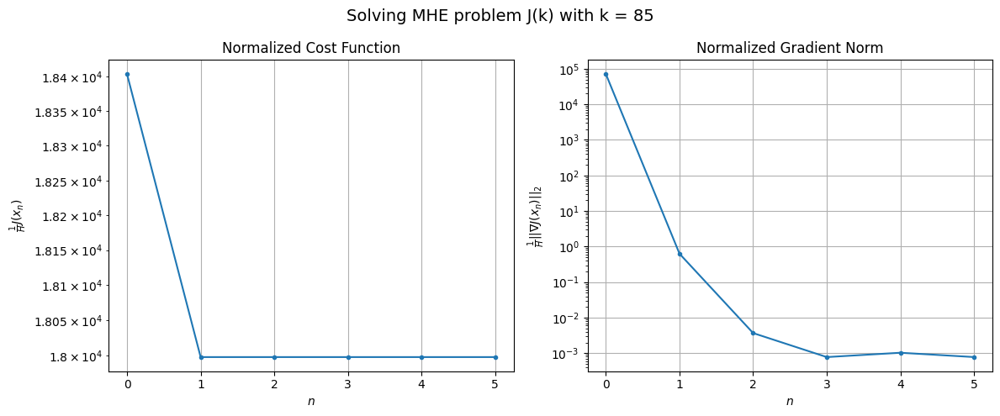

Windows:  13%|█▎        | 47/356 [07:18<39:52,  7.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 797447.7848776504
Gradient norm: 2563948.978352051
Global estimation error: 53.292761042490426
Initial conditions estimation errors: 26.3558085102612 m, 29.760865037557398 m, 26.147849467137455 m, 24.001269253786766 m
Position estimation errors: 48.97876889332078 m, 45.6704216561454 m, 49.55137015172443 m, 50.97199633253283 m

[Gauss-Newton] Iteration 1
Cost function: 779882.1042535375 (-2.20%)
Gradient norm: 767.156245682691 (-99.97%)
Global estimation error: 60.25893050795198 (13.07%)
Initial conditions estimation errors: 30.891161411151973 m, 32.390958488326596 m, 32.27362042955212 m, 24.209596208058713 m
Position estimation errors: 44.592279148592226 m, 43.87885704566813 m, 44.62144164541186 m, 56.25927586633359 m

[Gauss-Newton] Iteration 2
Cost function: 779882.1037557626 (-0.00%)
Gradient norm: 0.08260171742452085 (-99.99%)
Global estimation error: 60.26187408274521 (0.00%)
Initial conditions estimation errors: 30.89116

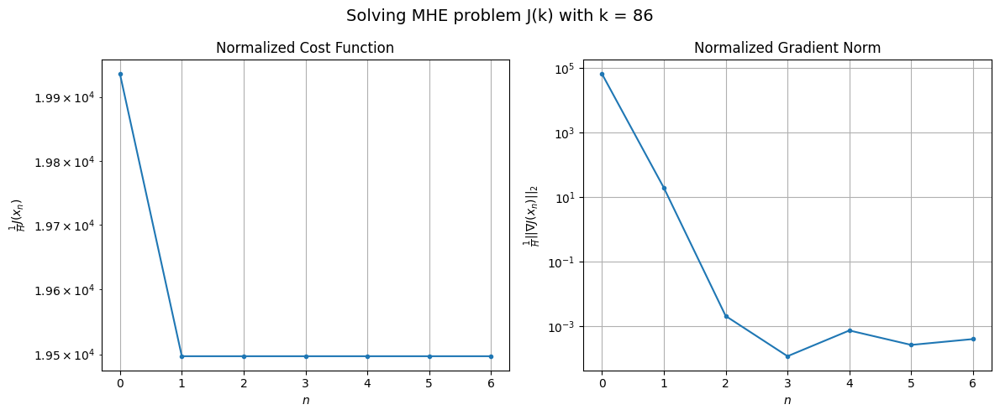

Windows:  13%|█▎        | 48/356 [07:26<40:15,  7.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 858461.0332421303
Gradient norm: 2759037.182061574
Global estimation error: 55.0967936955076
Initial conditions estimation errors: 28.063994468056507 m, 29.723183354647233 m, 29.60266123502734 m, 22.09695467291958 m
Position estimation errors: 50.39103602984964 m, 49.521770484585694 m, 50.211221319208036 m, 61.741622370393266 m

[Gauss-Newton] Iteration 1
Cost function: 839415.6666266441 (-2.22%)
Gradient norm: 49.13465308304791 (-100.00%)
Global estimation error: 66.57553386136347 (20.83%)
Initial conditions estimation errors: 32.78087296072466 m, 33.492026228238274 m, 35.76310277655542 m, 30.935281152653026 m
Position estimation errors: 45.808289369240754 m, 46.100246641156325 m, 44.568958003270325 m, 55.48022082362867 m

[Gauss-Newton] Iteration 2
Cost function: 839415.666595629 (-0.00%)
Gradient norm: 0.04242183943606222 (-99.91%)
Global estimation error: 66.58748180663851 (0.02%)
Initial conditions estimation errors: 32.7

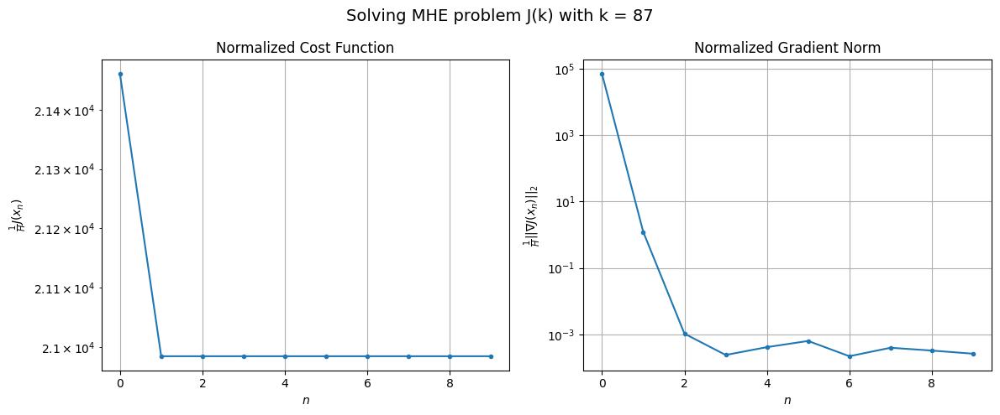

Windows:  14%|█▍        | 49/356 [07:38<45:40,  8.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 919270.6169487295
Gradient norm: 3260723.034497848
Global estimation error: 61.494637833716816
Initial conditions estimation errors: 29.909491104702262 m, 30.820207647685752 m, 33.104011636343635 m, 29.004200492186868 m
Position estimation errors: 51.6631861287603 m, 51.825022182525025 m, 50.116754259378105 m, 60.68316804554138 m

[Gauss-Newton] Iteration 1
Cost function: 898585.0924622385 (-2.25%)
Gradient norm: 54.15461105716323 (-100.00%)
Global estimation error: 73.57477124541379 (19.64%)
Initial conditions estimation errors: 34.8187894500608 m, 35.73531443223513 m, 38.86093432155812 m, 37.5992586686317 m
Position estimation errors: 46.8662044806318 m, 46.96898779037561 m, 44.6007793821043 m, 52.277955567818154 m

[Gauss-Newton] Iteration 2
Cost function: 898585.0924412715 (-0.00%)
Gradient norm: 0.06620156768484792 (-99.88%)
Global estimation error: 73.59149070412879 (0.02%)
Initial conditions estimation errors: 34.818791

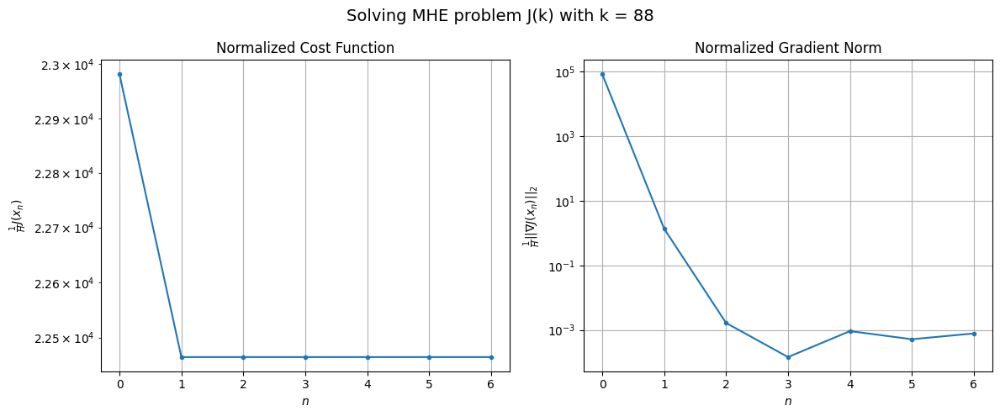

Windows:  14%|█▍        | 50/356 [07:46<44:03,  8.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 977203.728983687
Gradient norm: 3753219.714563087
Global estimation error: 68.24251600638499
Initial conditions estimation errors: 31.82707813114926 m, 32.94063505359124 m, 36.0584556570498 m, 35.47916098517349 m
Position estimation errors: 52.73277134938151 m, 52.72839985896829 m, 50.145672986138344 m, 57.38994602300096 m

[Gauss-Newton] Iteration 1
Cost function: 954696.6077194434 (-2.30%)
Gradient norm: 37.3656441717996 (-100.00%)
Global estimation error: 79.32108525605135 (16.23%)
Initial conditions estimation errors: 36.94236296235274 m, 38.333511485149046 m, 40.81788282853741 m, 42.32644191722019 m
Position estimation errors: 47.70671951751769 m, 47.31490417331954 m, 45.275094621172165 m, 50.07589498196914 m

[Gauss-Newton] Iteration 2
Cost function: 954696.6077077211 (-0.00%)
Gradient norm: 0.019002627529248677 (-99.95%)
Global estimation error: 79.32826075988916 (0.01%)
Initial conditions estimation errors: 36.94236508

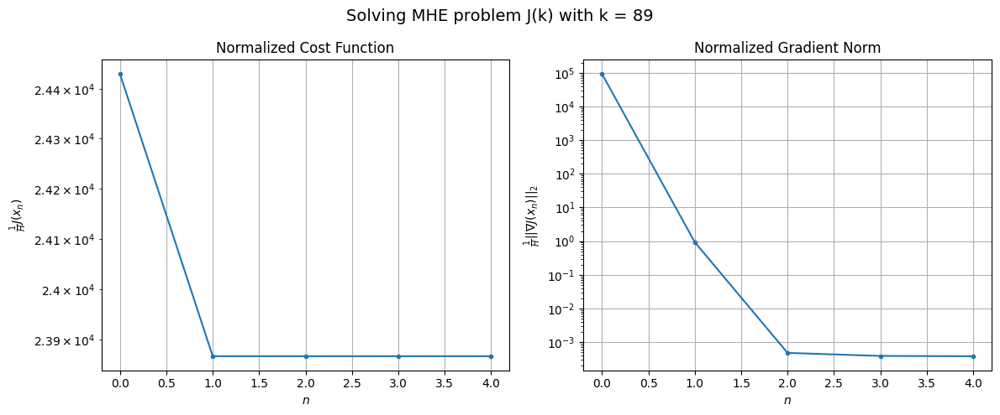

Windows:  14%|█▍        | 51/356 [07:52<40:03,  7.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1029032.5037486483
Gradient norm: 4075793.1386334966
Global estimation error: 73.54216106623426
Initial conditions estimation errors: 33.762132184762415 m, 35.33103692349988 m, 37.82143715938787 m, 39.87246064943498 m
Position estimation errors: 53.56249630871662 m, 53.09546513951289 m, 50.884059180107094 m, 55.17726428505247 m

[Gauss-Newton] Iteration 1
Cost function: 1004936.6289909978 (-2.34%)
Gradient norm: 104.07137136280537 (-100.00%)
Global estimation error: 85.38618356560347 (16.11%)
Initial conditions estimation errors: 39.06152212182857 m, 41.981567451441975 m, 42.737232420280726 m, 46.64827284636634 m
Position estimation errors: 48.3487430076053 m, 46.119323993308825 m, 45.84208317810924 m, 46.37756551186485 m

[Gauss-Newton] Iteration 2
Cost function: 1004936.6289690272 (-0.00%)
Gradient norm: 0.006831586074339221 (-99.99%)
Global estimation error: 85.38183352736645 (-0.01%)
Initial conditions estimation errors: 3

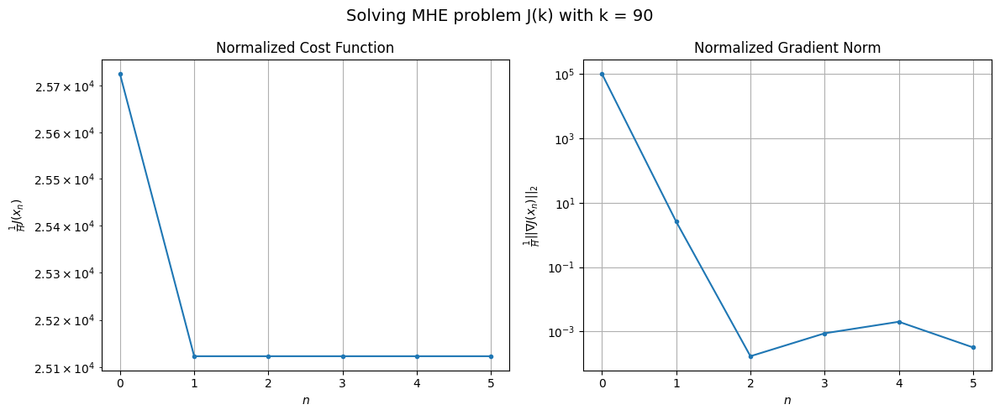

Windows:  15%|█▍        | 52/356 [07:58<38:00,  7.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1076202.6190252788
Gradient norm: 4318858.585158642
Global estimation error: 78.95669691979528
Initial conditions estimation errors: 35.64154293492474 m, 38.66274400719307 m, 39.4952679506008 m, 43.69373061437189 m
Position estimation errors: 54.200368363402845 m, 51.915129358266256 m, 51.55538688167346 m, 51.649079628230375 m

[Gauss-Newton] Iteration 1
Cost function: 1050553.0954549026 (-2.38%)
Gradient norm: 97.03513341079736 (-100.00%)
Global estimation error: 88.13959239905046 (11.63%)
Initial conditions estimation errors: 41.10058932397515 m, 43.407501284796396 m, 44.607599269465155 m, 46.96024449221049 m
Position estimation errors: 48.7999533922881 m, 47.22981941923144 m, 46.413865570629966 m, 49.984447755573385 m

[Gauss-Newton] Iteration 2
Cost function: 1050553.0954746795 (0.00%)
Gradient norm: 0.021522050043788495 (-99.98%)
Global estimation error: 88.13487205096534 (-0.01%)
Initial conditions estimation errors: 41.

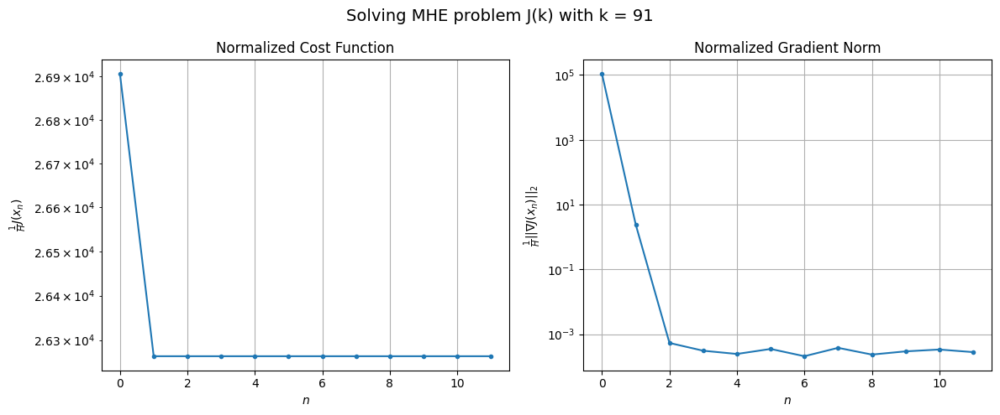

Windows:  15%|█▍        | 53/356 [08:12<46:16,  9.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1114794.1283547701
Gradient norm: 4356958.558420104
Global estimation error: 81.2806927878344
Initial conditions estimation errors: 37.41166141881378 m, 39.84571043188725 m, 41.092912021965724 m, 43.93852314454557 m
Position estimation errors: 54.666540225566585 m, 53.01129421737554 m, 52.11521496737552 m, 55.197604821709895 m

[Gauss-Newton] Iteration 1
Cost function: 1087611.3903417839 (-2.44%)
Gradient norm: 110.81403258001014 (-100.00%)
Global estimation error: 90.84114682143228 (11.76%)
Initial conditions estimation errors: 43.033828428820165 m, 45.951734874736054 m, 44.78461607610376 m, 47.78033572053635 m
Position estimation errors: 49.10104084753579 m, 46.34356885319158 m, 48.15110267379409 m, 48.160879903210194 m

[Gauss-Newton] Iteration 2
Cost function: 1087611.3903275453 (-0.00%)
Gradient norm: 0.07862592061647879 (-99.93%)
Global estimation error: 90.83261059414933 (-0.01%)
Initial conditions estimation errors: 43

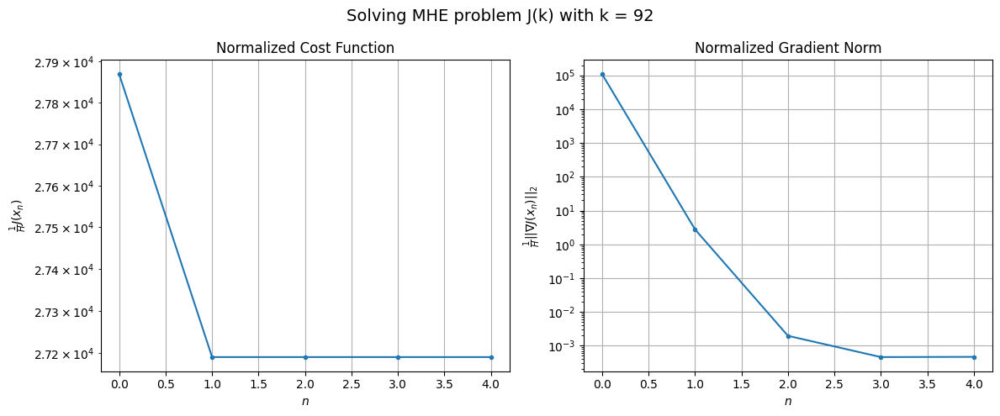

Windows:  15%|█▌        | 54/356 [08:18<41:26,  8.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1145597.151418227
Gradient norm: 4242784.951585027
Global estimation error: 83.20161230510854
Initial conditions estimation errors: 39.06353600602116 m, 42.02867412510548 m, 40.98519683467608 m, 44.16256653516415 m
Position estimation errors: 55.002848493594804 m, 52.20819167725391 m, 54.00765610258454 m, 53.70320157924075 m

[Gauss-Newton] Iteration 1
Cost function: 1117118.997922945 (-2.49%)
Gradient norm: 41.09225784245339 (-100.00%)
Global estimation error: 92.56775053488361 (11.26%)
Initial conditions estimation errors: 44.82046405263617 m, 47.766452090265076 m, 45.59053067430406 m, 46.901610677301946 m
Position estimation errors: 49.30713088917465 m, 46.14031770800404 m, 49.318347244466054 m, 49.5995491493561 m

[Gauss-Newton] Iteration 2
Cost function: 1117118.9979084497 (-0.00%)
Gradient norm: 0.0560449015857473 (-99.86%)
Global estimation error: 92.5417497085436 (-0.03%)
Initial conditions estimation errors: 44.820466

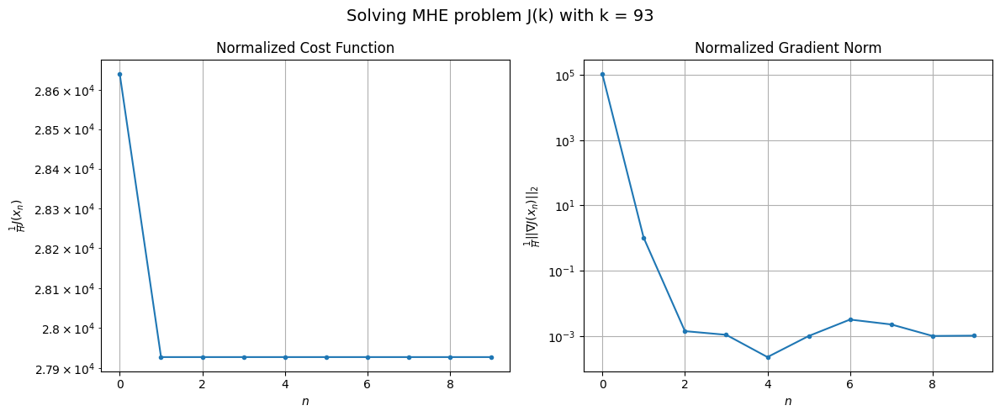

Windows:  15%|█▌        | 55/356 [08:29<46:17,  9.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1168898.3617461957
Gradient norm: 3917497.0079704705
Global estimation error: 84.23829385765313
Initial conditions estimation errors: 40.571103368503344 m, 43.50009490999702 m, 41.468175669093576 m, 42.87405045354508 m
Position estimation errors: 55.25190384600387 m, 52.06693045906075 m, 55.247679108605915 m, 55.386756481941944 m

[Gauss-Newton] Iteration 1
Cost function: 1139175.7956171473 (-2.54%)
Gradient norm: 104.35521786236224 (-100.00%)
Global estimation error: 96.75080311358046 (14.85%)
Initial conditions estimation errors: 46.44900103940679 m, 49.77135229449288 m, 46.93097864983683 m, 50.23422359133461 m
Position estimation errors: 49.434503820368064 m, 45.51128665215221 m, 49.822027119479095 m, 46.302734661845655 m

[Gauss-Newton] Iteration 2
Cost function: 1139175.7955862782 (-0.00%)
Gradient norm: 0.01394662411490452 (-99.99%)
Global estimation error: 96.77018960423294 (0.02%)
Initial conditions estimation errors: 

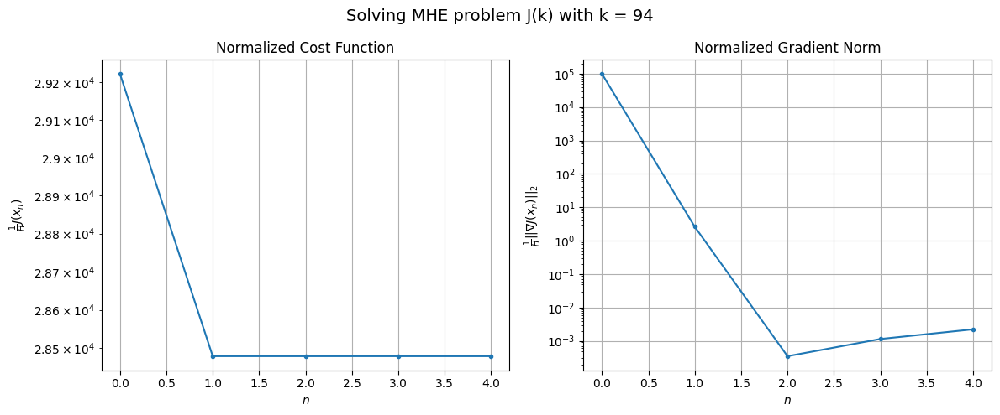

Windows:  16%|█▌        | 56/356 [08:36<42:10,  8.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1183501.498287308
Gradient norm: 3565239.826515443
Global estimation error: 87.78746341331563
Initial conditions estimation errors: 41.92846745858926 m, 45.18115118203264 m, 42.55650431123498 m, 45.78452432180527 m
Position estimation errors: 55.402854141336874 m, 51.48813231079316 m, 55.78364155749791 m, 52.154265641569644 m

[Gauss-Newton] Iteration 1
Cost function: 1152744.7237403898 (-2.60%)
Gradient norm: 55.58452241026225 (-100.00%)
Global estimation error: 97.65253431163428 (11.24%)
Initial conditions estimation errors: 47.90586787372644 m, 50.353403646944834 m, 48.703114445708785 m, 48.30690197544276 m
Position estimation errors: 49.49421984856688 m, 46.46677415732233 m, 49.5585484712634 m, 49.25849476151742 m

[Gauss-Newton] Iteration 2
Cost function: 1152744.7237450643 (0.00%)
Gradient norm: 0.03248874518132116 (-99.94%)
Global estimation error: 97.6513186058753 (-0.00%)
Initial conditions estimation errors: 47.90587

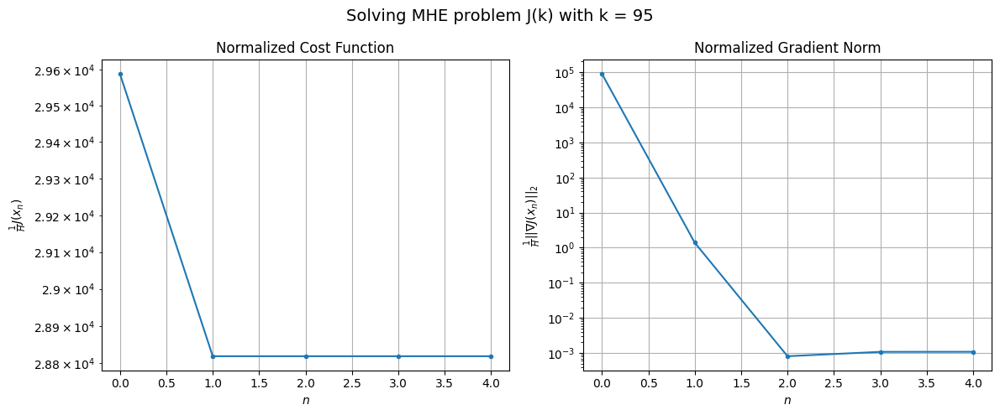

Windows:  16%|█▌        | 57/356 [08:42<38:35,  7.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1191122.729000281
Gradient norm: 3365257.159255236
Global estimation error: 88.08094907046932
Initial conditions estimation errors: 43.11537341259681 m, 45.48554764798682 m, 43.95432732267934 m, 43.57028898117587 m
Position estimation errors: 55.45296251282293 m, 52.4351039164407 m, 55.48028297270921 m, 55.23723587996469 m

[Gauss-Newton] Iteration 1
Cost function: 1159613.181074173 (-2.65%)
Gradient norm: 78.75591874853298 (-100.00%)
Global estimation error: 97.68934253930809 (10.91%)
Initial conditions estimation errors: 49.15992202702477 m, 50.48582757096471 m, 50.181842103487114 m, 45.381060139793036 m
Position estimation errors: 49.482071166104895 m, 47.32532497844634 m, 49.46265360650124 m, 52.935685907859394 m

[Gauss-Newton] Iteration 2
Cost function: 1159613.1810723958 (-0.00%)
Gradient norm: 0.014800956495756875 (-99.98%)
Global estimation error: 97.68212398106503 (-0.01%)
Initial conditions estimation errors: 49.159

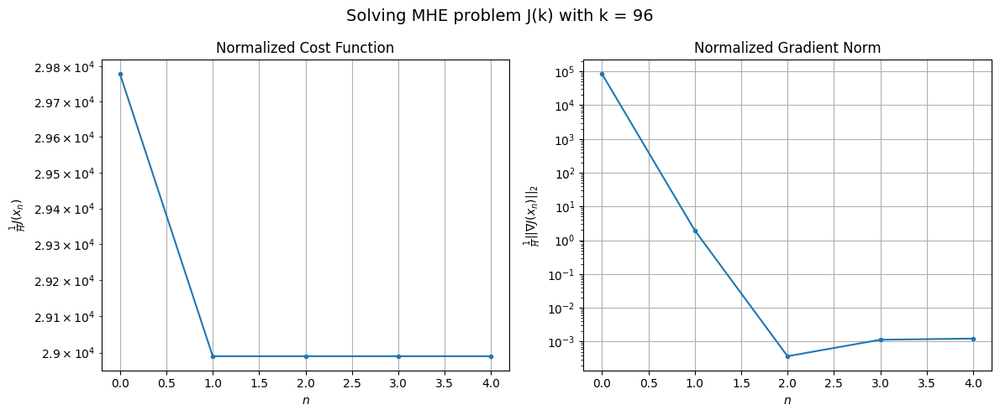

Windows:  16%|█▋        | 58/356 [08:48<36:30,  7.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1190935.1539034182
Gradient norm: 3328777.2718323325
Global estimation error: 87.52062236878943
Initial conditions estimation errors: 44.098733622433926 m, 45.3119257484514 m, 45.068793554248735 m, 40.382683063320336 m
Position estimation errors: 55.42531352859818 m, 53.31008031628746 m, 55.35637755834687 m, 59.02637630541738 m

[Gauss-Newton] Iteration 1
Cost function: 1158642.4663774942 (-2.71%)
Gradient norm: 87.2361360455612 (-100.00%)
Global estimation error: 97.92419564310123 (11.89%)
Initial conditions estimation errors: 50.210426613877644 m, 51.32590714467359 m, 49.4876627514877 m, 44.54937874126645 m
Position estimation errors: 49.38866005269599 m, 46.83586866290104 m, 51.07424539197535 m, 52.48308099428185 m

[Gauss-Newton] Iteration 2
Cost function: 1158642.4663890188 (0.00%)
Gradient norm: 0.037104479525532315 (-99.96%)
Global estimation error: 97.92680498990049 (0.00%)
Initial conditions estimation errors: 50.2104

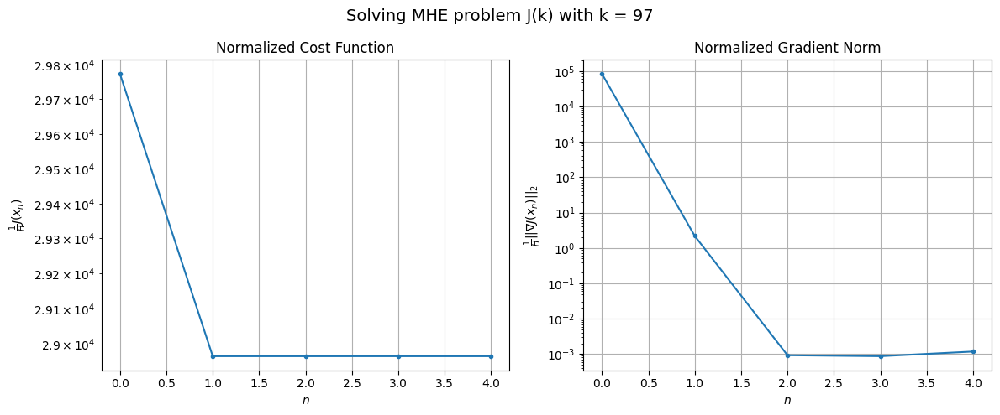

Windows:  17%|█▋        | 59/356 [08:55<34:57,  7.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1185227.4461474249
Gradient norm: 3442346.5200686622
Global estimation error: 87.15705537787936
Initial conditions estimation errors: 44.88913586760272 m, 45.8329542876446 m, 44.17680541210276 m, 39.10283033308098 m
Position estimation errors: 55.36237422874484 m, 52.90006561096174 m, 57.01381625374261 m, 58.83427268785683 m

[Gauss-Newton] Iteration 1
Cost function: 1152681.2602012502 (-2.75%)
Gradient norm: 198.4346150035183 (-99.99%)
Global estimation error: 94.38269958761967 (8.29%)
Initial conditions estimation errors: 51.01146207560039 m, 50.80516580804861 m, 48.49194286519321 m, 37.057408260218615 m
Position estimation errors: 49.306471430920794 m, 47.10407126194487 m, 53.182201381263994 m, 58.45232732876432 m

[Gauss-Newton] Iteration 2
Cost function: 1152681.2600997412 (-0.00%)
Gradient norm: 0.037676974770631054 (-99.98%)
Global estimation error: 94.34162555302329 (-0.04%)
Initial conditions estimation errors: 51.011

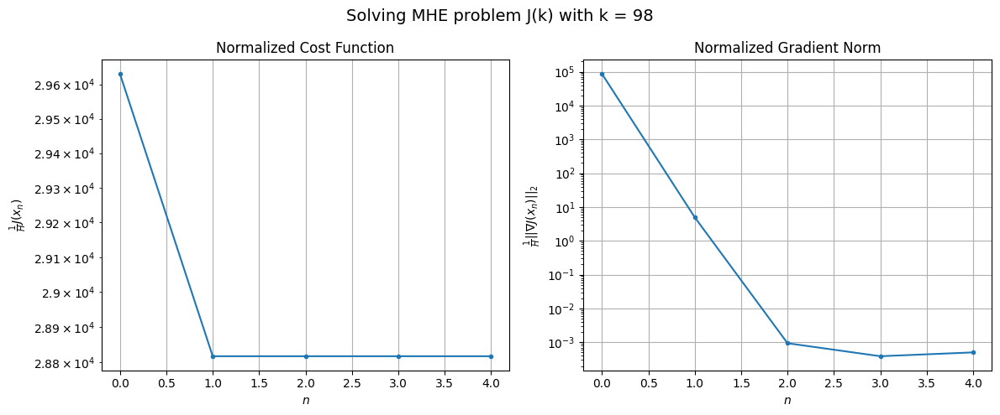

Windows:  17%|█▋        | 60/356 [09:02<34:44,  7.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1176498.14171512
Gradient norm: 3608451.5193282054
Global estimation error: 83.11577354722439
Initial conditions estimation errors: 45.452753682370044 m, 44.961101827675684 m, 42.93661423288325 m, 31.259970186549612 m
Position estimation errors: 55.38671251869029 m, 53.41752203722572 m, 59.2695463839458 m, 65.357054408587 m

[Gauss-Newton] Iteration 1
Cost function: 1143475.0478504894 (-2.81%)
Gradient norm: 80.94092902441083 (-100.00%)
Global estimation error: 92.74309751860633 (11.58%)
Initial conditions estimation errors: 51.60411998937304 m, 50.57310102005954 m, 48.023049486109834 m, 32.77807007167815 m
Position estimation errors: 49.28804253064795 m, 47.00925665441775 m, 54.544182688938335 m, 61.28404811419829 m

[Gauss-Newton] Iteration 2
Cost function: 1143475.0478100427 (-0.00%)
Gradient norm: 0.10008642569653514 (-99.88%)
Global estimation error: 92.73340573875966 (-0.01%)
Initial conditions estimation errors: 51.6041

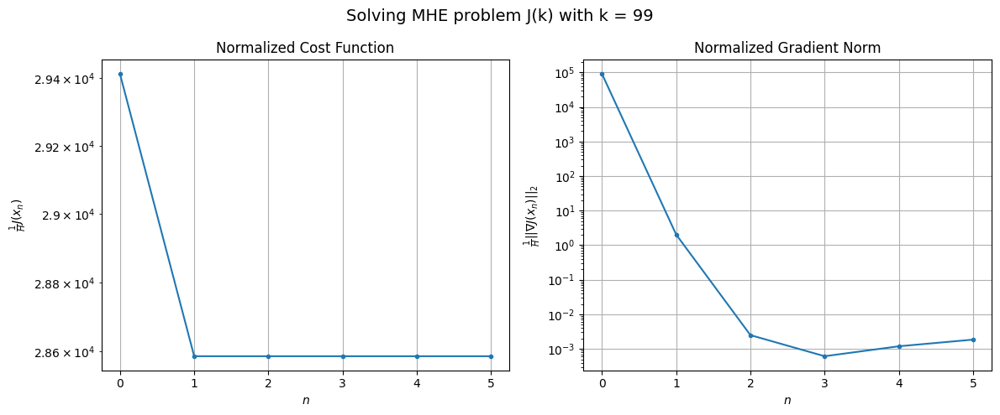

Windows:  17%|█▋        | 61/356 [09:09<35:23,  7.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1164620.0022785985
Gradient norm: 3848576.779931151
Global estimation error: 81.12942724115017
Initial conditions estimation errors: 45.82983417137968 m, 44.438806588456245 m, 42.3118281106251 m, 26.76693390229542 m
Position estimation errors: 55.52774060222514 m, 53.57752487371577 m, 60.758871970446236 m, 68.60371530662749 m

[Gauss-Newton] Iteration 1
Cost function: 1131401.2308966748 (-2.85%)
Gradient norm: 97.34977188255802 (-100.00%)
Global estimation error: 93.96417875212622 (15.82%)
Initial conditions estimation errors: 51.979614287381786 m, 50.05758405825675 m, 49.40248140130749 m, 34.36528637919346 m
Position estimation errors: 49.40824180284978 m, 47.622413275832415 m, 54.24825262337031 m, 59.93278501025011 m

[Gauss-Newton] Iteration 2
Cost function: 1131401.2308797026 (-0.00%)
Gradient norm: 0.08798107334669966 (-99.91%)
Global estimation error: 93.98265493859564 (0.02%)
Initial conditions estimation errors: 51.979

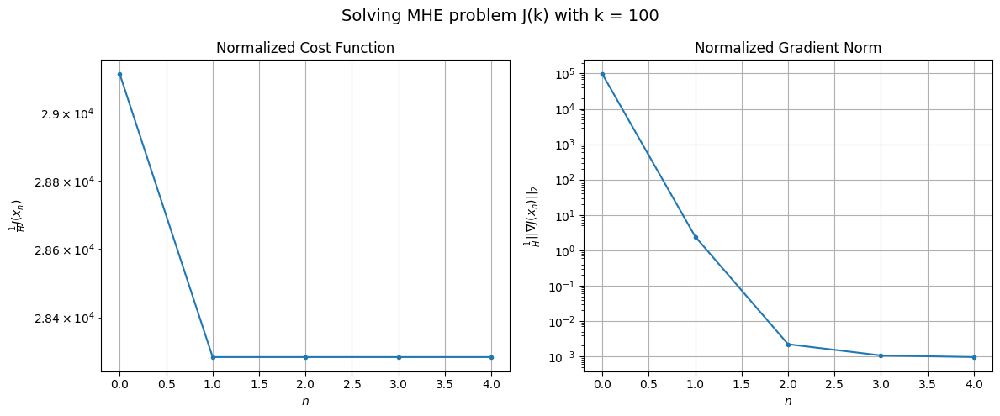

Windows:  17%|█▋        | 62/356 [09:16<34:01,  6.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1152732.5048044673
Gradient norm: 4007166.233958263
Global estimation error: 81.871205342587
Initial conditions estimation errors: 46.00201218709794 m, 43.67760594849162 m, 43.48966597611661 m, 28.06381906327684 m
Position estimation errors: 55.80711766284944 m, 54.41476819527695 m, 60.570727276841836 m, 67.35903263964325 m

[Gauss-Newton] Iteration 1
Cost function: 1118989.4416036594 (-2.93%)
Gradient norm: 410.98648137369213 (-99.99%)
Global estimation error: 101.6692125326003 (24.18%)
Initial conditions estimation errors: 52.17789558028117 m, 51.33156134349564 m, 53.40166462460457 m, 46.123524543476755 m
Position estimation errors: 49.633622590506256 m, 47.70890255245074 m, 50.375688553580794 m, 52.8419570237935 m

[Gauss-Newton] Iteration 2
Cost function: 1118989.4411661283 (-0.00%)
Gradient norm: 0.14840670005347176 (-99.96%)
Global estimation error: 101.69486827986654 (0.03%)
Initial conditions estimation errors: 52.1778

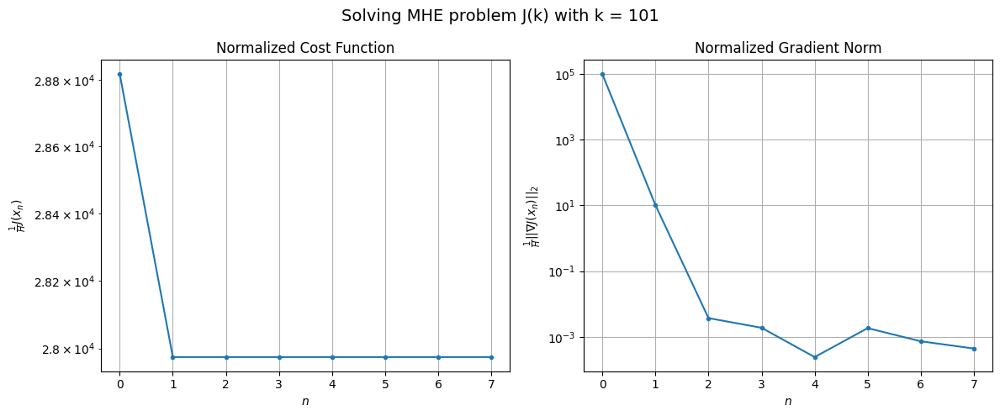

Windows:  18%|█▊        | 63/356 [09:25<36:52,  7.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1140006.524583763
Gradient norm: 4284729.481241737
Global estimation error: 89.04933796378556
Initial conditions estimation errors: 46.001999862704615 m, 44.835446481786775 m, 47.200442684469465 m, 39.69196111191854 m
Position estimation errors: 56.15023610487368 m, 54.51760237119874 m, 56.805723240119235 m, 59.75388903670158 m

[Gauss-Newton] Iteration 1
Cost function: 1106057.441471313 (-2.98%)
Gradient norm: 230.9359841961214 (-99.99%)
Global estimation error: 107.93017649841758 (21.20%)
Initial conditions estimation errors: 52.171129070441516 m, 53.1220625679854 m, 54.436376957743484 m, 56.051510343468074 m
Position estimation errors: 49.94767775172523 m, 47.28502974498778 m, 49.1090778563214 m, 47.11715791538034 m

[Gauss-Newton] Iteration 2
Cost function: 1106057.4412286119 (-0.00%)
Gradient norm: 0.1326255011803324 (-99.94%)
Global estimation error: 107.9502130941927 (0.02%)
Initial conditions estimation errors: 52.1711

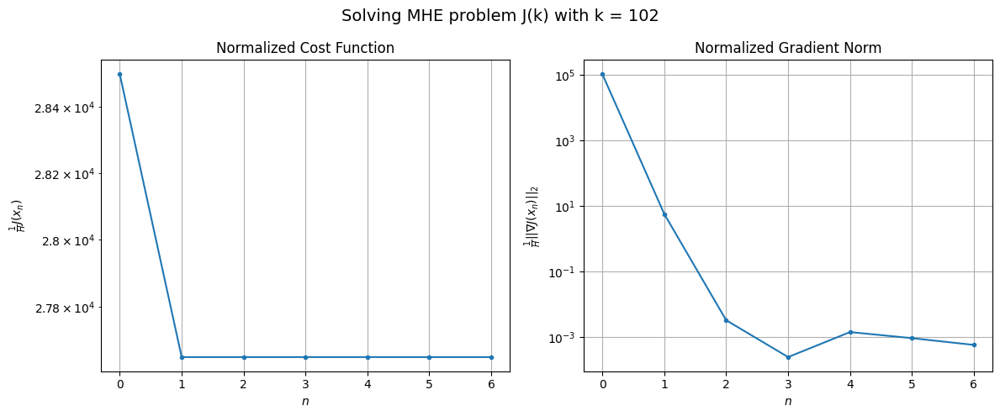

Windows:  18%|█▊        | 64/356 [09:32<37:12,  7.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1129250.7758296656
Gradient norm: 4469163.314284908
Global estimation error: 95.0201680533653
Initial conditions estimation errors: 45.81035297218666 m, 46.50079605749229 m, 48.05871029018895 m, 49.5805243235782 m
Position estimation errors: 56.540842041334116 m, 54.057919686237604 m, 55.567175149499434 m, 53.627582447279984 m

[Gauss-Newton] Iteration 1
Cost function: 1095228.613937169 (-3.01%)
Gradient norm: 72.61070685858978 (-100.00%)
Global estimation error: 108.34953369445702 (14.03%)
Initial conditions estimation errors: 51.96036257276917 m, 53.085784539189895 m, 54.06367829884745 m, 57.434370108205606 m
Position estimation errors: 50.31795852670453 m, 48.05727722196496 m, 49.40054498482706 m, 47.97498656558264 m

[Gauss-Newton] Iteration 2
Cost function: 1095228.6139215343 (-0.00%)
Gradient norm: 0.039655867418596086 (-99.95%)
Global estimation error: 108.3374109694283 (-0.01%)
Initial conditions estimation errors: 51.

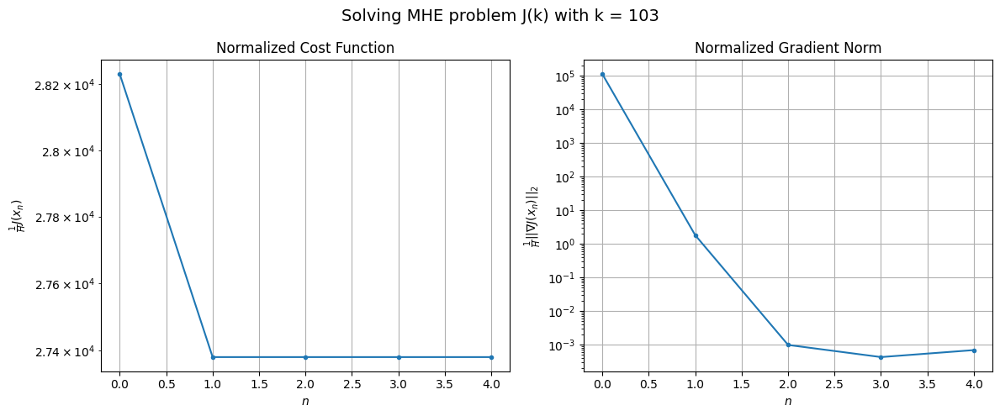

Windows:  18%|█▊        | 65/356 [09:39<35:17,  7.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1120790.5607772477
Gradient norm: 4525180.929501705
Global estimation error: 95.2417290987775
Initial conditions estimation errors: 45.450616485417314 m, 46.3619451250992 m, 47.53782426340471 m, 50.94998615430735 m
Position estimation errors: 56.99070431442385 m, 54.863793844230486 m, 55.95813073986955 m, 54.36976850409319 m

[Gauss-Newton] Iteration 1
Cost function: 1086690.1905605823 (-3.04%)
Gradient norm: 97.13617426640167 (-100.00%)
Global estimation error: 103.65001900655233 (8.83%)
Initial conditions estimation errors: 51.58619306006198 m, 52.1094800913585 m, 52.09859040025525 m, 51.50218417259824 m
Position estimation errors: 50.74859918860136 m, 48.47402684578947 m, 51.45467308127463 m, 51.71967604048843 m

[Gauss-Newton] Iteration 2
Cost function: 1086690.1905240675 (-0.00%)
Gradient norm: 0.009976676344502935 (-99.99%)
Global estimation error: 103.64484727666475 (-0.00%)
Initial conditions estimation errors: 51.5861

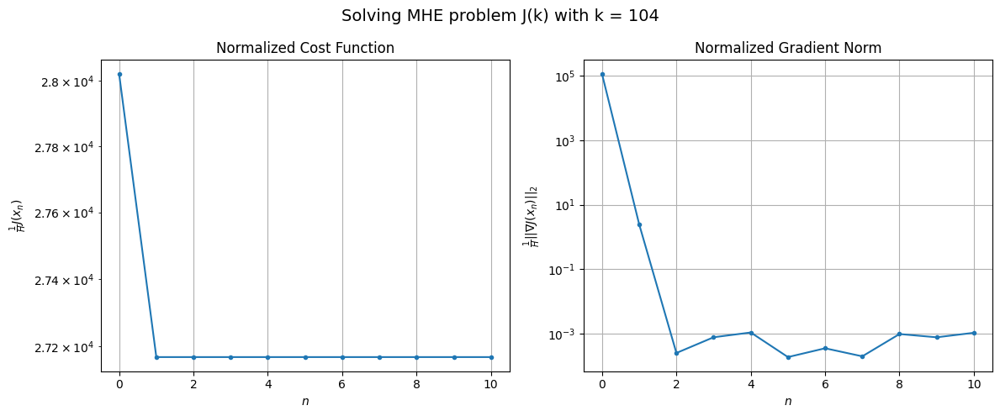

Windows:  19%|█▊        | 66/356 [09:51<41:55,  8.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1119915.1529501718
Gradient norm: 4548955.168295677
Global estimation error: 90.35169846018267
Initial conditions estimation errors: 44.98927567687877 m, 45.263934415199245 m, 45.57208951203597 m, 44.87429490415075 m
Position estimation errors: 57.56745166307543 m, 55.48327436063671 m, 58.15738146428707 m, 58.49512372090167 m

[Gauss-Newton] Iteration 1
Cost function: 1085706.0041230875 (-3.05%)
Gradient norm: 148.44202508195178 (-100.00%)
Global estimation error: 106.5394191580309 (17.92%)
Initial conditions estimation errors: 51.11835036812263 m, 53.22420753591508 m, 51.028367805861365 m, 57.45255838370968 m
Position estimation errors: 51.302173663393035 m, 48.11633832915132 m, 51.77592634390134 m, 47.55454404085816 m

[Gauss-Newton] Iteration 2
Cost function: 1085706.0040656466 (-0.00%)
Gradient norm: 0.051051412410827265 (-99.97%)
Global estimation error: 106.541049303343 (0.00%)
Initial conditions estimation errors: 51.11

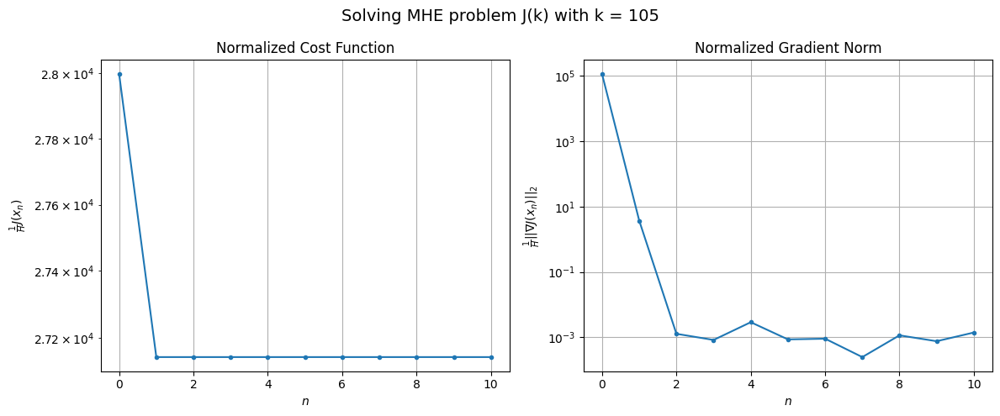

Windows:  19%|█▉        | 67/356 [10:03<46:25,  9.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1125588.3388603716
Gradient norm: 4523950.526772279
Global estimation error: 93.29729944034848
Initial conditions estimation errors: 44.51387418565702 m, 46.423277072173654 m, 44.46073773275043 m, 50.90158489502889 m
Position estimation errors: 58.3673679696758 m, 55.28581293561708 m, 58.772324827228715 m, 54.35435688654104 m

[Gauss-Newton] Iteration 1
Cost function: 1091127.1763844625 (-3.06%)
Gradient norm: 160.76574361365795 (-100.00%)
Global estimation error: 109.05391582896672 (16.89%)
Initial conditions estimation errors: 50.6570594119477 m, 54.34208043111685 m, 50.48774855211029 m, 61.842471887545265 m
Position estimation errors: 52.07079523365585 m, 48.512548569029164 m, 51.39596086174492 m, 46.31269061305053 m

[Gauss-Newton] Iteration 2
Cost function: 1091127.1763111162 (-0.00%)
Gradient norm: 0.06272358750612926 (-99.96%)
Global estimation error: 109.04126184513956 (-0.01%)
Initial conditions estimation errors: 50.

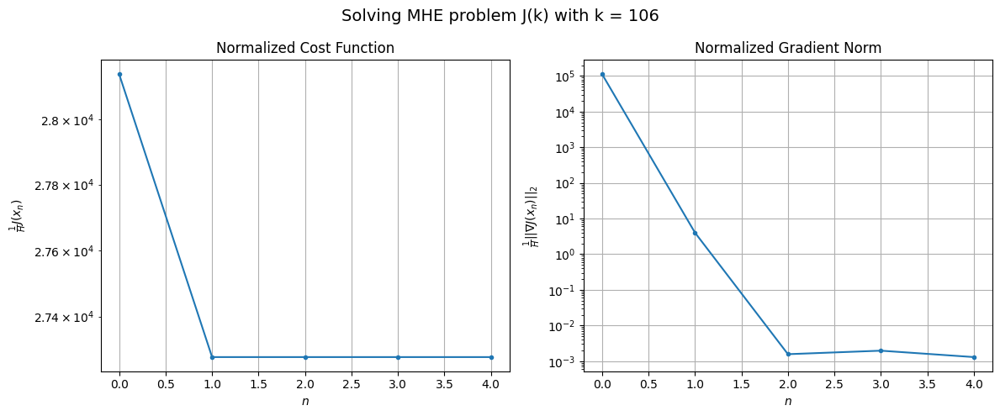

Windows:  19%|█▉        | 68/356 [10:09<41:41,  8.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1139500.0990548534
Gradient norm: 4492028.626701253
Global estimation error: 96.08006273813373
Initial conditions estimation errors: 44.107498883036 m, 47.70912251167788 m, 43.812234701558175 m, 55.589434722937725 m
Position estimation errors: 59.448298145454764 m, 55.85383769450257 m, 58.82722075840588 m, 53.10861278798004 m

[Gauss-Newton] Iteration 1
Cost function: 1104607.087151458 (-3.06%)
Gradient norm: 63.82002032306576 (-100.00%)
Global estimation error: 110.53759140956646 (15.05%)
Initial conditions estimation errors: 50.290578264039944 m, 54.174729748015324 m, 50.262325245248434 m, 65.02433051531806 m
Position estimation errors: 53.11050587295366 m, 50.13709653245761 m, 52.121588901179216 m, 45.45339337031498 m

[Gauss-Newton] Iteration 2
Cost function: 1104607.087134151 (-0.00%)
Gradient norm: 0.07924558928198185 (-99.88%)
Global estimation error: 110.53074810857026 (-0.01%)
Initial conditions estimation errors: 50.

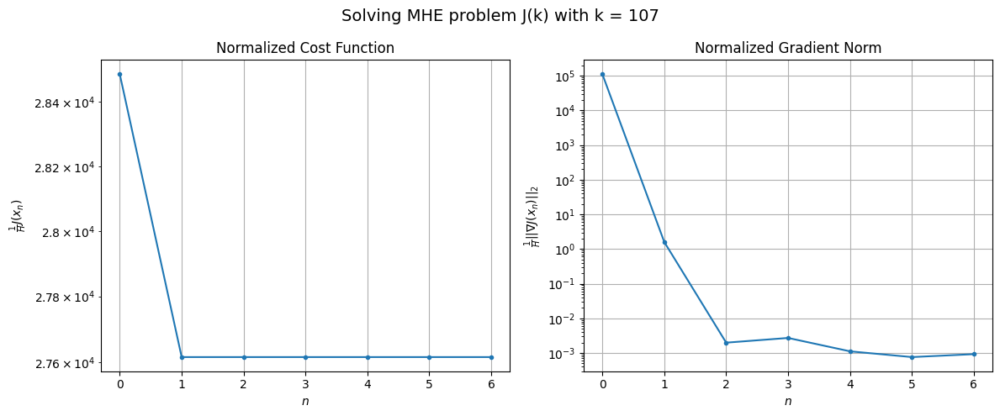

Windows:  19%|█▉        | 69/356 [10:17<40:48,  8.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1162458.8099896568
Gradient norm: 4528421.511090406
Global estimation error: 97.87297857054612
Initial conditions estimation errors: 43.820325974347384 m, 47.70912998339658 m, 43.59318114558155 m, 59.01122977747525 m
Position estimation errors: 60.78481988392636 m, 57.680855815634416 m, 59.846469403444736 m, 52.36710870115668 m

[Gauss-Newton] Iteration 1
Cost function: 1126918.8509439866 (-3.06%)
Gradient norm: 141.98621363784994 (-100.00%)
Global estimation error: 105.33890089941515 (7.63%)
Initial conditions estimation errors: 50.06716786302233 m, 51.336518254943556 m, 49.43637485751272 m, 59.24627600505178 m
Position estimation errors: 54.39107517653066 m, 54.24497909886131 m, 54.34766590891961 m, 51.172998308774275 m

[Gauss-Newton] Iteration 2
Cost function: 1126918.850898922 (-0.00%)
Gradient norm: 0.05918107202393795 (-99.96%)
Global estimation error: 105.34167414678191 (0.00%)
Initial conditions estimation errors: 50.

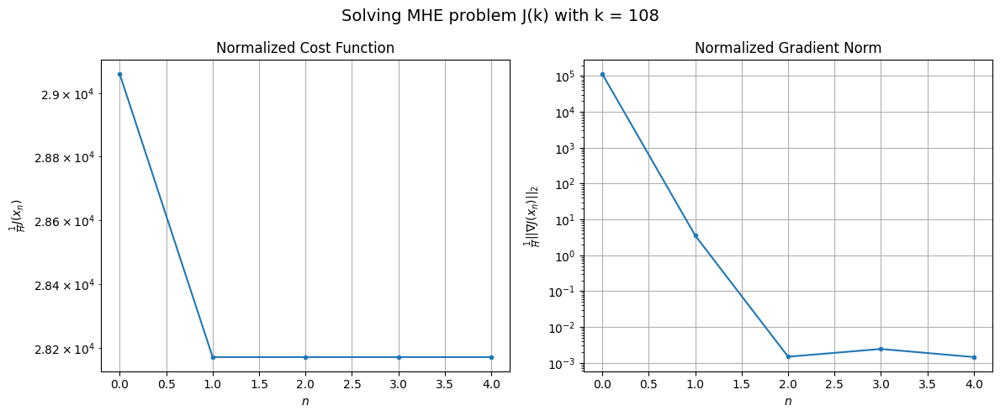

Windows:  20%|█▉        | 70/356 [10:23<37:18,  7.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1194127.2381877443
Gradient norm: 4568035.466419213
Global estimation error: 92.89093381795892
Initial conditions estimation errors: 43.66930891229588 m, 45.05669483819194 m, 42.91218116739811 m, 53.38642794547856 m
Position estimation errors: 62.270789925099365 m, 61.98795878334179 m, 62.25908174802767 m, 58.401887448057096 m

[Gauss-Newton] Iteration 1
Cost function: 1157989.6218317882 (-3.03%)
Gradient norm: 232.76112065644335 (-99.99%)
Global estimation error: 99.91850026629076 (7.57%)
Initial conditions estimation errors: 49.974620665693685 m, 49.45311189506679 m, 48.99660775325838 m, 51.38012221569423 m
Position estimation errors: 55.82718337414324 m, 55.618787090097314 m, 56.98938993140441 m, 55.329751063859256 m

[Gauss-Newton] Iteration 2
Cost function: 1157989.6214313547 (-0.00%)
Gradient norm: 0.11600256073264026 (-99.95%)
Global estimation error: 99.91251745181087 (-0.01%)
Initial conditions estimation errors: 49.9

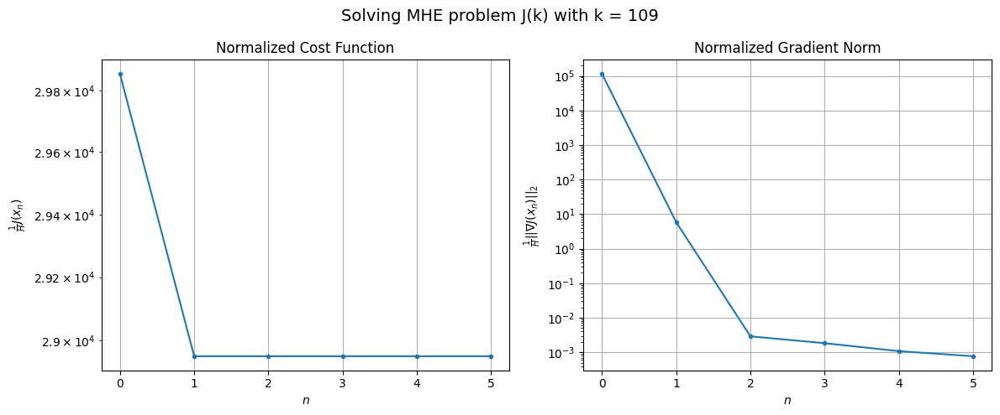

Windows:  20%|█▉        | 71/356 [10:31<36:05,  7.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1236712.9344476005
Gradient norm: 4556163.708211729
Global estimation error: 87.25188276479906
Initial conditions estimation errors: 43.642065180784975 m, 43.04151621878025 m, 42.67910667274962 m, 45.10140204108543 m
Position estimation errors: 63.798303657591454 m, 63.683963102779266 m, 64.93050106673518 m, 63.20809218857259 m

[Gauss-Newton] Iteration 1
Cost function: 1199419.8337948015 (-3.02%)
Gradient norm: 68.03507099230411 (-100.00%)
Global estimation error: 100.34302500846682 (15.00%)
Initial conditions estimation errors: 50.0550187215413 m, 49.426720767044905 m, 49.55692920702995 m, 51.61665355709429 m
Position estimation errors: 57.25962601543564 m, 57.51027155566014 m, 57.7908136469364 m, 56.302109538000195 m

[Gauss-Newton] Iteration 2
Cost function: 1199419.8338163062 (0.00%)
Gradient norm: 0.07182233547360806 (-99.89%)
Global estimation error: 100.33977986027865 (-0.00%)
Initial conditions estimation errors: 50.0

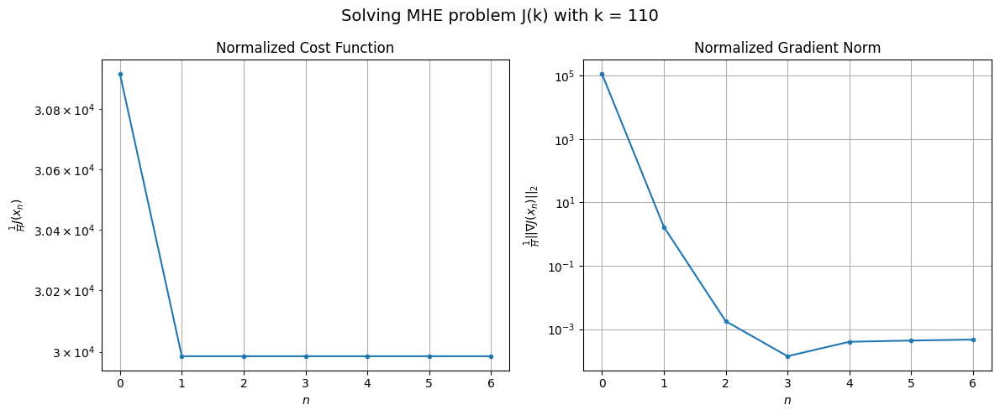

Windows:  20%|██        | 72/356 [10:39<36:45,  7.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1287738.8047319166
Gradient norm: 4389897.385754674
Global estimation error: 87.79985184468117
Initial conditions estimation errors: 43.79844072335205 m, 43.12570693346026 m, 43.28596085550802 m, 45.35375879405219 m
Position estimation errors: 65.22863105525728 m, 65.54362509257004 m, 65.74755358418614 m, 64.21241896748042 m

[Gauss-Newton] Iteration 1
Cost function: 1249596.7898087872 (-2.96%)
Gradient norm: 79.78547180522857 (-100.00%)
Global estimation error: 101.70320231053147 (15.84%)
Initial conditions estimation errors: 50.28352707561099 m, 50.51954662100839 m, 49.937248065897094 m, 52.62230661061535 m
Position estimation errors: 58.62027530910406 m, 58.948906699605516 m, 58.33119058244451 m, 58.301071045668 m

[Gauss-Newton] Iteration 2
Cost function: 1249596.7898119504 (0.00%)
Gradient norm: 0.035399715006274535 (-99.96%)
Global estimation error: 101.7075134701358 (0.00%)
Initial conditions estimation errors: 50.28352

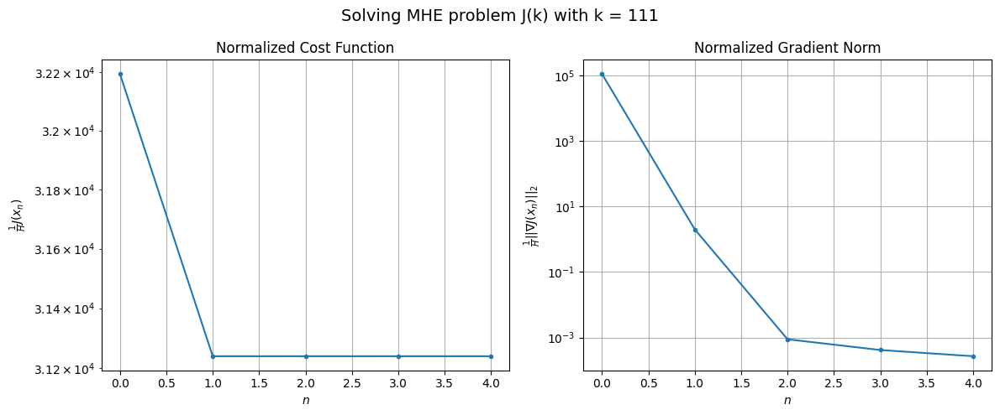

Windows:  21%|██        | 73/356 [10:44<33:51,  7.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1344477.3717759561
Gradient norm: 4311237.752575649
Global estimation error: 89.46597847981545
Initial conditions estimation errors: 44.124393788754205 m, 44.41377854942984 m, 43.67465505709195 m, 46.659352405021956 m
Position estimation errors: 66.5359893907065 m, 66.80976801421441 m, 66.29404508734328 m, 65.99211319677798 m

[Gauss-Newton] Iteration 1
Cost function: 1305418.9976928988 (-2.91%)
Gradient norm: 77.16718975702666 (-100.00%)
Global estimation error: 104.20522604172608 (16.47%)
Initial conditions estimation errors: 50.68176115267149 m, 51.46047144214715 m, 49.695451583265765 m, 56.322486476181474 m
Position estimation errors: 59.854108654876846 m, 60.043344030087546 m, 59.520500248310626 m, 56.716432063961214 m

[Gauss-Newton] Iteration 2
Cost function: 1305418.9977028293 (0.00%)
Gradient norm: 0.07554007433091338 (-99.90%)
Global estimation error: 104.20273748920356 (-0.00%)
Initial conditions estimation errors: 

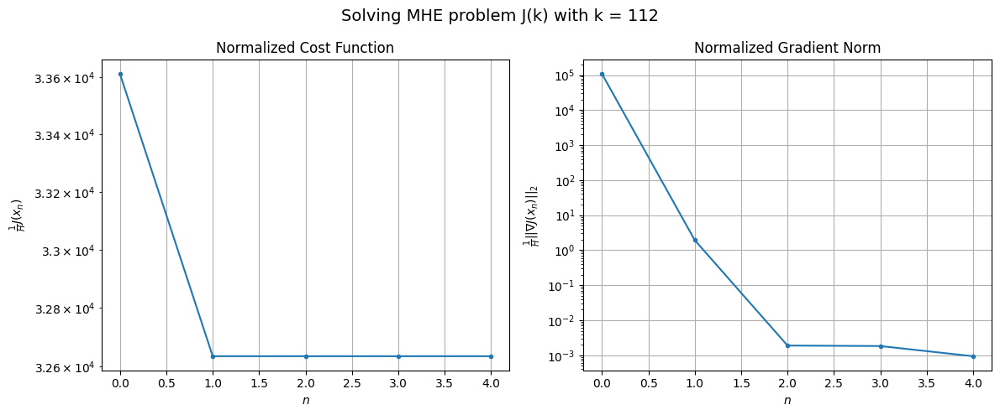

Windows:  21%|██        | 74/356 [10:51<32:24,  6.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1405466.5444248405
Gradient norm: 4053749.059741692
Global estimation error: 92.12251447007628
Initial conditions estimation errors: 44.62757216704554 m, 45.451699359280234 m, 43.46015432859008 m, 50.40090347599049 m
Position estimation errors: 67.71114441487639 m, 67.80762426366084 m, 67.50822648531718 m, 64.27106746426998 m

[Gauss-Newton] Iteration 1
Cost function: 1365373.304514556 (-2.85%)
Gradient norm: 79.58617232307405 (-100.00%)
Global estimation error: 104.01350282804812 (12.91%)
Initial conditions estimation errors: 51.26464844878794 m, 51.497264552791584 m, 50.594255162907835 m, 54.57975426343308 m
Position estimation errors: 60.94543642765517 m, 60.66724097258654 m, 60.81713962117855 m, 57.75502142269413 m

[Gauss-Newton] Iteration 2
Cost function: 1365373.3044922177 (-0.00%)
Gradient norm: 0.03062361144090361 (-99.96%)
Global estimation error: 104.01084463309435 (-0.00%)
Initial conditions estimation errors: 51.2

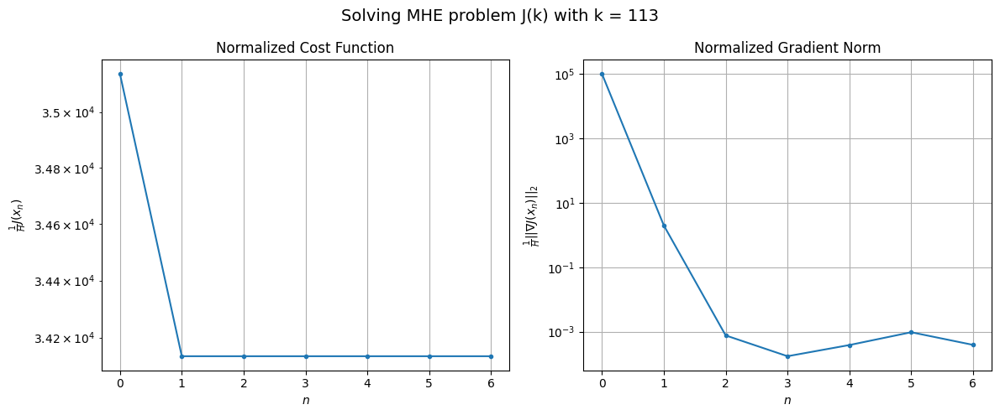

Windows:  21%|██        | 75/356 [10:59<33:47,  7.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1469140.2726737848
Gradient norm: 3919286.646503796
Global estimation error: 91.92462347544212
Initial conditions estimation errors: 45.308902477717865 m, 45.44551324294788 m, 44.56693448949218 m, 48.43231417730527 m
Position estimation errors: 68.78115686780403 m, 68.53320667449486 m, 68.72609388211431 m, 65.53574081786316 m

[Gauss-Newton] Iteration 1
Cost function: 1427826.1210678963 (-2.81%)
Gradient norm: 86.09373292513266 (-100.00%)
Global estimation error: 105.41252966290273 (14.67%)
Initial conditions estimation errors: 52.03321313021965 m, 52.454002281060575 m, 51.03715683975008 m, 55.20947219928639 m
Position estimation errors: 61.910682525401576 m, 62.12860067912692 m, 61.2664583564586 m, 59.966642435635926 m

[Gauss-Newton] Iteration 2
Cost function: 1427826.121102721 (0.00%)
Gradient norm: 0.00951990314976125 (-99.99%)
Global estimation error: 105.41299078650489 (0.00%)
Initial conditions estimation errors: 52.033

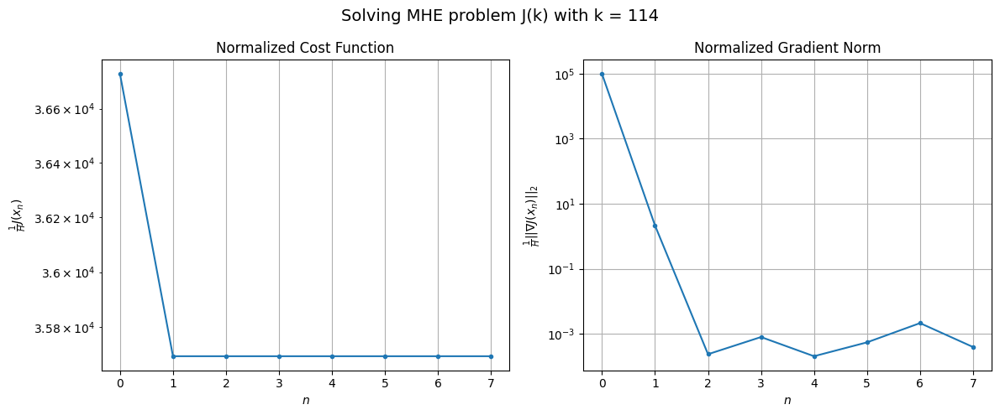

Windows:  21%|██▏       | 76/356 [11:07<35:41,  7.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1536288.5697854673
Gradient norm: 3768836.9847902614
Global estimation error: 93.56857995336513
Initial conditions estimation errors: 46.16159526952934 m, 46.55252931445883 m, 44.99212743861724 m, 49.32255039684334 m
Position estimation errors: 69.77791314717471 m, 69.9496142547622 m, 69.30268862855823 m, 67.65985358193984 m

[Gauss-Newton] Iteration 1
Cost function: 1493649.4154901542 (-2.78%)
Gradient norm: 77.12358448950944 (-100.00%)
Global estimation error: 110.18761350617108 (17.76%)
Initial conditions estimation errors: 52.98026316571762 m, 54.63258426404014 m, 52.2381944203896 m, 60.1731529663153 m
Position estimation errors: 62.79412493323374 m, 61.80950383207189 m, 62.14654589349699 m, 57.1160891273943 m

[Gauss-Newton] Iteration 2
Cost function: 1493649.4154931135 (0.00%)
Gradient norm: 0.0883378014176585 (-99.89%)
Global estimation error: 110.18858915472939 (0.00%)
Initial conditions estimation errors: 52.980262251

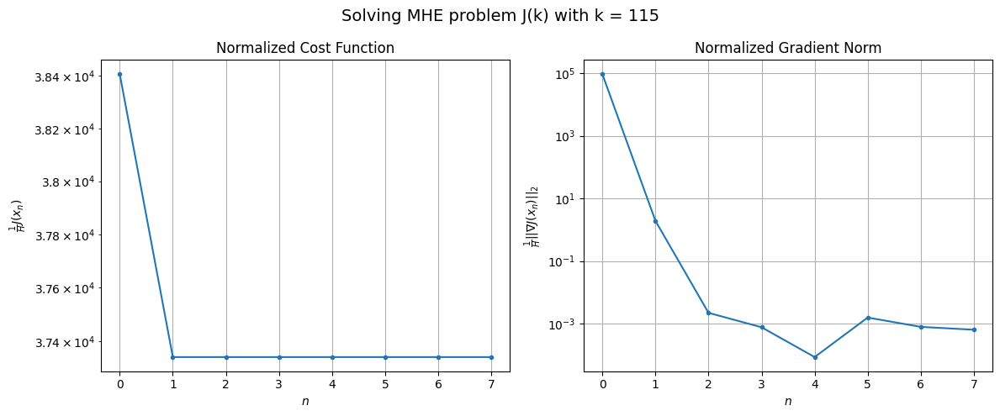

Windows:  22%|██▏       | 77/356 [11:16<37:17,  8.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1604364.0083044234
Gradient norm: 3781607.4170369925
Global estimation error: 98.49164146000196
Initial conditions estimation errors: 47.17023605657654 m, 48.80128828544986 m, 46.333064421255685 m, 54.288228248650604 m
Position estimation errors: 70.72142298388144 m, 69.66021894949884 m, 70.24053372175523 m, 64.74563072790504 m

[Gauss-Newton] Iteration 1
Cost function: 1560642.2614599883 (-2.73%)
Gradient norm: 75.39885855551324 (-100.00%)
Global estimation error: 110.73357564404577 (12.43%)
Initial conditions estimation errors: 54.068335941842314 m, 54.25181490169232 m, 53.10392055934169 m, 59.79305629045657 m
Position estimation errors: 63.645984143319076 m, 63.68190405850061 m, 63.27212054430912 m, 58.84938960115972 m

[Gauss-Newton] Iteration 2
Cost function: 1560642.261464152 (0.00%)
Gradient norm: 0.050081622964073605 (-99.93%)
Global estimation error: 110.73420776382216 (0.00%)
Initial conditions estimation errors: 54.

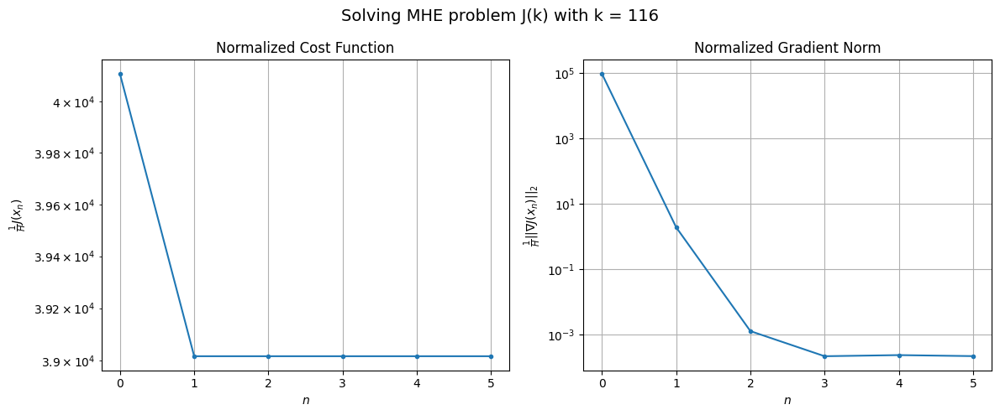

Windows:  22%|██▏       | 78/356 [11:23<35:33,  7.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1670671.0808418654
Gradient norm: 4047166.7752958555
Global estimation error: 99.06636465093266
Initial conditions estimation errors: 48.283112833589556 m, 48.44415314437733 m, 47.22467254232551 m, 53.9058272228048 m
Position estimation errors: 71.61634132895405 m, 71.64346417634924 m, 71.41661692930177 m, 66.57856045187859 m

[Gauss-Newton] Iteration 1
Cost function: 1625586.589021143 (-2.70%)
Gradient norm: 83.0539589904282 (-100.00%)
Global estimation error: 111.46051355517848 (12.51%)
Initial conditions estimation errors: 55.28144551388084 m, 55.161588788228215 m, 54.73496775025483 m, 57.69442200536533 m
Position estimation errors: 64.42557405725002 m, 64.25034229909477 m, 64.61044305166936 m, 61.95213978131214 m

[Gauss-Newton] Iteration 2
Cost function: 1625586.5890299592 (0.00%)
Gradient norm: 0.08622269866141886 (-99.90%)
Global estimation error: 111.45997082798961 (-0.00%)
Initial conditions estimation errors: 55.2814

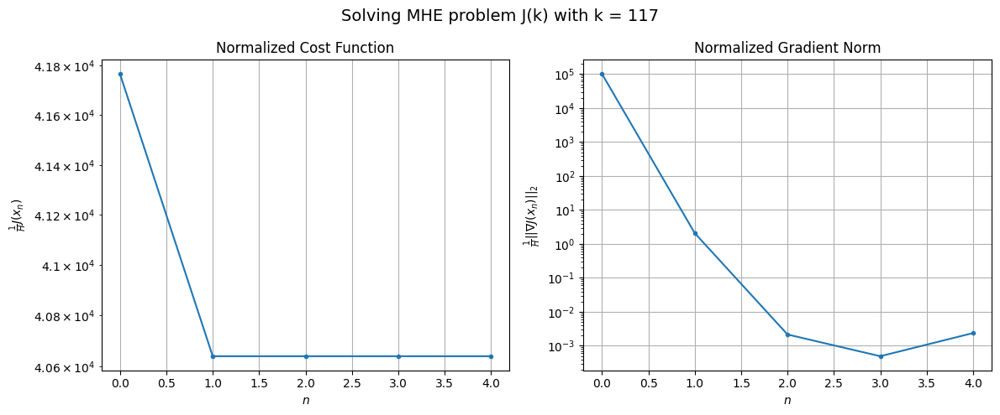

Windows:  22%|██▏       | 79/356 [11:30<34:06,  7.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1733850.6652859943
Gradient norm: 4687347.789759238
Global estimation error: 99.74439310567223
Initial conditions estimation errors: 49.466740236967645 m, 49.28187909672345 m, 48.905243502388885 m, 51.783366298345314 m
Position estimation errors: 72.3847191154419 m, 72.23985580203706 m, 72.63427379382723 m, 69.8231637712897 m

[Gauss-Newton] Iteration 1
Cost function: 1687179.4357234947 (-2.69%)
Gradient norm: 84.62361223327312 (-100.00%)
Global estimation error: 112.74571105189345 (13.03%)
Initial conditions estimation errors: 56.58262485100662 m, 56.03092898982013 m, 56.005173082307245 m, 56.8675051979077 m
Position estimation errors: 65.06065762345852 m, 65.21548651357615 m, 65.57828409513773 m, 63.94370525537554 m

[Gauss-Newton] Iteration 2
Cost function: 1687179.435707271 (-0.00%)
Gradient norm: 0.01716320781235107 (-99.98%)
Global estimation error: 112.74412868355269 (-0.00%)
Initial conditions estimation errors: 56.582

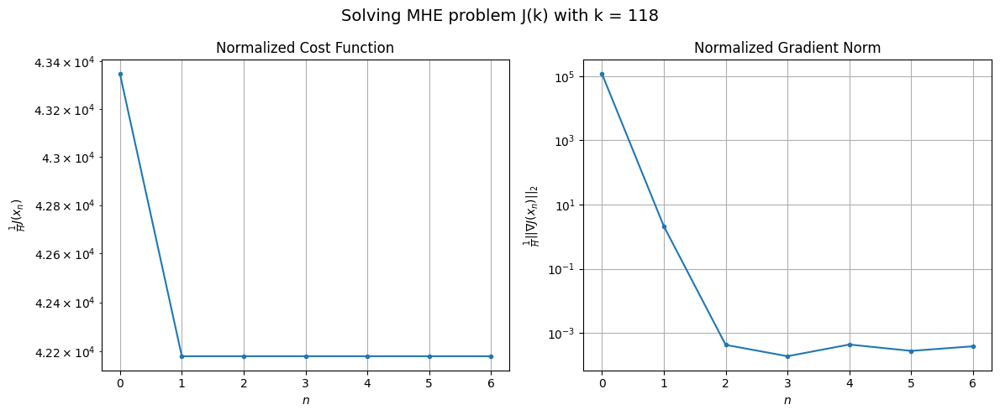

Windows:  22%|██▏       | 80/356 [11:38<35:02,  7.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1791398.2977777147
Gradient norm: 5636012.779292756
Global estimation error: 100.87847754631494
Initial conditions estimation errors: 50.684615294864486 m, 50.06496255003623 m, 50.13886272744167 m, 50.86342352407318 m
Position estimation errors: 72.9349776459193 m, 73.14122221642396 m, 73.47217052419718 m, 71.84672256853781 m

[Gauss-Newton] Iteration 1
Cost function: 1743502.7934173609 (-2.67%)
Gradient norm: 221.26134905888156 (-100.00%)
Global estimation error: 114.32851934347968 (13.33%)
Initial conditions estimation errors: 57.88892192708663 m, 57.90421130064441 m, 56.50830346709562 m, 56.336068750351124 m
Position estimation errors: 65.50442150223766 m, 66.38735094424582 m, 65.43424689825805 m, 68.57919763146997 m

[Gauss-Newton] Iteration 2
Cost function: 1743502.7933573315 (-0.00%)
Gradient norm: 0.028043494540941825 (-99.99%)
Global estimation error: 114.32969122274321 (0.00%)
Initial conditions estimation errors: 57.

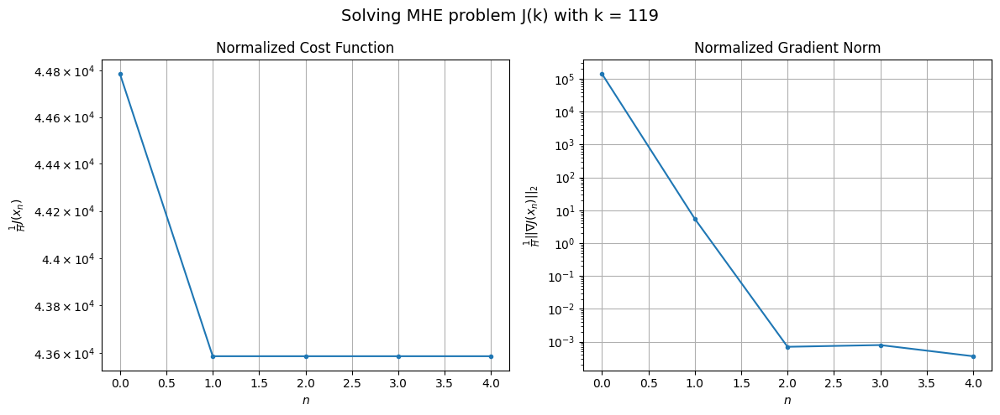

Windows:  23%|██▎       | 81/356 [11:44<33:23,  7.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1842765.2605726097
Gradient norm: 6235662.45814037
Global estimation error: 102.40391034699718
Initial conditions estimation errors: 51.87343347648812 m, 51.973316271710864 m, 50.37146937843502 m, 50.56830835619665 m
Position estimation errors: 73.20472348198294 m, 74.01345596671179 m, 73.32993705628162 m, 76.09361624137736 m

[Gauss-Newton] Iteration 1
Cost function: 1793467.880191643 (-2.68%)
Gradient norm: 192.87984169123547 (-100.00%)
Global estimation error: 115.86001139658815 (13.14%)
Initial conditions estimation errors: 59.182712724733086 m, 58.679229186140695 m, 59.04183019007258 m, 54.696548421015386 m
Position estimation errors: 65.6537585862248 m, 65.65583909957383 m, 66.13440515373695 m, 68.46621290479831 m

[Gauss-Newton] Iteration 2
Cost function: 1793467.8800292984 (-0.00%)
Gradient norm: 0.03940187772474987 (-99.98%)
Global estimation error: 115.85864039865585 (-0.00%)
Initial conditions estimation errors: 59.

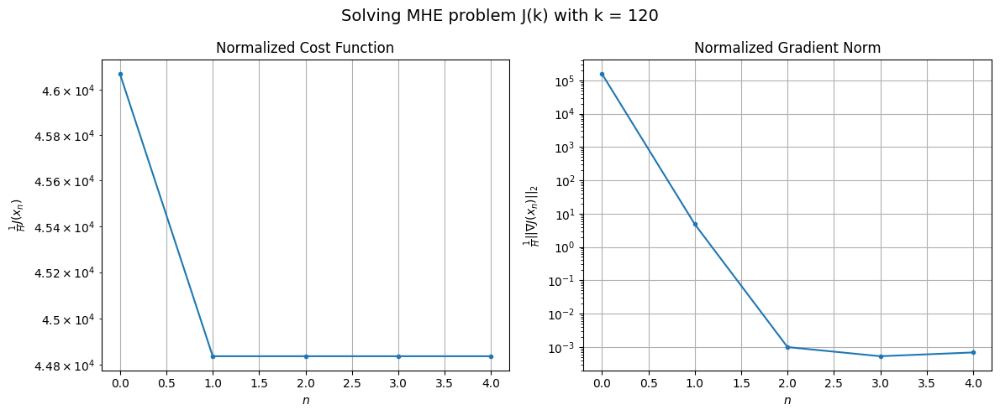

Windows:  23%|██▎       | 82/356 [11:51<31:46,  6.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1883968.000641351
Gradient norm: 6788963.643415866
Global estimation error: 103.5444323809311
Initial conditions estimation errors: 53.034847546844624 m, 52.45747402469903 m, 52.95801019433562 m, 48.50124900273678 m
Position estimation errors: 73.0712382494347 m, 73.16457438712693 m, 73.50071295373236 m, 76.1680546638069 m

[Gauss-Newton] Iteration 1
Cost function: 1833871.351888121 (-2.66%)
Gradient norm: 86.78971042873604 (-100.00%)
Global estimation error: 119.54758170899038 (15.46%)
Initial conditions estimation errors: 60.40624382458641 m, 60.48994232583063 m, 60.26386871227905 m, 57.89554950902807 m
Position estimation errors: 65.44597536578932 m, 65.00945665631029 m, 65.90400597710948 m, 66.30745713888714 m

[Gauss-Newton] Iteration 2
Cost function: 1833871.3518859418 (-0.00%)
Gradient norm: 0.022722824553213825 (-99.97%)
Global estimation error: 119.54659080205207 (-0.00%)
Initial conditions estimation errors: 60.40624

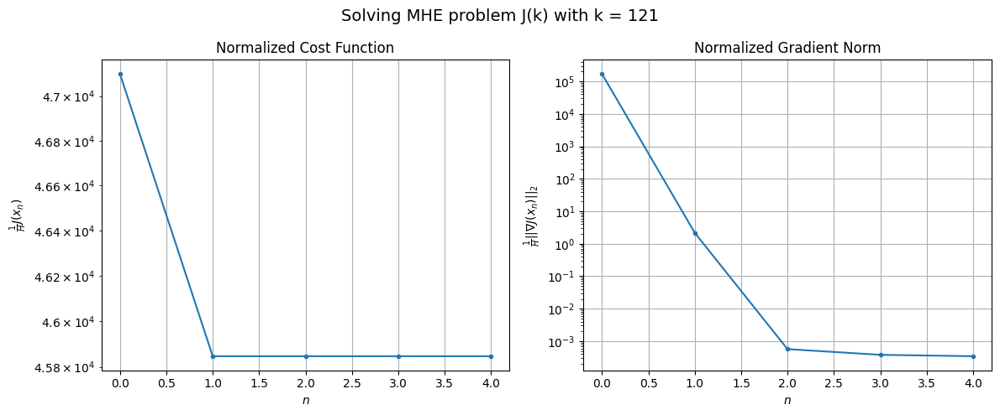

Windows:  23%|██▎       | 83/356 [11:57<30:51,  6.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1914733.680735621
Gradient norm: 7212827.429276188
Global estimation error: 106.93073150377357
Initial conditions estimation errors: 54.12105061746143 m, 54.14227290100206 m, 54.03822778084829 m, 51.51242416001283 m
Position estimation errors: 72.44583237154625 m, 72.08496568558402 m, 72.87167472312706 m, 73.57623999689174 m

[Gauss-Newton] Iteration 1
Cost function: 1864194.5033992091 (-2.64%)
Gradient norm: 1428.692065663458 (-99.98%)
Global estimation error: 127.70118986956565 (19.42%)
Initial conditions estimation errors: 61.52653445175702 m, 62.698107827747116 m, 64.50282880040268 m, 66.5609409139459 m
Position estimation errors: 64.77455387922183 m, 61.39086963763969 m, 65.2997493951304 m, 53.228717017812606 m

[Gauss-Newton] Iteration 2
Cost function: 1864194.501961992 (-0.00%)
Gradient norm: 0.04283765689686863 (-100.00%)
Global estimation error: 127.68341441983891 (-0.01%)
Initial conditions estimation errors: 61.5265

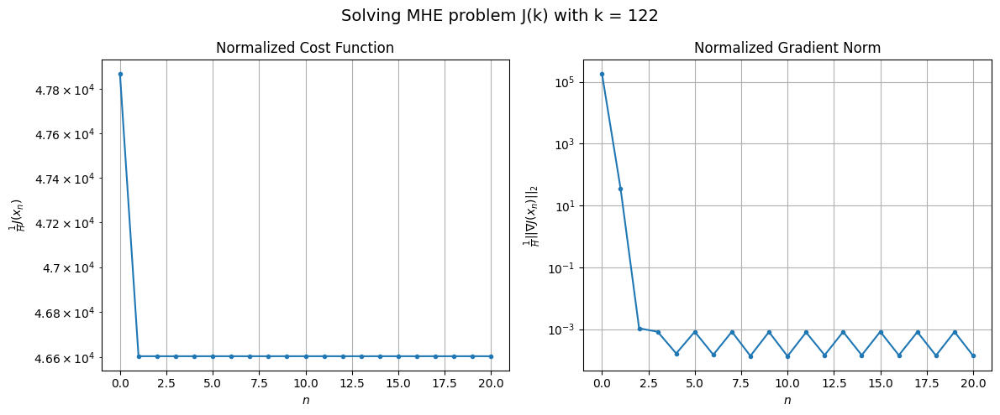

Windows:  24%|██▎       | 84/356 [12:20<53:08, 11.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1928016.2479285444
Gradient norm: 7307920.72191362
Global estimation error: 114.38545838329446
Initial conditions estimation errors: 55.10561436634515 m, 55.95901982369371 m, 58.37709067109109 m, 59.22883959087063 m
Position estimation errors: 71.20597868341956 m, 68.06810358720813 m, 71.22093662687075 m, 60.555561464636256 m

[Gauss-Newton] Iteration 1
Cost function: 1877381.7857121257 (-2.63%)
Gradient norm: 99.14388679750898 (-100.00%)
Global estimation error: 128.99330930407356 (12.77%)
Initial conditions estimation errors: 62.529070162079876 m, 63.833019676275526 m, 65.00977670696477 m, 66.54629976317361 m
Position estimation errors: 63.52400827013558 m, 60.73899488748996 m, 63.491309782048795 m, 54.55784987730131 m

[Gauss-Newton] Iteration 2
Cost function: 1877381.7857108633 (-0.00%)
Gradient norm: 0.01823257918433422 (-99.98%)
Global estimation error: 128.9972259141782 (0.00%)
Initial conditions estimation errors: 62.5

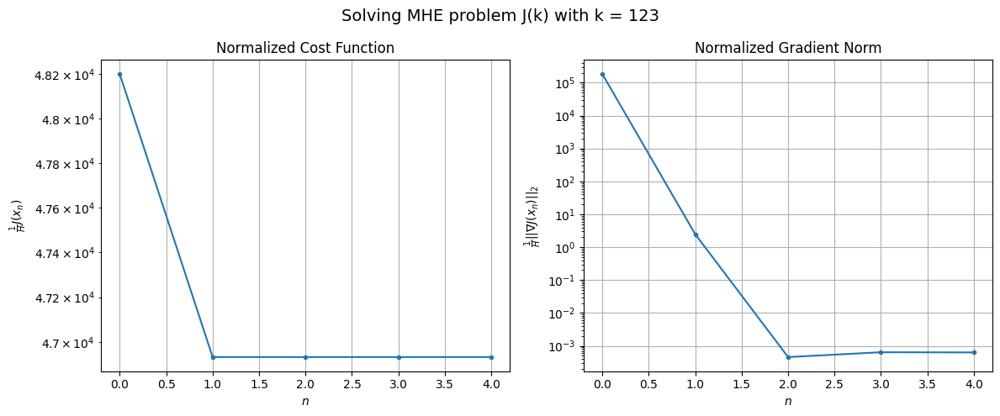

Windows:  24%|██▍       | 85/356 [12:27<46:00, 10.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1922583.5111865276
Gradient norm: 6998592.861872441
Global estimation error: 115.55835166523245
Initial conditions estimation errors: 55.981788924842185 m, 57.0663162760603 m, 58.66727657330781 m, 59.340584840728205 m
Position estimation errors: 69.23776162052445 m, 66.59924315186312 m, 68.81871904364078 m, 60.93502827312067 m

[Gauss-Newton] Iteration 1
Cost function: 1872538.5059815405 (-2.60%)
Gradient norm: 95.1434109619067 (-100.00%)
Global estimation error: 132.98070879421368 (15.08%)
Initial conditions estimation errors: 63.378531559564735 m, 65.98025913446028 m, 66.11072674781742 m, 70.30614023759782 m
Position estimation errors: 61.60711988792285 m, 58.39843198546122 m, 60.88067617876353 m, 51.79058376787655 m

[Gauss-Newton] Iteration 2
Cost function: 1872538.5059373851 (-0.00%)
Gradient norm: 0.03188741177452947 (-99.97%)
Global estimation error: 132.99621648815346 (0.01%)
Initial conditions estimation errors: 63.37

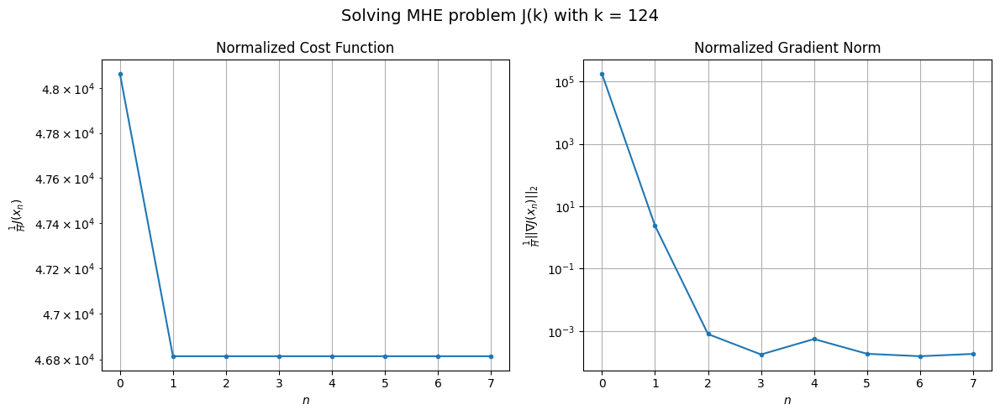

Windows:  24%|██▍       | 86/356 [12:36<44:10,  9.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1892691.6130516906
Gradient norm: 6472938.943363564
Global estimation error: 119.42382784199717
Initial conditions estimation errors: 56.705245755938336 m, 59.175746104894294 m, 59.593608009777604 m, 63.19291443950787 m
Position estimation errors: 66.47760594160502 m, 63.29764336485827 m, 65.41821293534221 m, 56.98342891880582 m

[Gauss-Newton] Iteration 1
Cost function: 1844109.680185909 (-2.57%)
Gradient norm: 250.67594915197162 (-100.00%)
Global estimation error: 131.79394974180906 (10.36%)
Initial conditions estimation errors: 64.01498074093773 m, 65.93329699632167 m, 66.5134069028157 m, 67.0853122879397 m
Position estimation errors: 58.974811985588246 m, 56.85402809298216 m, 57.775284880100344 m, 54.91466576038833 m

[Gauss-Newton] Iteration 2
Cost function: 1844109.6801490053 (-0.00%)
Gradient norm: 0.01568439150548692 (-99.99%)
Global estimation error: 131.79413370519427 (0.00%)
Initial conditions estimation errors: 64.

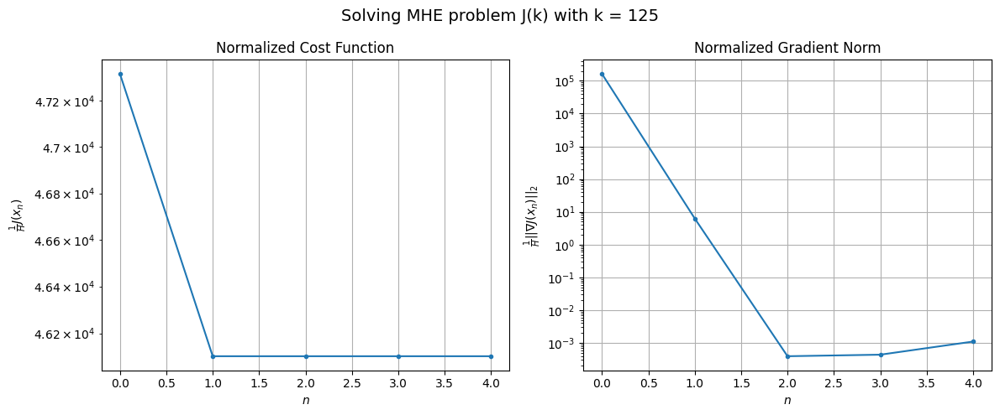

Windows:  24%|██▍       | 87/356 [12:42<39:10,  8.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1835369.1930479421
Gradient norm: 6040167.74951021
Global estimation error: 118.10093204990383
Initial conditions estimation errors: 57.19165470013822 m, 59.0438576125507 m, 59.80367329036249 m, 60.11848799319687 m
Position estimation errors: 62.93151772384049 m, 60.82061773045899 m, 61.50576187979503 m, 58.99544164675734 m

[Gauss-Newton] Iteration 1
Cost function: 1789111.9045191067 (-2.52%)
Gradient norm: 1089.0607218520177 (-99.98%)
Global estimation error: 127.79752077348016 (8.21%)
Initial conditions estimation errors: 64.34374098400882 m, 65.41879728116386 m, 64.02032825968854 m, 61.756074527494114 m
Position estimation errors: 55.62788012518824 m, 55.99523740712935 m, 55.70093492562618 m, 62.69117601067751 m

[Gauss-Newton] Iteration 2
Cost function: 1789111.9036805031 (-0.00%)
Gradient norm: 0.03521461653708947 (-100.00%)
Global estimation error: 127.79113538443413 (-0.00%)
Initial conditions estimation errors: 64.343

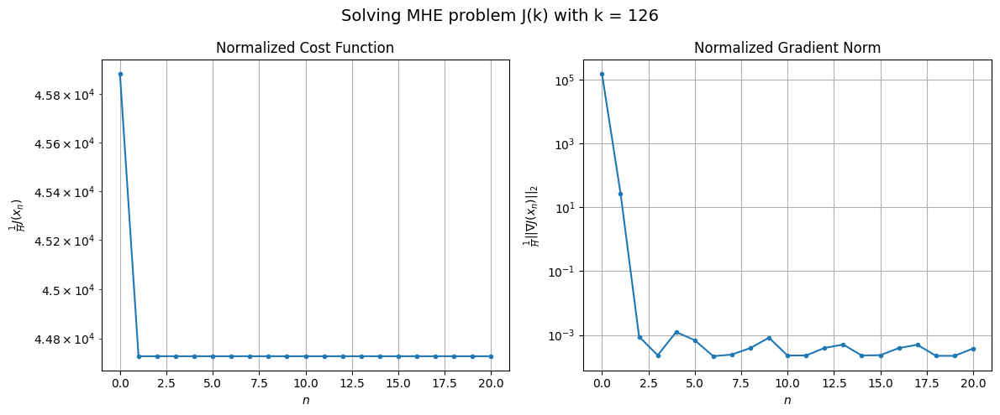

Windows:  25%|██▍       | 88/356 [13:05<57:40, 12.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1755338.66760629
Gradient norm: 5615064.390920176
Global estimation error: 114.13772796150292
Initial conditions estimation errors: 57.33184090584141 m, 58.55441609561147 m, 57.033929838926724 m, 55.30765032510804 m
Position estimation errors: 58.68648088828713 m, 58.91045841374846 m, 58.83843486134354 m, 65.29704603859821 m

[Gauss-Newton] Iteration 1
Cost function: 1711710.4877530579 (-2.49%)
Gradient norm: 324.50591817954165 (-99.99%)
Global estimation error: 130.0274915777442 (13.92%)
Initial conditions estimation errors: 64.29505762316386 m, 64.86291593327296 m, 65.24011469212216 m, 65.64878911894527 m
Position estimation errors: 51.61199934501641 m, 51.61464160400136 m, 50.814840353845504 m, 51.83019896037918 m

[Gauss-Newton] Iteration 2
Cost function: 1711710.487641056 (-0.00%)
Gradient norm: 0.021555570307435226 (-99.99%)
Global estimation error: 130.0597754443889 (0.02%)
Initial conditions estimation errors: 64.29505

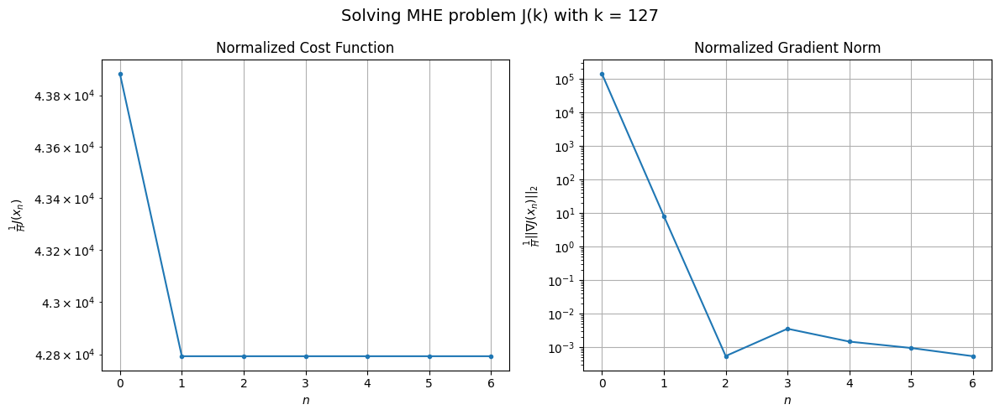

Windows:  25%|██▌       | 89/356 [13:14<52:02, 11.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1650738.4071649204
Gradient norm: 5057203.862062588
Global estimation error: 115.76450949591599
Initial conditions estimation errors: 57.07011618170106 m, 57.68647478260772 m, 58.0818572265166 m, 58.67819498785582 m
Position estimation errors: 53.87869047631509 m, 53.832156869434606 m, 53.07789529804706 m, 53.851492087256716 m

[Gauss-Newton] Iteration 1
Cost function: 1610301.4990942224 (-2.45%)
Gradient norm: 426.54107672277684 (-99.99%)
Global estimation error: 134.62792612277332 (16.29%)
Initial conditions estimation errors: 63.7937326023807 m, 65.32243924363519 m, 67.65485479634792 m, 72.1856777665098 m
Position estimation errors: 47.093075558581695 m, 45.40130683960913 m, 44.18111482120863 m, 37.99166504431967 m

[Gauss-Newton] Iteration 2
Cost function: 1610301.4988589822 (-0.00%)
Gradient norm: 0.07019238011927788 (-99.98%)
Global estimation error: 134.6793699430905 (0.04%)
Initial conditions estimation errors: 63.7937

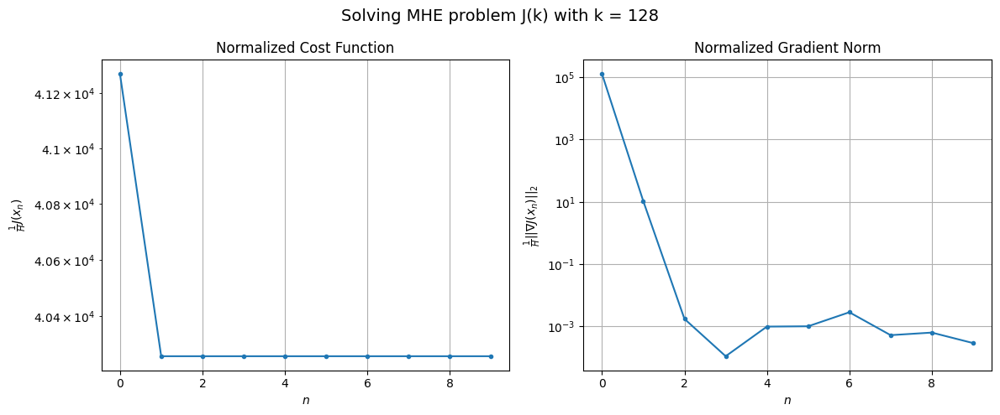

Windows:  25%|██▌       | 90/356 [13:25<51:21, 11.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1525158.1257535273
Gradient norm: 4487458.83292491
Global estimation error: 119.77873663224044
Initial conditions estimation errors: 56.36668352656449 m, 57.838329880309814 m, 60.356439338190704 m, 64.6645483143897 m
Position estimation errors: 48.73003439090109 m, 47.05840358292529 m, 45.643444971717415 m, 39.61246035507102 m

[Gauss-Newton] Iteration 1
Cost function: 1488570.7042747608 (-2.40%)
Gradient norm: 306.48645827271855 (-99.99%)
Global estimation error: 127.11962746223001 (6.13%)
Initial conditions estimation errors: 62.77848117708351 m, 63.87383052698938 m, 65.07362264039506 m, 62.480007228120705 m
Position estimation errors: 42.298296390953375 m, 41.40148986357696 m, 40.62723089959318 m, 42.351189349741816 m

[Gauss-Newton] Iteration 2
Cost function: 1488570.703659 (-0.00%)
Gradient norm: 0.1583145385408745 (-99.95%)
Global estimation error: 127.01668135131169 (-0.08%)
Initial conditions estimation errors: 62.7784

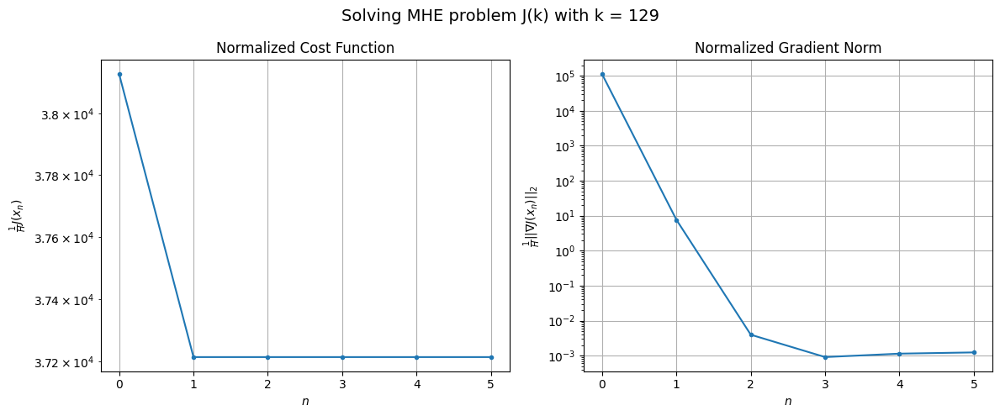

Windows:  26%|██▌       | 91/356 [13:33<45:52, 10.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1386577.1438675118
Gradient norm: 3839621.5528453216
Global estimation error: 111.92274894026073
Initial conditions estimation errors: 55.19785222070625 m, 56.31630645181226 m, 57.578748488424345 m, 54.7082456334052 m
Position estimation errors: 43.47291366700779 m, 42.58953038650976 m, 41.77899263193038 m, 43.79131775056125 m

[Gauss-Newton] Iteration 1
Cost function: 1354054.3948166724 (-2.35%)
Gradient norm: 76.09960971937437 (-100.00%)
Global estimation error: 123.49301524207611 (10.34%)
Initial conditions estimation errors: 61.253544503471424 m, 62.07428969388384 m, 63.31178071247218 m, 60.30637256477977 m
Position estimation errors: 37.43227795898355 m, 36.73606596572308 m, 35.96071252208137 m, 37.98867873636967 m

[Gauss-Newton] Iteration 2
Cost function: 1354054.3948215276 (0.00%)
Gradient norm: 0.05196298585057748 (-99.93%)
Global estimation error: 123.49168829052086 (-0.00%)
Initial conditions estimation errors: 61.2

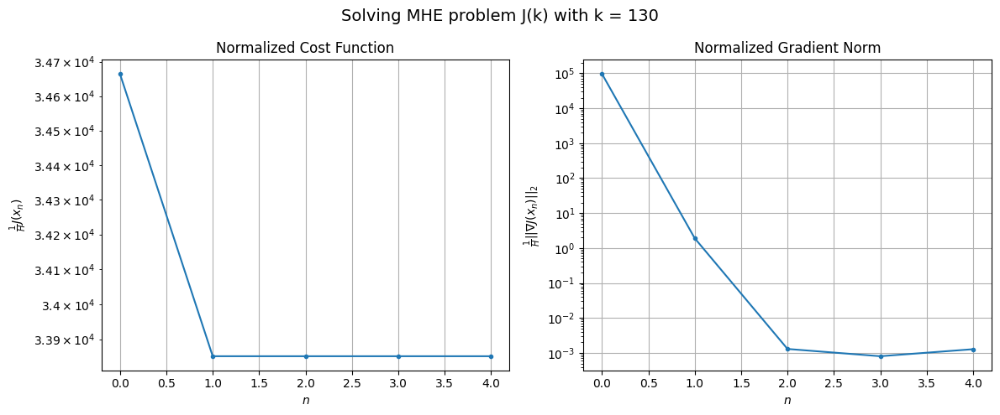

Windows:  26%|██▌       | 92/356 [13:39<40:00,  9.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1239914.6247179026
Gradient norm: 3143333.759202838
Global estimation error: 108.21584624021244
Initial conditions estimation errors: 53.589255223672936 m, 54.424214688575056 m, 55.775584510431 m, 52.59164278701164 m
Position estimation errors: 38.274469818216126 m, 37.57974099377525 m, 36.74874573866958 m, 38.932618544618244 m

[Gauss-Newton] Iteration 1
Cost function: 1211271.2567575718 (-2.31%)
Gradient norm: 99.78098869614585 (-100.00%)
Global estimation error: 117.61701764324638 (8.69%)
Initial conditions estimation errors: 59.28043640215347 m, 60.15297091051565 m, 60.00006993400346 m, 55.68782567267996 m
Position estimation errors: 32.63061744848328 m, 32.140188924392305 m, 32.349825403082086 m, 37.350539956267525 m

[Gauss-Newton] Iteration 2
Cost function: 1211271.2567000643 (-0.00%)
Gradient norm: 0.02957898422477937 (-99.97%)
Global estimation error: 117.57966708215733 (-0.03%)
Initial conditions estimation errors: 5

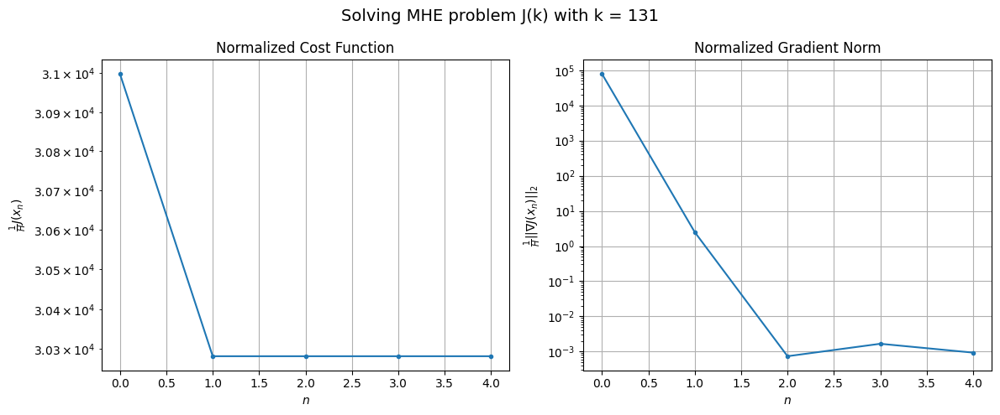

Windows:  26%|██▌       | 93/356 [13:45<35:54,  8.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1090494.4620662432
Gradient norm: 2439772.913544864
Global estimation error: 102.38791519436816
Initial conditions estimation errors: 51.61136744486599 m, 52.514639118994566 m, 52.41530498774814 m, 48.107509779005795 m
Position estimation errors: 33.22129389081094 m, 32.69465344620965 m, 32.90501351130186 m, 37.93068142485825 m

[Gauss-Newton] Iteration 1
Cost function: 1066025.28048406 (-2.24%)
Gradient norm: 54.03449365935497 (-100.00%)
Global estimation error: 112.20463707209834 (9.59%)
Initial conditions estimation errors: 56.88073767107759 m, 57.27957843305891 m, 57.29055155528951 m, 52.83214534369265 m
Position estimation errors: 28.03752948370031 m, 28.159608053499664 m, 28.173084743636316 m, 33.983404845295205 m

[Gauss-Newton] Iteration 2
Cost function: 1066025.2804647833 (-0.00%)
Gradient norm: 0.05046563454060326 (-99.91%)
Global estimation error: 112.20640315544308 (0.00%)
Initial conditions estimation errors: 56.8

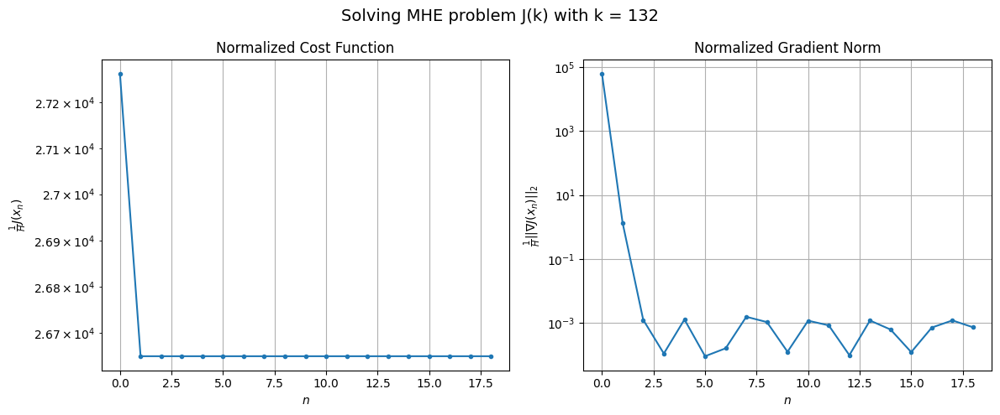

Windows:  26%|██▋       | 94/356 [14:04<50:59, 11.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 944658.5093672946
Gradient norm: 1795902.8225006654
Global estimation error: 97.21127781475084
Initial conditions estimation errors: 49.27425422424912 m, 49.72039985385721 m, 49.797532029985696 m, 45.498374036562346 m
Position estimation errors: 28.418209782539247 m, 28.485090609751445 m, 28.516938067811726 m, 34.2070928903227 m

[Gauss-Newton] Iteration 1
Cost function: 923871.908333625 (-2.20%)
Gradient norm: 55.188019052784476 (-100.00%)
Global estimation error: 107.5667731104888 (10.65%)
Initial conditions estimation errors: 54.13854105875128 m, 54.30369989700567 m, 54.63123972130243 m, 52.020161567103294 m
Position estimation errors: 23.682361894314308 m, 23.886306875284436 m, 23.783426839280708 m, 28.159814176491196 m

[Gauss-Newton] Iteration 2
Cost function: 923871.9083235844 (-0.00%)
Gradient norm: 0.014391146411339506 (-99.97%)
Global estimation error: 107.5576591720126 (-0.01%)
Initial conditions estimation errors: 

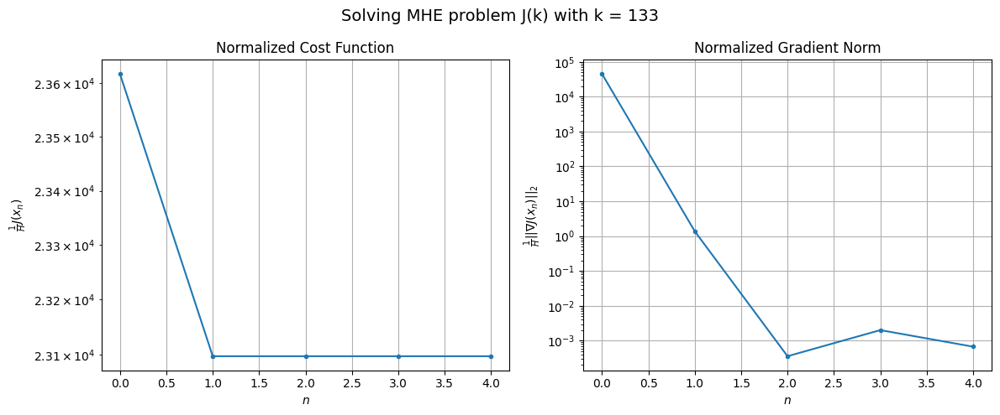

Windows:  27%|██▋       | 95/356 [14:11<44:11, 10.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 806127.8476701848
Gradient norm: 1919649.3686400217
Global estimation error: 92.75726511357357
Initial conditions estimation errors: 46.6326771253366 m, 46.79954853616839 m, 47.21650296195822 m, 44.82905030574197 m
Position estimation errors: 23.86933869234197 m, 24.05305086909848 m, 23.887341248773065 m, 28.148325580825684 m

[Gauss-Newton] Iteration 1
Cost function: 788703.6689966037 (-2.16%)
Gradient norm: 45.458214132426114 (-100.00%)
Global estimation error: 100.85524089558557 (8.73%)
Initial conditions estimation errors: 51.08978109513506 m, 50.16213530855559 m, 52.25664771803352 m, 48.10977649714635 m
Position estimation errors: 19.573426248352817 m, 20.41380198238615 m, 19.36382061791894 m, 23.21401428526714 m

[Gauss-Newton] Iteration 2
Cost function: 788703.6689993041 (0.00%)
Gradient norm: 0.06275821045993737 (-99.86%)
Global estimation error: 100.85763441718849 (0.00%)
Initial conditions estimation errors: 51.08978

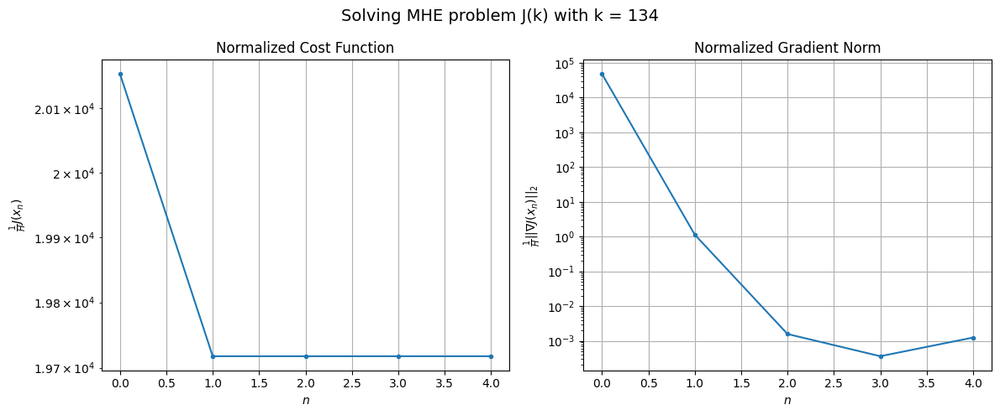

Windows:  27%|██▋       | 96/356 [14:17<38:59,  9.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 677672.7321977357
Gradient norm: 2647891.118399333
Global estimation error: 86.21981707278574
Initial conditions estimation errors: 43.71047180549474 m, 42.76635433705032 m, 44.984784813046325 m, 40.872942756357396 m
Position estimation errors: 19.605593951799868 m, 20.45525530451043 m, 19.161263905638723 m, 23.152855411825474 m

[Gauss-Newton] Iteration 1
Cost function: 663461.9887862558 (-2.10%)
Gradient norm: 50.869471454587845 (-100.00%)
Global estimation error: 92.50832038552242 (7.29%)
Initial conditions estimation errors: 47.73919355529977 m, 47.284625694318336 m, 48.114584897275044 m, 41.5673790823372 m
Position estimation errors: 15.786700896347767 m, 16.313890675397285 m, 16.291727616696637 m, 22.800608632563137 m

[Gauss-Newton] Iteration 2
Cost function: 663461.9887696482 (-0.00%)
Gradient norm: 0.03303229073539745 (-99.94%)
Global estimation error: 92.49461485384506 (-0.01%)
Initial conditions estimation errors: 4

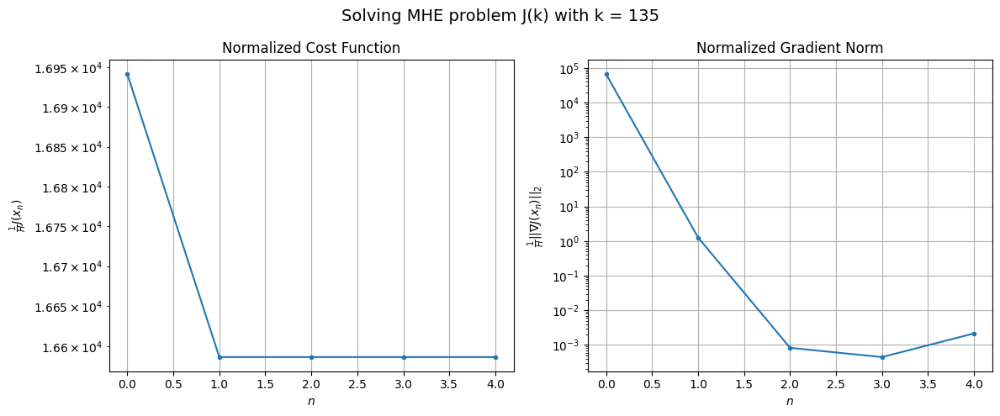

Windows:  27%|██▋       | 97/356 [14:23<35:01,  8.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 562583.8157223521
Gradient norm: 3903123.2118412675
Global estimation error: 78.27537772829196
Initial conditions estimation errors: 40.52472306614096 m, 40.084349317563394 m, 40.99494387422029 m, 34.60322733403834 m
Position estimation errors: 15.777595664944018 m, 16.20480237612919 m, 15.934487760947679 m, 22.66244105183374 m

[Gauss-Newton] Iteration 1
Cost function: 551184.6576457529 (-2.03%)
Gradient norm: 35.987474369406065 (-100.00%)
Global estimation error: 84.12582214735497 (7.47%)
Initial conditions estimation errors: 44.1269321732635 m, 43.2300686400434 m, 43.90281381888214 m, 36.518682392145415 m
Position estimation errors: 12.438454593549558 m, 13.385732397255945 m, 13.544115574335782 m, 21.836216694404385 m

[Gauss-Newton] Iteration 2
Cost function: 551184.6576428659 (-0.00%)
Gradient norm: 0.08605057632509576 (-99.76%)
Global estimation error: 84.12642057354553 (0.00%)
Initial conditions estimation errors: 44.12

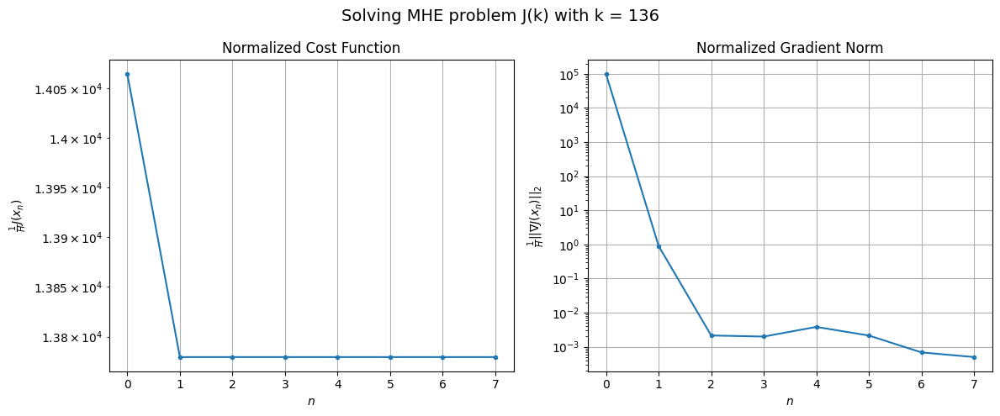

Windows:  28%|██▊       | 98/356 [14:33<36:33,  8.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 461811.88003540953
Gradient norm: 4825293.183181046
Global estimation error: 70.49032718956782
Initial conditions estimation errors: 37.13971009792599 m, 36.28615175651906 m, 37.009531967373796 m, 30.051384242556495 m
Position estimation errors: 12.634770863140961 m, 13.309737441111567 m, 13.050998010235201 m, 21.51042607910041 m

[Gauss-Newton] Iteration 1
Cost function: 452956.7773675643 (-1.92%)
Gradient norm: 39.959000045479065 (-100.00%)
Global estimation error: 77.1213422168136 (9.41%)
Initial conditions estimation errors: 40.303412484499546 m, 39.44569366975614 m, 40.6359196633046 m, 33.40721255800486 m
Position estimation errors: 9.88026905404303 m, 10.289010234348238 m, 9.92543472360289 m, 16.514505609042825 m

[Gauss-Newton] Iteration 2
Cost function: 452956.7773600139 (-0.00%)
Gradient norm: 0.05790045934481125 (-99.86%)
Global estimation error: 77.12168508444428 (0.00%)
Initial conditions estimation errors: 40.3034

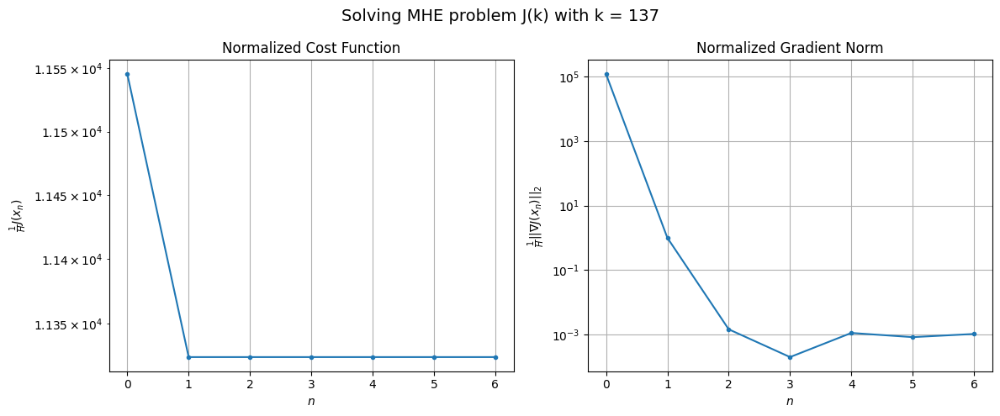

Windows:  28%|██▊       | 99/356 [14:40<35:17,  8.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 378214.2359293529
Gradient norm: 6116121.377324305
Global estimation error: 63.96609753489894
Initial conditions estimation errors: 33.61341569365287 m, 32.767028073845374 m, 34.00169886905794 m, 27.054728197381845 m
Position estimation errors: 10.706132266793036 m, 10.68639904939511 m, 9.897129993543896 m, 16.482452141661295 m

[Gauss-Newton] Iteration 1
Cost function: 371478.52595919085 (-1.78%)
Gradient norm: 80.00949463992164 (-100.00%)
Global estimation error: 72.28039022907858 (13.00%)
Initial conditions estimation errors: 36.33005644798303 m, 35.87422339348404 m, 37.44294092046701 m, 34.86544221228285 m
Position estimation errors: 8.610794332919982 m, 8.237366879130615 m, 7.6431053359670535 m, 9.632957214884076 m

[Gauss-Newton] Iteration 2
Cost function: 371478.5259149267 (-0.00%)
Gradient norm: 0.024240048907936445 (-99.97%)
Global estimation error: 72.29596225593727 (0.02%)
Initial conditions estimation errors: 36.33

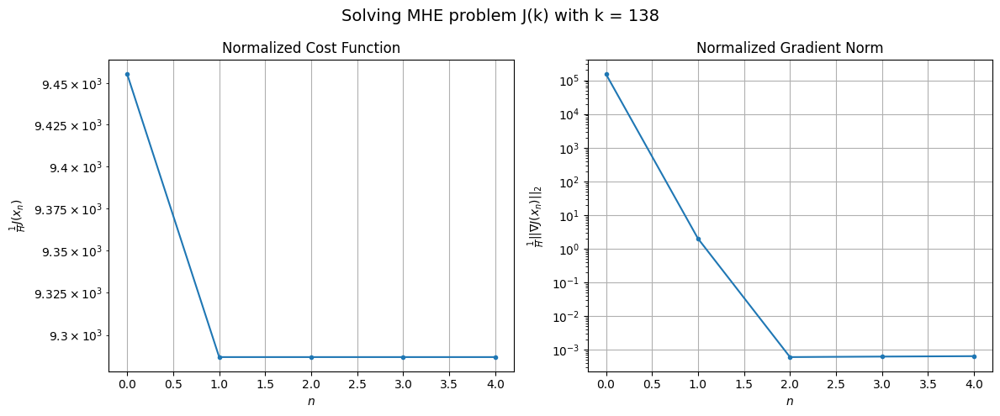

Windows:  28%|██▊       | 100/356 [14:47<32:23,  7.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 310946.1826495772
Gradient norm: 7040442.323277992
Global estimation error: 59.69001318538406
Initial conditions estimation errors: 29.984746363931713 m, 29.501711234821983 m, 31.10998003430684 m, 28.733034997282136 m
Position estimation errors: 10.406991427604746 m, 9.824234150326129 m, 9.212641664598674 m, 10.70011869751845 m

[Gauss-Newton] Iteration 1
Cost function: 305921.1291113739 (-1.62%)
Gradient norm: 14.97190972876298 (-100.00%)
Global estimation error: 65.44556666678358 (9.64%)
Initial conditions estimation errors: 32.26716628161522 m, 32.252517225035334 m, 33.05863938013904 m, 33.29880203978484 m
Position estimation errors: 9.003657217669545 m, 8.589921278697858 m, 8.100996036943771 m, 8.54313985204634 m

[Gauss-Newton] Iteration 2
Cost function: 305921.1291107063 (-0.00%)
Gradient norm: 0.045049791585731025 (-99.70%)
Global estimation error: 65.44958576385297 (0.01%)
Initial conditions estimation errors: 32.26716

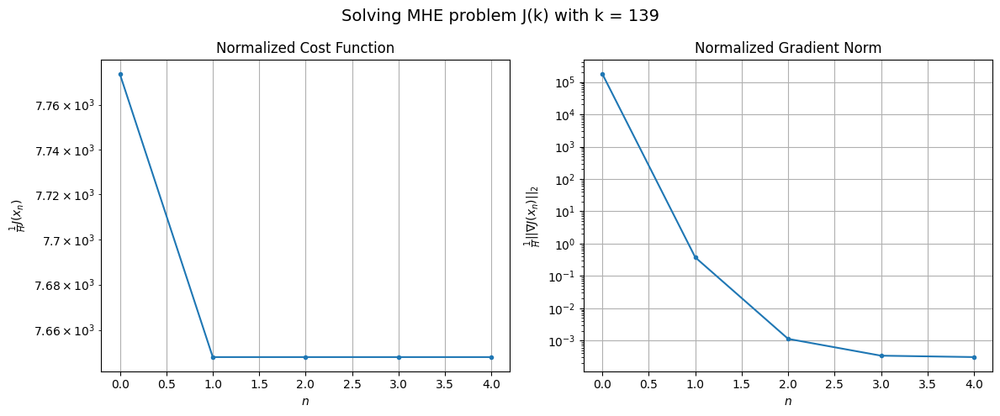

Windows:  28%|██▊       | 101/356 [14:53<30:16,  7.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 261152.95120410694
Gradient norm: 7753239.238561486
Global estimation error: 53.598508623844694
Initial conditions estimation errors: 26.270505868224628 m, 26.25256708288156 m, 27.077454753998303 m, 27.572376923216957 m
Position estimation errors: 11.66761476499038 m, 11.192192347751194 m, 10.637980859739036 m, 10.810976511879621 m

[Gauss-Newton] Iteration 1
Cost function: 257530.9542332465 (-1.39%)
Gradient norm: 253.5225517640363 (-100.00%)
Global estimation error: 56.06350304317869 (4.60%)
Initial conditions estimation errors: 28.103731758554815 m, 28.10635091729719 m, 26.91354907783868 m, 28.96469699621787 m
Position estimation errors: 10.6925235381837 m, 10.208502450834073 m, 9.447507391750253 m, 10.782975733063857 m

[Gauss-Newton] Iteration 2
Cost function: 257530.95417263435 (-0.00%)
Gradient norm: 0.06759957067805492 (-99.97%)
Global estimation error: 56.05473562113742 (-0.02%)
Initial conditions estimation errors: 2

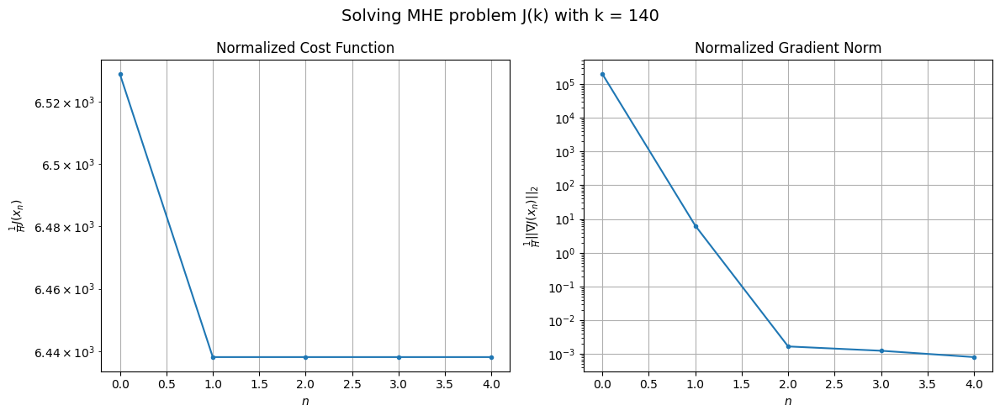

Windows:  29%|██▊       | 102/356 [14:59<28:45,  6.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 227428.47500513602
Gradient norm: 8395340.707803493
Global estimation error: 45.21503762839055
Initial conditions estimation errors: 22.419341136772605 m, 22.48806665619561 m, 21.38760697159487 m, 24.054035256664243 m
Position estimation errors: 13.867033432292894 m, 13.359785721890225 m, 12.279957002488592 m, 13.141450560546353 m

[Gauss-Newton] Iteration 1
Cost function: 224680.05004649557 (-1.21%)
Gradient norm: 20.590681751951188 (-100.00%)
Global estimation error: 50.25759142451136 (11.15%)
Initial conditions estimation errors: 23.851675416612622 m, 24.701796044022686 m, 22.83438301657748 m, 28.728073420099545 m
Position estimation errors: 12.991358122289244 m, 12.687548809667302 m, 11.203605901756816 m, 11.018854476091333 m

[Gauss-Newton] Iteration 2
Cost function: 224680.05003795688 (-0.00%)
Gradient norm: 0.1088982304102707 (-99.47%)
Global estimation error: 50.262878132919695 (0.01%)
Initial conditions estimation err

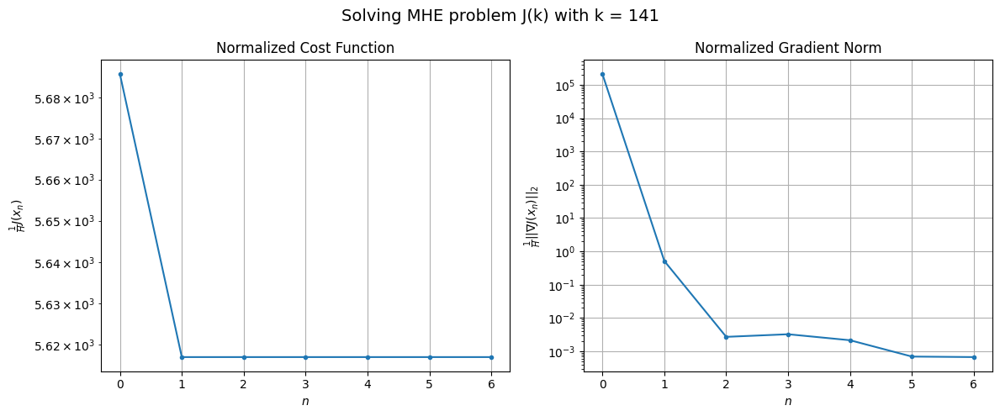

Windows:  29%|██▉       | 103/356 [15:07<30:19,  7.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 209739.0476159405
Gradient norm: 8674885.724646505
Global estimation error: 40.10092623211517
Initial conditions estimation errors: 18.440784964031128 m, 19.35169680700375 m, 17.64835552380905 m, 24.125488229747404 m
Position estimation errors: 16.432673273665564 m, 16.204962993281757 m, 14.521527184600558 m, 14.501390557342663 m

[Gauss-Newton] Iteration 1
Cost function: 207691.05871603754 (-0.98%)
Gradient norm: 215.65789283341212 (-100.00%)
Global estimation error: 40.060333416202155 (-0.10%)
Initial conditions estimation errors: 19.444720598258904 m, 19.213897222253927 m, 19.53420778274658 m, 21.816097266800863 m
Position estimation errors: 15.494355830749665 m, 15.067003138025887 m, 14.811376183873188 m, 14.318880204957466 m

[Gauss-Newton] Iteration 2
Cost function: 207691.05859437853 (-0.00%)
Gradient norm: 0.022989111549551786 (-99.99%)
Global estimation error: 40.066243571083234 (0.01%)
Initial conditions estimation e

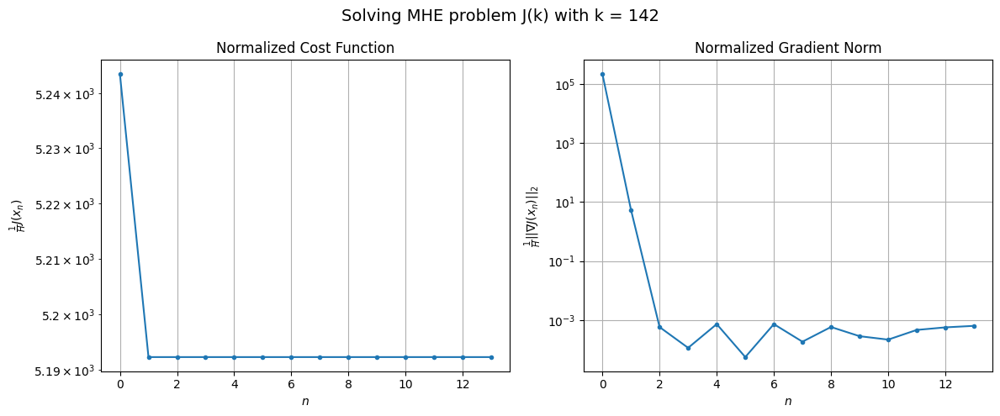

Windows:  29%|██▉       | 104/356 [15:22<40:03,  9.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 207064.32595031406
Gradient norm: 8896145.22079633
Global estimation error: 30.06074362735312
Initial conditions estimation errors: 14.33782189970855 m, 14.124200106113216 m, 14.489173156424238 m, 16.98876166048339 m
Position estimation errors: 19.084325532770926 m, 18.685374567112557 m, 18.391429903622058 m, 18.1065511777124 m

[Gauss-Newton] Iteration 1
Cost function: 205344.81314641912 (-0.83%)
Gradient norm: 12.800569351415634 (-100.00%)
Global estimation error: 29.893516773215776 (-0.56%)
Initial conditions estimation errors: 14.93405135708134 m, 14.154527287366678 m, 14.733617149755457 m, 15.91031462783744 m
Position estimation errors: 17.96016059745501 m, 16.87473257064158 m, 16.783131681626067 m, 15.717999688624609 m

[Gauss-Newton] Iteration 2
Cost function: 205344.81314542002 (-0.00%)
Gradient norm: 0.12839662439268423 (-99.00%)
Global estimation error: 29.889166470620633 (-0.01%)
Initial conditions estimation errors

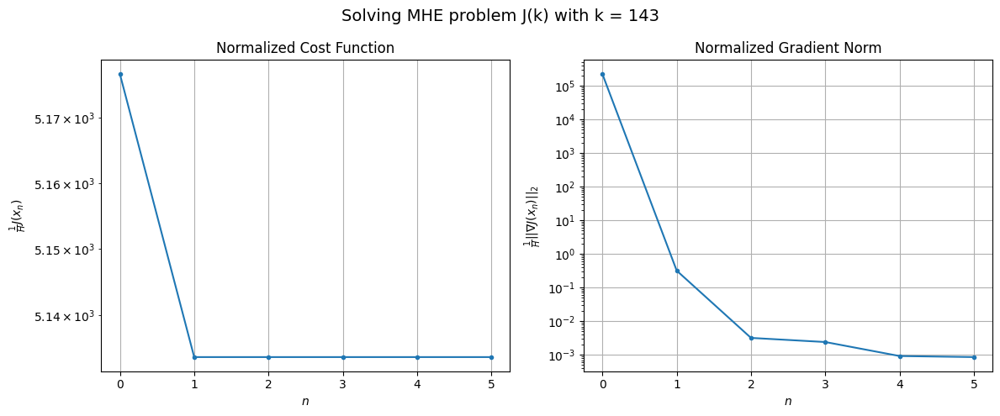

Windows:  29%|██▉       | 105/356 [15:29<36:53,  8.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 217775.17328878833
Gradient norm: 8907768.432154287
Global estimation error: 20.781812905342232
Initial conditions estimation errors: 10.274134381714118 m, 9.527421193004582 m, 10.156711945530919 m, 11.50531430533906 m
Position estimation errors: 21.648968207687716 m, 20.544692051883562 m, 20.42850261122191 m, 19.530503489422625 m

[Gauss-Newton] Iteration 1
Cost function: 216093.06544992226 (-0.77%)
Gradient norm: 43.01952066610966 (-100.00%)
Global estimation error: 22.15814792717155 (6.62%)
Initial conditions estimation errors: 10.501874036483274 m, 10.138804092697825 m, 10.158542301010671 m, 13.216667507748902 m
Position estimation errors: 20.288834916871885 m, 19.200989492975967 m, 19.08366769992481 m, 17.097862875725575 m

[Gauss-Newton] Iteration 2
Cost function: 216093.06544883372 (-0.00%)
Gradient norm: 0.02924654823089908 (-99.93%)
Global estimation error: 22.15452519483528 (-0.02%)
Initial conditions estimation erro

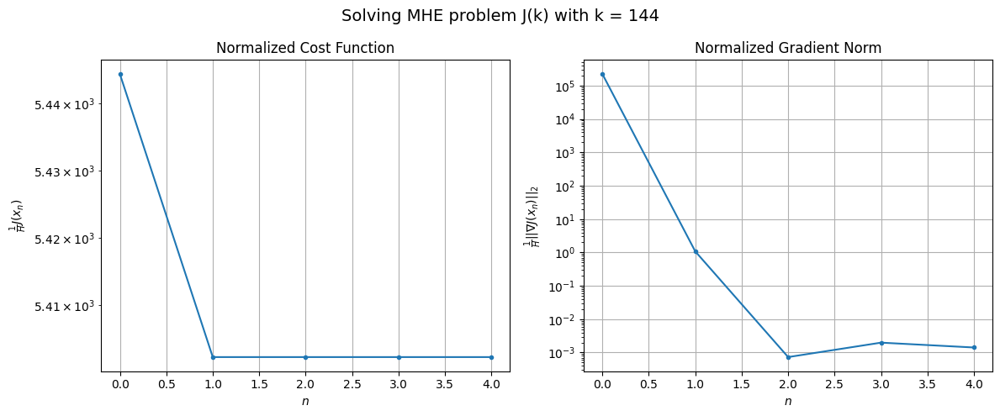

Windows:  30%|██▉       | 106/356 [15:35<32:57,  7.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 239220.8295672023
Gradient norm: 8897511.828702053
Global estimation error: 14.788815785323772
Initial conditions estimation errors: 6.582122707982756 m, 6.2985861266033165 m, 6.563580640293957 m, 9.623666889560907 m
Position estimation errors: 24.062318200513086 m, 22.984201341800542 m, 22.914859025643022 m, 21.190340181575735 m

[Gauss-Newton] Iteration 1
Cost function: 237272.46265233308 (-0.81%)
Gradient norm: 32.73319633416439 (-100.00%)
Global estimation error: 17.505147544444387 (18.37%)
Initial conditions estimation errors: 6.6334094398694985 m, 6.656189675462859 m, 6.865391873468995 m, 13.07564958816418 m
Position estimation errors: 22.453048438954227 m, 22.05553314594341 m, 22.370768269261198 m, 22.11982221198512 m

[Gauss-Newton] Iteration 2
Cost function: 237272.46263118534 (-0.00%)
Gradient norm: 0.03200915648441259 (-99.90%)
Global estimation error: 17.510651450477347 (0.03%)
Initial conditions estimation errors:

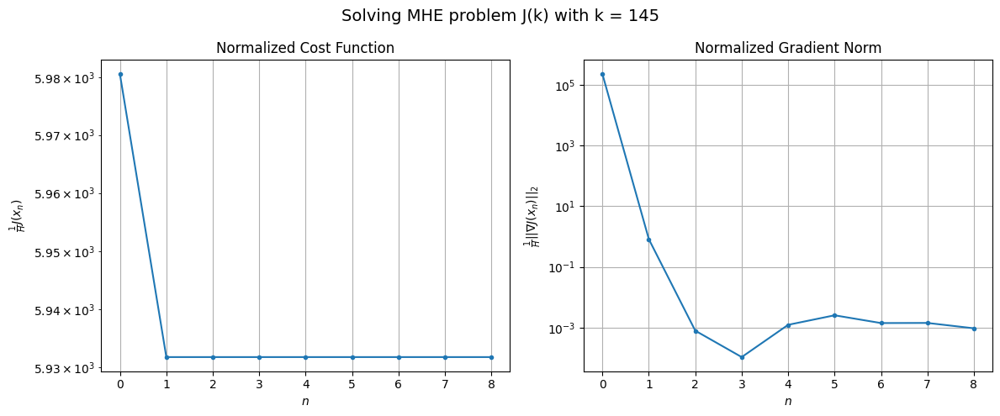

Windows:  30%|███       | 107/356 [15:44<35:04,  8.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 269011.5687136509
Gradient norm: 8714071.281722823
Global estimation error: 12.341722712140445
Initial conditions estimation errors: 4.170134355440041 m, 4.002909944790909 m, 4.676260987476509 m, 9.850135743664005 m
Position estimation errors: 26.30928844697736 m, 25.971384315905542 m, 26.38723890126436 m, 26.476924888127847 m

[Gauss-Newton] Iteration 1
Cost function: 266627.6813229182 (-0.89%)
Gradient norm: 121.43746175505626 (-100.00%)
Global estimation error: 10.873987174991152 (-11.89%)
Initial conditions estimation errors: 4.501974098707209 m, 3.6561671333949 m, 4.386878188453366 m, 8.083975010087801 m
Position estimation errors: 24.445899187550626 m, 24.395905152832853 m, 25.996995000670882 m, 27.460666706794786 m

[Gauss-Newton] Iteration 2
Cost function: 266627.68130061467 (-0.00%)
Gradient norm: 0.049565439000190975 (-99.96%)
Global estimation error: 10.883400558375476 (0.09%)
Initial conditions estimation errors: 4

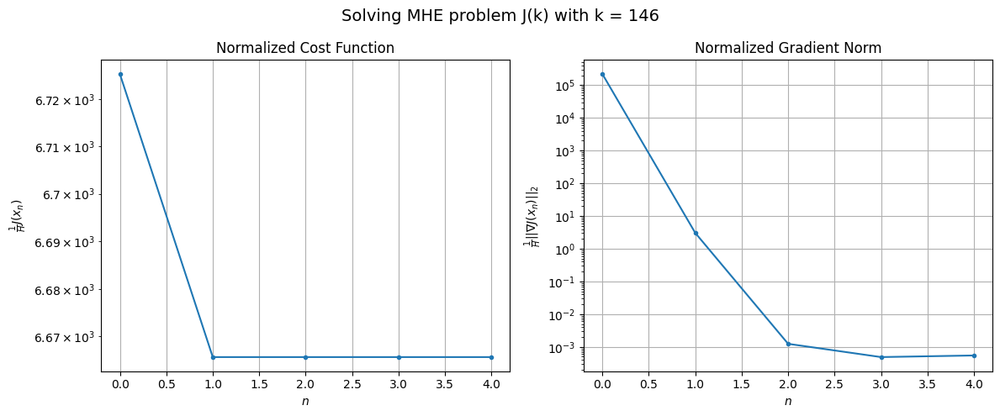

Windows:  30%|███       | 108/356 [15:50<31:54,  7.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 305381.2992835182
Gradient norm: 8775590.545238087
Global estimation error: 8.897716752756658
Initial conditions estimation errors: 4.630777920017899 m, 3.9298288502184375 m, 3.8374005182781312 m, 5.248490226377722 m
Position estimation errors: 28.37936456155824 m, 28.380797787369705 m, 30.039788056202514 m, 31.54946376515117 m

[Gauss-Newton] Iteration 1
Cost function: 302206.35557833273 (-1.04%)
Gradient norm: 273.4535364837867 (-100.00%)
Global estimation error: 13.066759805754442 (46.86%)
Initial conditions estimation errors: 5.752183702016772 m, 6.453857133824477 m, 5.637784236413091 m, 8.012816488355266 m
Position estimation errors: 26.225485894123214 m, 24.963346968781302 m, 27.47641841488391 m, 27.38382874945466 m

[Gauss-Newton] Iteration 2
Cost function: 302206.3550437017 (-0.00%)
Gradient norm: 0.010078124967604548 (-100.00%)
Global estimation error: 13.068688981474065 (0.01%)
Initial conditions estimation errors: 5

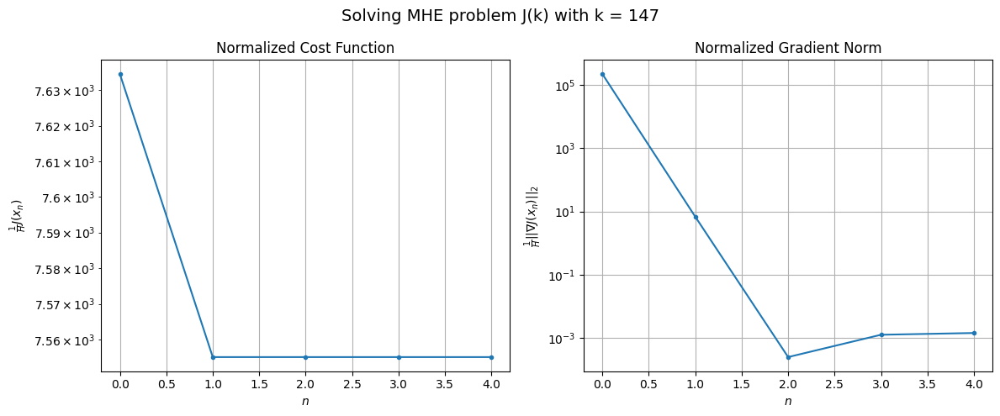

Windows:  31%|███       | 109/356 [15:56<28:44,  6.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 346137.4098427922
Gradient norm: 9107518.265500154
Global estimation error: 16.603845670340608
Initial conditions estimation errors: 7.115091018883066 m, 8.228296150087743 m, 6.6440507167800416 m, 10.639875384612663 m
Position estimation errors: 30.2201643313788 m, 28.920141152793306 m, 31.33312055203496 m, 30.84444530383627 m

[Gauss-Newton] Iteration 1
Cost function: 342002.4117656307 (-1.19%)
Gradient norm: 95.7396971639091 (-100.00%)
Global estimation error: 19.894012328055833 (19.82%)
Initial conditions estimation errors: 8.681218293014473 m, 9.901354289735922 m, 8.979344548975256 m, 11.905262387655094 m
Position estimation errors: 27.771857849830496 m, 26.122633020079988 m, 27.79716478121358 m, 25.891456583345047 m

[Gauss-Newton] Iteration 2
Cost function: 342002.4117511137 (-0.00%)
Gradient norm: 0.02144860058557955 (-99.98%)
Global estimation error: 19.89793233703249 (0.02%)
Initial conditions estimation errors: 8.681

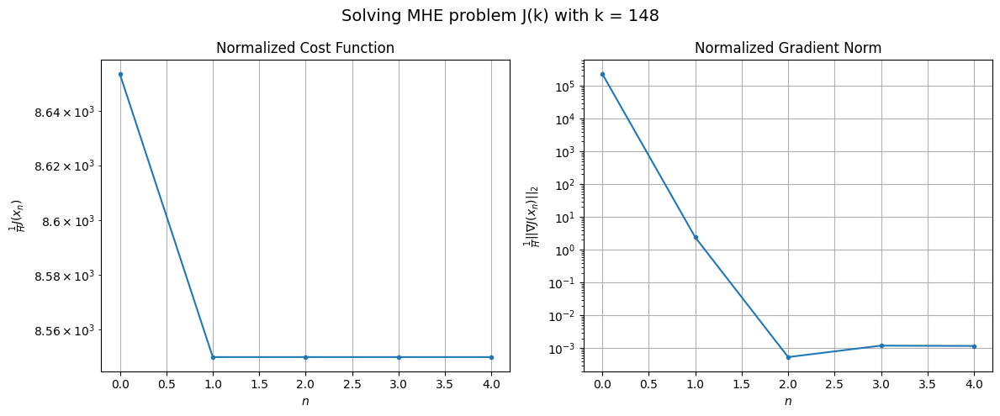

Windows:  31%|███       | 110/356 [16:02<27:27,  6.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 387899.123609051
Gradient norm: 9056397.466771334
Global estimation error: 22.686652805514615
Initial conditions estimation errors: 10.063774089038578 m, 11.334555261491644 m, 10.240212352775465 m, 13.418821815423394 m
Position estimation errors: 31.81217172695596 m, 30.158279334428467 m, 31.769791208850197 m, 29.726517942604346 m

[Gauss-Newton] Iteration 1
Cost function: 382748.7295828298 (-1.33%)
Gradient norm: 127.7372706935918 (-100.00%)
Global estimation error: 32.08616687826636 (41.43%)
Initial conditions estimation errors: 11.975327708097213 m, 14.6106524642933 m, 12.230630690858659 m, 22.87024068806798 m
Position estimation errors: 29.108437030497626 m, 26.510780773346497 m, 29.83711122501086 m, 25.133832224520344 m

[Gauss-Newton] Iteration 2
Cost function: 382748.72944415215 (-0.00%)
Gradient norm: 0.005029979994711693 (-100.00%)
Global estimation error: 32.09343833930026 (0.02%)
Initial conditions estimation errors

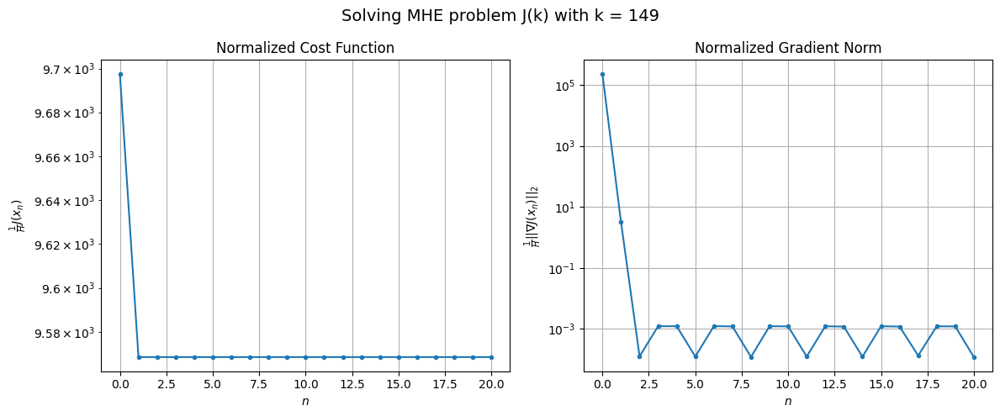

Windows:  31%|███       | 111/356 [16:24<46:44, 11.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 430718.1070104439
Gradient norm: 9446164.113059
Global estimation error: 34.67520823472022
Initial conditions estimation errors: 13.10690605980489 m, 15.751534945770135 m, 13.363511193466426 m, 24.573970589503247 m
Position estimation errors: 33.18370965226805 m, 30.545020671165403 m, 33.7138301992425 m, 28.632026268862862 m

[Gauss-Newton] Iteration 1
Cost function: 424442.91941114643 (-1.46%)
Gradient norm: 4.667084918609724 (-100.00%)
Global estimation error: 38.89660649741043 (12.17%)
Initial conditions estimation errors: 15.299960205340069 m, 17.92670838470626 m, 16.230505501215855 m, 26.34494608611177 m
Position estimation errors: 30.21619668437118 m, 27.402160551660963 m, 30.047107382112678 m, 25.116744354279618 m

[Gauss-Newton] Iteration 2
Cost function: 424442.91940736317 (-0.00%)
Gradient norm: 0.009354333997254091 (-99.80%)
Global estimation error: 38.89505689956244 (-0.00%)
Initial conditions estimation errors: 15

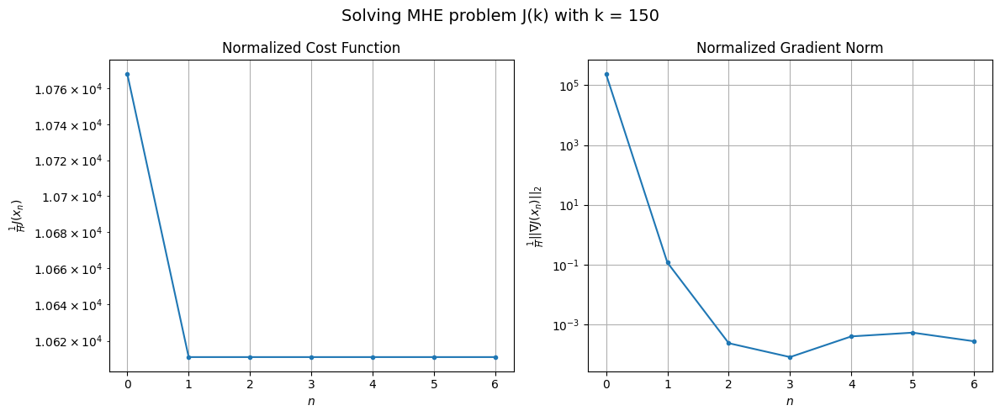

Windows:  31%|███▏      | 112/356 [16:31<41:13, 10.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 471867.16294384864
Gradient norm: 9676395.627378022
Global estimation error: 40.65092625345486
Initial conditions estimation errors: 16.112473583976016 m, 18.659203462643017 m, 17.02666935050098 m, 27.473785608482086 m
Position estimation errors: 34.31556010322521 m, 31.441382235406117 m, 33.90054863208477 m, 28.661098038122585 m

[Gauss-Newton] Iteration 1
Cost function: 464402.3423246966 (-1.58%)
Gradient norm: 68.77560815781945 (-100.00%)
Global estimation error: 41.77870722806348 (2.77%)
Initial conditions estimation errors: 18.58134081050411 m, 20.423326667776355 m, 19.17296816920165 m, 24.808777531669435 m
Position estimation errors: 31.101346300161566 m, 29.005981684727786 m, 30.79757688066163 m, 26.40782755312725 m

[Gauss-Newton] Iteration 2
Cost function: 464402.3423123053 (-0.00%)
Gradient norm: 0.06971079148537523 (-99.90%)
Global estimation error: 41.77344721003241 (-0.01%)
Initial conditions estimation errors: 18

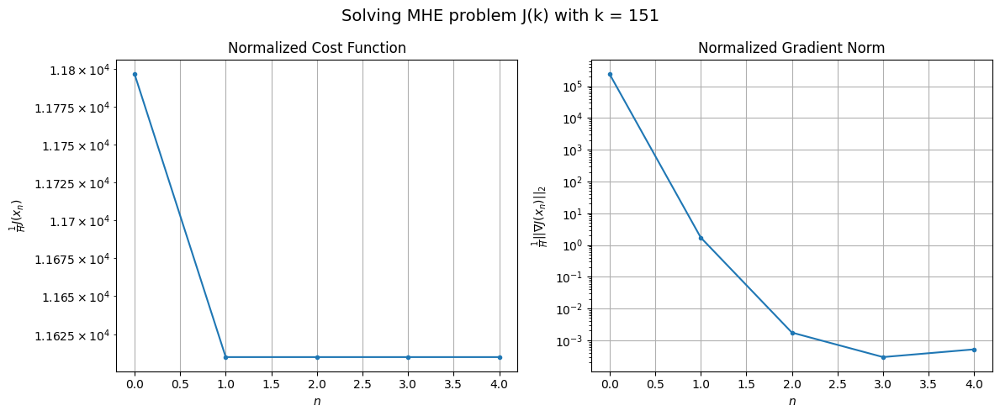

Windows:  32%|███▏      | 113/356 [16:37<35:49,  8.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 508419.91625874664
Gradient norm: 9787054.745039027
Global estimation error: 42.43912328977709
Initial conditions estimation errors: 19.010297974453668 m, 20.738174602990476 m, 19.569839099203755 m, 25.03265911529192 m
Position estimation errors: 35.215027171995864 m, 33.091275446566456 m, 34.79104156615394 m, 30.289784108891325 m

[Gauss-Newton] Iteration 1
Cost function: 499771.9176884622 (-1.70%)
Gradient norm: 25.163201177165828 (-100.00%)
Global estimation error: 50.43484793123165 (18.84%)
Initial conditions estimation errors: 21.762185892060014 m, 24.3688862218329 m, 22.400277298204497 m, 31.21639174210372 m
Position estimation errors: 31.78432007270437 m, 28.88702254389754 m, 31.655547055828833 m, 26.176420988053632 m

[Gauss-Newton] Iteration 2
Cost function: 499771.9177079913 (0.00%)
Gradient norm: 0.01981063037610313 (-99.92%)
Global estimation error: 50.43656304941445 (0.00%)
Initial conditions estimation errors: 21

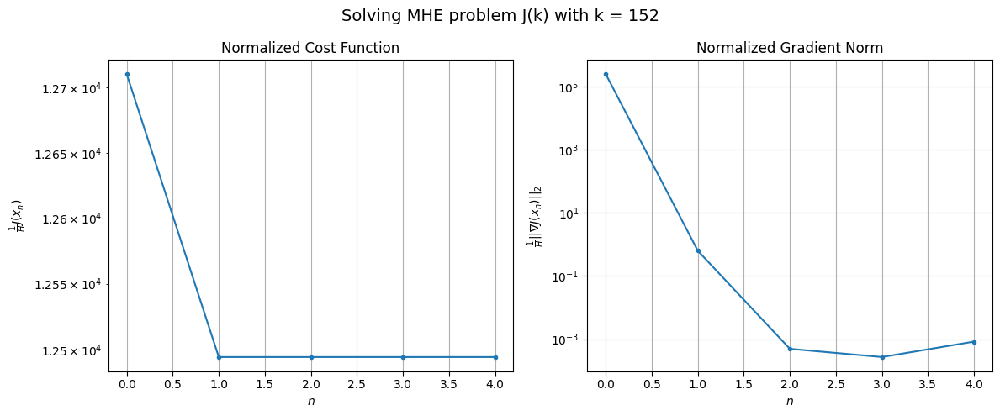

Windows:  32%|███▏      | 114/356 [16:42<31:05,  7.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 539923.1974589053
Gradient norm: 10083101.061302286
Global estimation error: 50.38409680366852
Initial conditions estimation errors: 21.727583898509764 m, 24.218115623947416 m, 22.445899892773426 m, 31.243089386185613 m
Position estimation errors: 35.91402289891571 m, 32.96216936118449 m, 35.56971163720285 m, 29.97393210970113 m

[Gauss-Newton] Iteration 1
Cost function: 530010.8140181842 (-1.84%)
Gradient norm: 163.14895209939323 (-100.00%)
Global estimation error: 54.5109957669212 (8.19%)
Initial conditions estimation errors: 24.753550652213264 m, 26.368119960849626 m, 24.755370901164298 m, 32.412973672933035 m
Position estimation errors: 32.26690190681926 m, 30.12528550719325 m, 32.08199710134014 m, 23.893138815149445 m

[Gauss-Newton] Iteration 2
Cost function: 530010.8139916473 (-0.00%)
Gradient norm: 0.01962267274295418 (-99.99%)
Global estimation error: 54.5358930412556 (0.05%)
Initial conditions estimation errors: 24.7

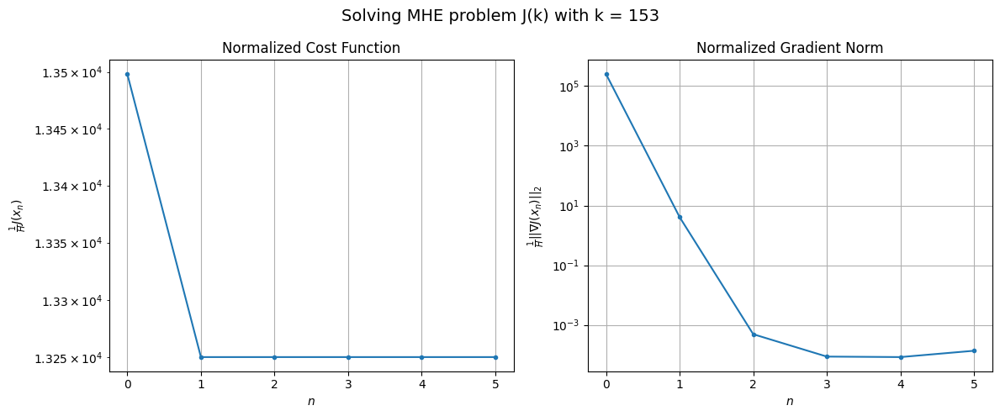

Windows:  32%|███▏      | 115/356 [16:49<29:38,  7.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 565605.6387473735
Gradient norm: 10496140.244827894
Global estimation error: 52.97216476271587
Initial conditions estimation errors: 24.15723148988604 m, 25.683379929527128 m, 24.200348919008853 m, 31.259894621064976 m
Position estimation errors: 36.415524479899666 m, 34.23094886524848 m, 36.127329630944914 m, 28.157622463491023 m

[Gauss-Newton] Iteration 1
Cost function: 554416.4207644286 (-1.98%)
Gradient norm: 91.41596667783452 (-100.00%)
Global estimation error: 54.11102857234687 (2.15%)
Initial conditions estimation errors: 27.453988138880625 m, 27.71092185849409 m, 26.644594312412412 m, 26.39029208434073 m
Position estimation errors: 32.566526981665724 m, 31.42286084320841 m, 32.28275325453056 m, 26.84728441209955 m

[Gauss-Newton] Iteration 2
Cost function: 554416.4206540193 (-0.00%)
Gradient norm: 0.024671372131411604 (-99.97%)
Global estimation error: 54.10198333189741 (-0.02%)
Initial conditions estimation errors: 2

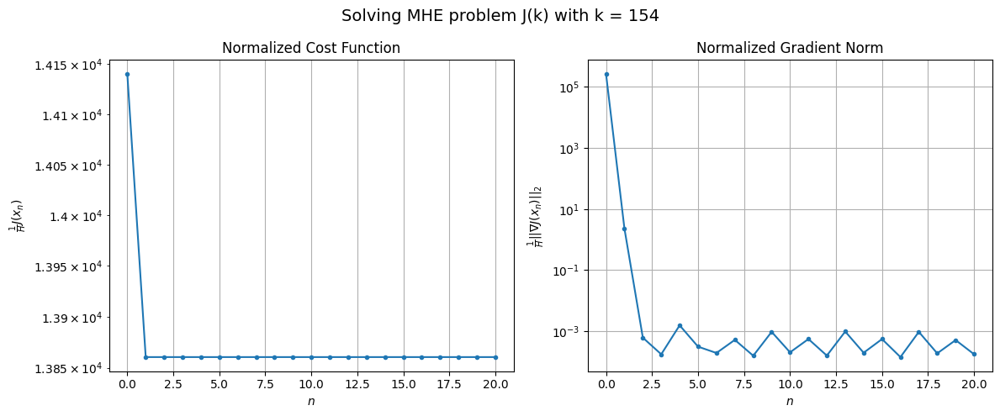

Windows:  33%|███▎      | 116/356 [17:10<45:43, 11.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 585234.7093158219
Gradient norm: 10918071.746338256
Global estimation error: 51.15641698541315
Initial conditions estimation errors: 26.21496932929443 m, 26.411757906072836 m, 25.334298648799905 m, 24.29690707655082 m
Position estimation errors: 36.72797070173481 m, 35.57098118410586 m, 36.48094415319236 m, 31.54213277029712 m

[Gauss-Newton] Iteration 1
Cost function: 572841.0254600381 (-2.12%)
Gradient norm: 57.76751829032779 (-100.00%)
Global estimation error: 57.95674383451631 (13.29%)
Initial conditions estimation errors: 29.774470509401212 m, 29.780586742040118 m, 28.857908792742453 m, 27.437112005360053 m
Position estimation errors: 32.70361004773751 m, 31.622614945255478 m, 32.06916490069661 m, 25.75997460862258 m

[Gauss-Newton] Iteration 2
Cost function: 572841.0254563404 (-0.00%)
Gradient norm: 0.08024215194735686 (-99.86%)
Global estimation error: 57.96456331970447 (0.01%)
Initial conditions estimation errors: 29.7

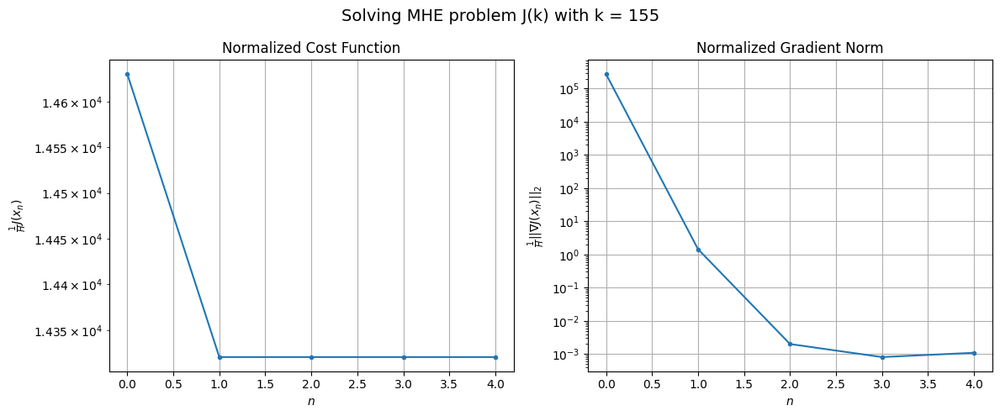

Windows:  33%|███▎      | 117/356 [17:15<38:38,  9.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 596852.3109242114
Gradient norm: 11156150.599594006
Global estimation error: 53.558895169792315
Initial conditions estimation errors: 27.857014234586632 m, 27.798074634551856 m, 26.794242815724807 m, 24.53296987066313 m
Position estimation errors: 36.853482308535966 m, 35.79230282500175 m, 36.34101567549632 m, 30.74195744599658 m

[Gauss-Newton] Iteration 1
Cost function: 583487.4644216169 (-2.24%)
Gradient norm: 40.84180178475569 (-100.00%)
Global estimation error: 61.17357115609578 (14.22%)
Initial conditions estimation errors: 31.65594173570296 m, 31.732614994246177 m, 30.77837769010478 m, 28.03263999011321 m
Position estimation errors: 32.70938387139006 m, 31.84931519711976 m, 32.54001543582672 m, 28.85355452104643 m

[Gauss-Newton] Iteration 2
Cost function: 583487.464406061 (-0.00%)
Gradient norm: 0.07254579797688081 (-99.82%)
Global estimation error: 61.171069848529456 (-0.00%)
Initial conditions estimation errors: 31.6

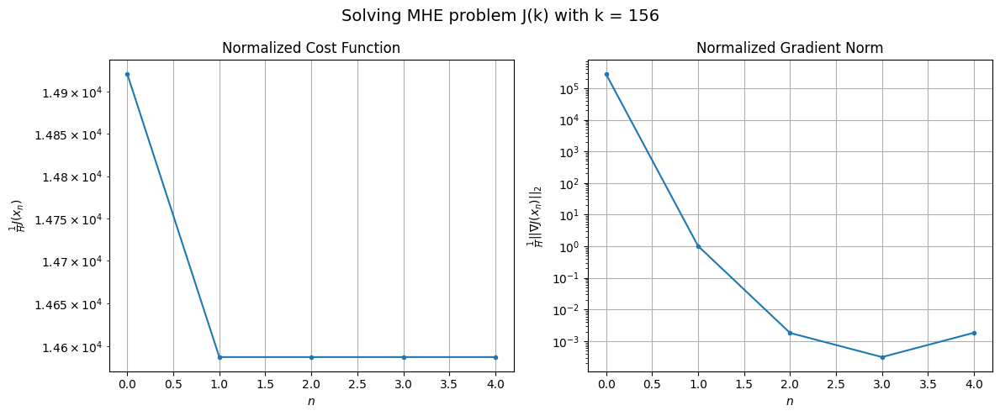

Windows:  33%|███▎      | 118/356 [17:21<34:08,  8.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 601334.413446183
Gradient norm: 11614633.443485448
Global estimation error: 55.63074593999791
Initial conditions estimation errors: 29.06270915711904 m, 29.07957215400932 m, 28.067415066076183 m, 24.833900888838198 m
Position estimation errors: 36.82053308689747 m, 36.0071815794175 m, 36.768820697011904 m, 33.66980990921762 m

[Gauss-Newton] Iteration 1
Cost function: 586918.5526624181 (-2.40%)
Gradient norm: 13.006565372303964 (-100.00%)
Global estimation error: 62.79586803391311 (12.88%)
Initial conditions estimation errors: 33.111416329092684 m, 32.696825329573166 m, 31.89626431901914 m, 27.576899121741633 m
Position estimation errors: 32.54967114628604 m, 32.2833703921781 m, 32.63228939440912 m, 29.86989069737056 m

[Gauss-Newton] Iteration 2
Cost function: 586918.5526781848 (0.00%)
Gradient norm: 0.014238768411258255 (-99.89%)
Global estimation error: 62.79344259901789 (-0.00%)
Initial conditions estimation errors: 33.111

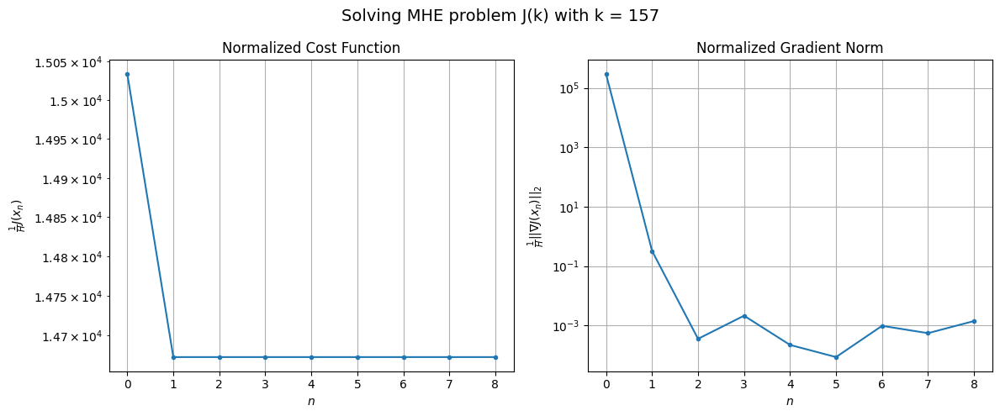

Windows:  33%|███▎      | 119/356 [17:31<34:39,  8.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 599837.0420323274
Gradient norm: 11981808.567483608
Global estimation error: 56.026475936844136
Initial conditions estimation errors: 29.868071291829132 m, 29.440573333704698 m, 28.501824423592403 m, 23.827354566368403 m
Position estimation errors: 36.60663034780366 m, 36.33876991805548 m, 36.82957044580563 m, 34.65860056124663 m

[Gauss-Newton] Iteration 1
Cost function: 584560.5014450029 (-2.55%)
Gradient norm: 82.65632442159371 (-100.00%)
Global estimation error: 64.8863265621195 (15.81%)
Initial conditions estimation errors: 34.14137242960822 m, 33.922972479958865 m, 33.04317563745652 m, 28.31893291318981 m
Position estimation errors: 32.24605650873007 m, 31.828889980316177 m, 32.5906749906195 m, 33.13939496941287 m

[Gauss-Newton] Iteration 2
Cost function: 584560.5014430771 (-0.00%)
Gradient norm: 0.03850241279935377 (-99.95%)
Global estimation error: 64.88953061988123 (0.00%)
Initial conditions estimation errors: 34.141

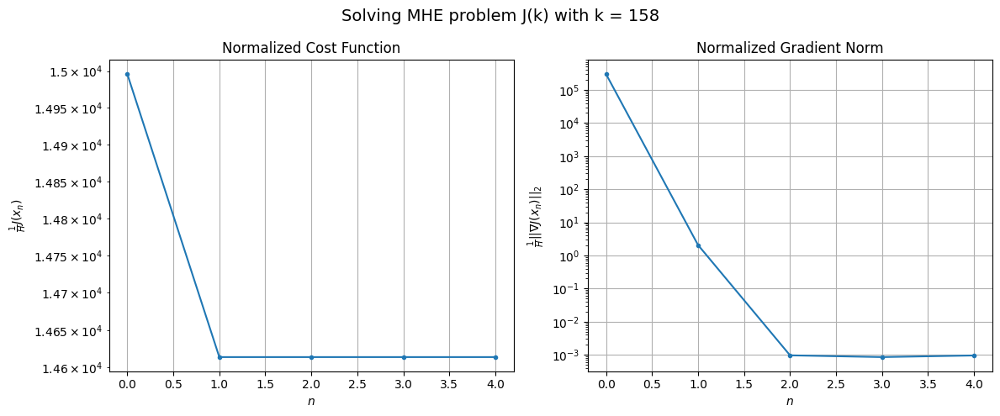

Windows:  34%|███▎      | 120/356 [17:36<30:51,  7.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 591329.2399624311
Gradient norm: 12658701.171956401
Global estimation error: 57.084099842556164
Initial conditions estimation errors: 30.2858918440749 m, 30.061554823151507 m, 29.092752062347248 m, 24.315612989936636 m
Position estimation errors: 36.270329257120146 m, 35.84100003506681 m, 36.687553777135165 m, 37.53721834072584 m

[Gauss-Newton] Iteration 1
Cost function: 575395.2068948138 (-2.69%)
Gradient norm: 153.22685447284508 (-100.00%)
Global estimation error: 66.40014106653544 (16.32%)
Initial conditions estimation errors: 34.733641894336714 m, 34.98471144260011 m, 33.80635515555214 m, 28.908900004069643 m
Position estimation errors: 31.83262764527229 m, 30.6464735246965 m, 31.775521791142584 m, 29.205959783357653 m

[Gauss-Newton] Iteration 2
Cost function: 575395.2068915932 (-0.00%)
Gradient norm: 0.015284992390810315 (-99.99%)
Global estimation error: 66.39900294411586 (-0.00%)
Initial conditions estimation errors: 

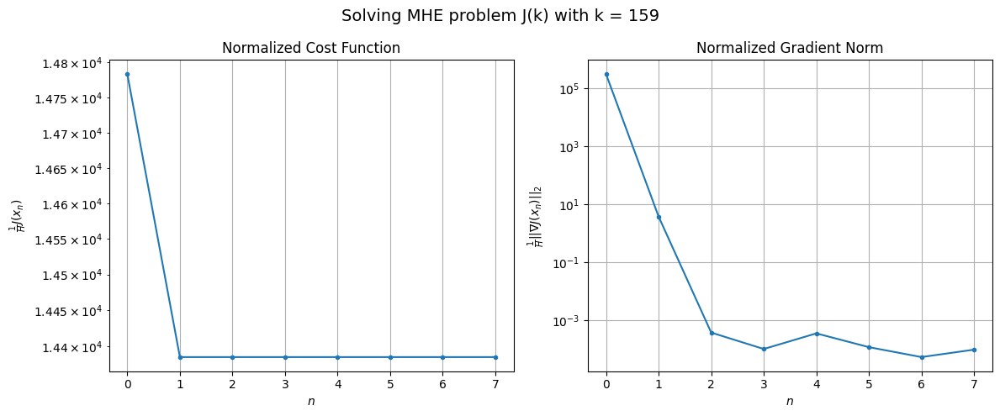

Windows:  34%|███▍      | 121/356 [17:45<31:26,  8.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 578778.6223894852
Gradient norm: 13125257.375675201
Global estimation error: 57.18468130062783
Initial conditions estimation errors: 30.32959949833768 m, 30.455103006189116 m, 29.11350180667235 m, 23.98044523546305 m
Position estimation errors: 35.87251580805023 m, 34.82283423468084 m, 36.06634499955763 m, 34.0220191391233 m

[Gauss-Newton] Iteration 1
Cost function: 562604.0685256809 (-2.79%)
Gradient norm: 1138.6751732675034 (-99.99%)
Global estimation error: 67.49516822539519 (18.03%)
Initial conditions estimation errors: 34.87945801449787 m, 34.140566530837546 m, 34.02668963570764 m, 31.868432651388744 m
Position estimation errors: 31.41012353888226 m, 32.154955122589975 m, 32.79614797889756 m, 39.2569588095434 m

[Gauss-Newton] Iteration 2
Cost function: 562604.0671113438 (-0.00%)
Gradient norm: 0.09036440753461339 (-99.99%)
Global estimation error: 67.50001495419319 (0.01%)
Initial conditions estimation errors: 34.879460

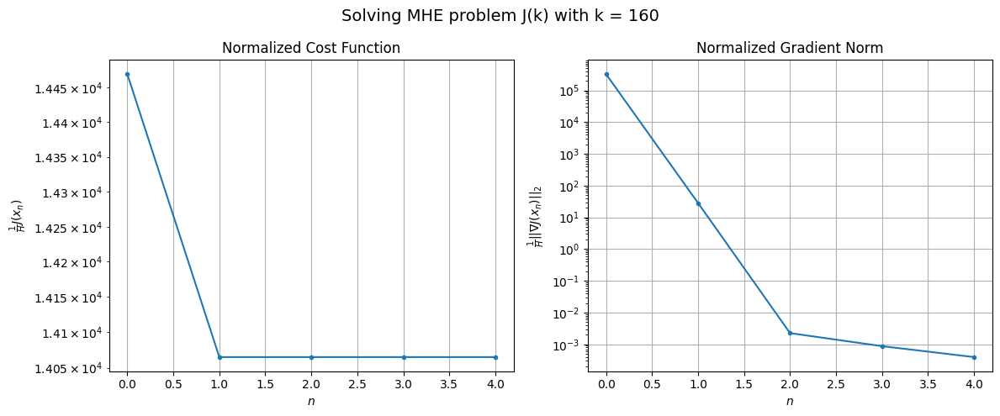

Windows:  34%|███▍      | 122/356 [17:50<28:35,  7.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 564815.8571198448
Gradient norm: 14069073.429653406
Global estimation error: 58.009446144460284
Initial conditions estimation errors: 30.03002044455734 m, 29.333474905148123 m, 29.328042974906992 m, 27.252069088454313 m
Position estimation errors: 35.5274311208892 m, 36.24978074296064 m, 36.84186180534143 m, 42.81835653489901 m

[Gauss-Newton] Iteration 1
Cost function: 548331.5738489474 (-2.92%)
Gradient norm: 218.55421464561732 (-100.00%)
Global estimation error: 69.8917224406629 (20.48%)
Initial conditions estimation errors: 34.64465481758815 m, 35.07900063376557 m, 34.91669511068021 m, 35.14048119414283 m
Position estimation errors: 30.983634277316074 m, 30.43891632931115 m, 31.469826315283523 m, 31.722699566371062 m

[Gauss-Newton] Iteration 2
Cost function: 548331.5738296524 (-0.00%)
Gradient norm: 0.06610054052265933 (-99.97%)
Global estimation error: 69.88982232649906 (-0.00%)
Initial conditions estimation errors: 34.6

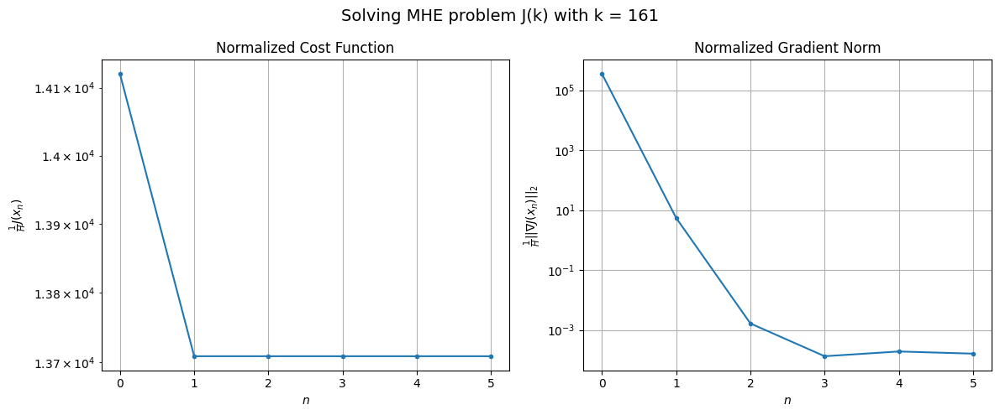

Windows:  35%|███▍      | 123/356 [17:57<27:33,  7.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 550785.5898805105
Gradient norm: 15068531.718611065
Global estimation error: 59.624562825883196
Initial conditions estimation errors: 29.512966872111612 m, 29.92859220712202 m, 29.840297756463162 m, 29.96456581857081 m
Position estimation errors: 35.196496513425096 m, 34.7294107011973 m, 35.63667329184262 m, 35.91160865355384 m

[Gauss-Newton] Iteration 1
Cost function: 534232.6570919554 (-3.01%)
Gradient norm: 4737.400952401302 (-99.97%)
Global estimation error: 69.09357955033583 (15.88%)
Initial conditions estimation errors: 34.13168418771949 m, 32.36773502746365 m, 34.622065223156426 m, 36.91288345482478 m
Position estimation errors: 30.57591173563925 m, 34.480269833004314 m, 33.48424637103074 m, 55.302502575021464 m

[Gauss-Newton] Iteration 2
Cost function: 534232.6384494819 (-0.00%)
Gradient norm: 0.8302716212354658 (-99.98%)
Global estimation error: 69.07189860249932 (-0.03%)
Initial conditions estimation errors: 34.131

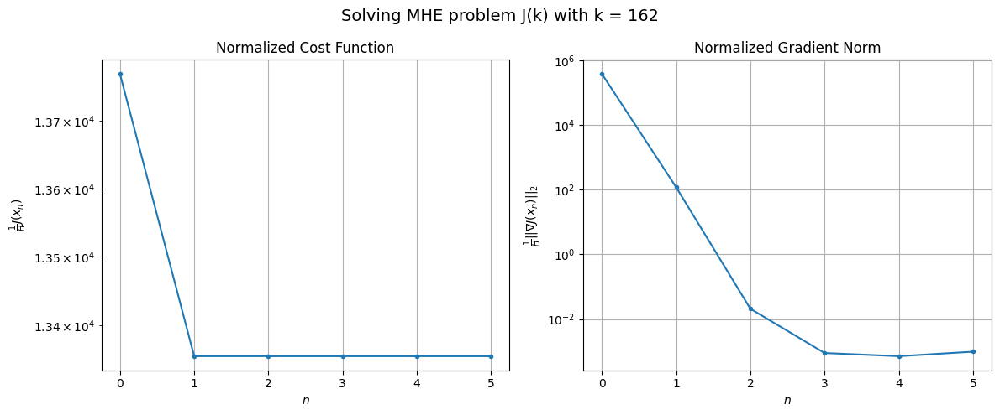

Windows:  35%|███▍      | 124/356 [18:04<26:53,  6.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 536248.358622757
Gradient norm: 15787346.817337198
Global estimation error: 59.840880284783644
Initial conditions estimation errors: 28.92548400175063 m, 27.49630475805306 m, 30.3057750227451 m, 32.706758989455956 m
Position estimation errors: 34.84631903705418 m, 38.29041387808313 m, 37.10080797681872 m, 56.56390811522965 m

[Gauss-Newton] Iteration 1
Cost function: 519870.61463893 (-3.05%)
Gradient norm: 4043.4290615123427 (-99.97%)
Global estimation error: 63.972378837964506 (6.90%)
Initial conditions estimation errors: 33.509196394369646 m, 32.38935095759434 m, 32.05203566037088 m, 29.885798624374576 m
Position estimation errors: 30.173146282622326 m, 30.9070548473816 m, 31.665648430146014 m, 33.55491890357609 m

[Gauss-Newton] Iteration 2
Cost function: 519870.59741736995 (-0.00%)
Gradient norm: 0.6313032178628467 (-99.98%)
Global estimation error: 63.982932233451194 (0.02%)
Initial conditions estimation errors: 33.509198

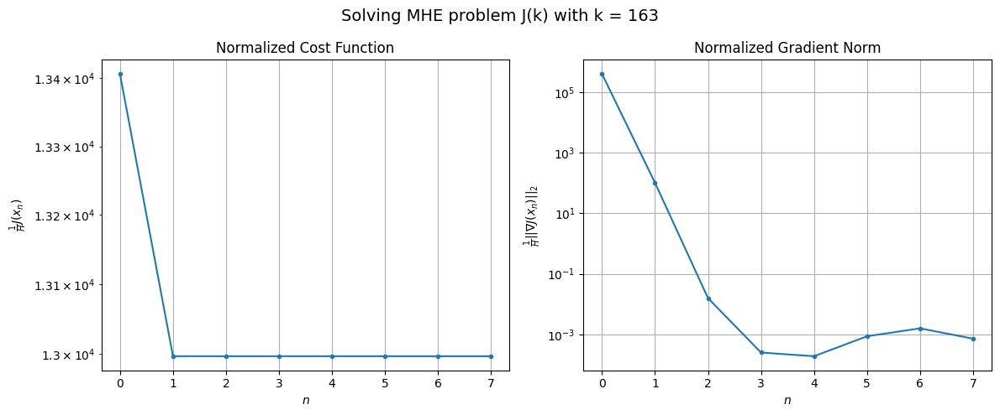

Windows:  35%|███▌      | 125/356 [18:13<29:06,  7.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 523125.9015907515
Gradient norm: 16754013.809991334
Global estimation error: 54.03354828086768
Initial conditions estimation errors: 28.42641094272873 m, 27.423673282067522 m, 27.165685945847933 m, 24.929937493639 m
Position estimation errors: 34.437418152891624 m, 34.96234792638452 m, 35.651411994624056 m, 37.530449766846594 m

[Gauss-Newton] Iteration 1
Cost function: 506991.7859870382 (-3.08%)
Gradient norm: 881.158747927342 (-99.99%)
Global estimation error: 65.55761383453044 (21.33%)
Initial conditions estimation errors: 32.930394752513934 m, 32.52903088258454 m, 32.82441986539008 m, 32.8294740660481 m
Position estimation errors: 29.679612335854344 m, 29.061348814095908 m, 30.20813130502441 m, 24.273725997642355 m

[Gauss-Newton] Iteration 2
Cost function: 506991.7854472688 (-0.00%)
Gradient norm: 0.18790063085293643 (-99.98%)
Global estimation error: 65.55162750362928 (-0.01%)
Initial conditions estimation errors: 32.930

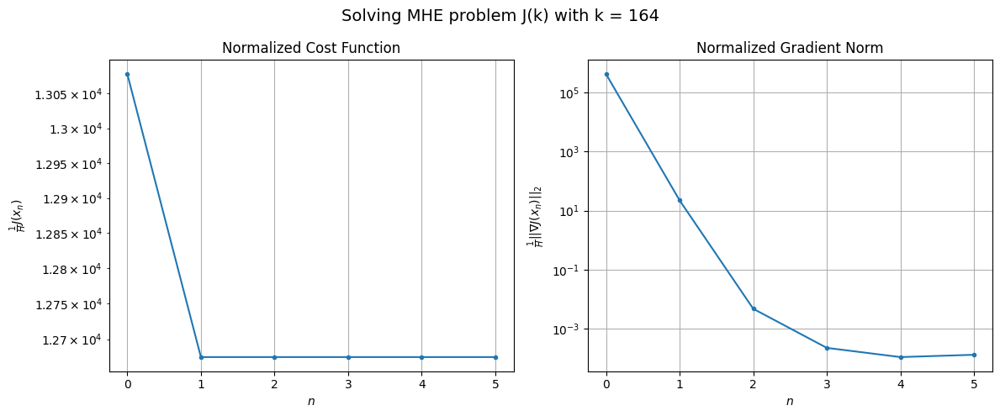

Windows:  35%|███▌      | 126/356 [18:19<27:34,  7.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 510625.59155551094
Gradient norm: 17511949.272065446
Global estimation error: 55.61732049148735
Initial conditions estimation errors: 28.09345623943815 m, 27.722087869977123 m, 27.842205384372843 m, 27.57376000040264 m
Position estimation errors: 33.86200630231215 m, 33.124250488075006 m, 34.28737202150628 m, 28.97969949889625 m

[Gauss-Newton] Iteration 1
Cost function: 494780.7224463097 (-3.10%)
Gradient norm: 4583.415197923878 (-99.97%)
Global estimation error: 63.22400308325642 (13.68%)
Initial conditions estimation errors: 32.49787499076217 m, 29.695550227962585 m, 31.185151752930107 m, 32.96658913258371 m
Position estimation errors: 29.013776315132684 m, 32.358795160531315 m, 31.181087592729284 m, 43.50190071761274 m

[Gauss-Newton] Iteration 2
Cost function: 494780.7038451906 (-0.00%)
Gradient norm: 1.180460428571499 (-99.97%)
Global estimation error: 63.22592710797156 (0.00%)
Initial conditions estimation errors: 32.49

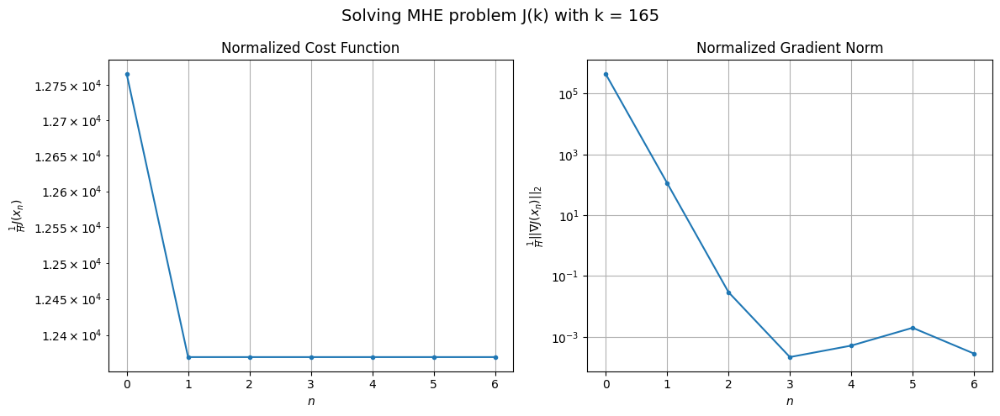

Windows:  36%|███▌      | 127/356 [18:26<27:50,  7.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 496167.4539901154
Gradient norm: 18009300.846440136
Global estimation error: 55.018186600163084
Initial conditions estimation errors: 27.918163908765038 m, 25.3960417570602 m, 27.304232492816052 m, 29.27581895425758 m
Position estimation errors: 33.03623512467605 m, 35.68870121335627 m, 34.23340988015768 m, 45.25988633136509 m

[Gauss-Newton] Iteration 1
Cost function: 480644.0184257411 (-3.13%)
Gradient norm: 643.2255265608076 (-100.00%)
Global estimation error: 63.08181256127793 (14.66%)
Initial conditions estimation errors: 32.22645168092286 m, 30.363135577802762 m, 31.483677394796644 m, 32.056216497146266 m
Position estimation errors: 28.116176323643177 m, 29.52327333125082 m, 29.14145031978432 m, 34.748889838788564 m

[Gauss-Newton] Iteration 2
Cost function: 480644.017861876 (-0.00%)
Gradient norm: 0.027175980505776617 (-100.00%)
Global estimation error: 63.08351851813486 (0.00%)
Initial conditions estimation errors: 32.

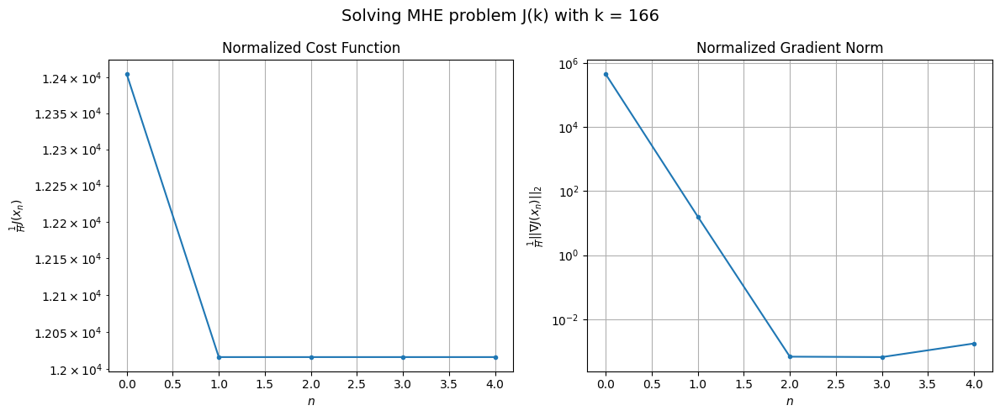

Windows:  36%|███▌      | 128/356 [18:32<25:45,  6.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 479872.25636086793
Gradient norm: 18224707.39944703
Global estimation error: 54.5957283978345
Initial conditions estimation errors: 27.818612752761627 m, 26.151597906098157 m, 27.40464197389731 m, 27.78259756475351 m
Position estimation errors: 31.87970275494124 m, 32.89187362499243 m, 32.42730440898132 m, 37.93052737381591 m

[Gauss-Newton] Iteration 1
Cost function: 464878.06158176344 (-3.12%)
Gradient norm: 23.59013261164347 (-100.00%)
Global estimation error: 62.13773421205375 (13.81%)
Initial conditions estimation errors: 31.987171622263094 m, 29.978919630873694 m, 31.26756736815179 m, 31.0079722022259 m
Position estimation errors: 26.916611616404506 m, 27.868061841988254 m, 27.543482746249754 m, 32.840734539630155 m

[Gauss-Newton] Iteration 2
Cost function: 464878.0615841137 (0.00%)
Gradient norm: 0.012495693452365564 (-99.95%)
Global estimation error: 62.138177073691075 (0.00%)
Initial conditions estimation errors: 31.

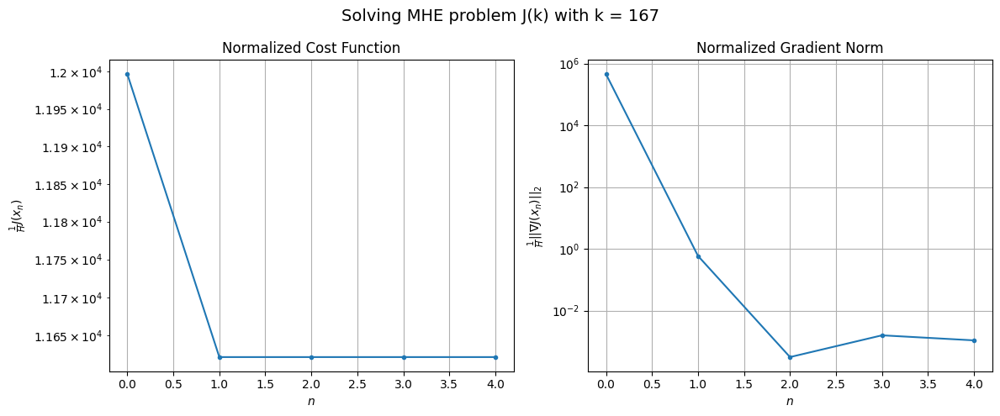

Windows:  36%|███▌      | 129/356 [18:38<25:09,  6.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 459903.70071463956
Gradient norm: 17782520.446555007
Global estimation error: 53.679518483391696
Initial conditions estimation errors: 27.620202798776003 m, 25.841884054370396 m, 27.191099720287166 m, 26.67263857602125 m
Position estimation errors: 30.29461154729734 m, 30.78760962343994 m, 30.439901676241465 m, 35.73361699100097 m

[Gauss-Newton] Iteration 1
Cost function: 445787.7488431083 (-3.07%)
Gradient norm: 95.11590586777284 (-100.00%)
Global estimation error: 59.399770367110825 (10.66%)
Initial conditions estimation errors: 31.63071052870122 m, 29.12136181100374 m, 29.794152761662264 m, 28.143500567775654 m
Position estimation errors: 25.401409715834696 m, 26.22491995065542 m, 25.808318707031546 m, 34.09241884743911 m

[Gauss-Newton] Iteration 2
Cost function: 445787.74883221835 (-0.00%)
Gradient norm: 0.05658956781445786 (-99.94%)
Global estimation error: 59.40006993274808 (0.00%)
Initial conditions estimation errors:

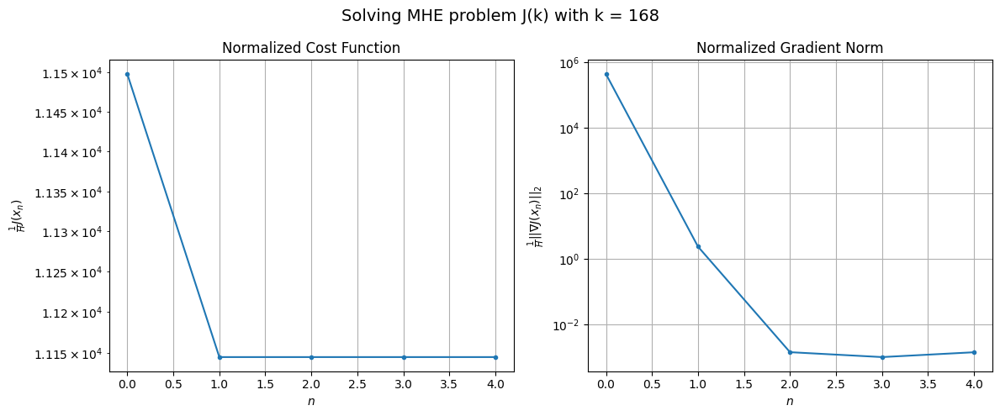

Windows:  37%|███▋      | 130/356 [18:45<24:55,  6.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 435751.28252836
Gradient norm: 17227962.639953
Global estimation error: 50.83378237541676
Initial conditions estimation errors: 27.182096712673168 m, 24.88003663677648 m, 25.748932972985926 m, 23.73089226752537 m
Position estimation errors: 28.30108824397807 m, 28.566049730846906 m, 27.93758906435945 m, 35.874212928775165 m

[Gauss-Newton] Iteration 1
Cost function: 422513.5991944966 (-3.04%)
Gradient norm: 1038.2848483616222 (-99.99%)
Global estimation error: 55.788747034227434 (9.75%)
Initial conditions estimation errors: 31.04878724204785 m, 28.34064096694219 m, 27.63248457772914 m, 24.115929034054947 m
Position estimation errors: 23.526704567988748 m, 22.965729138857103 m, 24.2756848264592 m, 24.252736327009455 m

[Gauss-Newton] Iteration 2
Cost function: 422513.59771372855 (-0.00%)
Gradient norm: 0.020297612321176522 (-100.00%)
Global estimation error: 55.79408413129121 (0.01%)
Initial conditions estimation errors: 31.048

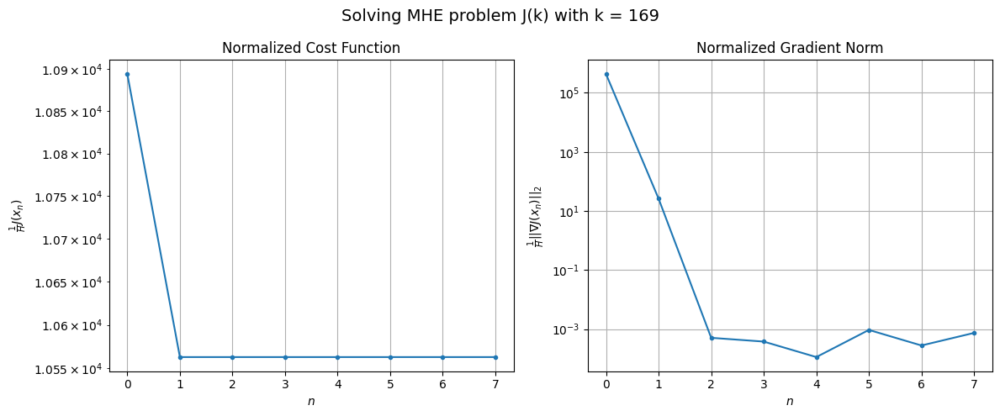

Windows:  37%|███▋      | 131/356 [18:55<28:51,  7.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 408355.1649093645
Gradient norm: 16160883.53249117
Global estimation error: 46.55712244508365
Initial conditions estimation errors: 26.435581181029875 m, 23.81136833516052 m, 23.132232762925224 m, 19.147124643282417 m
Position estimation errors: 25.901135106718957 m, 25.009637383464714 m, 26.210133326564016 m, 26.3183427429614 m

[Gauss-Newton] Iteration 1
Cost function: 396461.87097010954 (-2.91%)
Gradient norm: 86.19431607257121 (-100.00%)
Global estimation error: 55.344195947425575 (18.87%)
Initial conditions estimation errors: 30.0844413834253 m, 27.71423061844741 m, 27.99398036649462 m, 24.619705671761643 m
Position estimation errors: 21.356217857793595 m, 20.821389815629125 m, 21.774242899308664 m, 18.90943441596281 m

[Gauss-Newton] Iteration 2
Cost function: 396461.870948664 (-0.00%)
Gradient norm: 0.07852147984577731 (-99.91%)
Global estimation error: 55.34037564403656 (-0.01%)
Initial conditions estimation errors: 30

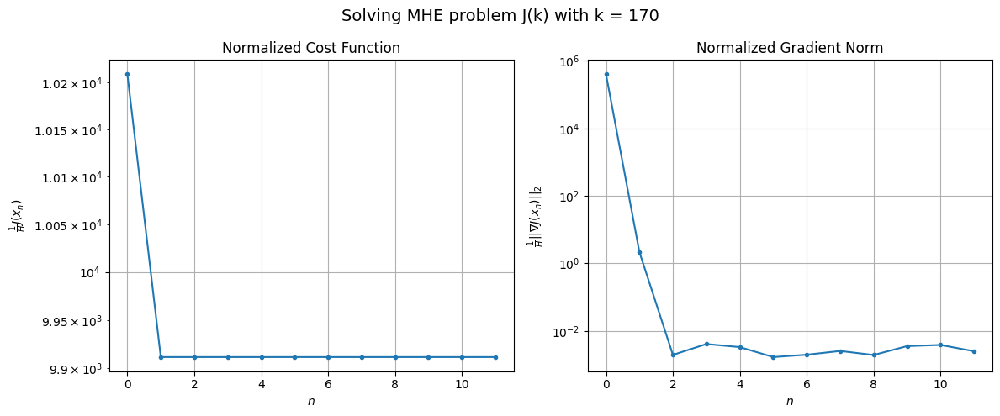

Windows:  37%|███▋      | 132/356 [19:10<36:17,  9.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379055.86508087034
Gradient norm: 14706051.525727253
Global estimation error: 45.63604778015106
Initial conditions estimation errors: 25.29770465112351 m, 22.928235438320705 m, 23.205451811845982 m, 19.45366019745222 m
Position estimation errors: 23.195422707424065 m, 22.408424323276964 m, 23.391731142643824 m, 20.521333043778053 m

[Gauss-Newton] Iteration 1
Cost function: 368812.2193909047 (-2.70%)
Gradient norm: 86.59096527334243 (-100.00%)
Global estimation error: 52.53196893941568 (15.11%)
Initial conditions estimation errors: 28.691793553095774 m, 26.192054120366155 m, 26.70459811824089 m, 23.177418041020257 m
Position estimation errors: 19.013177361007838 m, 18.240853329627644 m, 19.717211284111023 m, 15.792605624810033 m

[Gauss-Newton] Iteration 2
Cost function: 368812.21938041836 (-0.00%)
Gradient norm: 0.17959872936655832 (-99.79%)
Global estimation error: 52.53167822953622 (-0.00%)
Initial conditions estimation err

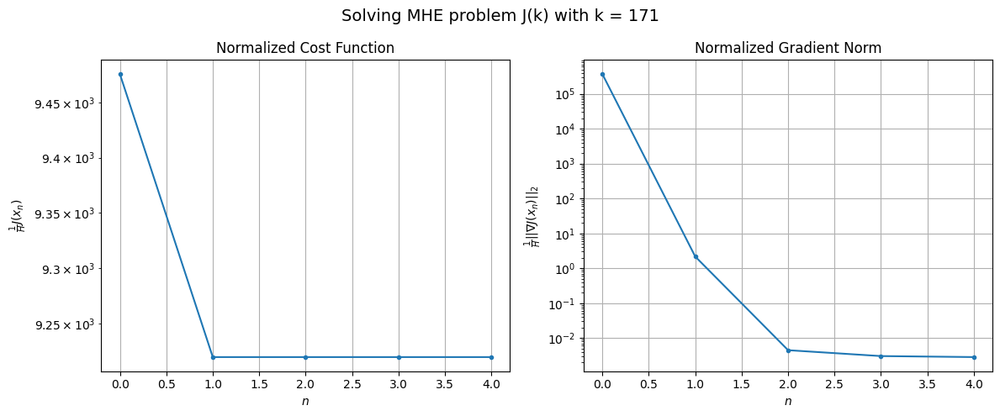

Windows:  37%|███▋      | 133/356 [19:17<33:22,  8.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 347609.39081287815
Gradient norm: 12972976.673865875
Global estimation error: 42.470015756764525
Initial conditions estimation errors: 23.787296971111594 m, 21.245085918940568 m, 21.70486736605719 m, 17.758887856298298 m
Position estimation errors: 20.340313693137666 m, 19.32295776552164 m, 20.943083867106992 m, 16.929970589903327 m

[Gauss-Newton] Iteration 1
Cost function: 339010.7676969456 (-2.47%)
Gradient norm: 378.10842001673535 (-100.00%)
Global estimation error: 50.8602489841716 (19.76%)
Initial conditions estimation errors: 26.942182864512304 m, 24.54276448705316 m, 26.379285727947238 m, 23.719938973445196 m
Position estimation errors: 16.630261632877627 m, 16.603737776474606 m, 16.42872415437535 m, 16.383924020610415 m

[Gauss-Newton] Iteration 2
Cost function: 339010.7674955019 (-0.00%)
Gradient norm: 0.06582896835874928 (-99.98%)
Global estimation error: 50.865597637700304 (0.01%)
Initial conditions estimation erro

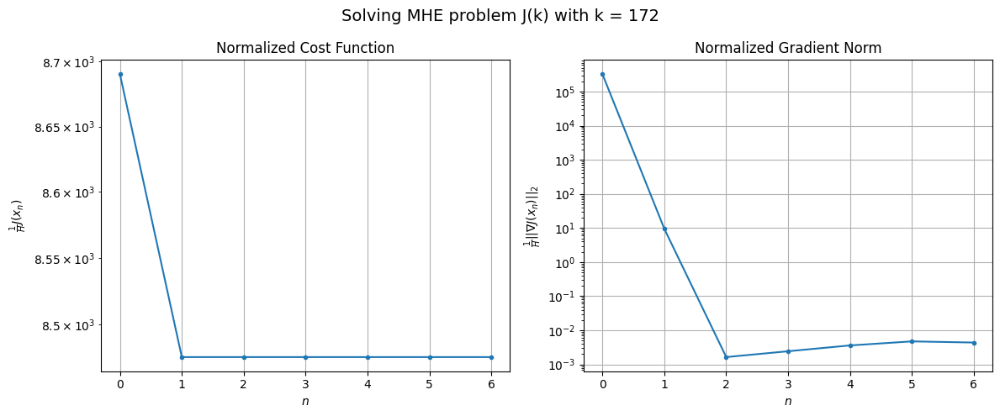

Windows:  38%|███▊      | 134/356 [19:26<33:48,  9.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 317923.1297225726
Gradient norm: 11199335.342380608
Global estimation error: 40.94491290485946
Initial conditions estimation errors: 22.015654604179765 m, 19.61292223417287 m, 21.482301300581945 m, 18.590613439789095 m
Position estimation errors: 17.499273010738424 m, 17.15068744010908 m, 17.122491495666946 m, 16.97152673503955 m

[Gauss-Newton] Iteration 1
Cost function: 311099.9947001225 (-2.15%)
Gradient norm: 17.94030273691064 (-100.00%)
Global estimation error: 46.20412514302381 (12.84%)
Initial conditions estimation errors: 24.86663551541504 m, 21.9577697038925 m, 24.364393404957568 m, 20.99219416864404 m
Position estimation errors: 14.345206797665568 m, 14.40304665871791 m, 14.170298617194899 m, 13.404739520291765 m

[Gauss-Newton] Iteration 2
Cost function: 311099.99468198215 (-0.00%)
Gradient norm: 0.027077557839932303 (-99.85%)
Global estimation error: 46.20293607320148 (-0.00%)
Initial conditions estimation errors: 

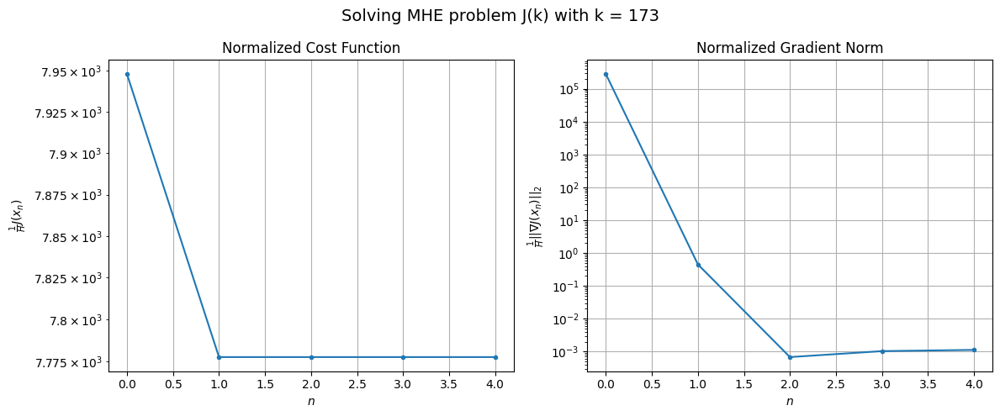

Windows:  38%|███▊      | 135/356 [19:33<31:22,  8.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 291558.5586572742
Gradient norm: 9383732.67113705
Global estimation error: 36.50977149715554
Initial conditions estimation errors: 20.03288800956108 m, 17.120736371543835 m, 19.524755596879842 m, 16.040073888217886 m
Position estimation errors: 14.826927417989198 m, 14.461945511648336 m, 14.507250813975185 m, 13.439983891470495 m

[Gauss-Newton] Iteration 1
Cost function: 286311.9954177741 (-1.80%)
Gradient norm: 201.26390799128677 (-100.00%)
Global estimation error: 45.704812059786214 (25.19%)
Initial conditions estimation errors: 22.58774040300209 m, 20.837969738308285 m, 23.933653363973317 m, 23.909320856955734 m
Position estimation errors: 12.279343935198098 m, 12.878935070619148 m, 11.960541126100688 m, 13.504932835840354 m

[Gauss-Newton] Iteration 2
Cost function: 286311.99524029734 (-0.00%)
Gradient norm: 0.09382995321332485 (-99.95%)
Global estimation error: 45.71298037568752 (0.02%)
Initial conditions estimation erro

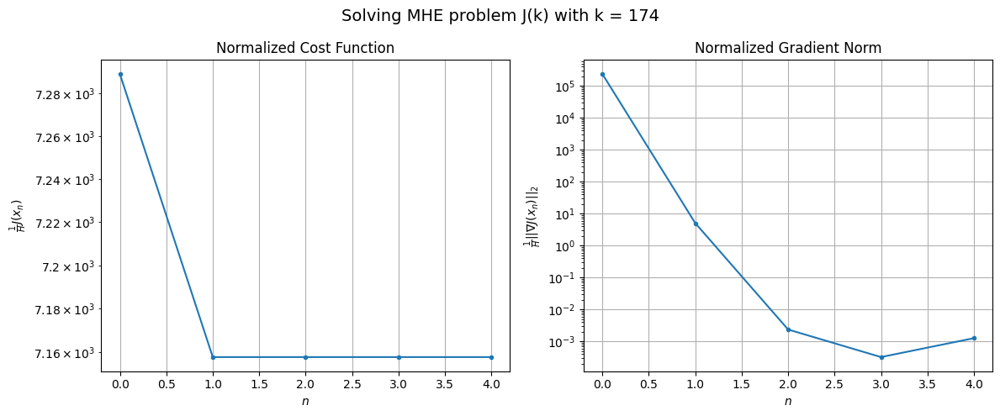

Windows:  38%|███▊      | 136/356 [19:40<29:36,  8.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 268132.91141180036
Gradient norm: 7421805.4245304745
Global estimation error: 36.701741272169095
Initial conditions estimation errors: 17.950160114493475 m, 16.25893237922676 m, 19.348237853686076 m, 19.648916176327486 m
Position estimation errors: 12.442166516773751 m, 12.678883155606606 m, 12.15082581050243 m, 13.617722248964062 m

[Gauss-Newton] Iteration 1
Cost function: 264210.1980934302 (-1.46%)
Gradient norm: 12.630404447731687 (-100.00%)
Global estimation error: 41.6239124373589 (13.41%)
Initial conditions estimation errors: 20.260850349189113 m, 18.58453404273223 m, 21.724740059902217 m, 22.464971966554288 m
Position estimation errors: 10.600905211936658 m, 10.60268378092866 m, 10.562223876727977 m, 11.83117763209829 m

[Gauss-Newton] Iteration 2
Cost function: 264210.1981078048 (0.00%)
Gradient norm: 0.033479966871820054 (-99.73%)
Global estimation error: 41.62206690854127 (-0.00%)
Initial conditions estimation error

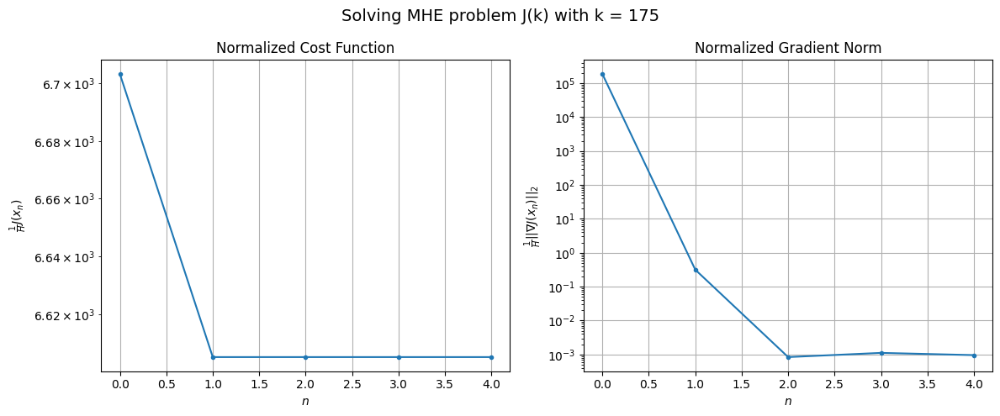

Windows:  38%|███▊      | 137/356 [19:47<28:08,  7.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 249554.7346512914
Gradient norm: 5551816.178422772
Global estimation error: 33.173769810434955
Initial conditions estimation errors: 15.894942273409567 m, 14.328955691037606 m, 17.3780008907014 m, 18.453102294073776 m
Position estimation errors: 10.553775143640415 m, 10.036836557970988 m, 10.631062841012852 m, 11.902980452286275 m

[Gauss-Newton] Iteration 1
Cost function: 246770.18743478702 (-1.12%)
Gradient norm: 1041.1776243039478 (-99.98%)
Global estimation error: 35.462169214810714 (6.90%)
Initial conditions estimation errors: 17.943416824221014 m, 16.806210090524026 m, 16.81894853274216 m, 19.24192176178507 m
Position estimation errors: 9.409070357071094 m, 8.864440008559932 m, 8.165776469895174 m, 15.734703617432505 m

[Gauss-Newton] Iteration 2
Cost function: 246770.18644939674 (-0.00%)
Gradient norm: 0.015105148477539203 (-100.00%)
Global estimation error: 35.46341495513361 (0.00%)
Initial conditions estimation errors

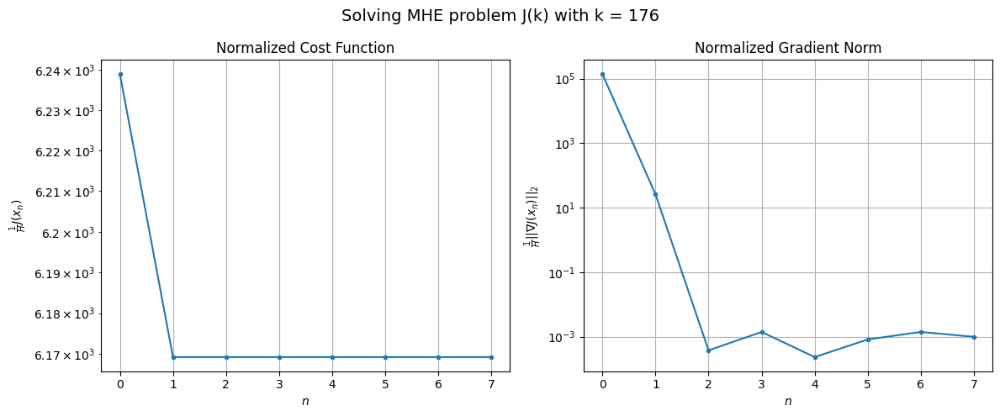

Windows:  39%|███▉      | 138/356 [19:58<30:54,  8.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 234651.460552435
Gradient norm: 3547485.2782512177
Global estimation error: 27.265085441044633
Initial conditions estimation errors: 13.932012957816898 m, 12.809091689415421 m, 12.938007384292323 m, 14.758110253614339 m
Position estimation errors: 9.387635016414848 m, 8.574139489704741 m, 7.768630769514656 m, 15.873821251273842 m

[Gauss-Newton] Iteration 1
Cost function: 232620.56115615132 (-0.87%)
Gradient norm: 16.35747544252025 (-100.00%)
Global estimation error: 33.0308159549507 (21.15%)
Initial conditions estimation errors: 15.828426881592856 m, 15.332799209913595 m, 15.29680649590127 m, 19.27150600190686 m
Position estimation errors: 8.876953526968906 m, 8.864619703291826 m, 7.536145678618547 m, 18.600671324373717 m

[Gauss-Newton] Iteration 2
Cost function: 232620.56116469204 (0.00%)
Gradient norm: 0.062460317087811947 (-99.62%)
Global estimation error: 33.03612359876587 (0.02%)
Initial conditions estimation errors: 15

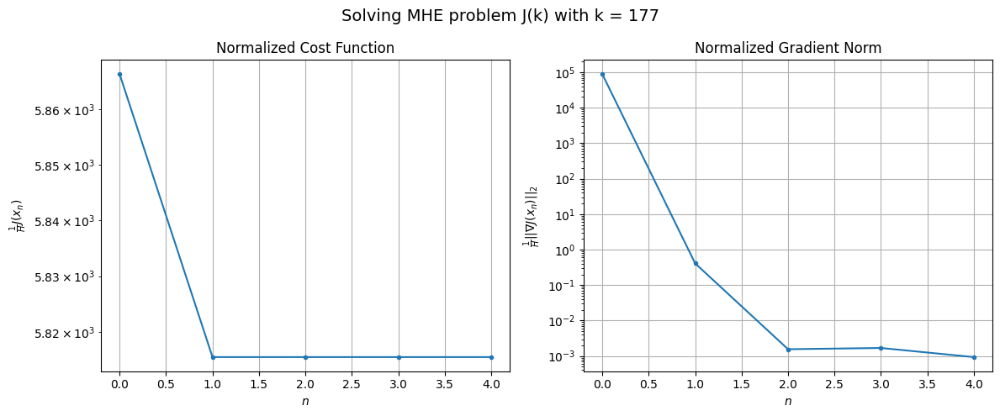

Windows:  39%|███▉      | 139/356 [20:05<29:22,  8.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 224317.21252868284
Gradient norm: 1697847.7769887412
Global estimation error: 25.73851709403726
Initial conditions estimation errors: 12.260303076326569 m, 11.780668007150561 m, 11.847321041404635 m, 15.26432632566094 m
Position estimation errors: 9.234616818252867 m, 9.041754119853035 m, 7.609683088377976 m, 19.2168854221805 m

[Gauss-Newton] Iteration 1
Cost function: 222809.29402897364 (-0.67%)
Gradient norm: 87.56496479630279 (-99.99%)
Global estimation error: 29.745724165066918 (15.57%)
Initial conditions estimation errors: 14.026319368044591 m, 14.013913066706586 m, 13.704870765766795 m, 17.431082109436776 m
Position estimation errors: 9.067152522200177 m, 10.693199846315927 m, 8.08994285170453 m, 23.258317919810114 m

[Gauss-Newton] Iteration 2
Cost function: 222809.29402584673 (-0.00%)
Gradient norm: 0.06769487658256348 (-99.92%)
Global estimation error: 29.750932981709884 (0.02%)
Initial conditions estimation errors: 

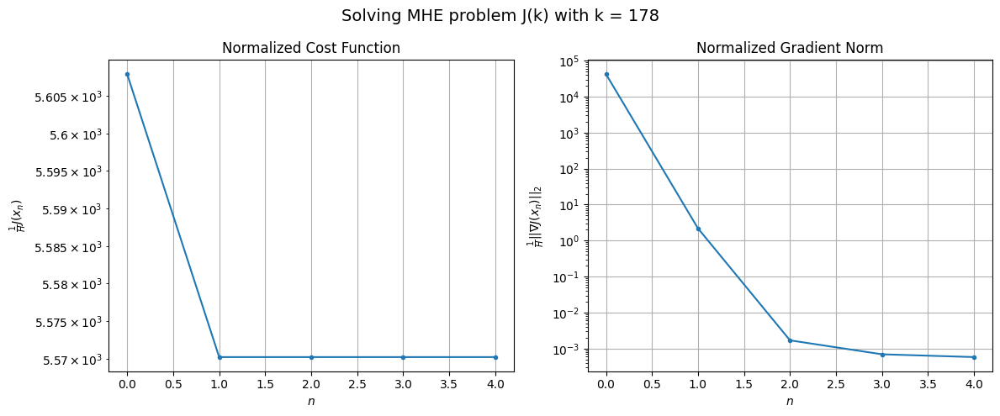

Windows:  39%|███▉      | 140/356 [20:12<28:18,  7.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 218056.00790871942
Gradient norm: 600102.4826496282
Global estimation error: 23.230827918725847
Initial conditions estimation errors: 10.982362361081695 m, 10.8871238034125 m, 10.768364652443307 m, 13.585324740486655 m
Position estimation errors: 10.049247368657122 m, 11.568547333050255 m, 8.636439489318711 m, 24.016862456674698 m

[Gauss-Newton] Iteration 1
Cost function: 216756.65903433738 (-0.60%)
Gradient norm: 204.0470321686468 (-99.97%)
Global estimation error: 26.674403298276513 (14.82%)
Initial conditions estimation errors: 12.707645175010677 m, 12.363523980290134 m, 13.101382408681665 m, 15.01752436496874 m
Position estimation errors: 9.867235748939956 m, 9.328572487246388 m, 10.367191302648743 m, 20.06007338217284 m

[Gauss-Newton] Iteration 2
Cost function: 216756.65898314118 (-0.00%)
Gradient norm: 0.06367228399616136 (-99.97%)
Global estimation error: 26.672709022518347 (-0.01%)
Initial conditions estimation error

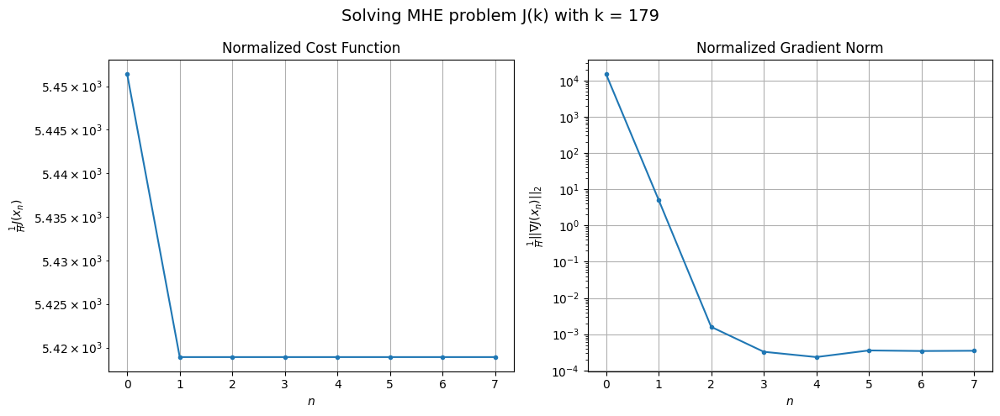

Windows:  40%|███▉      | 141/356 [20:23<31:06,  8.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 215131.01508955998
Gradient norm: 2147309.3672885695
Global estimation error: 21.363432496990466
Initial conditions estimation errors: 10.210628380030528 m, 9.92605507930061 m, 10.520442766350673 m, 11.95513582413056 m
Position estimation errors: 11.476416653339347 m, 10.640134324632646 m, 11.6776221883547 m, 21.441976308250997 m

[Gauss-Newton] Iteration 1
Cost function: 213732.1299707338 (-0.65%)
Gradient norm: 591.9751227853507 (-99.97%)
Global estimation error: 23.297687409847782 (9.05%)
Initial conditions estimation errors: 12.003834538016564 m, 11.666074427698783 m, 11.831128705948755 m, 11.072814744949827 m
Position estimation errors: 11.034122192831024 m, 13.328796962127795 m, 8.372486112569316 m, 24.623027987209948 m

[Gauss-Newton] Iteration 2
Cost function: 213732.12942385915 (-0.00%)
Gradient norm: 0.08716581682774477 (-99.99%)
Global estimation error: 23.298180578931206 (0.00%)
Initial conditions estimation errors

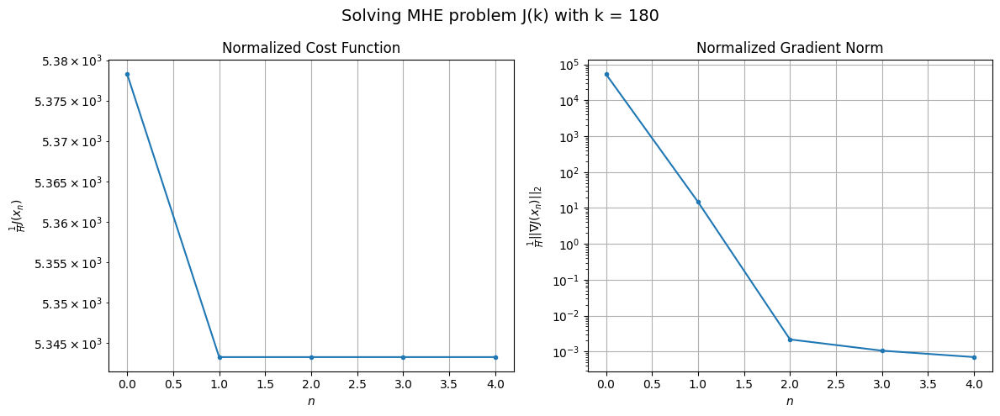

Windows:  40%|███▉      | 142/356 [20:30<29:16,  8.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 215123.64788189912
Gradient norm: 3621744.761747216
Global estimation error: 19.23914547063933
Initial conditions estimation errors: 9.975856369520036 m, 9.544059122230458 m, 9.982471685555188 m, 8.93757539759984 m
Position estimation errors: 13.14922257923499 m, 14.982578693556922 m, 9.860705262250526 m, 25.55984187912581 m

[Gauss-Newton] Iteration 1
Cost function: 213412.70626145965 (-0.80%)
Gradient norm: 13.360461765605509 (-100.00%)
Global estimation error: 22.405148559684093 (16.46%)
Initial conditions estimation errors: 11.876645686541139 m, 10.891251710922024 m, 11.322063431681796 m, 10.682662163907676 m
Position estimation errors: 12.314817233924972 m, 14.728293081587106 m, 10.030296465811118 m, 24.041718514412633 m

[Gauss-Newton] Iteration 2
Cost function: 213412.70625866952 (-0.00%)
Gradient norm: 0.09557070411736251 (-99.28%)
Global estimation error: 22.40473429885059 (-0.00%)
Initial conditions estimation errors

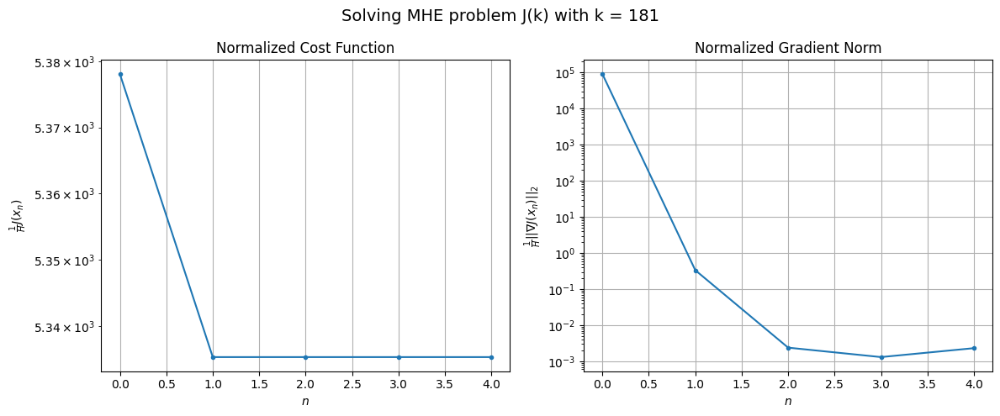

Windows:  40%|████      | 143/356 [20:37<27:59,  7.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 217295.24198610338
Gradient norm: 4879584.647331847
Global estimation error: 19.232014950973472
Initial conditions estimation errors: 10.151472753061086 m, 9.091542268412697 m, 9.674965771191447 m, 9.515771064861616 m
Position estimation errors: 14.8016895973192 m, 16.829497768945483 m, 12.104256272407149 m, 25.445889863592665 m

[Gauss-Newton] Iteration 1
Cost function: 215108.73347122964 (-1.01%)
Gradient norm: 228.38492070372232 (-100.00%)
Global estimation error: 23.186473073970955 (20.56%)
Initial conditions estimation errors: 12.202420448370072 m, 11.071063477423936 m, 12.012995856595689 m, 11.03748895222928 m
Position estimation errors: 13.575439019873864 m, 15.88370004272301 m, 12.811885090146083 m, 23.939103120808547 m

[Gauss-Newton] Iteration 2
Cost function: 215108.73331708214 (-0.00%)
Gradient norm: 0.10533151353379806 (-99.95%)
Global estimation error: 23.1903545411226 (0.02%)
Initial conditions estimation errors

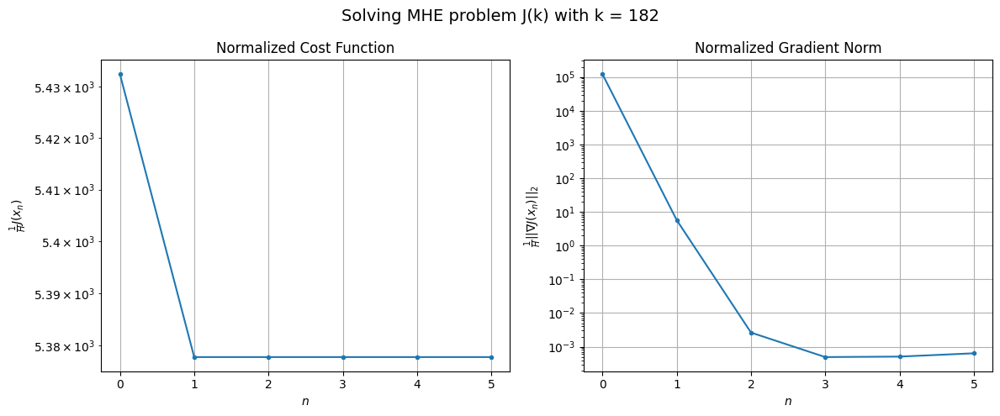

Windows:  40%|████      | 144/356 [20:43<26:23,  7.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 220709.04363594943
Gradient norm: 5872900.300859169
Global estimation error: 19.54383545524773
Initial conditions estimation errors: 10.580287073979587 m, 9.216943615210804 m, 10.228246569466508 m, 8.969032934270876 m
Position estimation errors: 16.322569430712807 m, 18.36237206593566 m, 15.262902037651124 m, 26.062742417455798 m

[Gauss-Newton] Iteration 1
Cost function: 217963.5746038575 (-1.24%)
Gradient norm: 150.06369190162118 (-100.00%)
Global estimation error: 24.844661987211342 (27.12%)
Initial conditions estimation errors: 12.787046050888154 m, 11.653991342486215 m, 11.97591522633237 m, 13.209974957032966 m
Position estimation errors: 14.742194605052994 m, 15.377759492511313 m, 14.505422148989853 m, 18.255404067224166 m

[Gauss-Newton] Iteration 2
Cost function: 217963.5745845997 (-0.00%)
Gradient norm: 0.02169033273246628 (-99.99%)
Global estimation error: 24.853271833964623 (0.03%)
Initial conditions estimation erro

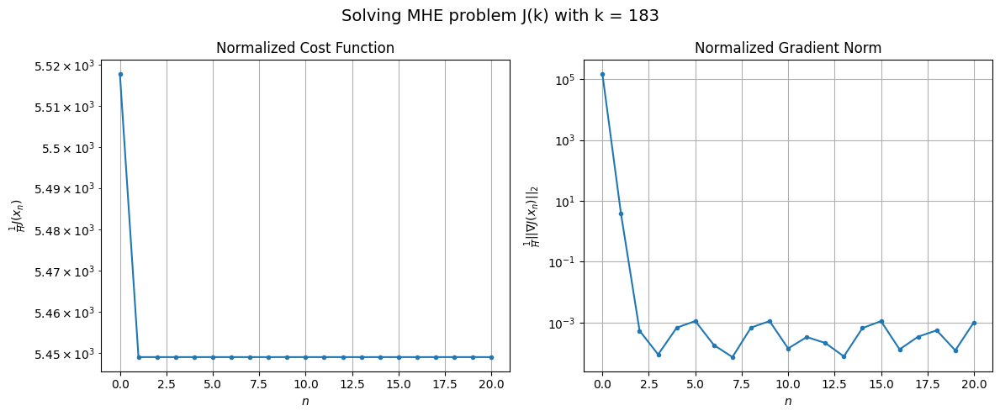

Windows:  41%|████      | 145/356 [21:04<39:40, 11.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 225193.1713223989
Gradient norm: 6678579.947607215
Global estimation error: 21.69144496113104
Initial conditions estimation errors: 11.117186753807243 m, 9.938986370497815 m, 10.143463907218944 m, 12.051826783471395 m
Position estimation errors: 17.653574318334027 m, 18.12156139942746 m, 17.22762295929723 m, 20.645339428283094 m

[Gauss-Newton] Iteration 1
Cost function: 221848.038504157 (-1.49%)
Gradient norm: 458.39737162542394 (-99.99%)
Global estimation error: 31.486154200542828 (45.15%)
Initial conditions estimation errors: 13.46112807371716 m, 13.329366038900828 m, 11.700473224617031 m, 22.261957459081646 m
Position estimation errors: 15.765856005135255 m, 14.073881178459448 m, 16.870344805542672 m, 9.745790969919183 m

[Gauss-Newton] Iteration 2
Cost function: 221848.03832422933 (-0.00%)
Gradient norm: 0.08430431144919227 (-99.98%)
Global estimation error: 31.53292119950833 (0.15%)
Initial conditions estimation errors: 

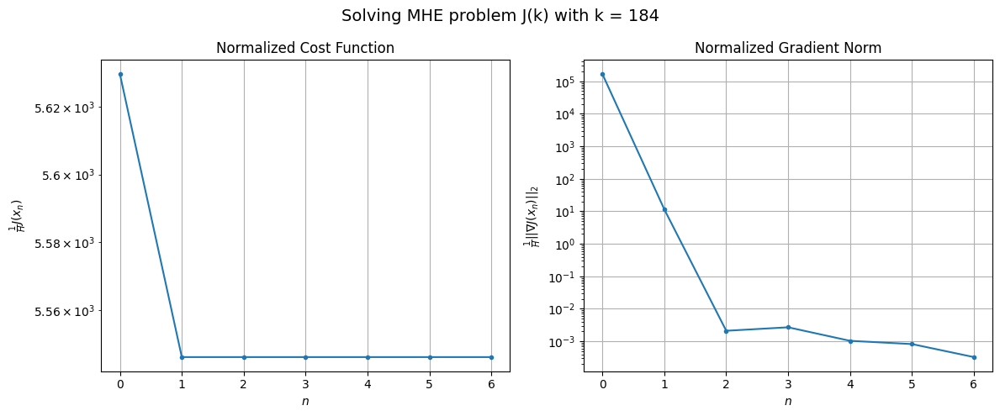

Windows:  41%|████      | 146/356 [21:11<35:21, 10.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 230257.6520259924
Gradient norm: 7023959.323883419
Global estimation error: 28.791231375966376
Initial conditions estimation errors: 11.688358616846093 m, 11.782751360809403 m, 9.864103150137623 m, 21.358268211254735 m
Position estimation errors: 18.747303610935322 m, 17.114123614079094 m, 19.86622695779833 m, 12.347339111083599 m

[Gauss-Newton] Iteration 1
Cost function: 226500.1577510336 (-1.63%)
Gradient norm: 153.8662571570993 (-100.00%)
Global estimation error: 34.76001453222614 (20.73%)
Initial conditions estimation errors: 14.094349925709885 m, 15.644878536142627 m, 11.318475066784556 m, 25.233485629156622 m
Position estimation errors: 16.651333076117428 m, 13.135644443482613 m, 19.643642358711688 m, 8.147375849490118 m

[Gauss-Newton] Iteration 2
Cost function: 226500.15772296317 (-0.00%)
Gradient norm: 0.007418862931589725 (-100.00%)
Global estimation error: 34.75342733743918 (-0.02%)
Initial conditions estimation er

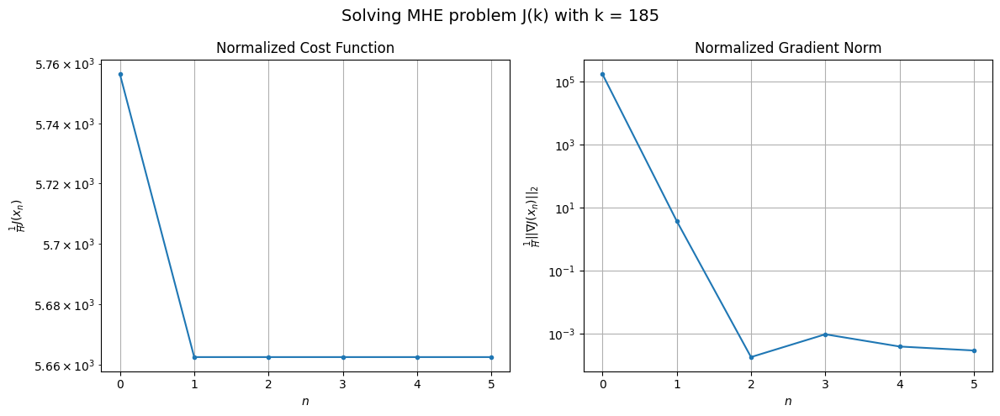

Windows:  41%|████▏     | 147/356 [21:17<31:06,  8.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 235619.60346500424
Gradient norm: 7320249.9501536535
Global estimation error: 31.72975142959105
Initial conditions estimation errors: 12.251448197998002 m, 14.041014392236765 m, 9.43306361408649 m, 23.885936375913456 m
Position estimation errors: 19.64054436066626 m, 16.236054025062646 m, 22.732992321649 m, 10.154926841670203 m

[Gauss-Newton] Iteration 1
Cost function: 231445.3209895512 (-1.77%)
Gradient norm: 43.778641662985486 (-100.00%)
Global estimation error: 35.00724870094458 (10.33%)
Initial conditions estimation errors: 14.714852126173476 m, 16.2041841992094 m, 11.439213721145727 m, 24.81007793260272 m
Position estimation errors: 17.37723317301655 m, 14.549187586545955 m, 20.50374880139573 m, 9.951685448368368 m

[Gauss-Newton] Iteration 2
Cost function: 231445.3209898978 (0.00%)
Gradient norm: 0.03104508045946397 (-99.93%)
Global estimation error: 34.9949062369773 (-0.04%)
Initial conditions estimation errors: 14.714

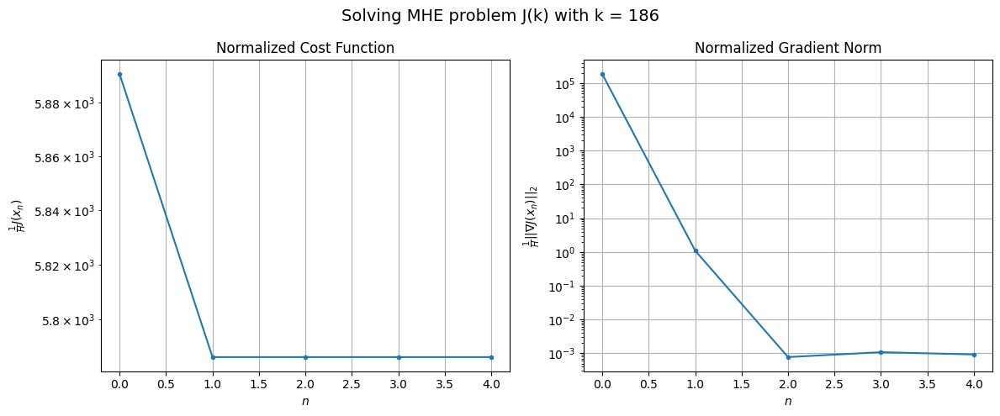

Windows:  42%|████▏     | 148/356 [21:23<27:31,  7.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 241095.59047303104
Gradient norm: 7193403.46162108
Global estimation error: 32.00249095836284
Initial conditions estimation errors: 12.844953090241697 m, 14.5846931571567 m, 9.582186061478039 m, 23.550510879489934 m
Position estimation errors: 20.362831062501122 m, 17.604244760562413 m, 23.681156625283524 m, 12.249440459932773 m

[Gauss-Newton] Iteration 1
Cost function: 236659.33579544417 (-1.84%)
Gradient norm: 88.94004899475982 (-100.00%)
Global estimation error: 32.36003240837815 (1.12%)
Initial conditions estimation errors: 15.32784981247809 m, 15.017604643444374 m, 12.763352038522292 m, 20.58609138783128 m
Position estimation errors: 18.012578654067813 m, 16.545700720080074 m, 21.08470279263963 m, 9.49894017038888 m

[Gauss-Newton] Iteration 2
Cost function: 236659.33575948654 (-0.00%)
Gradient norm: 0.1255411622854277 (-99.86%)
Global estimation error: 32.37027726185661 (0.03%)
Initial conditions estimation errors: 15.3

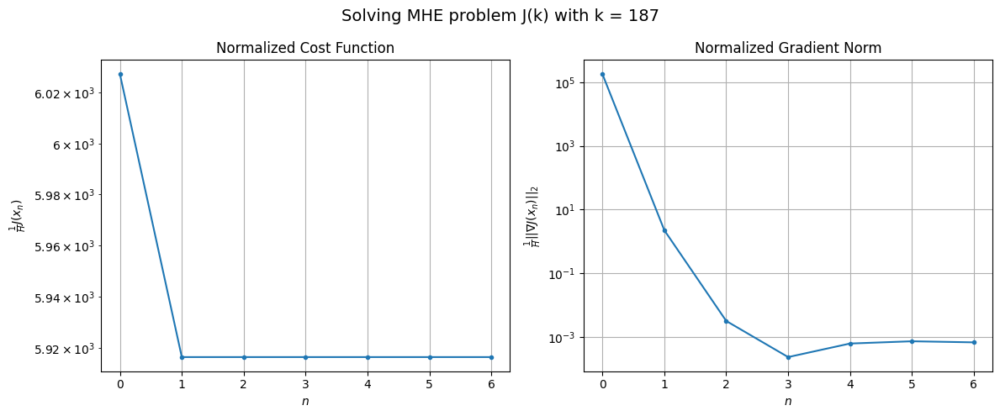

Windows:  42%|████▏     | 149/356 [21:30<26:47,  7.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 246864.97946653602
Gradient norm: 6962098.195745461
Global estimation error: 28.54677349684641
Initial conditions estimation errors: 13.450714202863105 m, 13.110434081430036 m, 10.755013494983846 m, 18.61273400605839 m
Position estimation errors: 21.040190835538844 m, 19.753616173998093 m, 24.21009596360347 m, 12.184707398910945 m

[Gauss-Newton] Iteration 1
Cost function: 242281.8350470814 (-1.86%)
Gradient norm: 31.18592869876088 (-100.00%)
Global estimation error: 33.952749288674646 (18.94%)
Initial conditions estimation errors: 15.900843027650872 m, 15.1236410580267 m, 13.005546451450918 m, 22.407000996303722 m
Position estimation errors: 18.63355265886292 m, 17.93783014889714 m, 21.91978680433445 m, 10.781521075428785 m

[Gauss-Newton] Iteration 2
Cost function: 242281.83503286052 (-0.00%)
Gradient norm: 0.07571840848422315 (-99.76%)
Global estimation error: 33.94626064247375 (-0.02%)
Initial conditions estimation errors:

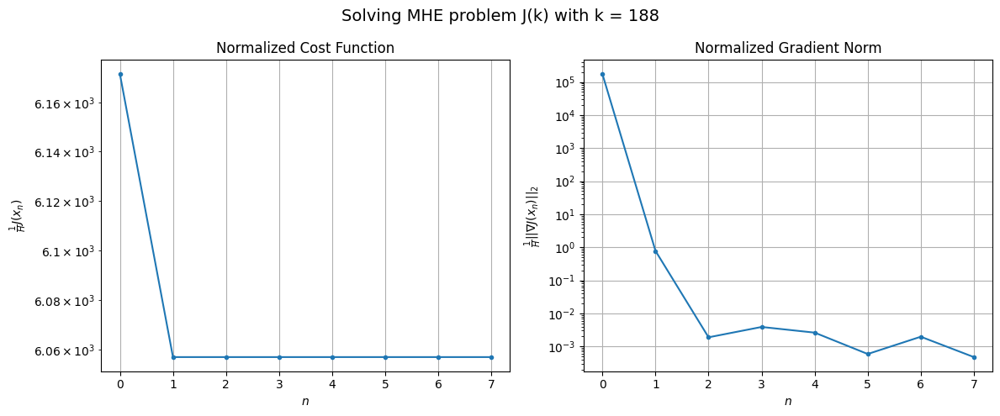

Windows:  42%|████▏     | 150/356 [21:39<27:38,  8.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 253064.91871355358
Gradient norm: 6776475.216234444
Global estimation error: 30.305107043300424
Initial conditions estimation errors: 14.019342567057947 m, 13.257724774035358 m, 11.082092172916198 m, 20.57349368245094 m
Position estimation errors: 21.745115965227765 m, 21.226949433689448 m, 25.16699380941804 m, 13.53800122220134 m

[Gauss-Newton] Iteration 1
Cost function: 248217.44432985105 (-1.92%)
Gradient norm: 59.0574927415811 (-100.00%)
Global estimation error: 37.5747626363764 (23.99%)
Initial conditions estimation errors: 16.487668868375767 m, 15.469436357705302 m, 14.866915348666147 m, 26.070688360869738 m
Position estimation errors: 19.280391431377918 m, 19.368311408092254 m, 21.11906994549715 m, 11.438761796058044 m

[Gauss-Newton] Iteration 2
Cost function: 248217.44433411554 (0.00%)
Gradient norm: 0.016710741952195008 (-99.97%)
Global estimation error: 37.57393509137338 (-0.00%)
Initial conditions estimation error

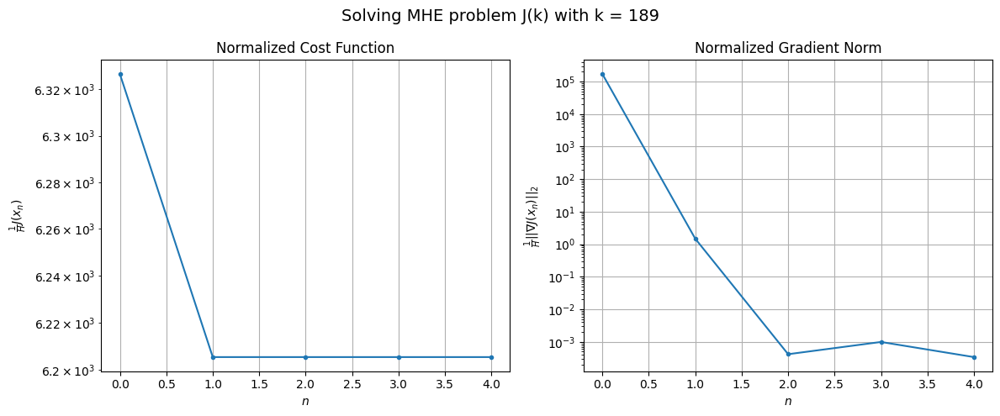

Windows:  42%|████▏     | 151/356 [21:44<24:56,  7.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 260104.86778858397
Gradient norm: 6534136.880126128
Global estimation error: 34.05362117265939
Initial conditions estimation errors: 14.587761513496563 m, 13.589850748986652 m, 12.915219817487554 m, 24.399800328942263 m
Position estimation errors: 22.468601271190334 m, 22.70017124541245 m, 24.397167133526473 m, 14.049976828344752 m

[Gauss-Newton] Iteration 1
Cost function: 255132.0585790024 (-1.91%)
Gradient norm: 65.77577421919065 (-100.00%)
Global estimation error: 37.31066793568278 (9.56%)
Initial conditions estimation errors: 17.015872379051384 m, 15.315461841529713 m, 12.931482762451205 m, 26.471676092811666 m
Position estimation errors: 19.965927570413477 m, 20.235119468400086 m, 25.09294626690922 m, 10.926689350061464 m

[Gauss-Newton] Iteration 2
Cost function: 255132.0585767503 (-0.00%)
Gradient norm: 0.013767774483871216 (-99.98%)
Global estimation error: 37.29791910678081 (-0.03%)
Initial conditions estimation erro

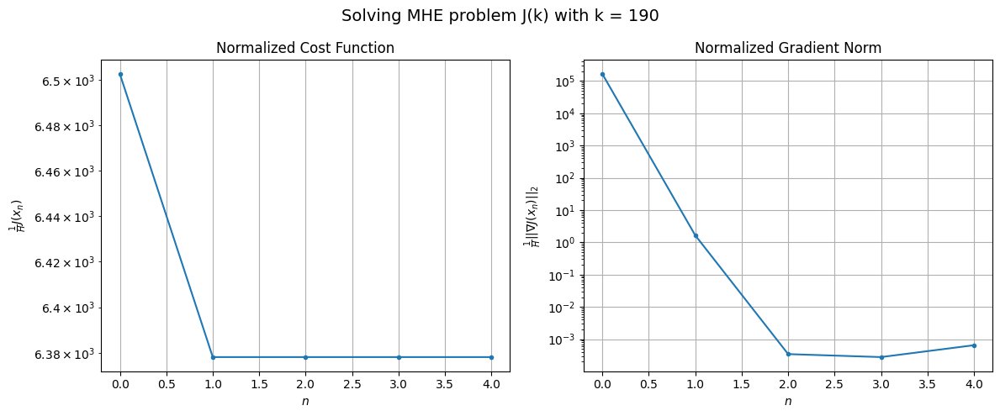

Windows:  43%|████▎     | 152/356 [21:50<23:05,  6.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 268050.2462678584
Gradient norm: 6260159.947055736
Global estimation error: 33.76906618563412
Initial conditions estimation errors: 15.088653775144204 m, 13.509052043529287 m, 11.14140445542101 m, 24.618040864532258 m
Position estimation errors: 23.19359529994734 m, 23.685292315463453 m, 28.47944983549277 m, 13.65907885383197 m

[Gauss-Newton] Iteration 1
Cost function: 262821.42080064915 (-1.95%)
Gradient norm: 30.258341695373012 (-100.00%)
Global estimation error: 35.38721103527037 (4.79%)
Initial conditions estimation errors: 17.535080329713843 m, 14.638640429185171 m, 14.077991956322622 m, 23.07132710732202 m
Position estimation errors: 20.6442456672788 m, 22.121697278097628 m, 25.10944147280165 m, 13.902519864506358 m

[Gauss-Newton] Iteration 2
Cost function: 262821.4207975849 (-0.00%)
Gradient norm: 0.009701958594055413 (-99.97%)
Global estimation error: 35.39678495986894 (0.03%)
Initial conditions estimation errors: 17

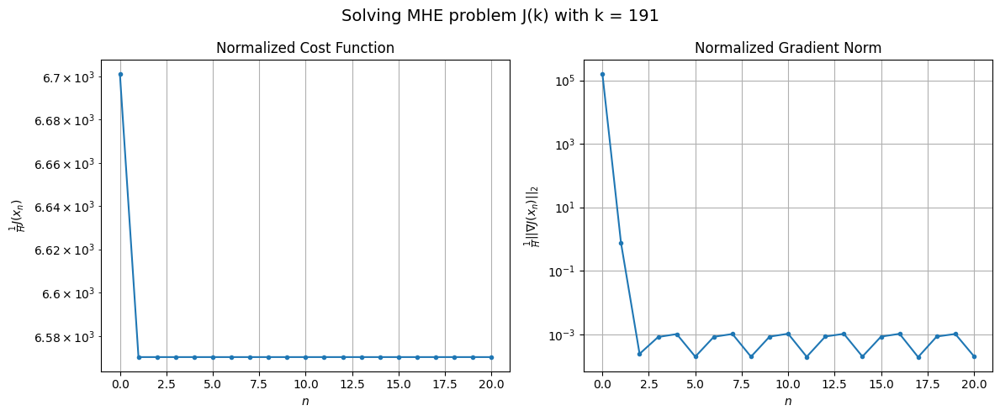

Windows:  43%|████▎     | 153/356 [22:10<35:57, 10.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 275446.2123185276
Gradient norm: 6045238.854880895
Global estimation error: 31.64803553693811
Initial conditions estimation errors: 15.559373298262596 m, 12.79002104021015 m, 12.241651325106838 m, 21.11994433662078 m
Position estimation errors: 23.89314858693793 m, 25.631238519356074 m, 28.474545403546045 m, 17.051586456134366 m

[Gauss-Newton] Iteration 1
Cost function: 270126.8912759339 (-1.93%)
Gradient norm: 65.16896184532693 (-100.00%)
Global estimation error: 41.43699174500709 (30.93%)
Initial conditions estimation errors: 17.976475643680658 m, 17.0608756668848 m, 14.715439706655967 m, 29.76982569082099 m
Position estimation errors: 21.325526121892892 m, 20.701681593353584 m, 25.825671605819156 m, 9.824010053474689 m

[Gauss-Newton] Iteration 2
Cost function: 270126.8912665631 (-0.00%)
Gradient norm: 0.13223616347507203 (-99.80%)
Global estimation error: 41.4382547356072 (0.00%)
Initial conditions estimation errors: 17.9

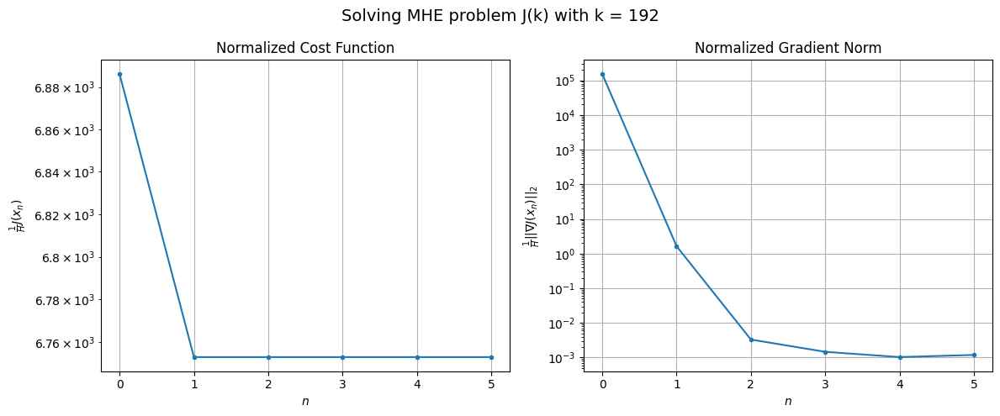

Windows:  43%|████▎     | 154/356 [22:16<31:48,  9.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 284204.27709825465
Gradient norm: 5995503.242389436
Global estimation error: 37.56035135588593
Initial conditions estimation errors: 15.946057647045674 m, 15.109925284472675 m, 12.859442122463305 m, 27.619161766076754 m
Position estimation errors: 24.61546071103182 m, 24.182585108672775 m, 29.206660476674067 m, 12.643326863453767 m

[Gauss-Newton] Iteration 1
Cost function: 278681.909929528 (-1.94%)
Gradient norm: 52.767075814488294 (-100.00%)
Global estimation error: 47.20050998739108 (25.67%)
Initial conditions estimation errors: 18.35319611837931 m, 19.73723519997557 m, 14.10069425643076 m, 36.092237056313316 m
Position estimation errors: 21.99235976326478 m, 20.468230390161988 m, 27.305421273581995 m, 7.179158739942554 m

[Gauss-Newton] Iteration 2
Cost function: 278681.90990685386 (-0.00%)
Gradient norm: 0.01721356973838684 (-99.97%)
Global estimation error: 47.18291624884597 (-0.04%)
Initial conditions estimation errors:

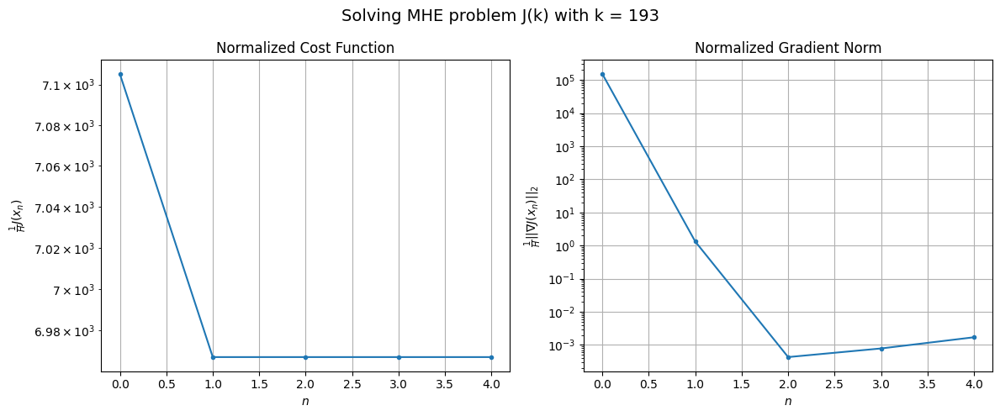

Windows:  44%|████▎     | 155/356 [22:22<28:10,  8.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 294186.83346645115
Gradient norm: 5928017.246132897
Global estimation error: 43.3163624552121
Initial conditions estimation errors: 16.27593096907279 m, 17.78010782463638 m, 12.310721704925285 m, 33.818704773395176 m
Position estimation errors: 25.356360463737253 m, 23.92645175971983 m, 30.88131328279385 m, 9.561717331557304 m

[Gauss-Newton] Iteration 1
Cost function: 288500.56245287886 (-1.93%)
Gradient norm: 61.5011840595709 (-100.00%)
Global estimation error: 51.72564171243255 (19.41%)
Initial conditions estimation errors: 18.669809774128936 m, 21.76292163675085 m, 13.154844945532686 m, 40.99139554014738 m
Position estimation errors: 22.68504086529196 m, 20.202354946842462 m, 28.02606744716405 m, 5.277606142551782 m

[Gauss-Newton] Iteration 2
Cost function: 288500.5624399622 (-0.00%)
Gradient norm: 0.035228810222723526 (-99.94%)
Global estimation error: 51.75881300715522 (0.06%)
Initial conditions estimation errors: 18.66

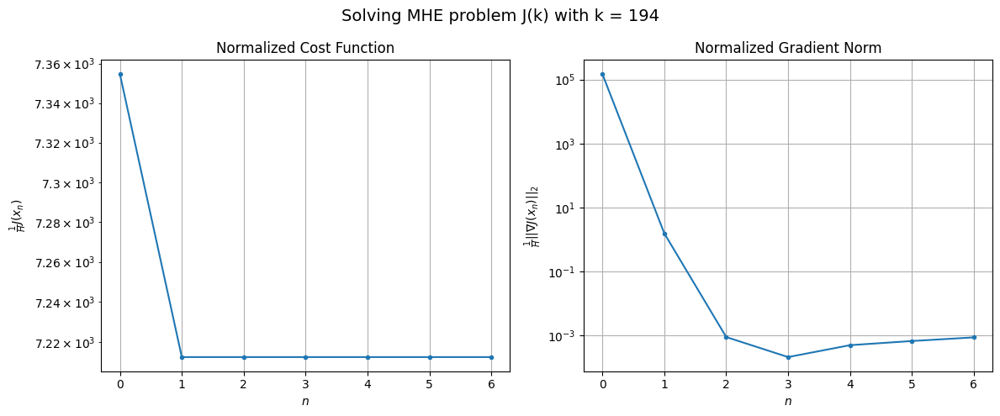

Windows:  44%|████▍     | 156/356 [22:29<26:31,  7.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 305727.8752275305
Gradient norm: 6067761.882731621
Global estimation error: 47.874484872546894
Initial conditions estimation errors: 16.578869879187586 m, 19.849431038980637 m, 11.500752556056083 m, 38.61125983336479 m
Position estimation errors: 26.145830014058227 m, 23.68420031926398 m, 31.868266133162752 m, 6.791749709985936 m

[Gauss-Newton] Iteration 1
Cost function: 299829.2454653148 (-1.93%)
Gradient norm: 64.8365045551633 (-100.00%)
Global estimation error: 56.61733358598389 (18.26%)
Initial conditions estimation errors: 18.979720394160886 m, 24.32892060709916 m, 13.182085765526757 m, 45.60282712062834 m
Position estimation errors: 23.420234293627022 m, 19.396346654824864 m, 29.45159361114781 m, 5.5887433457115865 m

[Gauss-Newton] Iteration 2
Cost function: 299829.2454266447 (-0.00%)
Gradient norm: 0.015318253197854967 (-99.98%)
Global estimation error: 56.66533292811116 (0.08%)
Initial conditions estimation errors: 1

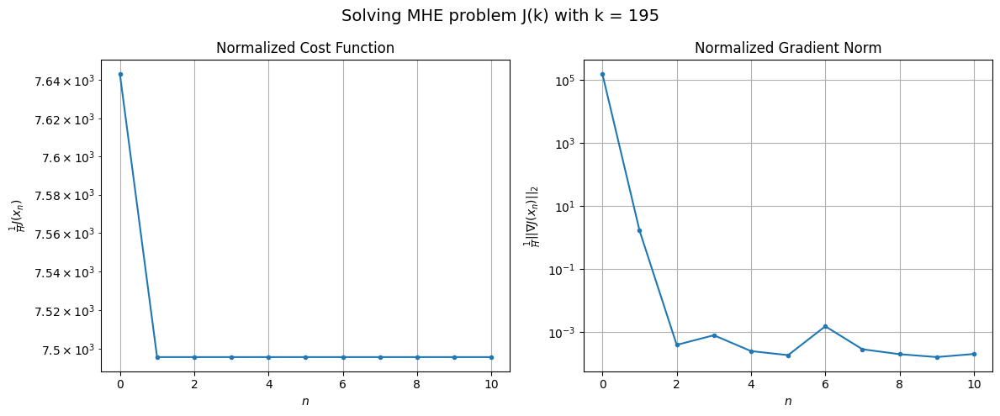

Windows:  44%|████▍     | 157/356 [22:40<29:24,  8.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 318442.50593130174
Gradient norm: 6182788.050372597
Global estimation error: 52.897784522039395
Initial conditions estimation errors: 16.917826606565633 m, 22.34529063288496 m, 11.621383607165766 m, 43.33109127542909 m
Position estimation errors: 26.983003082700407 m, 22.876556956919746 m, 33.46500084893773 m, 6.716884727960626 m

[Gauss-Newton] Iteration 1
Cost function: 312267.5013684287 (-1.94%)
Gradient norm: 68.90354770895746 (-100.00%)
Global estimation error: 58.93152897843437 (11.41%)
Initial conditions estimation errors: 19.36367169807264 m, 25.34405716511997 m, 14.690020109526102 m, 47.32699365966014 m
Position estimation errors: 24.189185135464815 m, 20.398414905925257 m, 28.187713314301757 m, 5.988655663098368 m

[Gauss-Newton] Iteration 2
Cost function: 312267.50137011765 (0.00%)
Gradient norm: 0.017990201242123537 (-99.97%)
Global estimation error: 58.95173053050678 (0.03%)
Initial conditions estimation errors: 1

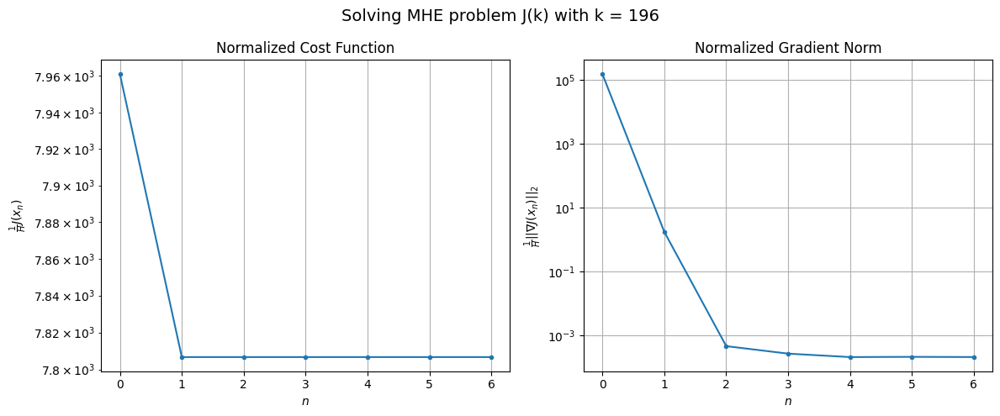

Windows:  44%|████▍     | 158/356 [22:47<27:29,  8.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 332942.9993722267
Gradient norm: 6444292.720091025
Global estimation error: 55.201665490548
Initial conditions estimation errors: 17.37769184476083 m, 23.4181320862427 m, 12.967390016313855 m, 45.0407255998985 m
Position estimation errors: 27.848376097792368 m, 23.936548968121496 m, 32.35373649943922 m, 7.144101285354853 m

[Gauss-Newton] Iteration 1
Cost function: 326400.93748196727 (-1.96%)
Gradient norm: 236.22269237141404 (-100.00%)
Global estimation error: 53.82549868992045 (-2.49%)
Initial conditions estimation errors: 19.89369253864474 m, 24.330606575494002 m, 17.220968538081852 m, 40.160604674718186 m
Position estimation errors: 24.968812699586834 m, 21.673728047593166 m, 25.962277692246793 m, 8.532176687733186 m

[Gauss-Newton] Iteration 2
Cost function: 326400.9374024239 (-0.00%)
Gradient norm: 0.03738561838008039 (-99.98%)
Global estimation error: 53.92628079994688 (0.19%)
Initial conditions estimation errors: 19.89

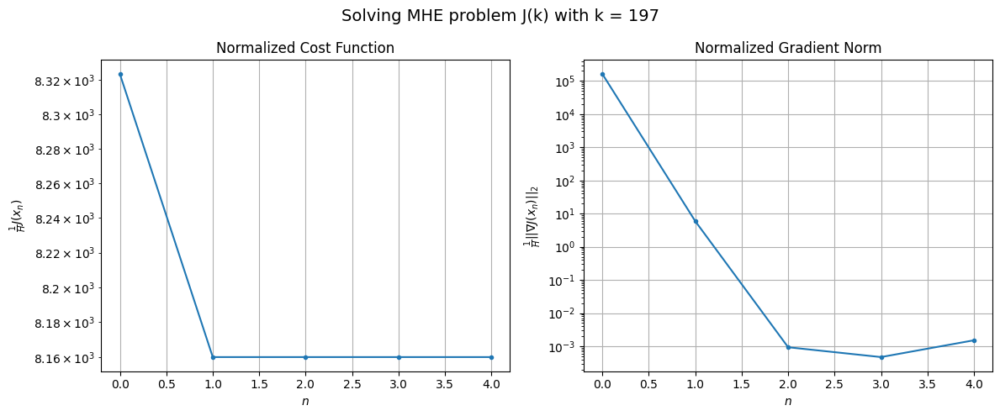

Windows:  45%|████▍     | 159/356 [22:53<24:37,  7.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 347965.3763966089
Gradient norm: 6553601.925739535
Global estimation error: 50.00297302564919
Initial conditions estimation errors: 17.989046095274446 m, 22.402655922299925 m, 15.225614799722182 m, 37.98661261233747 m
Position estimation errors: 28.711752890596443 m, 25.33401629941741 m, 30.08045085693731 m, 11.2464738571329 m

[Gauss-Newton] Iteration 1
Cost function: 341179.95106583426 (-1.95%)
Gradient norm: 400.6489873597413 (-99.99%)
Global estimation error: 42.27274502152503 (-15.46%)
Initial conditions estimation errors: 20.60045514529892 m, 19.61974390084859 m, 19.58190667306129 m, 24.37642108444023 m
Position estimation errors: 25.794344718849597 m, 25.391009305022557 m, 27.0994832042485 m, 18.253124101865428 m

[Gauss-Newton] Iteration 2
Cost function: 341179.94987686974 (-0.00%)
Gradient norm: 0.02170817020223743 (-99.99%)
Global estimation error: 42.24084361510649 (-0.08%)
Initial conditions estimation errors: 20.6

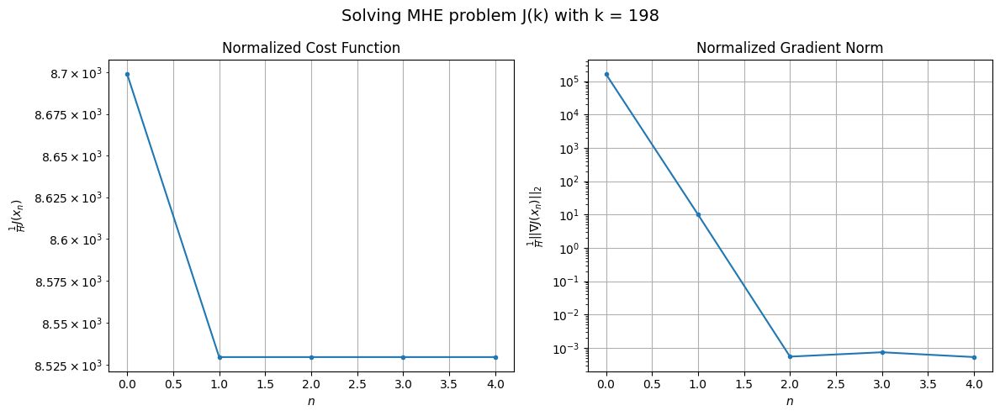

Windows:  45%|████▍     | 160/356 [22:59<22:46,  6.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 363874.73610310827
Gradient norm: 6885027.77904041
Global estimation error: 38.16472658475384
Initial conditions estimation errors: 18.73508526135481 m, 17.634255516112162 m, 17.728111464844776 m, 21.91528239372002 m
Position estimation errors: 29.61880620224919 m, 29.523108308987084 m, 30.939405866619687 m, 22.39246412840892 m

[Gauss-Newton] Iteration 1
Cost function: 356443.4579425995 (-2.04%)
Gradient norm: 34.920595582739544 (-100.00%)
Global estimation error: 44.85945186096286 (17.54%)
Initial conditions estimation errors: 21.536363188258026 m, 21.10118462258639 m, 19.872733790143243 m, 26.61502764945278 m
Position estimation errors: 26.58874925833233 m, 25.856910099874344 m, 28.35207761976302 m, 19.219331830326855 m

[Gauss-Newton] Iteration 2
Cost function: 356443.4579248229 (-0.00%)
Gradient norm: 0.04322495973386206 (-99.88%)
Global estimation error: 44.894953009577854 (0.08%)
Initial conditions estimation errors: 21

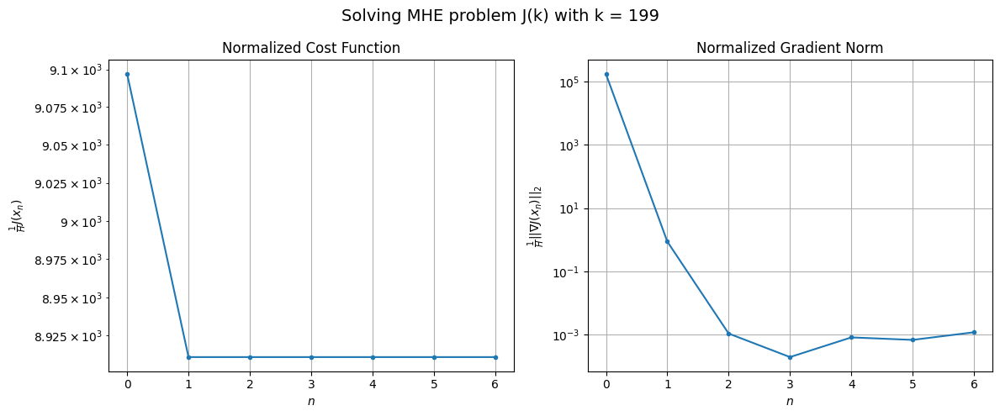

Windows:  45%|████▌     | 161/356 [23:06<22:42,  6.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379539.35372162977
Gradient norm: 7187111.954953179
Global estimation error: 40.7228358461934
Initial conditions estimation errors: 19.608471739286042 m, 19.04041262172383 m, 17.921911067757133 m, 24.292280485696182 m
Position estimation errors: 30.505952611329835 m, 29.98775946933781 m, 32.38863096674617 m, 23.176105561343185 m

[Gauss-Newton] Iteration 1
Cost function: 371446.87464009813 (-2.13%)
Gradient norm: 384.41415745204995 (-99.99%)
Global estimation error: 39.842989613499896 (-2.16%)
Initial conditions estimation errors: 22.646494940331454 m, 16.399663344389193 m, 24.08914330993713 m, 15.0117836688276 m
Position estimation errors: 27.388452467755307 m, 30.34894704872686 m, 27.980981058708583 m, 30.993826197933576 m

[Gauss-Newton] Iteration 2
Cost function: 371446.8735196121 (-0.00%)
Gradient norm: 0.06719304132753233 (-99.98%)
Global estimation error: 39.82774791290652 (-0.04%)
Initial conditions estimation errors: 

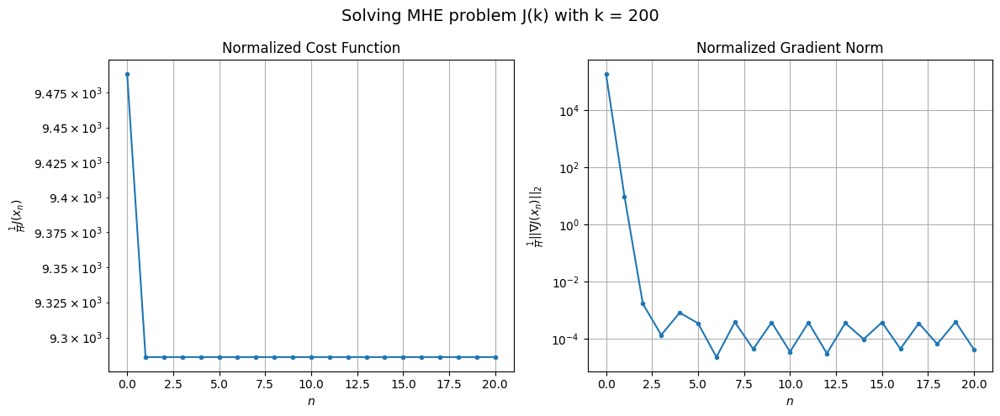

Windows:  46%|████▌     | 162/356 [23:26<35:24, 10.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 395386.9208724993
Gradient norm: 7621916.946943886
Global estimation error: 35.951002434832354
Initial conditions estimation errors: 20.527063406412466 m, 14.27545228655603 m, 22.207963285961576 m, 13.195494949590133 m
Position estimation errors: 31.43022130390605 m, 34.96524723488436 m, 31.695000837364233 m, 35.98894639480071 m

[Gauss-Newton] Iteration 1
Cost function: 386514.2453366325 (-2.24%)
Gradient norm: 672.485047918588 (-99.99%)
Global estimation error: 44.44657072129426 (23.63%)
Initial conditions estimation errors: 23.82817800694158 m, 13.098557773883835 m, 30.622449795145076 m, 17.274151033862125 m
Position estimation errors: 28.20928353620242 m, 32.99499419860135 m, 27.69337915610661 m, 41.74121068223374 m

[Gauss-Newton] Iteration 2
Cost function: 386514.24205653206 (-0.00%)
Gradient norm: 0.061606285430115905 (-99.99%)
Global estimation error: 44.42249383535077 (-0.05%)
Initial conditions estimation errors: 23.

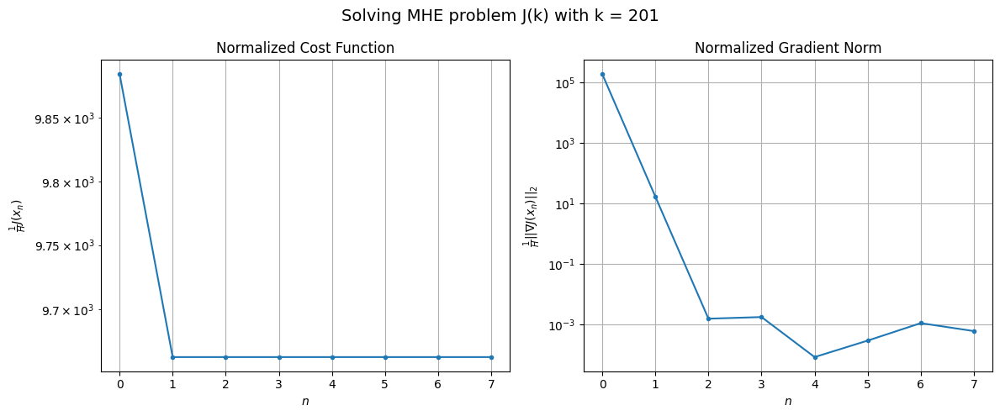

Windows:  46%|████▌     | 163/356 [23:34<32:34, 10.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 410712.1646562918
Gradient norm: 8125378.725150827
Global estimation error: 41.95014681111754
Initial conditions estimation errors: 21.41185097099028 m, 11.11979123081449 m, 29.088298108065274 m, 18.208656513001863 m
Position estimation errors: 32.4114949798362 m, 38.192528768375546 m, 30.801207734440453 m, 47.89801317417789 m

[Gauss-Newton] Iteration 1
Cost function: 400946.1385216175 (-2.38%)
Gradient norm: 21.376029216753263 (-100.00%)
Global estimation error: 47.86468848023724 (14.10%)
Initial conditions estimation errors: 25.00099168143721 m, 13.979365736650529 m, 34.23385374746057 m, 17.279623896625274 m
Position estimation errors: 29.081662557786228 m, 33.45750952414269 m, 25.853726228834166 m, 44.85063946579776 m

[Gauss-Newton] Iteration 2
Cost function: 400946.1385088945 (-0.00%)
Gradient norm: 0.03586822725792516 (-99.83%)
Global estimation error: 47.856298786115836 (-0.02%)
Initial conditions estimation errors: 25

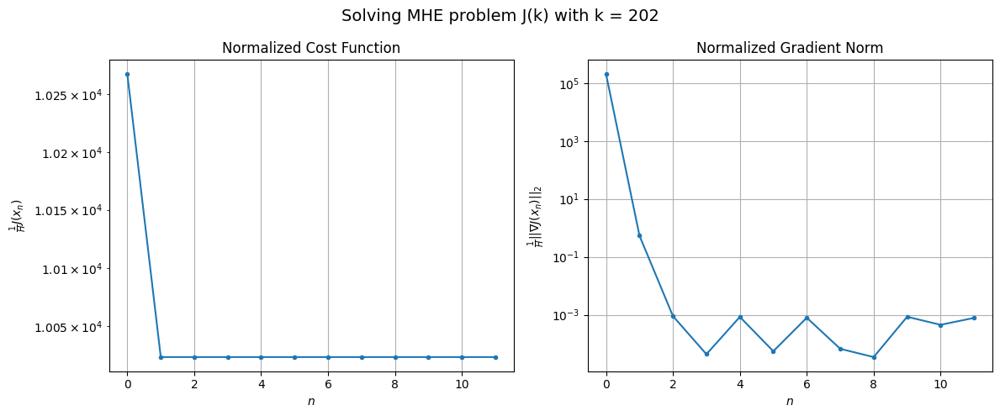

Windows:  46%|████▌     | 164/356 [23:45<33:38, 10.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 425870.5794443603
Gradient norm: 8880249.920695884
Global estimation error: 44.72442744522806
Initial conditions estimation errors: 22.24768182312454 m, 11.478136056919752 m, 32.50768245164797 m, 17.798954148683524 m
Position estimation errors: 33.4737769529098 m, 38.746568846790794 m, 28.96746499241144 m, 51.07048652673864 m

[Gauss-Newton] Iteration 1
Cost function: 415065.5906839601 (-2.54%)
Gradient norm: 239.9189187209541 (-100.00%)
Global estimation error: 53.226718997706406 (19.01%)
Initial conditions estimation errors: 26.11511531237497 m, 16.24162580011861 m, 36.55417601221119 m, 23.47482819470982 m
Position estimation errors: 30.00671618648863 m, 33.95055609121168 m, 26.619026605715312 m, 47.61104639243513 m

[Gauss-Newton] Iteration 2
Cost function: 415065.5905107248 (-0.00%)
Gradient norm: 0.0657242799726435 (-99.97%)
Global estimation error: 53.20795415721583 (-0.04%)
Initial conditions estimation errors: 26.11511

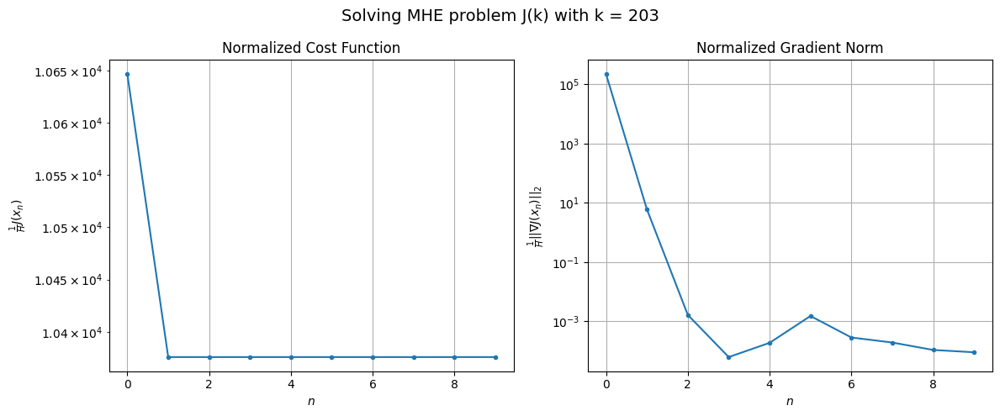

Windows:  46%|████▋     | 165/356 [23:55<32:55, 10.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 440593.8029295005
Gradient norm: 9365093.163085824
Global estimation error: 49.901975069374195
Initial conditions estimation errors: 23.044307241568944 m, 13.382849061452378 m, 34.763050767199665 m, 23.90766915706226 m
Position estimation errors: 34.60459050153342 m, 39.71820080815207 m, 29.77669614411388 m, 54.734660532450164 m

[Gauss-Newton] Iteration 1
Cost function: 428825.46650107304 (-2.67%)
Gradient norm: 148.5709355859351 (-100.00%)
Global estimation error: 56.11932061143705 (12.46%)
Initial conditions estimation errors: 27.141581223276898 m, 17.10893448296221 m, 40.532589937160175 m, 21.84224728628587 m
Position estimation errors: 31.007972123609434 m, 34.24389324865246 m, 24.637998056429836 m, 45.37760738214174 m

[Gauss-Newton] Iteration 2
Cost function: 428825.4664697458 (-0.00%)
Gradient norm: 0.05502334039824821 (-99.96%)
Global estimation error: 56.110079002438866 (-0.02%)
Initial conditions estimation errors: 

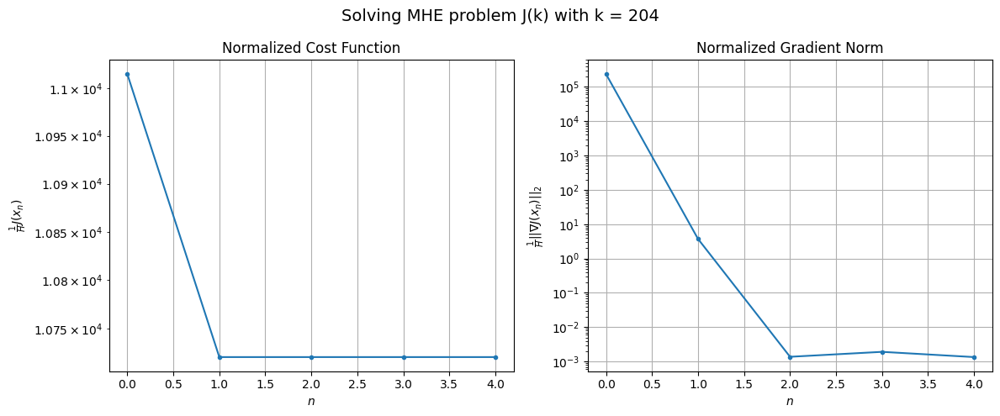

Windows:  47%|████▋     | 166/356 [24:01<28:21,  8.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 456430.84991036763
Gradient norm: 9934842.681313816
Global estimation error: 52.0776871290062
Initial conditions estimation errors: 23.80284635009478 m, 13.742181147690129 m, 38.71642188243829 m, 21.39339826850086 m
Position estimation errors: 35.825292200078906 m, 40.25180373124131 m, 27.742816506380805 m, 52.76006708402551 m

[Gauss-Newton] Iteration 1
Cost function: 443591.9329571486 (-2.81%)
Gradient norm: 110.74360966442686 (-100.00%)
Global estimation error: 56.671910664294295 (8.82%)
Initial conditions estimation errors: 28.104392158942296 m, 19.397715967959172 m, 40.27955007082183 m, 20.569606526984582 m
Position estimation errors: 32.076685864253285 m, 33.94781021668044 m, 27.380104684224037 m, 46.14377533405686 m

[Gauss-Newton] Iteration 2
Cost function: 443591.93294541346 (-0.00%)
Gradient norm: 0.07368552125102783 (-99.93%)
Global estimation error: 56.68395155506806 (0.02%)
Initial conditions estimation errors: 28

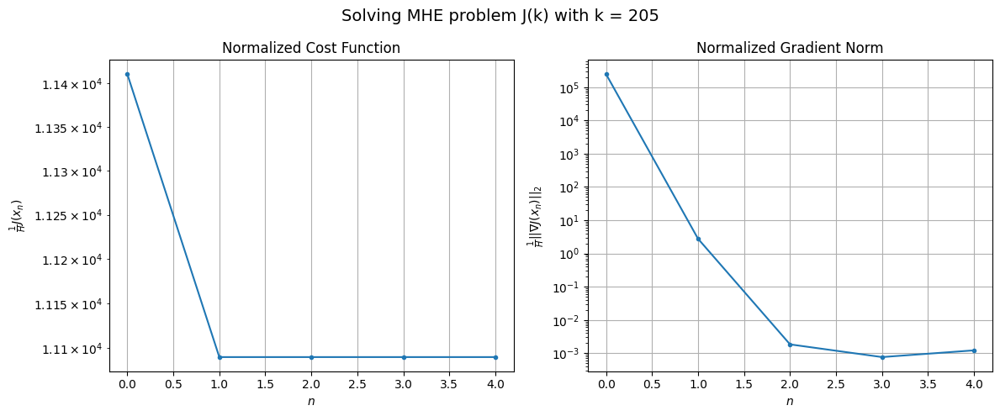

Windows:  47%|████▋     | 167/356 [24:07<25:08,  7.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 473038.1292467286
Gradient norm: 10518767.751990044
Global estimation error: 51.75449680438004
Initial conditions estimation errors: 24.550610070084705 m, 15.368551175339638 m, 38.35200331376975 m, 19.201567204591846 m
Position estimation errors: 37.14260256878764 m, 40.18486168061948 m, 30.803124712214736 m, 53.67711171524196 m

[Gauss-Newton] Iteration 1
Cost function: 459138.64307720994 (-2.94%)
Gradient norm: 2515.1277707562476 (-99.98%)
Global estimation error: 53.96982711476968 (4.28%)
Initial conditions estimation errors: 29.002062978567764 m, 24.517194343042586 m, 32.16145454846498 m, 20.88407104371587 m
Position estimation errors: 33.229943328646826 m, 34.8219641804056 m, 28.94734057316643 m, 41.502187699087656 m

[Gauss-Newton] Iteration 2
Cost function: 459138.60876796104 (-0.00%)
Gradient norm: 0.15158121517683365 (-99.99%)
Global estimation error: 53.967549274392624 (-0.00%)
Initial conditions estimation errors: 2

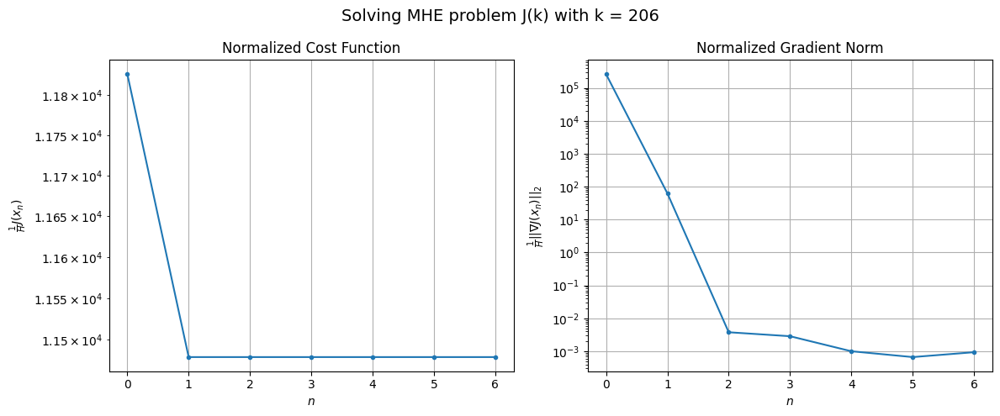

Windows:  47%|████▋     | 168/356 [24:14<24:28,  7.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 491619.1529371907
Gradient norm: 11084116.69748088
Global estimation error: 46.69365655088476
Initial conditions estimation errors: 25.294792696336398 m, 20.798930693059578 m, 28.569944351301437 m, 17.076539682567862 m
Position estimation errors: 38.59583991865247 m, 40.28743009213947 m, 34.21818887917135 m, 46.98708162663385 m

[Gauss-Newton] Iteration 1
Cost function: 476722.66313487344 (-3.03%)
Gradient norm: 1170.2911236883267 (-99.99%)
Global estimation error: 57.22658366055718 (22.56%)
Initial conditions estimation errors: 29.829279494812006 m, 27.970801966764856 m, 30.20896016173073 m, 26.270155405172638 m
Position estimation errors: 34.4981542028913 m, 38.42130069492541 m, 29.75128740380637 m, 45.713780662361884 m

[Gauss-Newton] Iteration 2
Cost function: 476722.65984018566 (-0.00%)
Gradient norm: 0.10171110467896244 (-99.99%)
Global estimation error: 57.242372703546145 (0.03%)
Initial conditions estimation errors: 29

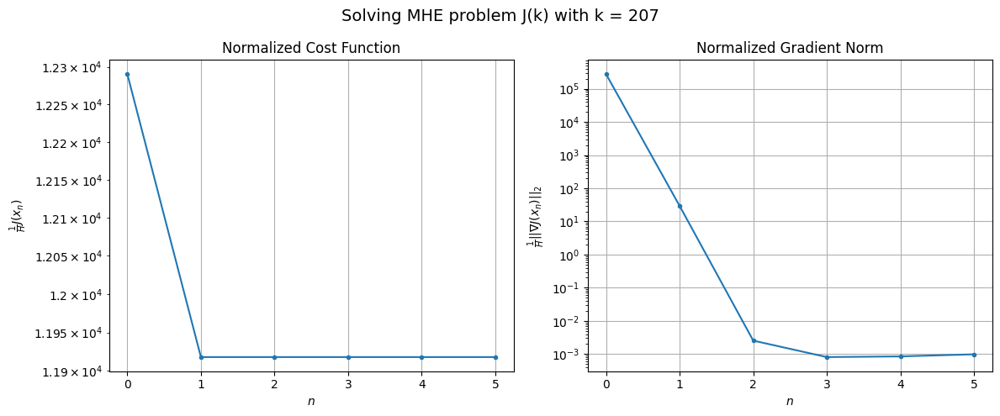

Windows:  47%|████▋     | 169/356 [24:21<23:13,  7.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 512981.3024453106
Gradient norm: 11639500.548938675
Global estimation error: 50.23310949097481
Initial conditions estimation errors: 26.043790190969776 m, 24.79692112964676 m, 25.43713936027094 m, 24.147985516748722 m
Position estimation errors: 40.22585706068413 m, 43.61943722984229 m, 36.22099381920195 m, 50.293535079879156 m

[Gauss-Newton] Iteration 1
Cost function: 497132.89185071073 (-3.09%)
Gradient norm: 378.20477795590756 (-100.00%)
Global estimation error: 56.50323273744491 (12.48%)
Initial conditions estimation errors: 30.626048963376252 m, 26.983555600937404 m, 31.87783206787213 m, 22.590326767558196 m
Position estimation errors: 35.94221549770107 m, 40.15186719272383 m, 32.43718102939785 m, 47.36071232421615 m

[Gauss-Newton] Iteration 2
Cost function: 497132.8912972456 (-0.00%)
Gradient norm: 0.03427541766978528 (-99.99%)
Global estimation error: 56.502761399929156 (-0.00%)
Initial conditions estimation errors: 3

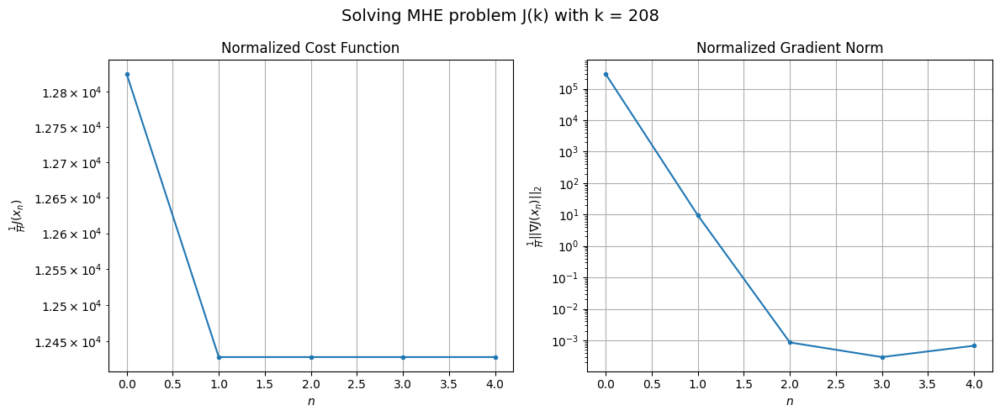

Windows:  48%|████▊     | 170/356 [24:26<21:25,  6.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 537841.1514174126
Gradient norm: 12408915.604458125
Global estimation error: 48.98919324459215
Initial conditions estimation errors: 26.82005657558453 m, 23.29755194473594 m, 27.647819989550875 m, 19.324128451680565 m
Position estimation errors: 42.07174448726644 m, 46.088062375151075 m, 38.79158393582611 m, 53.1142026702939 m

[Gauss-Newton] Iteration 1
Cost function: 520830.40204360295 (-3.16%)
Gradient norm: 24.08392814921839 (-100.00%)
Global estimation error: 59.809291398869725 (22.09%)
Initial conditions estimation errors: 31.459591847910094 m, 29.71516384592258 m, 32.063062395546226 m, 26.007415206275642 m
Position estimation errors: 37.562007744281466 m, 40.53944047461619 m, 35.14701031351861 m, 46.76772740824804 m

[Gauss-Newton] Iteration 2
Cost function: 520830.4020373643 (-0.00%)
Gradient norm: 0.014086526482214196 (-99.94%)
Global estimation error: 59.8136613845613 (0.01%)
Initial conditions estimation errors: 31.

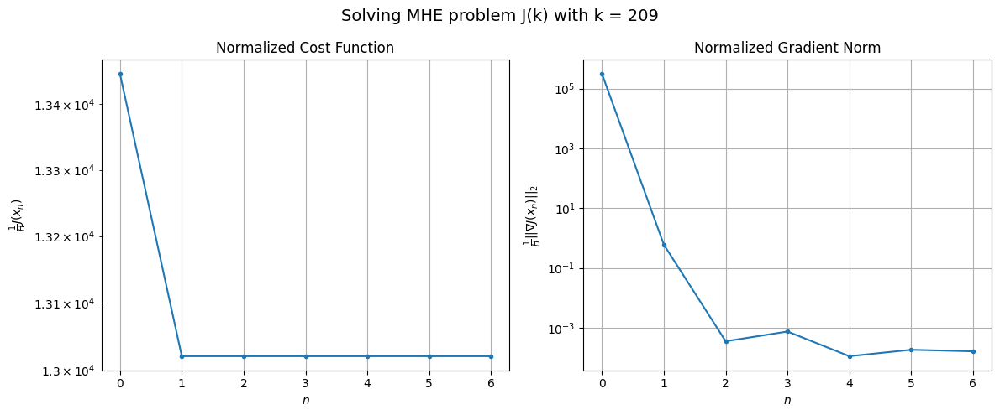

Windows:  48%|████▊     | 171/356 [24:33<21:10,  6.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 568487.817650293
Gradient norm: 13662634.419791056
Global estimation error: 52.36995890837544
Initial conditions estimation errors: 27.662868123341244 m, 26.019634546418732 m, 27.93591885576807 m, 22.801673799565926 m
Position estimation errors: 44.07814466219531 m, 46.880521121666725 m, 41.907727620623724 m, 52.84684223025159 m

[Gauss-Newton] Iteration 1
Cost function: 550062.5929934655 (-3.24%)
Gradient norm: 249.45230276445056 (-100.00%)
Global estimation error: 65.07374062192423 (24.26%)
Initial conditions estimation errors: 32.34975680445927 m, 33.97454083433674 m, 29.15881884399954 m, 34.402778692879 m
Position estimation errors: 39.27963174992419 m, 38.27464467616953 m, 40.14832100510004 m, 40.272727932052206 m

[Gauss-Newton] Iteration 2
Cost function: 550062.5929228686 (-0.00%)
Gradient norm: 0.016657637786790507 (-99.99%)
Global estimation error: 65.07123356344094 (-0.00%)
Initial conditions estimation errors: 32.34

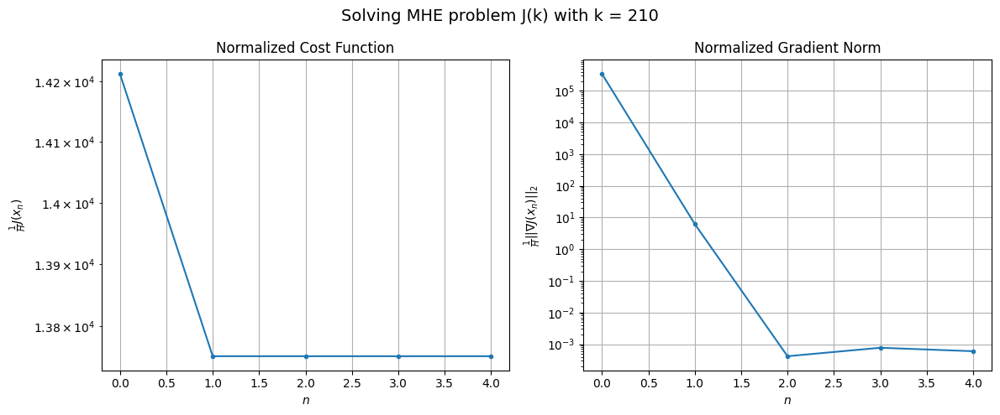

Windows:  48%|████▊     | 172/356 [24:39<20:17,  6.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 604177.7044952128
Gradient norm: 14426939.274159636
Global estimation error: 57.88525705877812
Initial conditions estimation errors: 28.570727779585912 m, 30.337457124226027 m, 25.34216890415898 m, 31.173797723283304 m
Position estimation errors: 46.10111146797683 m, 44.8958554147565 m, 47.1804446559709 m, 46.5375966241493 m

[Gauss-Newton] Iteration 1
Cost function: 584451.46071316 (-3.26%)
Gradient norm: 36.81470628342565 (-100.00%)
Global estimation error: 68.02663687999932 (17.52%)
Initial conditions estimation errors: 33.31507226649996 m, 36.57319463209382 m, 30.217262885787612 m, 35.5952365150232 m
Position estimation errors: 41.05325502434655 m, 38.550611522792764 m, 41.43364814992254 m, 40.104216761388784 m

[Gauss-Newton] Iteration 2
Cost function: 584451.4606961919 (-0.00%)
Gradient norm: 0.09329758493706593 (-99.75%)
Global estimation error: 68.02615188526092 (-0.00%)
Initial conditions estimation errors: 33.3150693

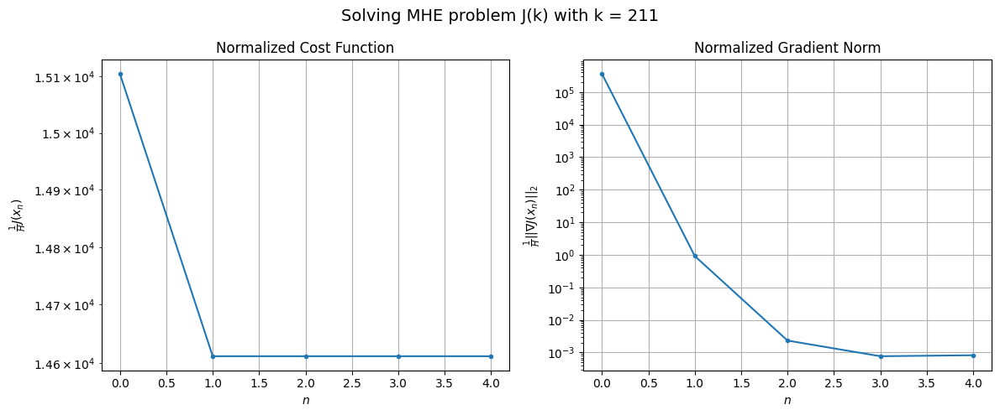

Windows:  49%|████▊     | 173/356 [24:45<19:36,  6.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 643855.0609585542
Gradient norm: 15522094.06562315
Global estimation error: 60.70494790114778
Initial conditions estimation errors: 29.533367759797283 m, 32.82773272515638 m, 26.546080868769195 m, 32.10128824371855 m
Position estimation errors: 48.07203679628094 m, 45.4879716483196 m, 48.582669496675365 m, 46.84674191071158 m

[Gauss-Newton] Iteration 1
Cost function: 622561.6684311223 (-3.31%)
Gradient norm: 578.9026284303825 (-100.00%)
Global estimation error: 69.10610335594954 (13.84%)
Initial conditions estimation errors: 34.34891114047254 m, 35.36361545898641 m, 35.8381893878004 m, 32.57018674858499 m
Position estimation errors: 42.73176681367948 m, 39.2674501839478 m, 43.10894000825106 m, 40.34496277003777 m

[Gauss-Newton] Iteration 2
Cost function: 622561.6674677522 (-0.00%)
Gradient norm: 0.1624270195901975 (-99.97%)
Global estimation error: 69.1075379104612 (0.00%)
Initial conditions estimation errors: 34.34890805777

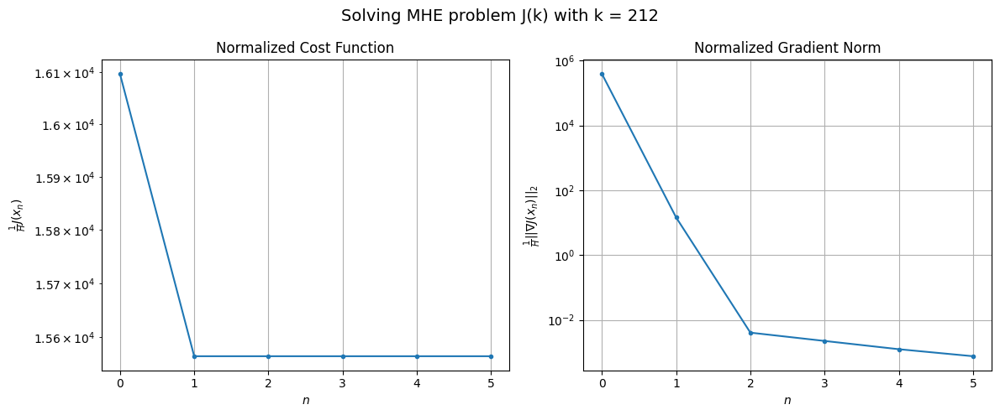

Windows:  49%|████▉     | 174/356 [24:51<19:15,  6.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 686886.8843479049
Gradient norm: 16532311.798532207
Global estimation error: 61.24510152875585
Initial conditions estimation errors: 30.52176821759067 m, 31.09756411691824 m, 32.624824242178555 m, 28.069936682108363 m
Position estimation errors: 49.81515566546744 m, 46.67737220149501 m, 49.60512835046593 m, 48.165301248984655 m

[Gauss-Newton] Iteration 1
Cost function: 664091.5961671065 (-3.32%)
Gradient norm: 172.7867705599045 (-100.00%)
Global estimation error: 75.47383998532891 (23.23%)
Initial conditions estimation errors: 35.39772471885289 m, 40.94255873633546 m, 33.04392599618843 m, 40.92774715611017 m
Position estimation errors: 44.19497144347248 m, 38.84796822123486 m, 46.23148494495864 m, 38.26527827663067 m

[Gauss-Newton] Iteration 2
Cost function: 664091.5958710468 (-0.00%)
Gradient norm: 0.022594452443219653 (-99.99%)
Global estimation error: 75.49577466551587 (0.03%)
Initial conditions estimation errors: 35.3977

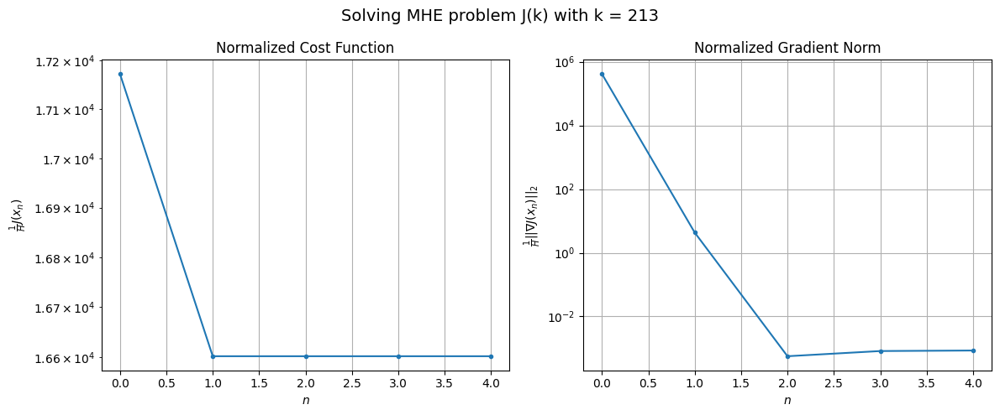

Windows:  49%|████▉     | 175/356 [24:57<18:01,  5.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 732162.0467063398
Gradient norm: 17400911.400371168
Global estimation error: 67.57559718520343
Initial conditions estimation errors: 31.47694232064099 m, 36.80610492633426 m, 29.476494263339617 m, 36.77071314979329 m
Position estimation errors: 51.20186203845675 m, 45.944591700297316 m, 53.086989167116094 m, 45.44632941605263 m

[Gauss-Newton] Iteration 1
Cost function: 708192.6828786823 (-3.27%)
Gradient norm: 2485.778288350728 (-99.99%)
Global estimation error: 78.06239707134289 (15.52%)
Initial conditions estimation errors: 36.379729736880854 m, 43.22802371025277 m, 36.74379093644982 m, 39.388567748739106 m
Position estimation errors: 45.350032154705886 m, 42.90714566496602 m, 40.77800326080799 m, 50.762076238319956 m

[Gauss-Newton] Iteration 2
Cost function: 708192.6774913074 (-0.00%)
Gradient norm: 0.09850774673071427 (-100.00%)
Global estimation error: 78.11075404679706 (0.06%)
Initial conditions estimation errors: 36.3

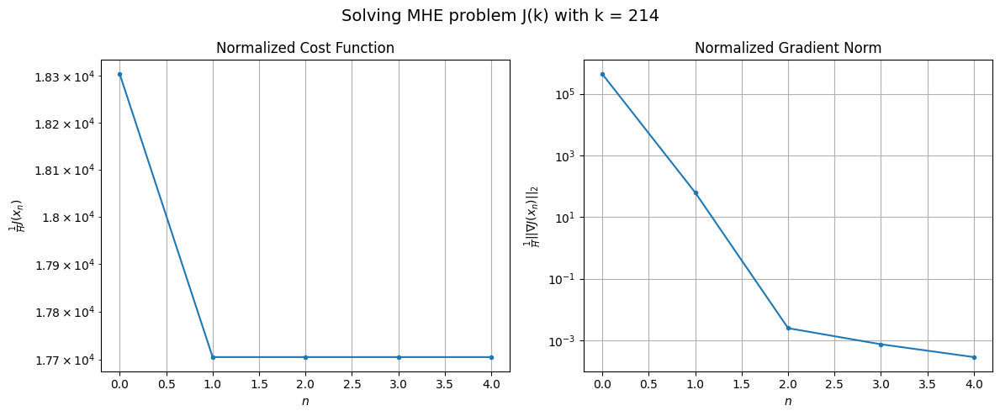

Windows:  49%|████▉     | 176/356 [25:02<17:18,  5.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 778059.1473398521
Gradient norm: 17842270.40694187
Global estimation error: 70.54760348932477
Initial conditions estimation errors: 32.335414468744055 m, 39.60869928951607 m, 31.955593951899473 m, 36.6244808306541 m
Position estimation errors: 52.131641074440026 m, 49.20403128081152 m, 48.33603217853797 m, 56.14564851480774 m

[Gauss-Newton] Iteration 1
Cost function: 752764.5806250909 (-3.25%)
Gradient norm: 49.21309520445463 (-100.00%)
Global estimation error: 77.75870416586508 (10.22%)
Initial conditions estimation errors: 37.309180593392824 m, 42.883708920758984 m, 36.793133058721246 m, 38.23177139283815 m
Position estimation errors: 46.05284829577966 m, 43.78432221589063 m, 42.829614439039936 m, 51.82246704961253 m

[Gauss-Newton] Iteration 2
Cost function: 752764.5806117227 (-0.00%)
Gradient norm: 0.026504773792469582 (-99.95%)
Global estimation error: 77.74416259817244 (-0.02%)
Initial conditions estimation errors: 37.3

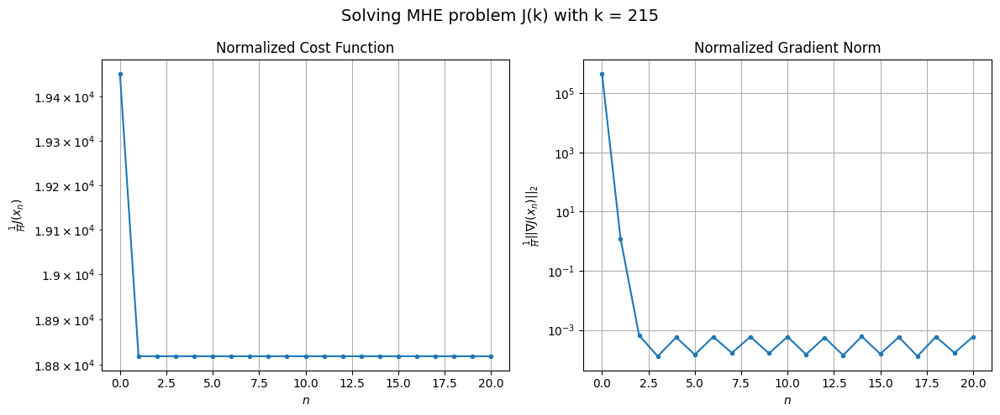

Windows:  50%|████▉     | 177/356 [25:22<30:02, 10.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 821726.3927302496
Gradient norm: 18096119.520744264
Global estimation error: 69.77914306740603
Initial conditions estimation errors: 33.13405244811325 m, 38.98485678489459 m, 31.984186810355006 m, 35.04900127681982 m
Position estimation errors: 52.45784807556297 m, 49.8570850567667 m, 49.90860956206514 m, 57.12022880242633 m

[Gauss-Newton] Iteration 1
Cost function: 795874.3153264603 (-3.15%)
Gradient norm: 740.8545461402839 (-100.00%)
Global estimation error: 81.64105600345087 (17.00%)
Initial conditions estimation errors: 38.10075491370208 m, 44.150347579240865 m, 40.41107172321286 m, 40.38886558186135 m
Position estimation errors: 46.24504020907186 m, 41.37939638772901 m, 44.15978576630387 m, 45.543724028556014 m

[Gauss-Newton] Iteration 2
Cost function: 795874.3145058505 (-0.00%)
Gradient norm: 0.04669739635162653 (-99.99%)
Global estimation error: 81.66232329363456 (0.03%)
Initial conditions estimation errors: 38.100751

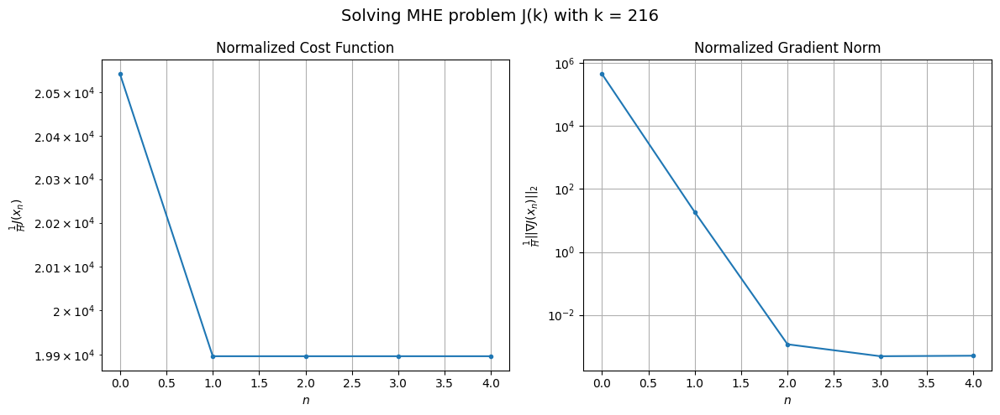

Windows:  50%|█████     | 178/356 [25:27<25:39,  8.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 859274.417575046
Gradient norm: 18118538.739071522
Global estimation error: 73.14199285021478
Initial conditions estimation errors: 33.79580037376297 m, 39.800150281081244 m, 36.12361124639775 m, 36.31257940512128 m
Position estimation errors: 52.14455008912582 m, 47.28226045937677 m, 49.93040616871698 m, 51.24622149776543 m

[Gauss-Newton] Iteration 1
Cost function: 833154.5942692705 (-3.04%)
Gradient norm: 540.7656317056657 (-100.00%)
Global estimation error: 83.07601695166532 (13.58%)
Initial conditions estimation errors: 38.7456076649199 m, 43.69057072268466 m, 42.92641698174024 m, 40.605836284119455 m
Position estimation errors: 45.847092569806826 m, 43.69579496662652 m, 40.92955684836645 m, 49.593278948089576 m

[Gauss-Newton] Iteration 2
Cost function: 833154.593997673 (-0.00%)
Gradient norm: 0.06833758747379212 (-99.99%)
Global estimation error: 83.09135265449741 (0.02%)
Initial conditions estimation errors: 38.7456042

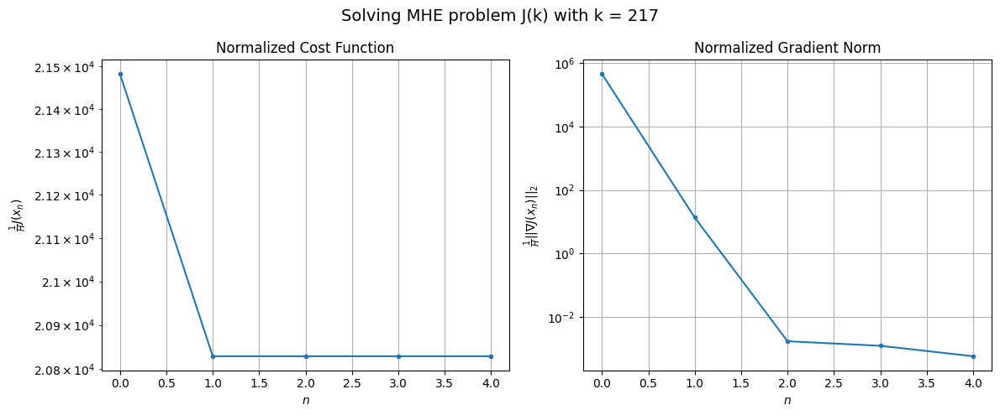

Windows:  50%|█████     | 179/356 [25:32<22:30,  7.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 888810.2529756348
Gradient norm: 17978034.07647816
Global estimation error: 74.45070771496532
Initial conditions estimation errors: 34.2959875926172 m, 39.449748683442756 m, 38.01724264643022 m, 36.94693206700744 m
Position estimation errors: 51.18371297167047 m, 48.79572579036317 m, 46.73761354376409 m, 53.953844683224844 m

[Gauss-Newton] Iteration 1
Cost function: 862842.0020016789 (-2.92%)
Gradient norm: 290.4094432434332 (-100.00%)
Global estimation error: 79.37910472079231 (6.62%)
Initial conditions estimation errors: 39.202720837316875 m, 42.7503269428809 m, 40.83639546614414 m, 35.622494593441964 m
Position estimation errors: 44.86146859760886 m, 45.087538405539654 m, 39.71407138724226 m, 55.27053670548143 m

[Gauss-Newton] Iteration 2
Cost function: 862842.0018828248 (-0.00%)
Gradient norm: 0.043830266214955005 (-99.98%)
Global estimation error: 79.32487645973865 (-0.07%)
Initial conditions estimation errors: 39.20271

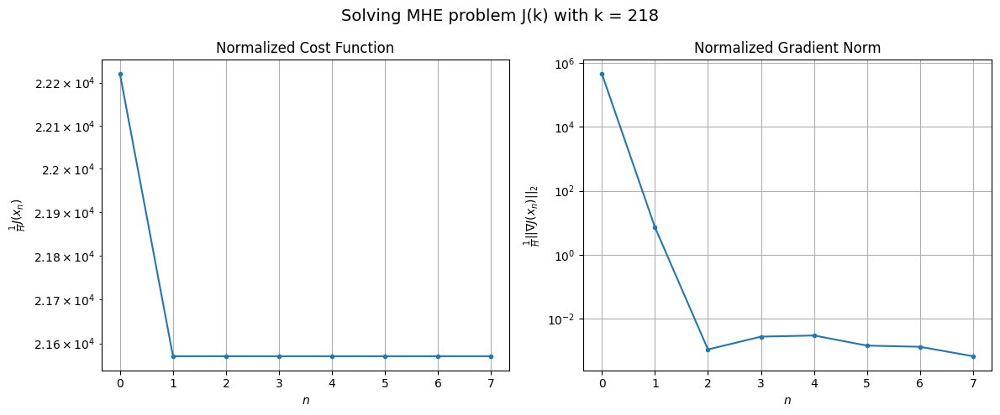

Windows:  51%|█████     | 180/356 [25:41<22:56,  7.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 909964.3650763652
Gradient norm: 17863604.52981662
Global estimation error: 70.40782925775792
Initial conditions estimation errors: 34.593199746885524 m, 38.42632590376225 m, 35.46398229410921 m, 32.035482685518424 m
Position estimation errors: 49.681488463910675 m, 49.65578360845215 m, 45.389701727412614 m, 58.8964782160003 m

[Gauss-Newton] Iteration 1
Cost function: 884524.942453996 (-2.80%)
Gradient norm: 2748.9448620386947 (-99.98%)
Global estimation error: 75.19762855304225 (6.80%)
Initial conditions estimation errors: 39.423565930967435 m, 40.21240042015592 m, 42.190885964589214 m, 26.520422598610924 m
Position estimation errors: 43.37881171897064 m, 49.6969381486987 m, 34.88503562941091 m, 71.1984987957841 m

[Gauss-Newton] Iteration 2
Cost function: 884524.937436518 (-0.00%)
Gradient norm: 0.05775889724112275 (-100.00%)
Global estimation error: 75.1661054615201 (-0.04%)
Initial conditions estimation errors: 39.4235624

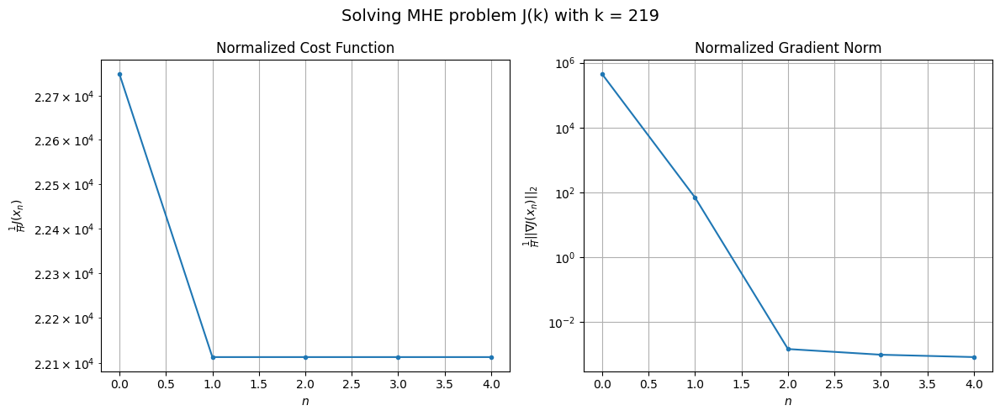

Windows:  51%|█████     | 181/356 [25:46<20:25,  7.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 921925.2505900757
Gradient norm: 17817475.20755118
Global estimation error: 66.22606077234812
Initial conditions estimation errors: 34.670065609735964 m, 36.28796622904858 m, 35.94919059113103 m, 23.97275363920981 m
Position estimation errors: 47.805085467571395 m, 53.38215300847937 m, 41.08486852037232 m, 73.0673650067853 m

[Gauss-Newton] Iteration 1
Cost function: 897396.6513554937 (-2.66%)
Gradient norm: 5681.845399143053 (-99.97%)
Global estimation error: 85.26432538010401 (28.75%)
Initial conditions estimation errors: 39.389357865022944 m, 44.42622600317558 m, 40.33307019999154 m, 46.02184605441446 m
Position estimation errors: 41.56643638743251 m, 39.26844433130863 m, 38.73825581445183 m, 39.967595253919086 m

[Gauss-Newton] Iteration 2
Cost function: 897396.6307682801 (-0.00%)
Gradient norm: 0.06569490821703562 (-100.00%)
Global estimation error: 85.28476482916415 (0.02%)
Initial conditions estimation errors: 39.389354

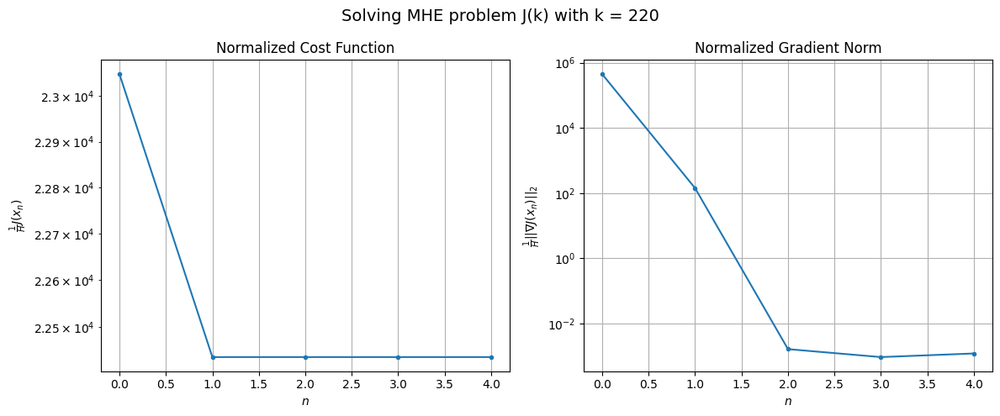

Windows:  51%|█████     | 182/356 [25:51<18:37,  6.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 924861.7517538293
Gradient norm: 17719834.21581083
Global estimation error: 75.731048826947
Initial conditions estimation errors: 34.54716435416716 m, 39.73616297740746 m, 35.000012543884985 m, 41.68567611310792 m
Position estimation errors: 45.71647464766549 m, 43.44100533657837 m, 43.59926185691003 m, 43.49103465306967 m

[Gauss-Newton] Iteration 1
Cost function: 901617.5040519526 (-2.51%)
Gradient norm: 153.4859082935212 (-100.00%)
Global estimation error: 88.88603715256261 (17.37%)
Initial conditions estimation errors: 39.11787883298341 m, 47.36536804788159 m, 37.661400387026006 m, 52.044522031885826 m
Position estimation errors: 39.58036570426555 m, 34.425986467339236 m, 39.14819345104687 m, 32.15005237920983 m

[Gauss-Newton] Iteration 2
Cost function: 901617.504013313 (-0.00%)
Gradient norm: 0.0865437439121457 (-99.94%)
Global estimation error: 88.92726857353028 (0.05%)
Initial conditions estimation errors: 39.117875336

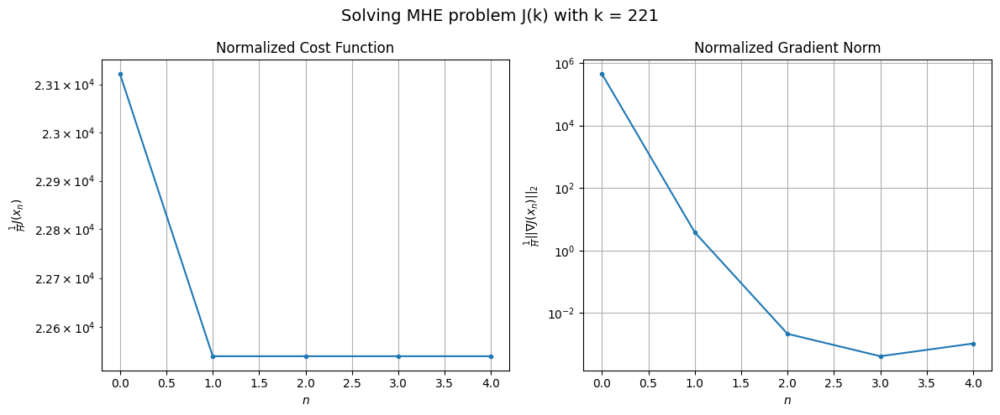

Windows:  51%|█████▏    | 183/356 [25:56<17:31,  6.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 919842.7008913794
Gradient norm: 17691564.128684476
Global estimation error: 79.3367052900844
Initial conditions estimation errors: 34.263248144202514 m, 42.542178931028346 m, 32.4270458427029 m, 47.52858317211167 m
Position estimation errors: 43.498565908376456 m, 38.527602227282024 m, 43.73134891473424 m, 35.726373362292755 m

[Gauss-Newton] Iteration 1
Cost function: 897858.3304918049 (-2.39%)
Gradient norm: 121.94682393394062 (-100.00%)
Global estimation error: 85.45945982890973 (7.72%)
Initial conditions estimation errors: 38.68587877476689 m, 43.19056184049948 m, 36.87736700387585 m, 50.8067813808742 m
Position estimation errors: 37.457749765089325 m, 34.09254162315234 m, 37.923226227469634 m, 29.019477188898065 m

[Gauss-Newton] Iteration 2
Cost function: 897858.3304193562 (-0.00%)
Gradient norm: 0.05206505535120408 (-99.96%)
Global estimation error: 85.3813738564501 (-0.09%)
Initial conditions estimation errors: 38.685

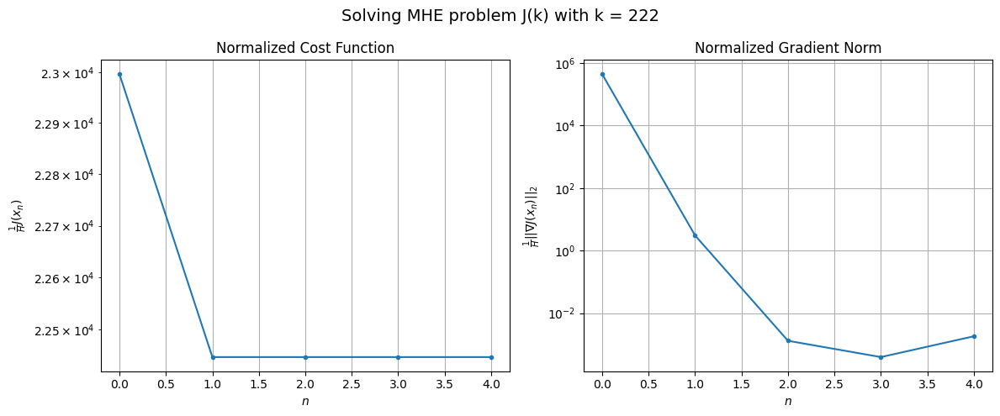

Windows:  52%|█████▏    | 184/356 [26:01<16:43,  5.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 908544.3908336587
Gradient norm: 17845903.57837068
Global estimation error: 75.60479466768527
Initial conditions estimation errors: 33.8851956205472 m, 38.19004955511476 m, 31.84853021653589 m, 45.771645896604426 m
Position estimation errors: 41.112166242254666 m, 38.22117029351405 m, 41.958630922489995 m, 33.165117046396475 m

[Gauss-Newton] Iteration 1
Cost function: 887858.9748751472 (-2.28%)
Gradient norm: 3272.8032627725393 (-99.98%)
Global estimation error: 94.12248038605854 (24.49%)
Initial conditions estimation errors: 38.13563910442636 m, 44.092499770796955 m, 34.19979385913757 m, 65.50502343425445 m
Position estimation errors: 35.154204368866466 m, 27.93727377354022 m, 39.58633427019482 m, 26.23636680199543 m

[Gauss-Newton] Iteration 2
Cost function: 887858.9681583705 (-0.00%)
Gradient norm: 0.22209922420429304 (-99.99%)
Global estimation error: 93.96211294154959 (-0.17%)
Initial conditions estimation errors: 38.135

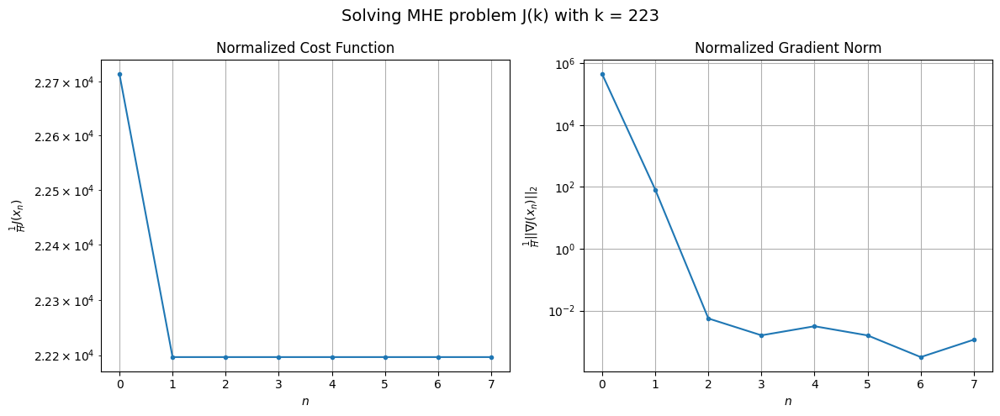

Windows:  52%|█████▏    | 185/356 [26:09<18:18,  6.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 889350.3134299931
Gradient norm: 17571268.74298988
Global estimation error: 83.5193623505787
Initial conditions estimation errors: 33.43255280042604 m, 38.63632280969802 m, 29.907228867329692 m, 58.91104063090347 m
Position estimation errors: 38.479981582178645 m, 32.28976382319036 m, 42.078346984845986 m, 30.843273744862618 m

[Gauss-Newton] Iteration 1
Cost function: 870256.1095535057 (-2.15%)
Gradient norm: 111.31691300951249 (-100.00%)
Global estimation error: 93.4880679059649 (11.94%)
Initial conditions estimation errors: 37.51618185316158 m, 43.29524073232918 m, 34.39703066299372 m, 65.38265228486956 m
Position estimation errors: 32.686923155361164 m, 26.960362100975484 m, 35.98491008924108 m, 27.410405417331333 m

[Gauss-Newton] Iteration 2
Cost function: 870256.1095243705 (-0.00%)
Gradient norm: 0.059421490492171915 (-99.95%)
Global estimation error: 93.45599082100973 (-0.03%)
Initial conditions estimation errors: 37.5

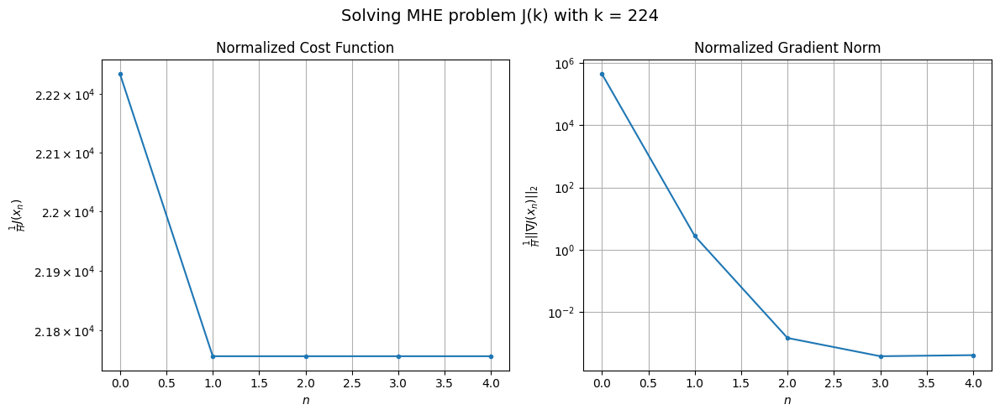

Windows:  52%|█████▏    | 186/356 [26:14<17:03,  6.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 862962.8476314428
Gradient norm: 17131920.444119852
Global estimation error: 83.32582294544346
Initial conditions estimation errors: 32.93430850055843 m, 38.07736757297349 m, 30.05567132889294 m, 59.20529090451605 m
Position estimation errors: 35.645728565321704 m, 30.909894984077727 m, 38.496197609112535 m, 31.868147259829076 m

[Gauss-Newton] Iteration 1
Cost function: 845532.332803713 (-2.02%)
Gradient norm: 543.589853110306 (-100.00%)
Global estimation error: 84.64889206946603 (1.59%)
Initial conditions estimation errors: 36.84326088465002 m, 40.433260097146196 m, 34.293871983799356 m, 54.74544661746489 m
Position estimation errors: 30.048091041896583 m, 26.295845249973247 m, 31.715948345064906 m, 23.23543280958901 m

[Gauss-Newton] Iteration 2
Cost function: 845532.332579417 (-0.00%)
Gradient norm: 0.0635734112520948 (-99.99%)
Global estimation error: 84.74381135788326 (0.11%)
Initial conditions estimation errors: 36.8432

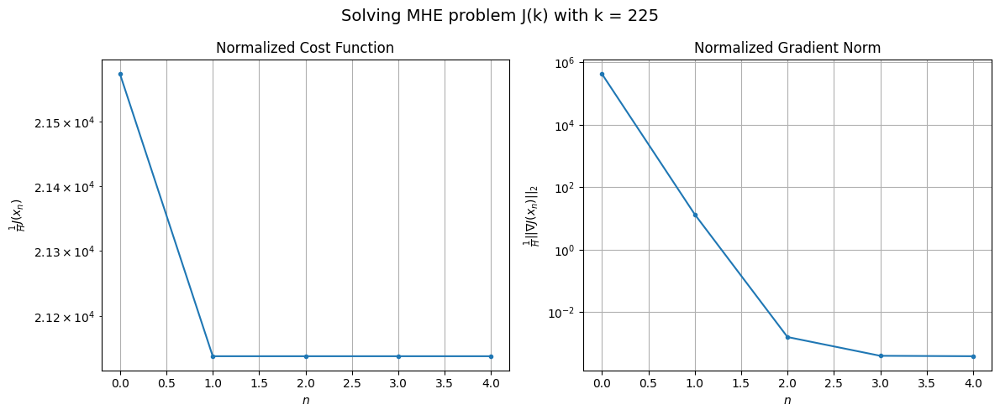

Windows:  53%|█████▎    | 187/356 [26:20<16:25,  5.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 831726.1904847298
Gradient norm: 16750778.519331021
Global estimation error: 75.19771550347119
Initial conditions estimation errors: 32.396427610822826 m, 35.54855887715703 m, 29.980774554680902 m, 49.42262388607089 m
Position estimation errors: 32.62360042394146 m, 29.589476571105205 m, 33.96374431535411 m, 27.499741843109913 m

[Gauss-Newton] Iteration 1
Cost function: 815890.8227633997 (-1.90%)
Gradient norm: 431.2811728086923 (-100.00%)
Global estimation error: 91.30550312574779 (21.42%)
Initial conditions estimation errors: 36.13631072041074 m, 41.10084477948727 m, 33.58261354353915 m, 64.91350420990135 m
Position estimation errors: 27.2372932830232 m, 23.19761877712284 m, 29.12118769830033 m, 31.219212778307426 m

[Gauss-Newton] Iteration 2
Cost function: 815890.8223783964 (-0.00%)
Gradient norm: 0.1889983651796791 (-99.96%)
Global estimation error: 91.11999041769094 (-0.20%)
Initial conditions estimation errors: 36.1363

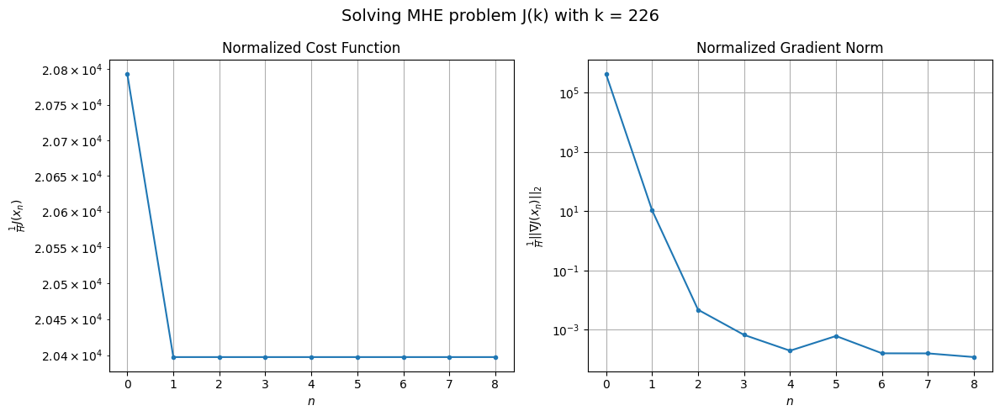

Windows:  53%|█████▎    | 188/356 [26:29<19:13,  6.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 793976.0506000667
Gradient norm: 15779872.008251118
Global estimation error: 81.59881246736927
Initial conditions estimation errors: 31.82775458857263 m, 36.20931120718235 m, 29.543804917694544 m, 58.833523303132345 m
Position estimation errors: 29.43589628757264 m, 26.28638141042535 m, 30.727688589484465 m, 34.80923479964149 m

[Gauss-Newton] Iteration 1
Cost function: 779983.4656138937 (-1.76%)
Gradient norm: 209.45399688531063 (-100.00%)
Global estimation error: 82.66078198940559 (1.30%)
Initial conditions estimation errors: 35.404958978599325 m, 39.09425713882435 m, 31.801795770618835 m, 55.13211561900972 m
Position estimation errors: 24.39440749643213 m, 21.183546553703586 m, 25.807501439357484 m, 32.10394300638499 m

[Gauss-Newton] Iteration 2
Cost function: 779983.4652465541 (-0.00%)
Gradient norm: 0.13237491187776942 (-99.94%)
Global estimation error: 82.81513847080706 (0.19%)
Initial conditions estimation errors: 35.4

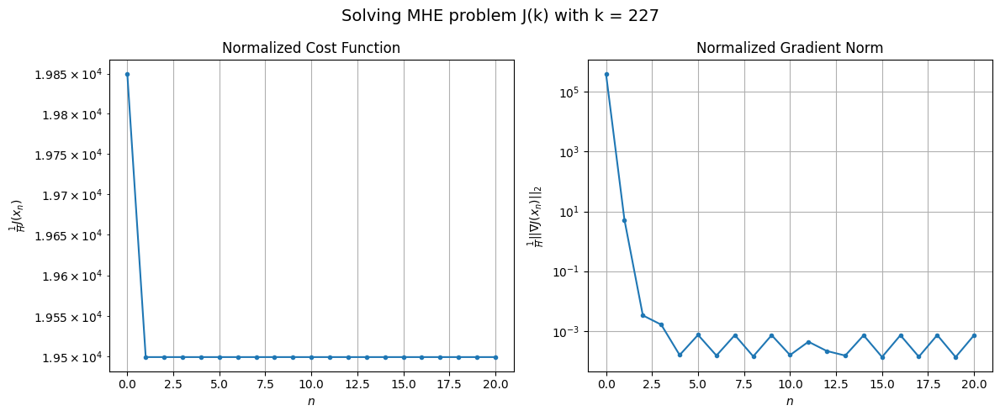

Windows:  53%|█████▎    | 189/356 [26:50<30:41, 11.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 752124.5581440842
Gradient norm: 14842280.738117766
Global estimation error: 73.13986515471983
Initial conditions estimation errors: 31.214016908070366 m, 34.19472729065336 m, 28.137764141677597 m, 49.13333403831367 m
Position estimation errors: 26.28472126931845 m, 23.995608159924295 m, 26.411811303410158 m, 35.234228062160945 m

[Gauss-Newton] Iteration 1
Cost function: 739805.9242848753 (-1.64%)
Gradient norm: 90.99804921261045 (-100.00%)
Global estimation error: 76.20861172347486 (4.20%)
Initial conditions estimation errors: 34.65016530723822 m, 37.162073149256784 m, 32.04623992907175 m, 46.89466590569838 m
Position estimation errors: 21.63565529975643 m, 20.29044662869896 m, 21.505047379951005 m, 29.266649466057174 m

[Gauss-Newton] Iteration 2
Cost function: 739805.924184416 (-0.00%)
Gradient norm: 0.08978890022115524 (-99.90%)
Global estimation error: 76.33271140186292 (0.16%)
Initial conditions estimation errors: 34.65

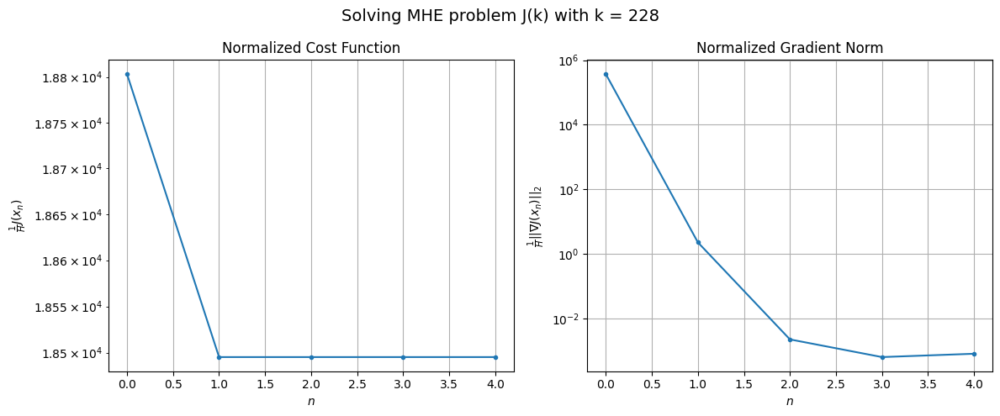

Windows:  53%|█████▎    | 190/356 [26:55<25:41,  9.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 707228.7859286239
Gradient norm: 13857787.953833837
Global estimation error: 66.89832510028418
Initial conditions estimation errors: 30.51816071825152 m, 32.36689897788883 m, 28.39760893122196 m, 41.10912476405745 m
Position estimation errors: 23.363071664592606 m, 22.85512934324228 m, 22.011652231975887 m, 32.05308074378692 m

[Gauss-Newton] Iteration 1
Cost function: 696471.2156601475 (-1.52%)
Gradient norm: 30.608804956403976 (-100.00%)
Global estimation error: 73.22209281885307 (9.45%)
Initial conditions estimation errors: 33.816318259808845 m, 35.320495227203786 m, 31.781930303508545 m, 44.27499454027339 m
Position estimation errors: 19.166086437064088 m, 18.675538821180577 m, 17.37142586120431 m, 29.89218501434388 m

[Gauss-Newton] Iteration 2
Cost function: 696471.215628023 (-0.00%)
Gradient norm: 0.04350381726987599 (-99.86%)
Global estimation error: 73.21421682932296 (-0.01%)
Initial conditions estimation errors: 33.8

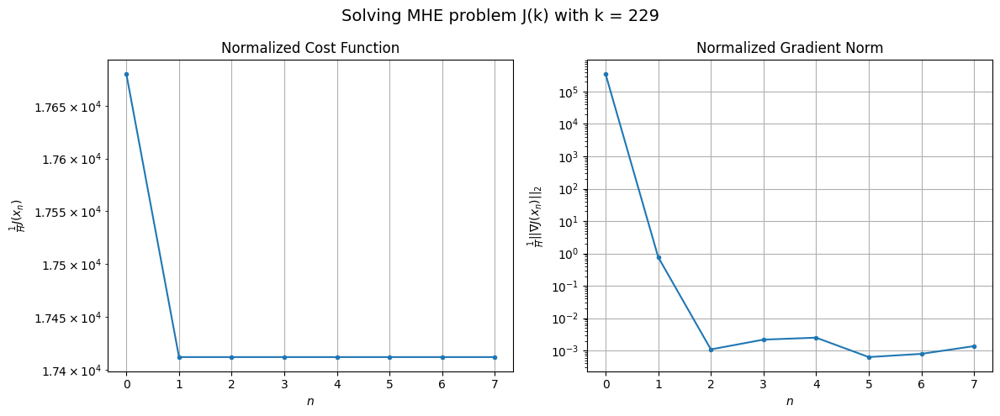

Windows:  54%|█████▎    | 191/356 [27:03<24:51,  9.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 661408.1400411897
Gradient norm: 12865013.763117313
Global estimation error: 63.855224788997006
Initial conditions estimation errors: 29.664760877860434 m, 30.551714495033625 m, 28.138258847324213 m, 38.37049225783873 m
Position estimation errors: 20.95495888426383 m, 21.092545620887783 m, 17.87984101503759 m, 32.293761630063486 m

[Gauss-Newton] Iteration 1
Cost function: 652003.6119995661 (-1.42%)
Gradient norm: 272.7050252317877 (-100.00%)
Global estimation error: 71.85634725585273 (12.53%)
Initial conditions estimation errors: 32.85933288514315 m, 34.43956634957266 m, 32.816606957780024 m, 42.667985943818536 m
Position estimation errors: 17.300240315996536 m, 18.712078842125905 m, 16.535603287685397 m, 29.01217078142542 m

[Gauss-Newton] Iteration 2
Cost function: 652003.6118186679 (-0.00%)
Gradient norm: 0.04183527142625678 (-99.98%)
Global estimation error: 71.85848847758264 (0.00%)
Initial conditions estimation errors: 

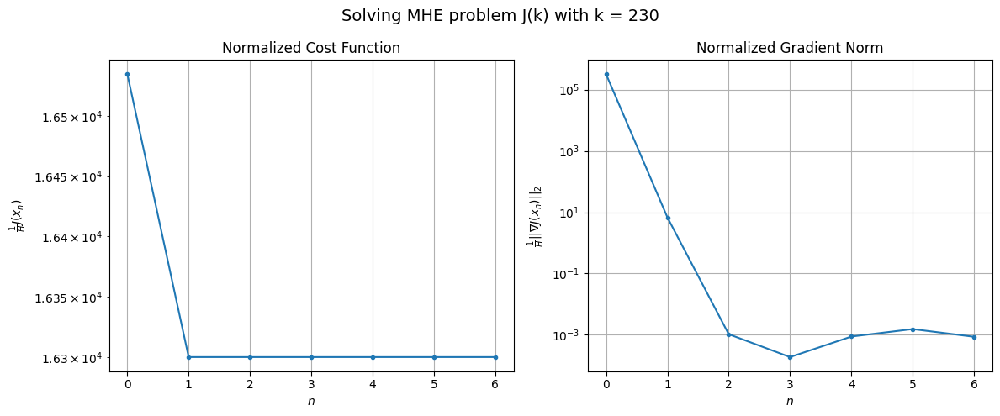

Windows:  54%|█████▍    | 192/356 [27:11<23:06,  8.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 616496.3871944005
Gradient norm: 11966133.26725714
Global estimation error: 62.476060920184935
Initial conditions estimation errors: 28.63039530524391 m, 29.732966782320112 m, 28.744992926029308 m, 37.05679222657516 m
Position estimation errors: 19.42379489439981 m, 21.321058958859215 m, 18.38677659601526 m, 31.72015205792607 m

[Gauss-Newton] Iteration 1
Cost function: 608220.6494459845 (-1.34%)
Gradient norm: 51.83579496526189 (-100.00%)
Global estimation error: 68.35804140063746 (9.41%)
Initial conditions estimation errors: 31.738576358822566 m, 31.89393199338035 m, 32.428038243046586 m, 39.958154704290656 m
Position estimation errors: 16.355581553604946 m, 17.965999157717874 m, 16.270713519193826 m, 29.563332176841257 m

[Gauss-Newton] Iteration 2
Cost function: 608220.6494435538 (-0.00%)
Gradient norm: 0.06386405652823042 (-99.88%)
Global estimation error: 68.33751860781938 (-0.03%)
Initial conditions estimation errors: 3

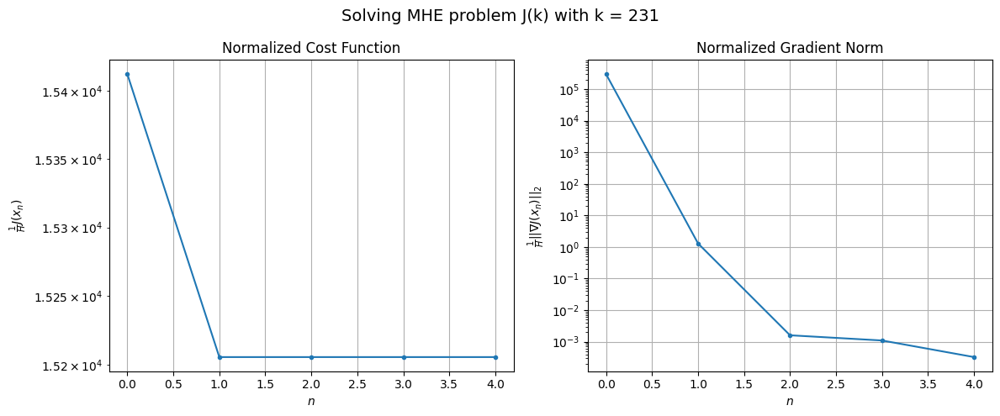

Windows:  54%|█████▍    | 193/356 [27:16<20:48,  7.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 576083.2680388669
Gradient norm: 11084231.096658016
Global estimation error: 58.861579507900096
Initial conditions estimation errors: 27.42188851144026 m, 27.222633761647515 m, 28.13765994708738 m, 34.34961288228749 m
Position estimation errors: 19.01644973357109 m, 20.783221915681786 m, 18.93381795872015 m, 32.41404445003545 m

[Gauss-Newton] Iteration 1
Cost function: 568814.4998395168 (-1.26%)
Gradient norm: 394.43283647573287 (-100.00%)
Global estimation error: 62.335296631259936 (5.90%)
Initial conditions estimation errors: 30.442563845981784 m, 28.054506132877723 m, 30.99244881463247 m, 34.804064518047 m
Position estimation errors: 16.532584073115935 m, 16.07204482709095 m, 16.961484459656408 m, 23.754777945318725 m

[Gauss-Newton] Iteration 2
Cost function: 568814.4997197702 (-0.00%)
Gradient norm: 0.08889302345184955 (-99.98%)
Global estimation error: 62.32697575760198 (-0.01%)
Initial conditions estimation errors: 30.

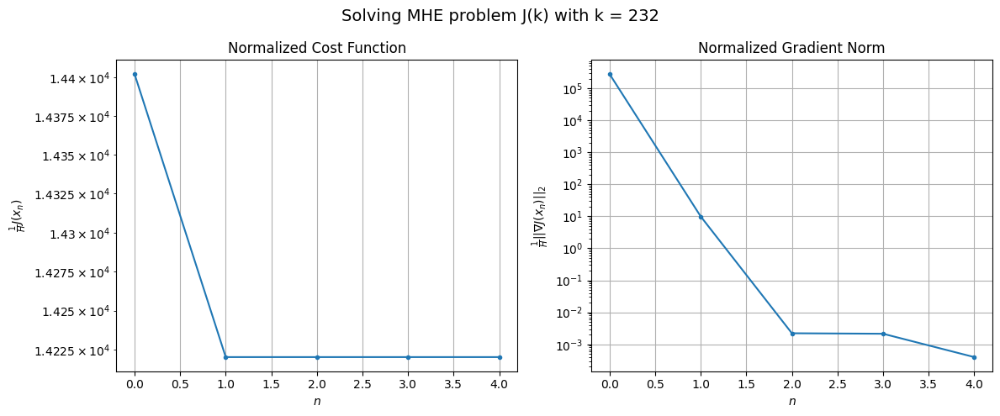

Windows:  54%|█████▍    | 194/356 [27:22<19:07,  7.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 542216.9372719862
Gradient norm: 10760901.944420012
Global estimation error: 53.17656349635368
Initial conditions estimation errors: 26.055753403838555 m, 23.66077801595499 m, 26.536502015384755 m, 29.745542573142394 m
Position estimation errors: 19.74888827821713 m, 19.08162312974005 m, 20.219566817555144 m, 27.060414555041675 m

[Gauss-Newton] Iteration 1
Cost function: 535297.802113529 (-1.28%)
Gradient norm: 184.7815581789438 (-100.00%)
Global estimation error: 56.171690244513705 (5.63%)
Initial conditions estimation errors: 29.079479223555094 m, 25.799088539886874 m, 29.981006028944304 m, 27.297596195152817 m
Position estimation errors: 17.61144054381589 m, 15.902999891336568 m, 17.858385482679942 m, 17.85579145768768 m

[Gauss-Newton] Iteration 2
Cost function: 535297.8020161532 (-0.00%)
Gradient norm: 0.05286438901527655 (-99.97%)
Global estimation error: 56.20016564756986 (0.05%)
Initial conditions estimation errors: 2

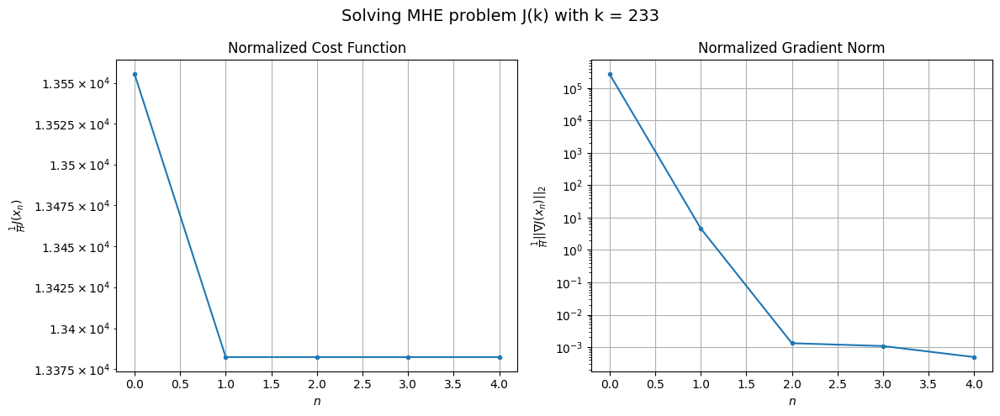

Windows:  55%|█████▍    | 195/356 [27:28<17:55,  6.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 515893.2572234728
Gradient norm: 10474755.297713343
Global estimation error: 47.356087512957615
Initial conditions estimation errors: 24.64735627899557 m, 21.575191891620804 m, 25.40735081242523 m, 22.892254472935033 m
Position estimation errors: 21.260848360705637 m, 19.16939850841186 m, 21.532146471163248 m, 21.206091637230255 m

[Gauss-Newton] Iteration 1
Cost function: 509134.64299548254 (-1.31%)
Gradient norm: 90.41197104433633 (-100.00%)
Global estimation error: 53.1413220737023 (12.22%)
Initial conditions estimation errors: 27.716839275346477 m, 25.083618535742048 m, 28.645527943106046 m, 24.616880983992733 m
Position estimation errors: 19.333082996788242 m, 17.851735536112056 m, 19.191023803183803 m, 20.29139401359549 m

[Gauss-Newton] Iteration 2
Cost function: 509134.64295952197 (-0.00%)
Gradient norm: 0.0357651752937177 (-99.96%)
Global estimation error: 53.14635497685712 (0.01%)
Initial conditions estimation errors

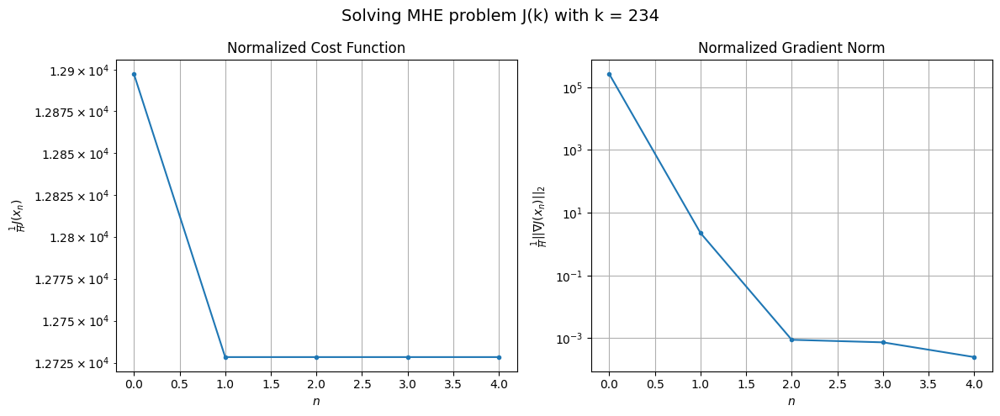

Windows:  55%|█████▌    | 196/356 [27:33<16:51,  6.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 497469.25700393325
Gradient norm: 10124290.668716155
Global estimation error: 44.55166823733563
Initial conditions estimation errors: 23.28474994294205 m, 20.92857508510808 m, 24.093032726049135 m, 20.595191767667615 m
Position estimation errors: 23.281857086795274 m, 21.38249031146609 m, 23.191943619075857 m, 23.521753106067667 m

[Gauss-Newton] Iteration 1
Cost function: 490665.4446622102 (-1.37%)
Gradient norm: 25.899207208650566 (-100.00%)
Global estimation error: 51.149201252238356 (14.81%)
Initial conditions estimation errors: 26.46081323947 m, 23.60091338442929 m, 28.004540401713825 m, 23.974496529920675 m
Position estimation errors: 21.428014884180936 m, 17.82774048511137 m, 21.44881508226661 m, 18.54600085573435 m

[Gauss-Newton] Iteration 2
Cost function: 490665.4446596015 (-0.00%)
Gradient norm: 0.05436318768390554 (-99.79%)
Global estimation error: 51.14877326748258 (-0.00%)
Initial conditions estimation errors: 26

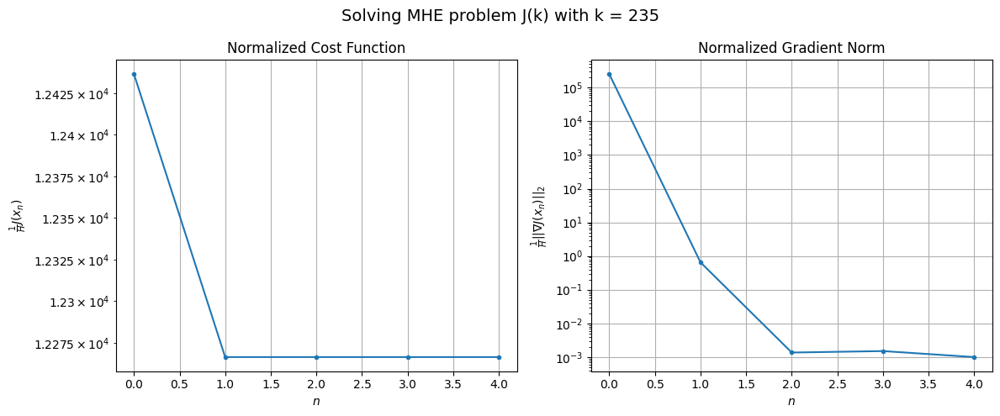

Windows:  55%|█████▌    | 197/356 [27:39<16:10,  6.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 488029.3439339031
Gradient norm: 9856842.327123756
Global estimation error: 43.36856613467165
Initial conditions estimation errors: 22.108224233570557 m, 20.06629502350631 m, 23.40244756412199 m, 21.016615910422406 m
Position estimation errors: 25.577708439122453 m, 21.45850073539993 m, 25.670233678192492 m, 21.847941237223914 m

[Gauss-Newton] Iteration 1
Cost function: 480994.1749429733 (-1.44%)
Gradient norm: 18.484989123682915 (-100.00%)
Global estimation error: 50.33732749271689 (16.07%)
Initial conditions estimation errors: 25.42722173110855 m, 24.080716828120647 m, 26.591658585720957 m, 24.500469913097987 m
Position estimation errors: 23.65673425151768 m, 20.632585890967228 m, 23.69709476517589 m, 20.990115687167055 m

[Gauss-Newton] Iteration 2
Cost function: 480994.1749503166 (0.00%)
Gradient norm: 0.04586355838237484 (-99.75%)
Global estimation error: 50.336787565798375 (-0.00%)
Initial conditions estimation errors: 

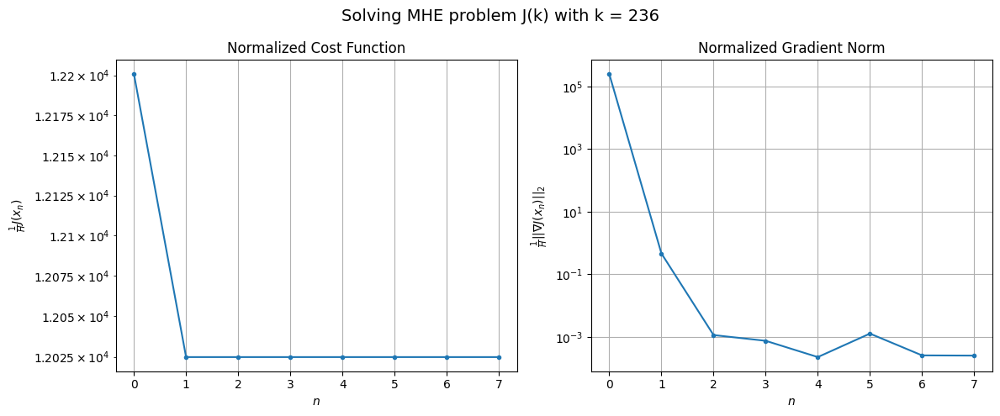

Windows:  56%|█████▌    | 198/356 [27:47<17:52,  6.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 487747.2359867688
Gradient norm: 9937317.95321179
Global estimation error: 42.968953214703504
Initial conditions estimation errors: 21.22213410112098 m, 20.687694343832323 m, 22.113422225308398 m, 21.884629602299743 m
Position estimation errors: 27.917810287141485 m, 24.40765744763821 m, 28.00208747566147 m, 24.404346471052854 m

[Gauss-Newton] Iteration 1
Cost function: 480007.5006161659 (-1.59%)
Gradient norm: 18.592046340357015 (-100.00%)
Global estimation error: 49.724868262977914 (15.72%)
Initial conditions estimation errors: 24.78210801818991 m, 24.465291230189436 m, 25.12780101795922 m, 25.068297312637906 m
Position estimation errors: 25.799564514266198 m, 23.097230028125683 m, 25.87783874160034 m, 23.713612299916146 m

[Gauss-Newton] Iteration 2
Cost function: 480007.500617744 (0.00%)
Gradient norm: 0.08738343910418385 (-99.53%)
Global estimation error: 49.72534770793947 (0.00%)
Initial conditions estimation errors: 24

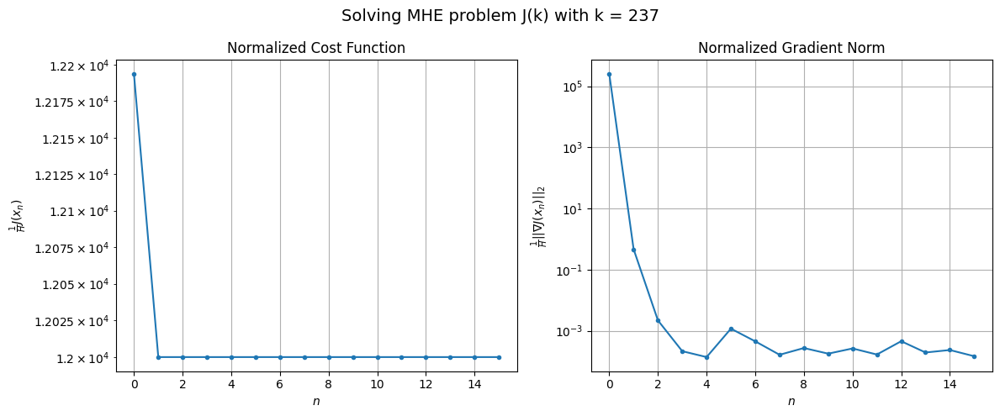

Windows:  56%|█████▌    | 199/356 [28:04<25:31,  9.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 494524.7787373025
Gradient norm: 9829235.759222826
Global estimation error: 42.537237370414225
Initial conditions estimation errors: 20.72413670808276 m, 21.18909633873391 m, 20.861812468377185 m, 22.264356145393453 m
Position estimation errors: 30.078942719414915 m, 26.99346496860297 m, 30.16434503121024 m, 27.353654824702296 m

[Gauss-Newton] Iteration 1
Cost function: 486062.51230392634 (-1.71%)
Gradient norm: 21.84688830042105 (-100.00%)
Global estimation error: 50.05969522186843 (17.68%)
Initial conditions estimation errors: 24.515037691732502 m, 25.17060024961243 m, 24.436863578421924 m, 25.965976378206364 m
Position estimation errors: 27.737634350334663 m, 24.674861895388055 m, 27.6511311604071 m, 23.99704588669896 m

[Gauss-Newton] Iteration 2
Cost function: 486062.51230001944 (-0.00%)
Gradient norm: 0.037522457594929795 (-99.83%)
Global estimation error: 50.05933171789658 (-0.00%)
Initial conditions estimation errors:

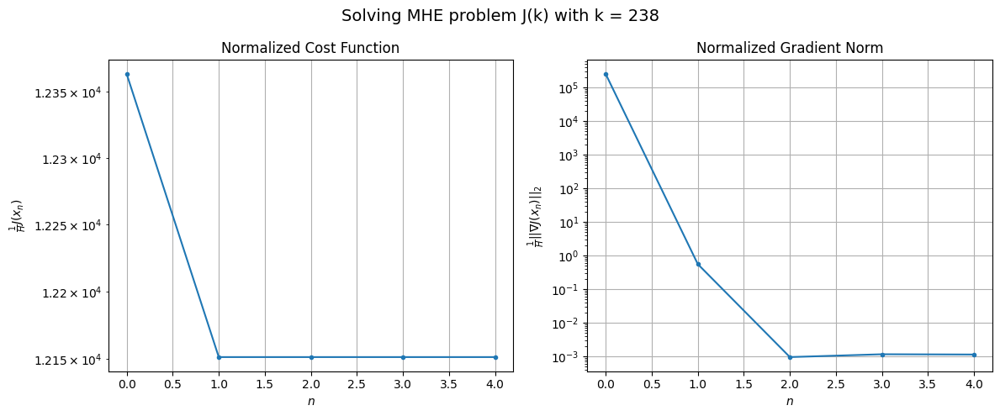

Windows:  56%|█████▌    | 200/356 [28:09<21:58,  8.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 506787.6886077109
Gradient norm: 9688262.652103527
Global estimation error: 43.20505149462779
Initial conditions estimation errors: 20.591123606332776 m, 22.031543985570092 m, 20.404474012508206 m, 23.257626711705065 m
Position estimation errors: 31.97351576976089 m, 28.583509574088446 m, 31.863024169972665 m, 27.78715867214024 m

[Gauss-Newton] Iteration 1
Cost function: 497466.97214562364 (-1.84%)
Gradient norm: 163.74171943633104 (-100.00%)
Global estimation error: 52.174083511402365 (20.76%)
Initial conditions estimation errors: 24.62378917420537 m, 25.971675150224968 m, 24.506807365806225 m, 28.994054305128863 m
Position estimation errors: 29.404709042124626 m, 27.003358069078146 m, 29.964347166247148 m, 25.68283167284297 m

[Gauss-Newton] Iteration 2
Cost function: 497466.97204492375 (-0.00%)
Gradient norm: 0.03782035026427707 (-99.98%)
Global estimation error: 52.17188945022661 (-0.00%)
Initial conditions estimation err

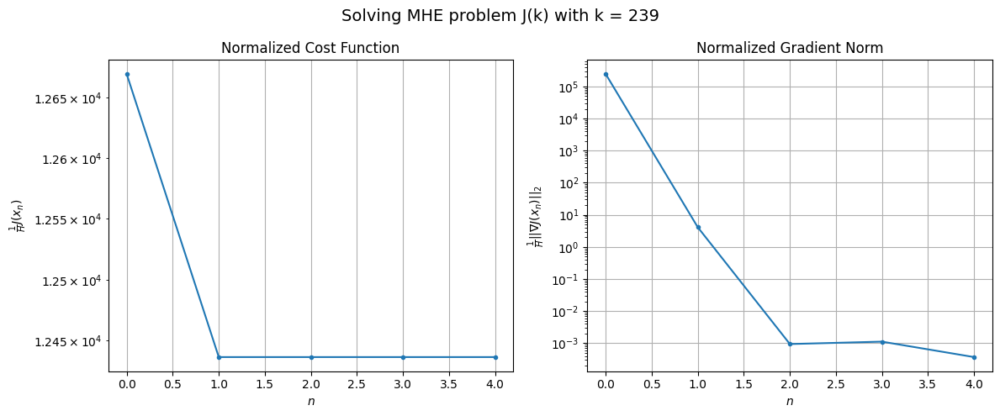

Windows:  56%|█████▋    | 201/356 [28:15<19:42,  7.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 523603.62823797174
Gradient norm: 9535245.787763001
Global estimation error: 46.63806871353656
Initial conditions estimation errors: 20.886692798572266 m, 23.343851221083096 m, 20.3597539328034 m, 27.917131888626262 m
Position estimation errors: 33.58899144376919 m, 30.692845479312567 m, 34.19474121974923 m, 28.791813779116133 m

[Gauss-Newton] Iteration 1
Cost function: 513413.64382142085 (-1.95%)
Gradient norm: 89.95538058394006 (-100.00%)
Global estimation error: 56.58090102184268 (21.32%)
Initial conditions estimation errors: 25.094668262736523 m, 27.999221587657647 m, 24.359002742212798 m, 34.55866986006142 m
Position estimation errors: 30.774238262110565 m, 26.887126859727772 m, 31.2704945771686 m, 20.6231701403589 m

[Gauss-Newton] Iteration 2
Cost function: 513413.64382566157 (0.00%)
Gradient norm: 0.03321873360204275 (-99.96%)
Global estimation error: 56.57703896788839 (-0.01%)
Initial conditions estimation errors: 25

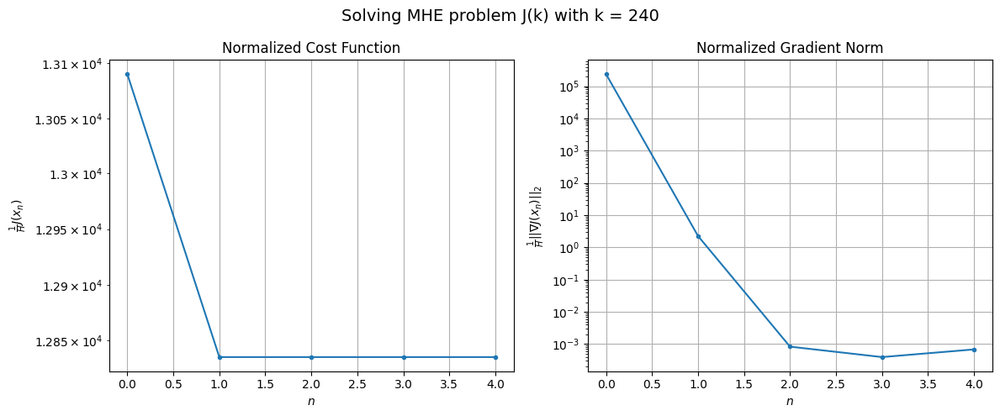

Windows:  57%|█████▋    | 202/356 [28:21<17:57,  7.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 543233.5629224862
Gradient norm: 9620779.376477646
Global estimation error: 51.9729265530019
Initial conditions estimation errors: 21.666170162200867 m, 25.72139083755789 m, 20.626897096743473 m, 33.83299429701294 m
Position estimation errors: 34.93758900196596 m, 30.615491370682296 m, 35.4666170182758 m, 23.8175509463739 m

[Gauss-Newton] Iteration 1
Cost function: 531895.0669755394 (-2.09%)
Gradient norm: 56.861092333115394 (-100.00%)
Global estimation error: 63.77318736363684 (22.70%)
Initial conditions estimation errors: 26.0614202341938 m, 31.29058321489446 m, 25.005993039058318 m, 42.23015456388386 m
Position estimation errors: 31.86315154422534 m, 26.468303235628284 m, 32.90566750123517 m, 18.728601607125785 m

[Gauss-Newton] Iteration 2
Cost function: 531895.0669418734 (-0.00%)
Gradient norm: 0.1059182945520882 (-99.81%)
Global estimation error: 63.77436305329881 (0.00%)
Initial conditions estimation errors: 26.0614192

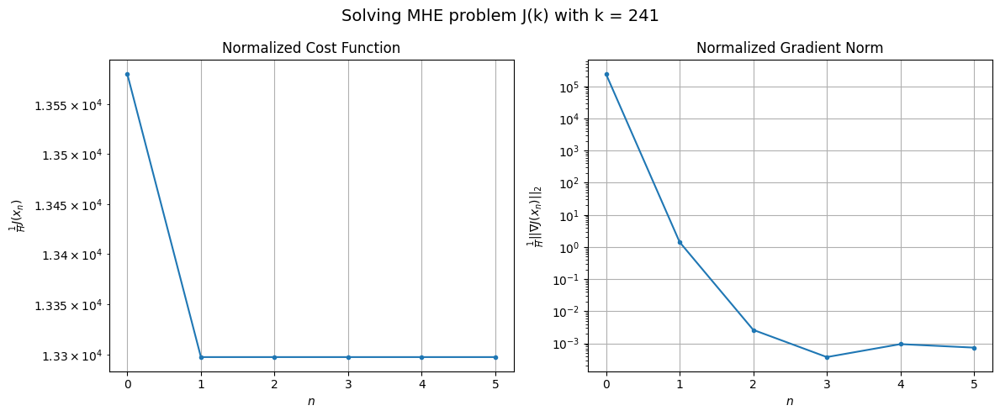

Windows:  57%|█████▋    | 203/356 [28:27<17:40,  6.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 562678.0293293496
Gradient norm: 9410565.605652248
Global estimation error: 60.26542693490131
Initial conditions estimation errors: 22.99283607560965 m, 29.477758099630464 m, 21.406258558800662 m, 42.14327562672401 m
Position estimation errors: 36.045495125017155 m, 30.124207769052465 m, 37.17367070158541 m, 21.51155940505083 m

[Gauss-Newton] Iteration 1
Cost function: 550432.4887972848 (-2.18%)
Gradient norm: 65.09013948952109 (-100.00%)
Global estimation error: 62.962929961702706 (4.48%)
Initial conditions estimation errors: 27.480117185692013 m, 32.061075259261074 m, 26.428988244391924 m, 38.50632734471378 m
Position estimation errors: 32.754388304147064 m, 28.661266165686325 m, 33.44739079936765 m, 23.965670633735424 m

[Gauss-Newton] Iteration 2
Cost function: 550432.4887450316 (-0.00%)
Gradient norm: 0.020167926481845982 (-99.97%)
Global estimation error: 62.95991482033602 (-0.00%)
Initial conditions estimation errors: 

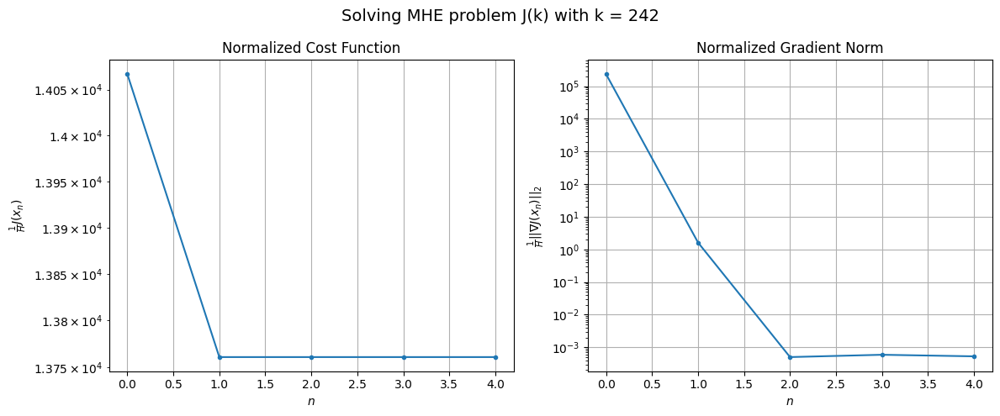

Windows:  57%|█████▋    | 204/356 [28:34<17:02,  6.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 581894.5508251011
Gradient norm: 9085767.74341605
Global estimation error: 58.94860384031425
Initial conditions estimation errors: 24.696996196777217 m, 30.1447726854552 m, 23.361875668206352 m, 37.55642113490955 m
Position estimation errors: 36.99782093936125 m, 32.471838086248816 m, 37.73999108229359 m, 27.259191880081808 m

[Gauss-Newton] Iteration 1
Cost function: 568601.6008965282 (-2.28%)
Gradient norm: 74.32684138689739 (-100.00%)
Global estimation error: 72.60457775386156 (23.17%)
Initial conditions estimation errors: 29.2659906418563 m, 36.497108339016606 m, 27.98725137223657 m, 47.953840004966644 m
Position estimation errors: 33.4823967125518 m, 27.76507986423285 m, 34.49491503325045 m, 21.129050225182986 m

[Gauss-Newton] Iteration 2
Cost function: 568601.6008593064 (-0.00%)
Gradient norm: 0.08380663933537105 (-99.89%)
Global estimation error: 72.60159202974685 (-0.00%)
Initial conditions estimation errors: 29.26598

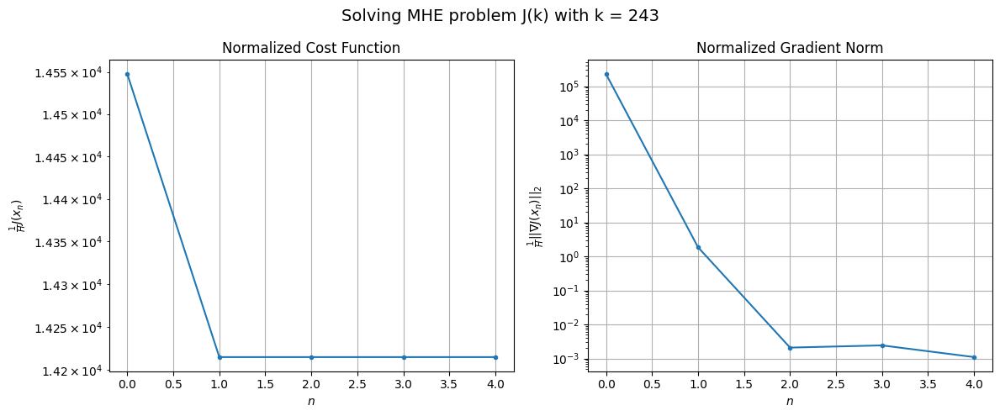

Windows:  58%|█████▊    | 205/356 [28:40<16:47,  6.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 596761.1986029353
Gradient norm: 8855256.629202958
Global estimation error: 69.1247760143025
Initial conditions estimation errors: 26.59366366972483 m, 34.652105359712095 m, 24.932503593416367 m, 47.41926871326466 m
Position estimation errors: 37.825805484254694 m, 31.613584506203576 m, 38.92468550528769 m, 24.01484831056837 m

[Gauss-Newton] Iteration 1
Cost function: 582334.8845447183 (-2.42%)
Gradient norm: 124.35449448689032 (-100.00%)
Global estimation error: 70.53389323731471 (2.04%)
Initial conditions estimation errors: 31.255774830854033 m, 37.342355297178194 m, 30.566982376269973 m, 40.85688394815075 m
Position estimation errors: 34.11188353671084 m, 29.434563936289294 m, 34.530421635987 m, 29.008270268315727 m

[Gauss-Newton] Iteration 2
Cost function: 582334.8843994627 (-0.00%)
Gradient norm: 0.05295868237732423 (-99.96%)
Global estimation error: 70.51685957443539 (-0.02%)
Initial conditions estimation errors: 31.25

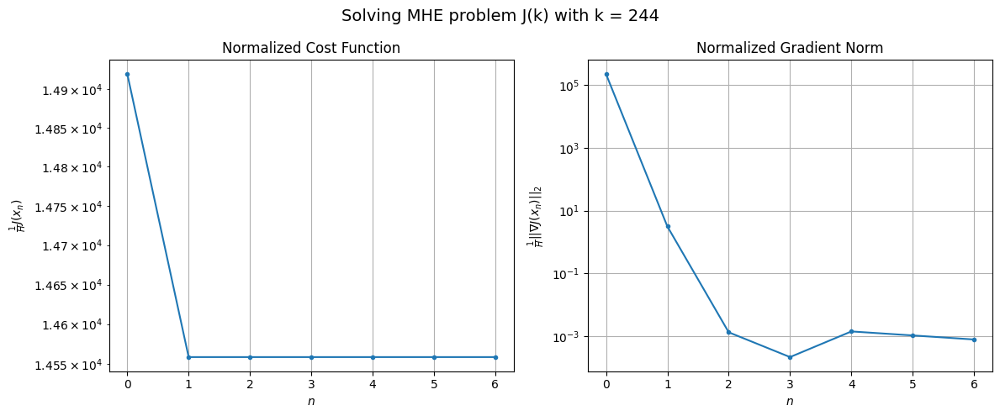

Windows:  58%|█████▊    | 206/356 [28:47<17:01,  6.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 607961.2058019122
Gradient norm: 8346058.512918833
Global estimation error: 65.96345478163977
Initial conditions estimation errors: 28.48829184277136 m, 35.06587058970842 m, 27.61782912883303 m, 39.33455642506957 m
Position estimation errors: 38.580526431411386 m, 33.528644438579256 m, 39.03912851434112 m, 32.59328823471028 m

[Gauss-Newton] Iteration 1
Cost function: 592524.7036666648 (-2.54%)
Gradient norm: 45.148264061723815 (-100.00%)
Global estimation error: 78.68456504563704 (19.29%)
Initial conditions estimation errors: 33.206093251842056 m, 40.30324571910024 m, 32.82357154249447 m, 48.85536257329909 m
Position estimation errors: 34.68877330763341 m, 29.11622498136274 m, 34.9828641828435 m, 23.9022900930695 m

[Gauss-Newton] Iteration 2
Cost function: 592524.7036803485 (0.00%)
Gradient norm: 0.05767233115653878 (-99.87%)
Global estimation error: 78.68995609398267 (0.01%)
Initial conditions estimation errors: 33.20609057

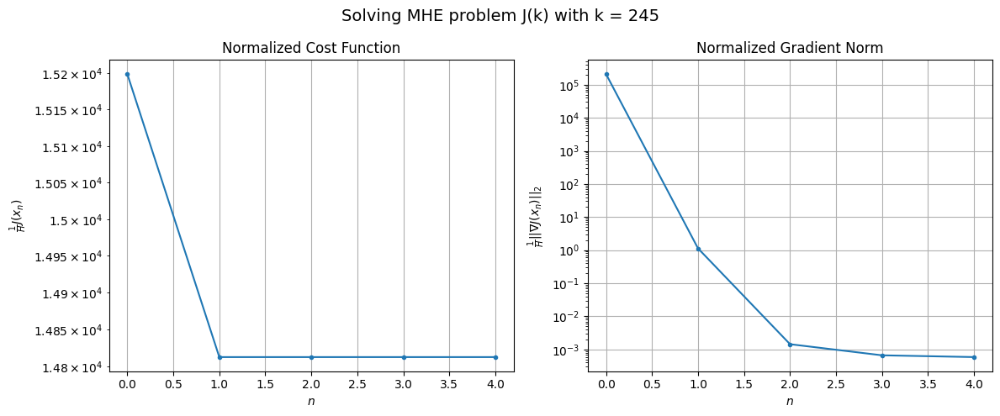

Windows:  58%|█████▊    | 207/356 [28:53<16:14,  6.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 614574.3131523771
Gradient norm: 7882398.604905163
Global estimation error: 73.5144525271247
Initial conditions estimation errors: 30.18215175311194 m, 37.684407071072705 m, 29.603877949412066 m, 46.87086857088601 m
Position estimation errors: 39.285451636027105 m, 33.34009902652309 m, 39.63016386080167 m, 27.506118321716354 m

[Gauss-Newton] Iteration 1
Cost function: 598061.0577412449 (-2.69%)
Gradient norm: 74.78380437429094 (-100.00%)
Global estimation error: 82.25511832983773 (11.89%)
Initial conditions estimation errors: 34.954710426175815 m, 42.99382200294299 m, 33.33820819185481 m, 50.834390649036315 m
Position estimation errors: 35.214878305350965 m, 28.691334925376538 m, 36.252936039603085 m, 26.45365131301178 m

[Gauss-Newton] Iteration 2
Cost function: 598061.0577344598 (-0.00%)
Gradient norm: 0.05973177676490539 (-99.92%)
Global estimation error: 82.25958578809653 (0.01%)
Initial conditions estimation errors: 34.9

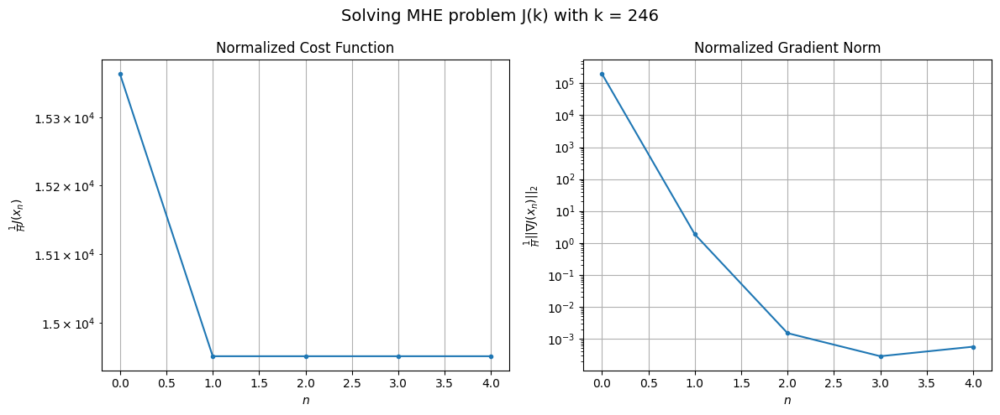

Windows:  58%|█████▊    | 208/356 [28:59<15:38,  6.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 616140.1334824743
Gradient norm: 7191737.413628436
Global estimation error: 76.68126283033655
Initial conditions estimation errors: 31.57928037722593 m, 40.1163573596672 m, 29.79564239087313 m, 48.8429264725212 m
Position estimation errors: 39.91569958635922 m, 32.955912774255545 m, 41.043490929889714 m, 29.892363816298182 m

[Gauss-Newton] Iteration 1
Cost function: 598871.3517363273 (-2.80%)
Gradient norm: 28.05282964835447 (-100.00%)
Global estimation error: 85.32610996860073 (11.27%)
Initial conditions estimation errors: 36.36021090531715 m, 45.638566205739494 m, 34.66020154290097 m, 51.71302851885587 m
Position estimation errors: 35.70959628452943 m, 27.154804363601674 m, 36.694941311238864 m, 25.599731158184095 m

[Gauss-Newton] Iteration 2
Cost function: 598871.3517297405 (-0.00%)
Gradient norm: 0.03712582673004088 (-99.87%)
Global estimation error: 85.31371767269815 (-0.01%)
Initial conditions estimation errors: 36.360

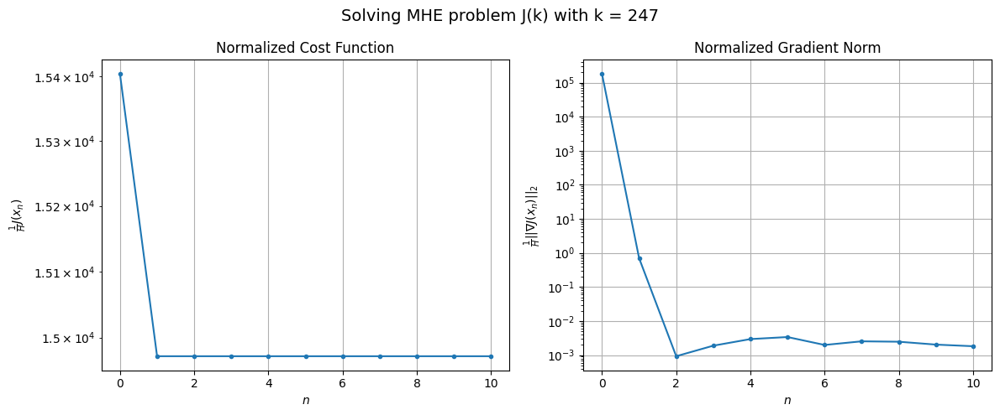

Windows:  59%|█████▊    | 209/356 [29:10<19:06,  7.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 614069.9277405404
Gradient norm: 6668886.7872084025
Global estimation error: 78.70512548024656
Initial conditions estimation errors: 32.61489407593819 m, 42.24847776893321 m, 30.86282915381977 m, 48.92121141692471 m
Position estimation errors: 40.475848268582304 m, 31.527626348447036 m, 41.5389868457503 m, 29.341350939565864 m

[Gauss-Newton] Iteration 1
Cost function: 596076.892463319 (-2.93%)
Gradient norm: 487.8529526298426 (-99.99%)
Global estimation error: 79.43136954017926 (0.92%)
Initial conditions estimation errors: 37.398951735526275 m, 44.19016990068884 m, 37.15979079778915 m, 39.71149108492482 m
Position estimation errors: 36.13564908751049 m, 28.153553828704325 m, 35.86472625524186 m, 28.330025996480515 m

[Gauss-Newton] Iteration 2
Cost function: 596076.8910002826 (-0.00%)
Gradient norm: 0.053830262192048985 (-99.99%)
Global estimation error: 79.41985238018083 (-0.01%)
Initial conditions estimation errors: 37.3989

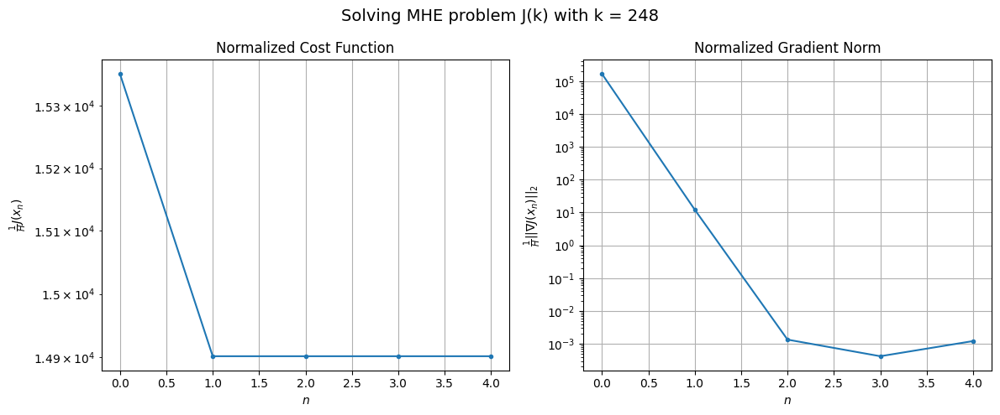

Windows:  59%|█████▉    | 210/356 [29:16<17:18,  7.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 609104.2302150675
Gradient norm: 5842274.604008468
Global estimation error: 71.00064505247236
Initial conditions estimation errors: 33.314139065973265 m, 40.07135452940989 m, 33.251409195610485 m, 34.92642850496989 m
Position estimation errors: 40.9235606559911 m, 32.853634142489064 m, 40.635360361497405 m, 33.59296359082273 m

[Gauss-Newton] Iteration 1
Cost function: 590659.2223028489 (-3.03%)
Gradient norm: 153.76441991100768 (-100.00%)
Global estimation error: 86.60721945491156 (21.98%)
Initial conditions estimation errors: 38.07923157695272 m, 45.97690666139984 m, 36.92691634585655 m, 50.72744035866988 m
Position estimation errors: 36.48793921861203 m, 28.715626864927618 m, 37.22694394976058 m, 23.97006555961167 m

[Gauss-Newton] Iteration 2
Cost function: 590659.2220783223 (-0.00%)
Gradient norm: 0.046727806327340526 (-99.97%)
Global estimation error: 86.61111796083941 (0.00%)
Initial conditions estimation errors: 38.079

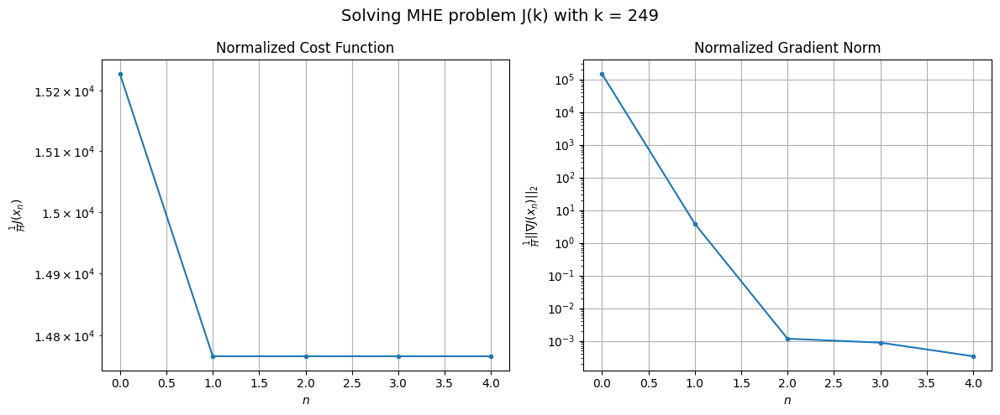

Windows:  59%|█████▉    | 211/356 [29:22<16:20,  6.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 602852.0968374517
Gradient norm: 4873358.123299117
Global estimation error: 77.99187199121923
Initial conditions estimation errors: 33.70541411873032 m, 41.68677340798622 m, 32.6185019830456 m, 46.312957613365754 m
Position estimation errors: 41.260205269422435 m, 33.2496041591083 m, 42.045381076194296 m, 28.41288605217759 m

[Gauss-Newton] Iteration 1
Cost function: 584207.7939143887 (-3.09%)
Gradient norm: 33.416032313527225 (-100.00%)
Global estimation error: 85.84180326446621 (10.07%)
Initial conditions estimation errors: 38.43118026247354 m, 45.90312835569284 m, 36.801483121661455 m, 49.29886759199434 m
Position estimation errors: 36.76280095486262 m, 29.287874852377247 m, 38.007139278805084 m, 26.659651340005787 m

[Gauss-Newton] Iteration 2
Cost function: 584207.7939196217 (0.00%)
Gradient norm: 0.021874171682208735 (-99.93%)
Global estimation error: 85.85769578702902 (0.02%)
Initial conditions estimation errors: 38.431

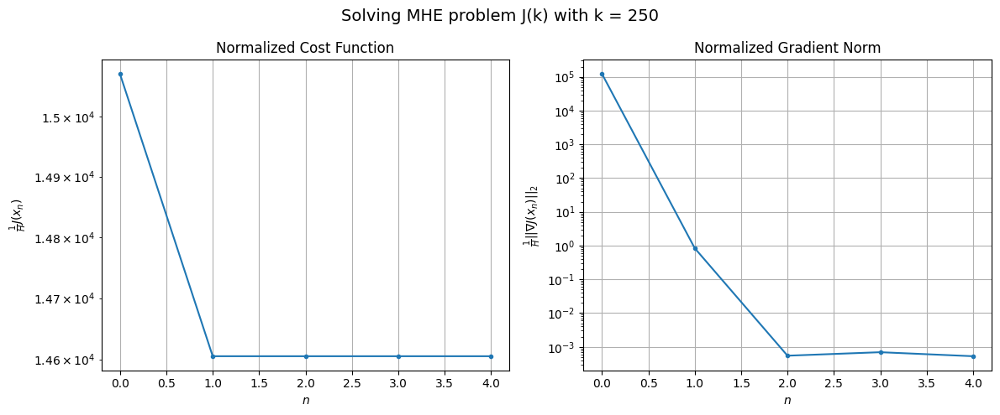

Windows:  60%|█████▉    | 212/356 [29:27<15:18,  6.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 597520.5153661334
Gradient norm: 4084965.3322451357
Global estimation error: 76.84187029691608
Initial conditions estimation errors: 33.824139812521594 m, 41.38011392487718 m, 32.28894848245628 m, 44.78480096807941 m
Position estimation errors: 41.491775170681265 m, 33.800730824215705 m, 42.78503534705203 m, 31.03455960202656 m

[Gauss-Newton] Iteration 1
Cost function: 578714.3330556375 (-3.15%)
Gradient norm: 104.9131450934632 (-100.00%)
Global estimation error: 82.94034164022051 (7.94%)
Initial conditions estimation errors: 38.5199964136622 m, 43.542635314390296 m, 38.155540750688196 m, 45.20473573522555 m
Position estimation errors: 36.94759910262924 m, 31.32036088794317 m, 37.15290510968278 m, 25.99827978492842 m

[Gauss-Newton] Iteration 2
Cost function: 578714.3330202342 (-0.00%)
Gradient norm: 0.034729209989322544 (-99.97%)
Global estimation error: 82.91999756444403 (-0.02%)
Initial conditions estimation errors: 38.519

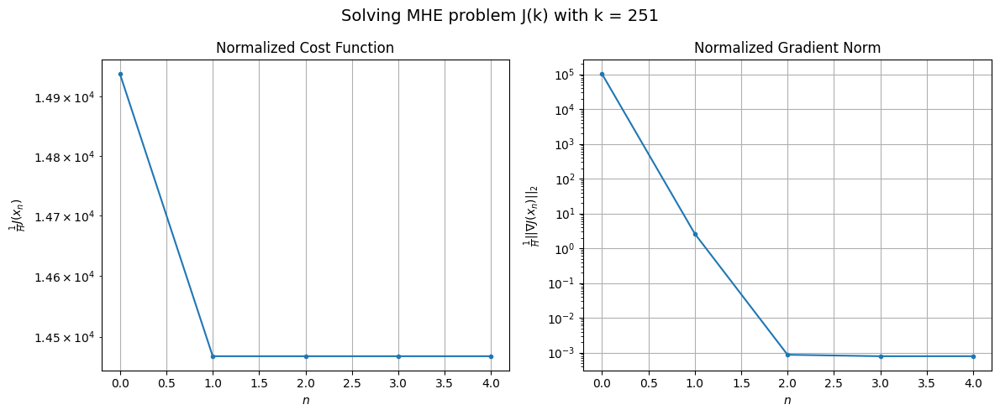

Windows:  60%|█████▉    | 213/356 [29:33<14:44,  6.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 590437.9368222096
Gradient norm: 3003094.8306076396
Global estimation error: 73.0270977842938
Initial conditions estimation errors: 33.73534653318164 m, 38.66289160140335 m, 33.446888888893184 m, 39.76602418632268 m
Position estimation errors: 41.614110811913626 m, 35.94498440624636 m, 41.81034531345063 m, 31.000167002915326 m

[Gauss-Newton] Iteration 1
Cost function: 571803.4281804994 (-3.16%)
Gradient norm: 441.527900902001 (-99.99%)
Global estimation error: 79.5782693556122 (8.97%)
Initial conditions estimation errors: 38.3761464935173 m, 43.14608749063807 m, 37.94617934989912 m, 39.47711534984971 m
Position estimation errors: 37.07486250838564 m, 32.309138284616935 m, 37.438102135982604 m, 37.23934043555782 m

[Gauss-Newton] Iteration 2
Cost function: 571803.4280615512 (-0.00%)
Gradient norm: 0.05637876813833429 (-99.99%)
Global estimation error: 79.58660579230799 (0.01%)
Initial conditions estimation errors: 38.376144807

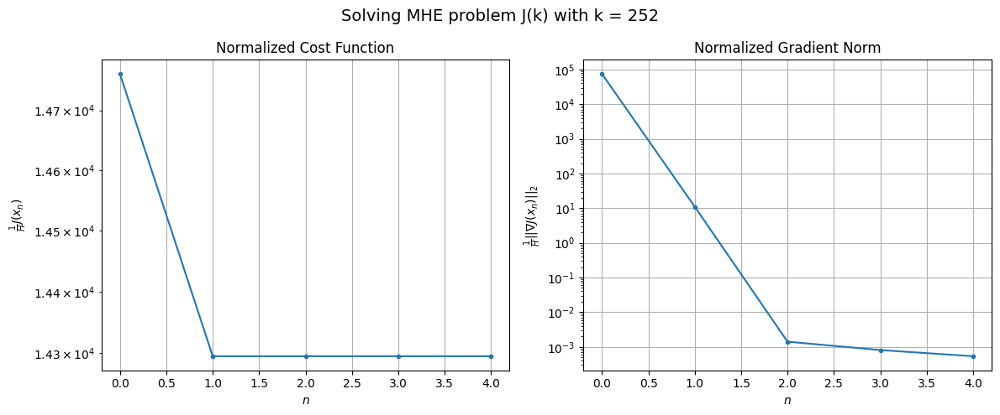

Windows:  60%|██████    | 214/356 [29:38<14:11,  5.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 584827.8565437532
Gradient norm: 2291378.532119439
Global estimation error: 69.91211761209004
Initial conditions estimation errors: 33.476254500422954 m, 38.211168158879715 m, 33.09634963788572 m, 34.80737159039186 m
Position estimation errors: 41.66544413455893 m, 36.82882945004489 m, 42.019508974652446 m, 41.64487177245706 m

[Gauss-Newton] Iteration 1
Cost function: 566241.3798938274 (-3.18%)
Gradient norm: 1214.8793823982405 (-99.95%)
Global estimation error: 69.30152088638008 (-0.87%)
Initial conditions estimation errors: 38.08136488366027 m, 37.861327800359405 m, 40.28860938103207 m, 17.199440796362257 m
Position estimation errors: 37.11688669568958 m, 33.91135077481492 m, 34.89600618642781 m, 42.178460029939224 m

[Gauss-Newton] Iteration 2
Cost function: 566241.3717485762 (-0.00%)
Gradient norm: 0.07564600841439169 (-99.99%)
Global estimation error: 69.29320564190421 (-0.01%)
Initial conditions estimation errors: 38.08

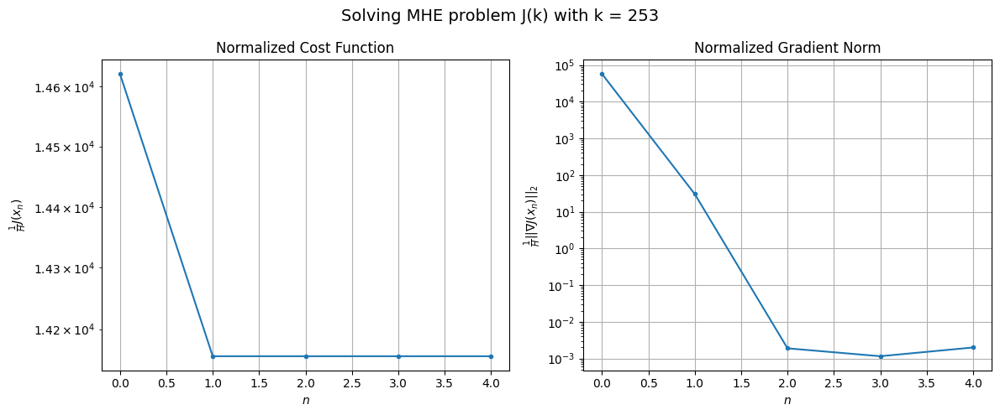

Windows:  60%|██████    | 215/356 [29:44<14:04,  5.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 578991.717502519
Gradient norm: 2583439.1241738508
Global estimation error: 59.322423853514394
Initial conditions estimation errors: 33.13235746662846 m, 32.50540707958876 m, 35.32715564617904 m, 10.805224384061876 m
Position estimation errors: 41.63235383159975 m, 38.861500704148284 m, 39.42119819370244 m, 48.677962454978825 m

[Gauss-Newton] Iteration 1
Cost function: 560629.7675461636 (-3.17%)
Gradient norm: 178.58925429780706 (-99.99%)
Global estimation error: 68.0336680411896 (14.68%)
Initial conditions estimation errors: 37.68242870412711 m, 35.675183467034515 m, 39.664493298083045 m, 19.041696613485982 m
Position estimation errors: 37.093179461814934 m, 35.45605213314176 m, 35.084530642095096 m, 37.37473155022492 m

[Gauss-Newton] Iteration 2
Cost function: 560629.7675075931 (-0.00%)
Gradient norm: 0.035088488104111595 (-99.98%)
Global estimation error: 68.02406499802346 (-0.01%)
Initial conditions estimation errors: 37

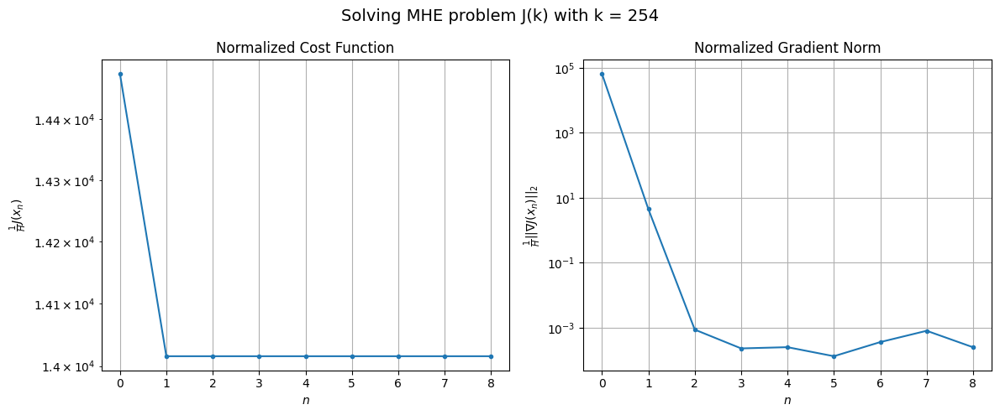

Windows:  61%|██████    | 216/356 [29:53<16:00,  6.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 575590.8440780997
Gradient norm: 3803478.846985186
Global estimation error: 57.88777314955295
Initial conditions estimation errors: 32.74924654517997 m, 30.35685359433672 m, 34.69984037337033 m, 12.362409110204956 m
Position estimation errors: 41.56660349543165 m, 40.39420628898414 m, 39.64688292564815 m, 44.06974442126448 m

[Gauss-Newton] Iteration 1
Cost function: 557642.8065981347 (-3.12%)
Gradient norm: 403.0993879077659 (-99.99%)
Global estimation error: 69.42011651824394 (19.92%)
Initial conditions estimation errors: 37.21837786816617 m, 36.82964983236198 m, 37.96743345565514 m, 25.218189537118818 m
Position estimation errors: 37.05639988159177 m, 33.03531333771207 m, 36.31228905009953 m, 27.71742374817729 m

[Gauss-Newton] Iteration 2
Cost function: 557642.8064971082 (-0.00%)
Gradient norm: 0.05342309792378855 (-99.99%)
Global estimation error: 69.41769202053591 (-0.00%)
Initial conditions estimation errors: 37.2183770

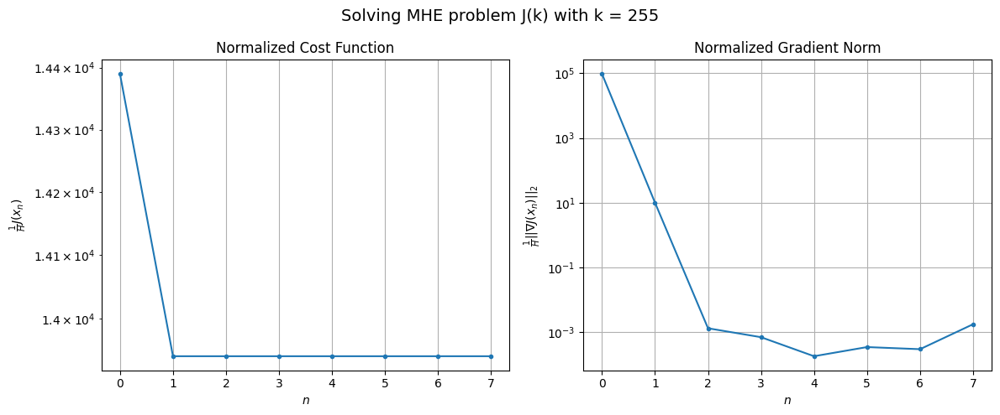

Windows:  61%|██████    | 217/356 [30:02<16:49,  7.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 575019.5176397054
Gradient norm: 5359581.434012512
Global estimation error: 58.77063276159511
Initial conditions estimation errors: 32.349225943236796 m, 31.43915589971837 m, 33.12137780092541 m, 17.9452758228488 m
Position estimation errors: 41.548603818319236 m, 38.11562877624275 m, 40.9339917406759 m, 34.59271891291839 m

[Gauss-Newton] Iteration 1
Cost function: 557215.7019900638 (-3.10%)
Gradient norm: 536.0109182080653 (-99.99%)
Global estimation error: 74.84786613132071 (27.36%)
Initial conditions estimation errors: 36.761784330150824 m, 38.16289128051074 m, 36.27935057668922 m, 38.446651265147494 m
Position estimation errors: 37.01746755787593 m, 33.69300183932832 m, 37.55534778050342 m, 25.744719101321714 m

[Gauss-Newton] Iteration 2
Cost function: 557215.7002574715 (-0.00%)
Gradient norm: 0.02950244654088778 (-99.99%)
Global estimation error: 74.83982526668377 (-0.01%)
Initial conditions estimation errors: 36.761783

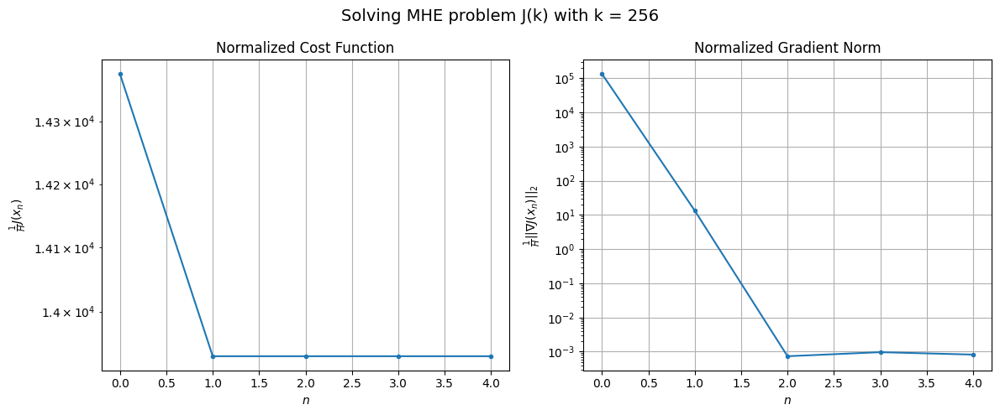

Windows:  61%|██████    | 218/356 [30:08<15:48,  6.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 574958.4945200008
Gradient norm: 7126591.599040076
Global estimation error: 64.47497323113065
Initial conditions estimation errors: 31.982341734605907 m, 33.11643754817151 m, 31.556307687247052 m, 32.27419212517184 m
Position estimation errors: 41.57879848740301 m, 38.48998127688259 m, 42.16227515250011 m, 31.377894844941753 m

[Gauss-Newton] Iteration 1
Cost function: 557342.0825896768 (-3.06%)
Gradient norm: 735.8736216066646 (-99.99%)
Global estimation error: 71.06745714245446 (10.22%)
Initial conditions estimation errors: 36.325847958499615 m, 37.066521981069506 m, 37.18139583575215 m, 31.218682228192595 m
Position estimation errors: 37.016140992116256 m, 35.64589189595381 m, 36.23053442352916 m, 39.17040100928743 m

[Gauss-Newton] Iteration 2
Cost function: 557342.0822168508 (-0.00%)
Gradient norm: 0.06910318615299875 (-99.99%)
Global estimation error: 71.06751684365352 (0.00%)
Initial conditions estimation errors: 36.325

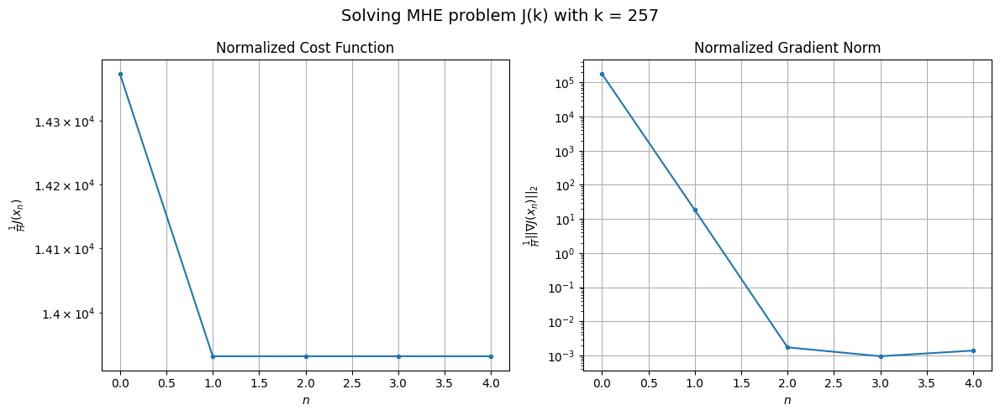

Windows:  62%|██████▏   | 219/356 [30:13<15:00,  6.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 577211.8843572239
Gradient norm: 8681352.033213718
Global estimation error: 61.55585565070101
Initial conditions estimation errors: 31.63817945118861 m, 32.272599472780435 m, 32.46384250516341 m, 26.319236066691495 m
Position estimation errors: 41.643933548862016 m, 40.38021006862758 m, 40.93537225744024 m, 44.008267300753005 m

[Gauss-Newton] Iteration 1
Cost function: 559654.4849230681 (-3.04%)
Gradient norm: 178.29464915819864 (-100.00%)
Global estimation error: 73.73652324476376 (19.79%)
Initial conditions estimation errors: 35.92206762835872 m, 38.43260376532749 m, 35.709800804326264 m, 37.34163649181056 m
Position estimation errors: 37.018039686443494 m, 33.676383124416645 m, 37.36395028230894 m, 31.43379889257378 m

[Gauss-Newton] Iteration 2
Cost function: 559654.4849058725 (-0.00%)
Gradient norm: 0.017600539146154514 (-99.99%)
Global estimation error: 73.74136656993325 (0.01%)
Initial conditions estimation errors: 35.

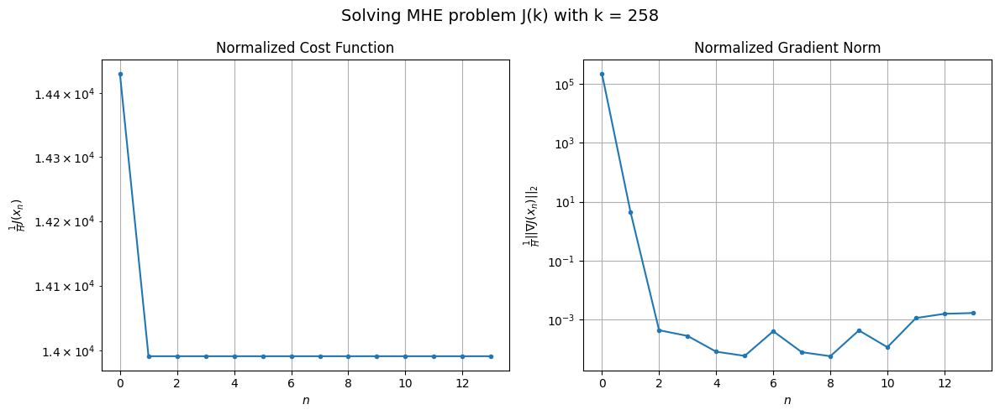

Windows:  62%|██████▏   | 220/356 [30:27<19:32,  8.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 581805.9143061582
Gradient norm: 10315060.088688288
Global estimation error: 64.13855213499187
Initial conditions estimation errors: 31.31474607871244 m, 33.63881782499514 m, 31.14096546716957 m, 32.12141426531517 m
Position estimation errors: 41.65502059461802 m, 38.49152138646348 m, 42.009702101395135 m, 36.50949329480759 m

[Gauss-Newton] Iteration 1
Cost function: 564310.5925717795 (-3.01%)
Gradient norm: 340.4154971377505 (-100.00%)
Global estimation error: 75.37453142791286 (17.52%)
Initial conditions estimation errors: 35.5260272331309 m, 39.06651584587939 m, 36.2912483941104 m, 39.6982413680395 m
Position estimation errors: 36.94364228936183 m, 34.35924854649996 m, 36.113222606470295 m, 36.178428386014716 m

[Gauss-Newton] Iteration 2
Cost function: 564310.5923950422 (-0.00%)
Gradient norm: 0.1505870576463339 (-99.96%)
Global estimation error: 75.37829255308371 (0.00%)
Initial conditions estimation errors: 35.526027485

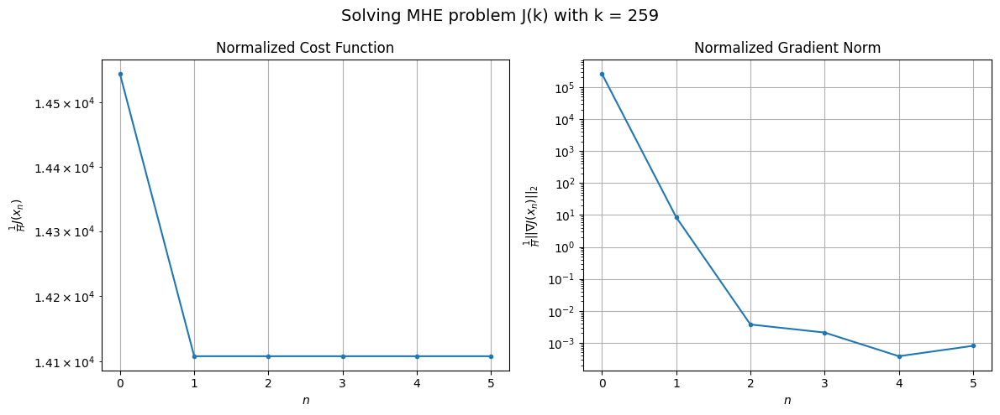

Windows:  62%|██████▏   | 221/356 [30:33<18:03,  8.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 587399.4491072223
Gradient norm: 11488312.533552855
Global estimation error: 66.46514369047614
Initial conditions estimation errors: 30.990415668691476 m, 34.530029550004116 m, 31.712842020891337 m, 35.48464624012516 m
Position estimation errors: 41.49526928454855 m, 38.84293470190758 m, 40.59348316077585 m, 40.434581435225475 m

[Gauss-Newton] Iteration 1
Cost function: 569928.0885296256 (-2.97%)
Gradient norm: 471.60362590001927 (-100.00%)
Global estimation error: 74.9622723294689 (12.78%)
Initial conditions estimation errors: 35.14499763287937 m, 37.802252411940046 m, 36.77452197672361 m, 40.03467382885782 m
Position estimation errors: 36.692757729666596 m, 35.816122509745945 m, 34.709028886590616 m, 42.887134155980036 m

[Gauss-Newton] Iteration 2
Cost function: 569928.0883051518 (-0.00%)
Gradient norm: 0.028312581677932276 (-99.99%)
Global estimation error: 74.96210007519588 (-0.00%)
Initial conditions estimation errors: 

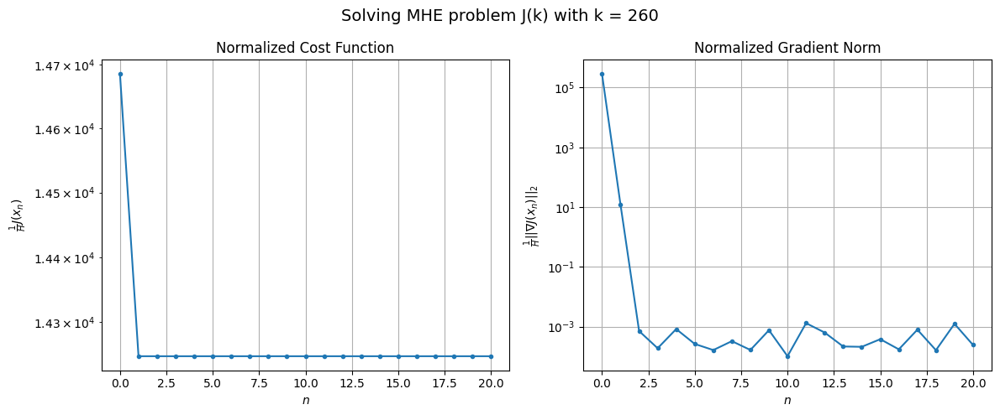

Windows:  62%|██████▏   | 222/356 [30:53<25:52, 11.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 592069.0625993777
Gradient norm: 12352402.404923161
Global estimation error: 66.77741277851047
Initial conditions estimation errors: 30.684727393611407 m, 33.495208487884916 m, 32.209012317648025 m, 36.8551477059525 m
Position estimation errors: 41.063806518202284 m, 39.94840517358908 m, 38.925537618735184 m, 46.15827569506693 m

[Gauss-Newton] Iteration 1
Cost function: 574730.7204296846 (-2.93%)
Gradient norm: 2008.1836173798804 (-99.98%)
Global estimation error: 73.2212364362402 (9.65%)
Initial conditions estimation errors: 34.780112791469016 m, 33.932399536266644 m, 39.07331071983449 m, 38.386779315324844 m
Position estimation errors: 36.190499995001765 m, 40.97372058857813 m, 31.045982288213192 m, 58.698887400933486 m

[Gauss-Newton] Iteration 2
Cost function: 574730.7172160483 (-0.00%)
Gradient norm: 0.0494753362995157 (-100.00%)
Global estimation error: 73.23767132940085 (0.02%)
Initial conditions estimation errors: 34.

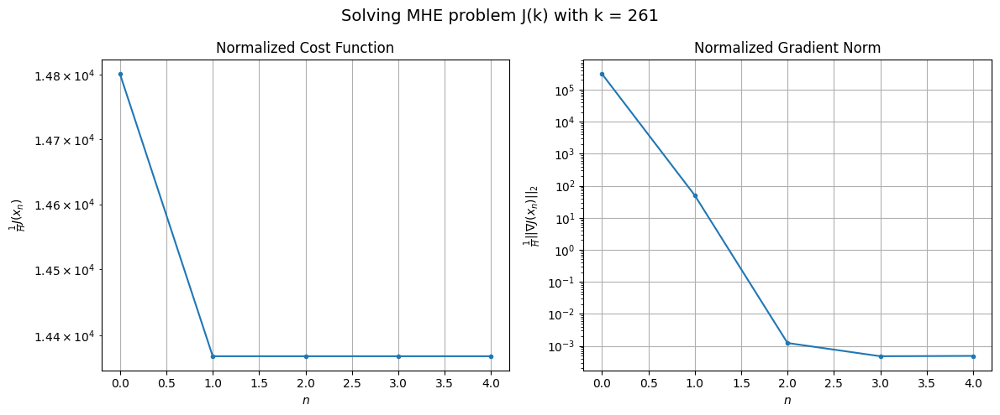

Windows:  63%|██████▎   | 223/356 [30:59<21:48,  9.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 595988.3098096312
Gradient norm: 12718691.044187441
Global estimation error: 66.27221034520633
Initial conditions estimation errors: 30.40925991300956 m, 30.13272320277563 m, 34.38925819499731 m, 37.10343728089647 m
Position estimation errors: 40.30491301445306 m, 44.51528541563197 m, 34.931686609808736 m, 60.32030676643051 m

[Gauss-Newton] Iteration 1
Cost function: 578917.1985673762 (-2.86%)
Gradient norm: 229.82059297203674 (-100.00%)
Global estimation error: 73.13370202733728 (10.35%)
Initial conditions estimation errors: 34.44647196203613 m, 33.69086786641252 m, 39.93498532599815 m, 37.84290409793973 m
Position estimation errors: 35.399680333806366 m, 41.84644735795112 m, 28.50932847144664 m, 61.92982504553372 m

[Gauss-Newton] Iteration 2
Cost function: 578917.1985239823 (-0.00%)
Gradient norm: 0.06742456054823226 (-99.97%)
Global estimation error: 73.13539916926342 (0.00%)
Initial conditions estimation errors: 34.44647

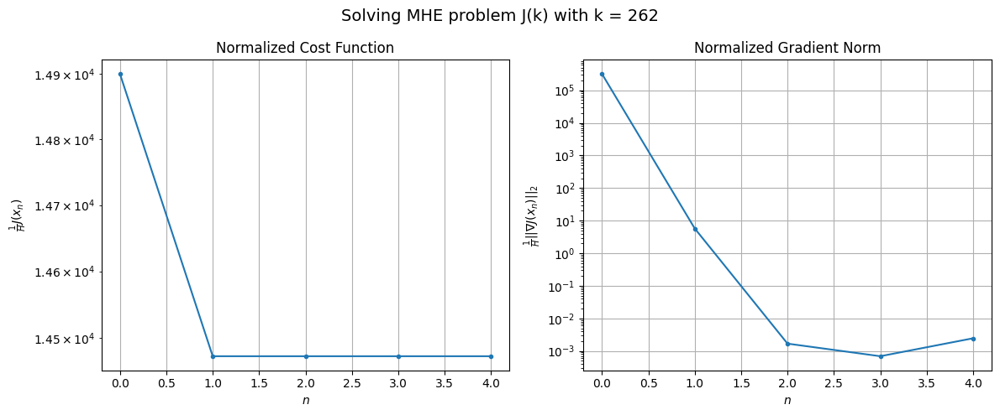

Windows:  63%|██████▎   | 224/356 [31:05<18:54,  8.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 596698.3527931818
Gradient norm: 12630046.379171407
Global estimation error: 66.600182654805
Initial conditions estimation errors: 30.1757030678329 m, 30.2227941060042 m, 35.224989494258566 m, 37.024038682273094 m
Position estimation errors: 39.21409186087616 m, 44.89269596627349 m, 32.00865568570216 m, 62.921354238428954 m

[Gauss-Newton] Iteration 1
Cost function: 580158.0526759297 (-2.77%)
Gradient norm: 1638.1363138920885 (-99.99%)
Global estimation error: 75.92740877853161 (14.00%)
Initial conditions estimation errors: 34.14405946653642 m, 35.46875521807088 m, 37.08525212724226 m, 44.3372223716504 m
Position estimation errors: 34.347290910956666 m, 36.666548130190904 m, 29.89562213179649 m, 42.15448290294603 m

[Gauss-Newton] Iteration 2
Cost function: 580158.0505756729 (-0.00%)
Gradient norm: 0.10352513224984473 (-99.99%)
Global estimation error: 75.94781192808044 (0.03%)
Initial conditions estimation errors: 34.14406055

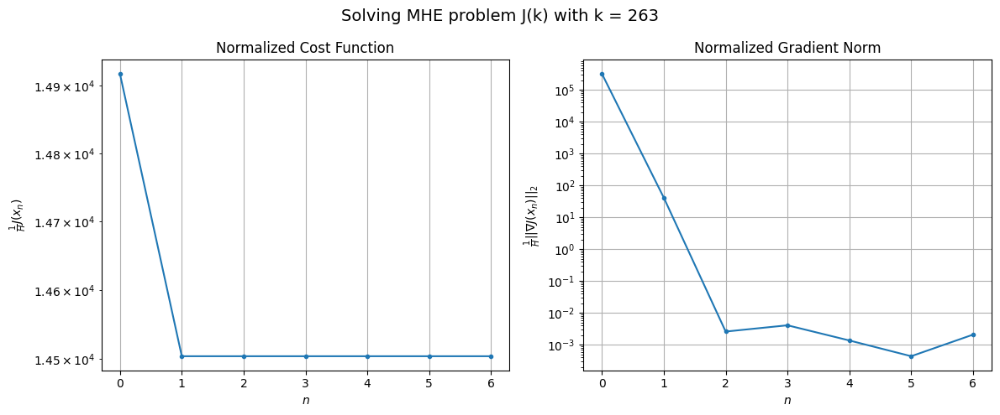

Windows:  63%|██████▎   | 225/356 [31:12<18:03,  8.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 593875.4178349518
Gradient norm: 12017593.680973588
Global estimation error: 68.84041578654403
Initial conditions estimation errors: 29.968711873756988 m, 31.72620580899124 m, 32.652387630719204 m, 42.049173853595526 m
Position estimation errors: 37.849790915648235 m, 39.790639960097124 m, 33.20805921263217 m, 44.307510712056754 m

[Gauss-Newton] Iteration 1
Cost function: 578028.885091448 (-2.67%)
Gradient norm: 3634.424134200752 (-99.97%)
Global estimation error: 71.54777707181016 (3.93%)
Initial conditions estimation errors: 33.86800595896898 m, 35.11046773303635 m, 34.10596526142935 m, 39.69959629112742 m
Position estimation errors: 33.084535143182855 m, 30.768741364622816 m, 32.705034679129476 m, 22.92549591372805 m

[Gauss-Newton] Iteration 2
Cost function: 578028.8693216464 (-0.00%)
Gradient norm: 0.04834000642768832 (-100.00%)
Global estimation error: 71.61480838891872 (0.09%)
Initial conditions estimation errors: 33.8

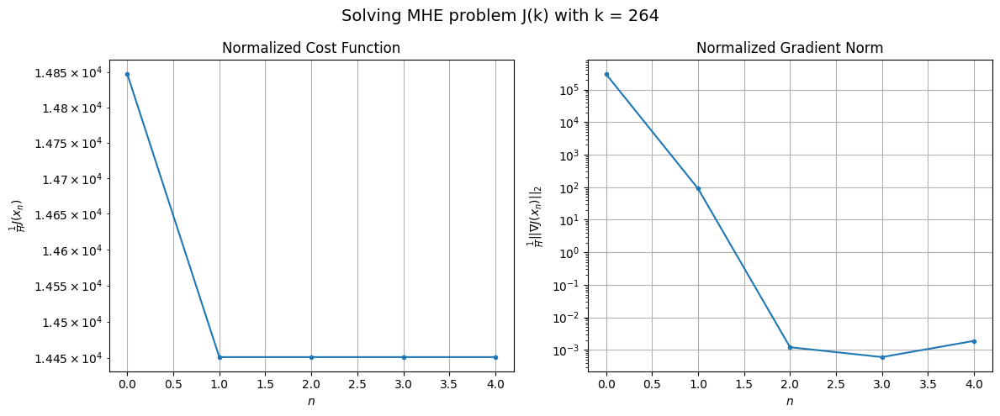

Windows:  63%|██████▎   | 226/356 [31:19<16:40,  7.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 586762.153623952
Gradient norm: 11045936.430892523
Global estimation error: 62.78162085328235
Initial conditions estimation errors: 29.767217947624122 m, 30.793121662369717 m, 29.986996704350997 m, 34.756104093201024 m
Position estimation errors: 36.28111144375486 m, 34.11710418438215 m, 35.897150512634724 m, 26.342357295812857 m

[Gauss-Newton] Iteration 1
Cost function: 571800.2724740101 (-2.55%)
Gradient norm: 205.95875663980163 (-100.00%)
Global estimation error: 68.38722924834676 (8.93%)
Initial conditions estimation errors: 33.585031019597174 m, 33.821314401611474 m, 34.235281678374214 m, 35.11270557337093 m
Position estimation errors: 31.677997646915493 m, 30.73596971745246 m, 30.44395618415877 m, 27.648583060960842 m

[Gauss-Newton] Iteration 2
Cost function: 571800.272438288 (-0.00%)
Gradient norm: 0.026078943985884628 (-99.99%)
Global estimation error: 68.38199798897426 (-0.01%)
Initial conditions estimation errors: 

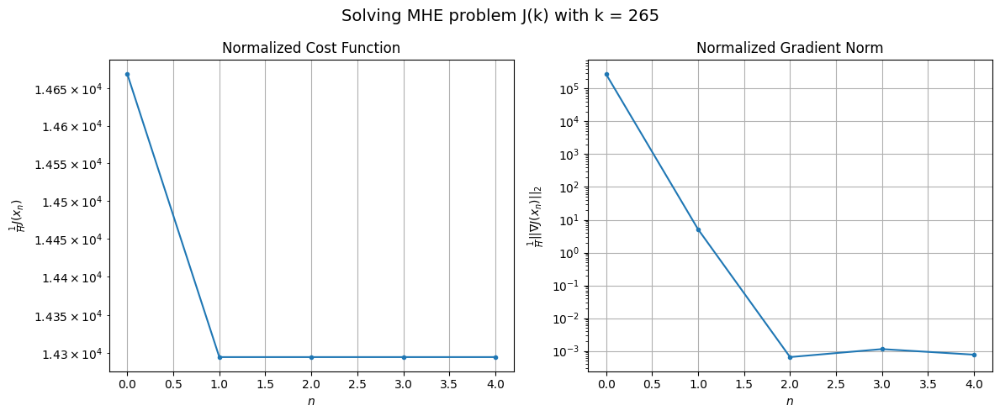

Windows:  64%|██████▍   | 227/356 [31:24<15:18,  7.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 575640.4234496397
Gradient norm: 10012455.716840338
Global estimation error: 59.94815466842602
Initial conditions estimation errors: 29.53411507555514 m, 29.63237625724396 m, 30.120229872376733 m, 30.5972449213088 m
Position estimation errors: 34.59027839485211 m, 33.76583063969341 m, 33.33134235656287 m, 30.874438569580214 m

[Gauss-Newton] Iteration 1
Cost function: 561585.6187604312 (-2.44%)
Gradient norm: 134.5513391965196 (-100.00%)
Global estimation error: 66.66062128642723 (11.20%)
Initial conditions estimation errors: 33.26658337983878 m, 32.2805797250719 m, 33.45490269339293 m, 34.28825424838695 m
Position estimation errors: 30.175076603379544 m, 29.56200165891916 m, 29.9080297891118 m, 22.76230380859465 m

[Gauss-Newton] Iteration 2
Cost function: 561585.6187322423 (-0.00%)
Gradient norm: 0.08472450621421854 (-99.94%)
Global estimation error: 66.66647265341749 (0.01%)
Initial conditions estimation errors: 33.26658446

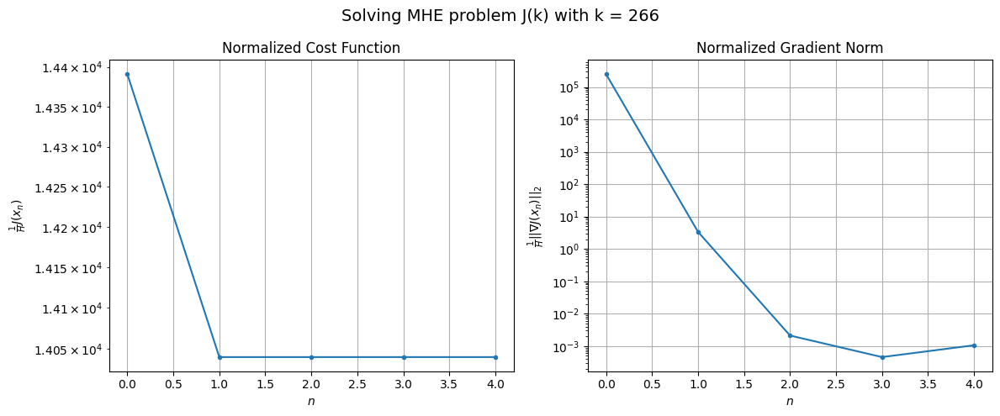

Windows:  64%|██████▍   | 228/356 [31:30<14:28,  6.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 560540.9156775674
Gradient norm: 8734340.682126654
Global estimation error: 58.01694739840418
Initial conditions estimation errors: 29.249040190742328 m, 28.024048533197956 m, 29.428232472996775 m, 29.30990231274234 m
Position estimation errors: 32.85473620361074 m, 32.47201171563287 m, 32.60410791630806 m, 25.93247326285299 m

[Gauss-Newton] Iteration 1
Cost function: 547453.711803811 (-2.33%)
Gradient norm: 23.643710157291892 (-100.00%)
Global estimation error: 66.12598993665851 (13.98%)
Initial conditions estimation errors: 32.89083611380515 m, 31.83408046198773 m, 33.08161112067806 m, 34.39498744777019 m
Position estimation errors: 28.659299294610346 m, 27.392012553418137 m, 28.672885719486985 m, 19.9150695074452 m

[Gauss-Newton] Iteration 2
Cost function: 547453.7118014912 (-0.00%)
Gradient norm: 0.03382775950631973 (-99.86%)
Global estimation error: 66.12563407494773 (-0.00%)
Initial conditions estimation errors: 32.890

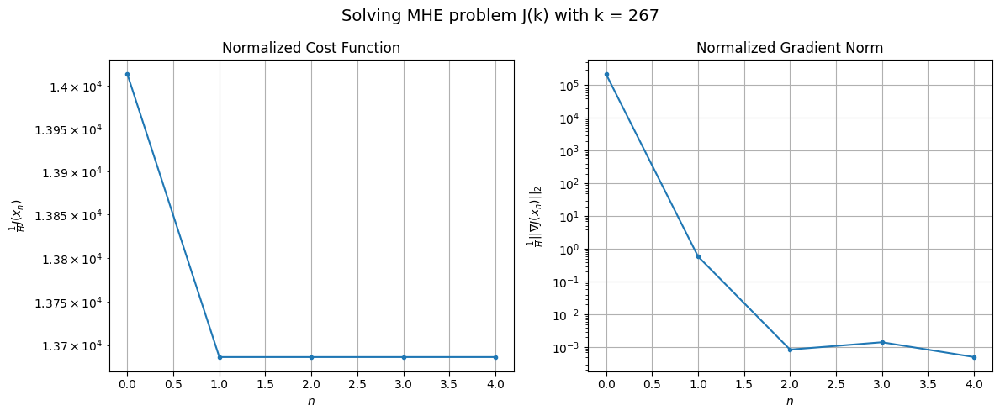

Windows:  64%|██████▍   | 229/356 [31:36<13:28,  6.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 543006.1426834159
Gradient norm: 7490790.546470561
Global estimation error: 57.43591232504216
Initial conditions estimation errors: 28.905327104005124 m, 27.54015490805947 m, 29.097445874002297 m, 29.295441099515102 m
Position estimation errors: 31.183241516984932 m, 30.196600017072583 m, 31.228479745232097 m, 22.979979191923675 m

[Gauss-Newton] Iteration 1
Cost function: 530870.0798117381 (-2.23%)
Gradient norm: 35.80002861878447 (-100.00%)
Global estimation error: 62.53470615385214 (8.88%)
Initial conditions estimation errors: 32.45019180359459 m, 31.614016517719246 m, 32.58977492984995 m, 28.21367973522339 m
Position estimation errors: 27.211663786424154 m, 25.111307537464835 m, 27.482936961211998 m, 19.886996994586312 m

[Gauss-Newton] Iteration 2
Cost function: 530870.079806797 (-0.00%)
Gradient norm: 0.07099615643345153 (-99.80%)
Global estimation error: 62.530612660611624 (-0.01%)
Initial conditions estimation errors: 

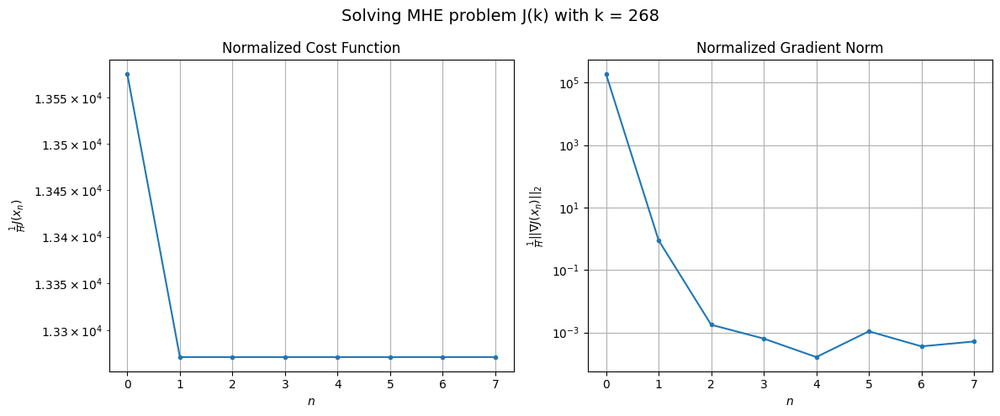

Windows:  65%|██████▍   | 230/356 [31:44<14:19,  6.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 522011.86978801584
Gradient norm: 6232273.216134192
Global estimation error: 53.89823519133888
Initial conditions estimation errors: 28.51265159188997 m, 27.327622758559446 m, 28.690079673060094 m, 22.849653366317522 m
Position estimation errors: 29.647028507586082 m, 27.82922920939752 m, 29.935527345346983 m, 23.44077283357613 m

[Gauss-Newton] Iteration 1
Cost function: 510652.95417792106 (-2.18%)
Gradient norm: 369.55640883442845 (-99.99%)
Global estimation error: 61.94276399305309 (14.93%)
Initial conditions estimation errors: 31.98164601245135 m, 30.41980187696372 m, 32.61239767856429 m, 28.725027159646707 m
Position estimation errors: 25.874165345364705 m, 26.035396474412103 m, 24.432867805227552 m, 25.017577581361753 m

[Gauss-Newton] Iteration 2
Cost function: 510652.9540000458 (-0.00%)
Gradient norm: 0.0055955482416256246 (-100.00%)
Global estimation error: 61.94377367008816 (0.00%)
Initial conditions estimation error

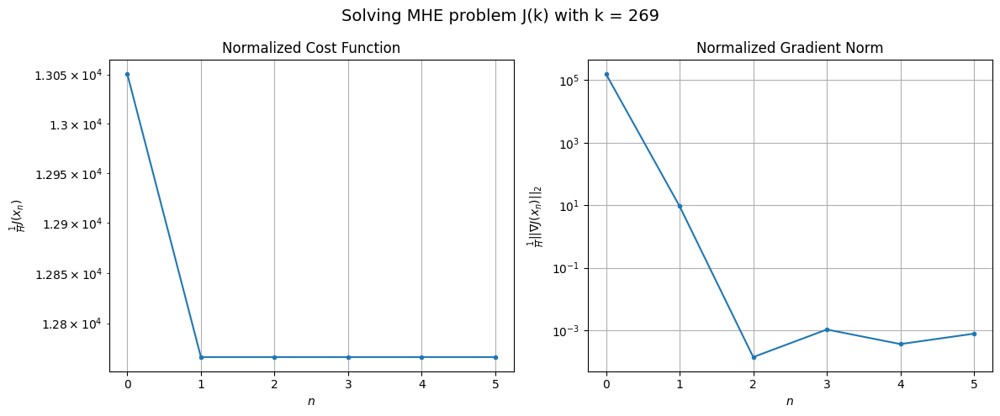

Windows:  65%|██████▍   | 231/356 [31:49<13:34,  6.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 499937.62781243527
Gradient norm: 4894637.028985109
Global estimation error: 53.88489536362511
Initial conditions estimation errors: 28.11733573489109 m, 26.429120270384956 m, 28.62940982892602 m, 24.389279875949477 m
Position estimation errors: 28.25979029275977 m, 28.59639385479967 m, 26.894740116437948 m, 27.931143280605074 m

[Gauss-Newton] Iteration 1
Cost function: 489370.89333342196 (-2.11%)
Gradient norm: 130.2757886697034 (-100.00%)
Global estimation error: 60.409064272238446 (12.11%)
Initial conditions estimation errors: 31.500579189321787 m, 30.061775841293677 m, 31.780962147473392 m, 27.261835630205784 m
Position estimation errors: 24.68540529226667 m, 23.25260632368782 m, 24.504936033064403 m, 20.774052980858794 m

[Gauss-Newton] Iteration 2
Cost function: 489370.89330515376 (-0.00%)
Gradient norm: 0.015039916362214377 (-99.99%)
Global estimation error: 60.409650228578975 (0.00%)
Initial conditions estimation erro

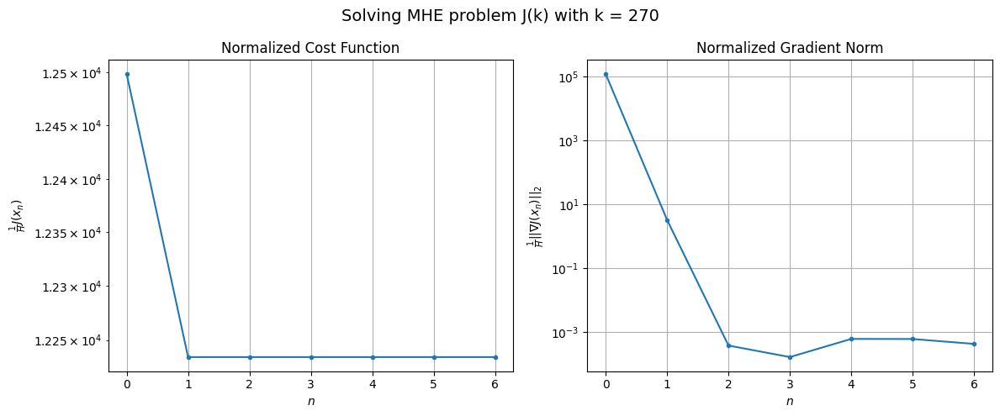

Windows:  65%|██████▌   | 232/356 [31:57<13:53,  6.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 476790.2980237058
Gradient norm: 3609698.240655543
Global estimation error: 52.30927346238236
Initial conditions estimation errors: 27.725528093488023 m, 25.992775662880327 m, 28.004579466780253 m, 22.531199224774294 m
Position estimation errors: 27.05282343534447 m, 25.929738903350554 m, 26.884041231740614 m, 24.09115466035147 m

[Gauss-Newton] Iteration 1
Cost function: 466849.59601093683 (-2.08%)
Gradient norm: 161.382734250562 (-100.00%)
Global estimation error: 65.69985249025251 (25.60%)
Initial conditions estimation errors: 31.042680743150292 m, 33.18591192540976 m, 31.211059759272285 m, 35.740271431055035 m
Position estimation errors: 23.643249174851295 m, 18.779838736726035 m, 23.79302556461986 m, 11.242501473494228 m

[Gauss-Newton] Iteration 2
Cost function: 466849.595966434 (-0.00%)
Gradient norm: 0.014302674988850997 (-99.99%)
Global estimation error: 65.68676197950352 (-0.02%)
Initial conditions estimation errors:

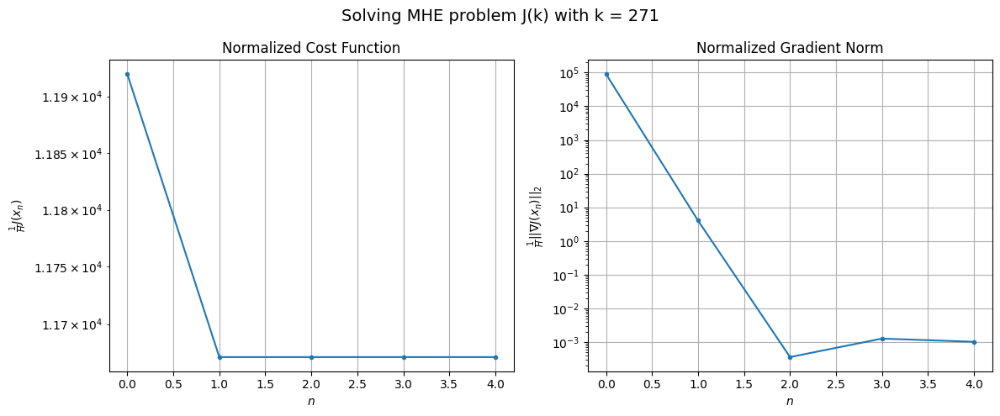

Windows:  65%|██████▌   | 233/356 [32:03<13:16,  6.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 452637.4605656314
Gradient norm: 2709807.215970635
Global estimation error: 57.50925241229864
Initial conditions estimation errors: 27.350724158586072 m, 29.107843281716065 m, 27.54507365552447 m, 30.874505332244592 m
Position estimation errors: 26.02600769734255 m, 21.384720809976898 m, 26.163505291060495 m, 14.275577077698449 m

[Gauss-Newton] Iteration 1
Cost function: 443191.6279013876 (-2.09%)
Gradient norm: 19.67103137271972 (-100.00%)
Global estimation error: 65.16733352317672 (13.32%)
Initial conditions estimation errors: 30.614924700287094 m, 33.2982511813435 m, 30.66691620335604 m, 35.50006325785126 m
Position estimation errors: 22.746375290545455 m, 17.604465248667307 m, 23.106562020595454 m, 9.364206507268344 m

[Gauss-Newton] Iteration 2
Cost function: 443191.6278912937 (-0.00%)
Gradient norm: 0.14797066970191536 (-99.25%)
Global estimation error: 65.1658042305051 (-0.00%)
Initial conditions estimation errors: 30.

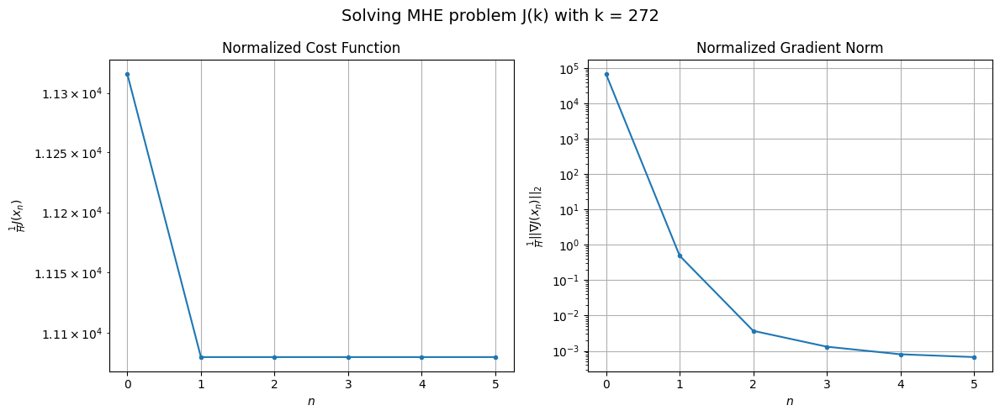

Windows:  66%|██████▌   | 234/356 [32:09<13:10,  6.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 427787.29057154775
Gradient norm: 1825340.261151045
Global estimation error: 57.06883800343025
Initial conditions estimation errors: 26.98174726055419 m, 29.297300726026112 m, 27.06991937666876 m, 30.621988891487618 m
Position estimation errors: 25.169899226084436 m, 20.195590578733963 m, 25.496156273135426 m, 12.664681240075952 m

[Gauss-Newton] Iteration 1
Cost function: 418778.51107321266 (-2.11%)
Gradient norm: 18.527301561832743 (-100.00%)
Global estimation error: 64.09551207511315 (12.31%)
Initial conditions estimation errors: 30.19216647062878 m, 33.66257491516323 m, 30.108801143227502 m, 34.01381028563851 m
Position estimation errors: 21.995570882144346 m, 15.389360521054524 m, 22.791175094731383 m, 9.395296873853987 m

[Gauss-Newton] Iteration 2
Cost function: 418778.5110813454 (0.00%)
Gradient norm: 0.057817488514766834 (-99.69%)
Global estimation error: 64.07433066522819 (-0.03%)
Initial conditions estimation errors

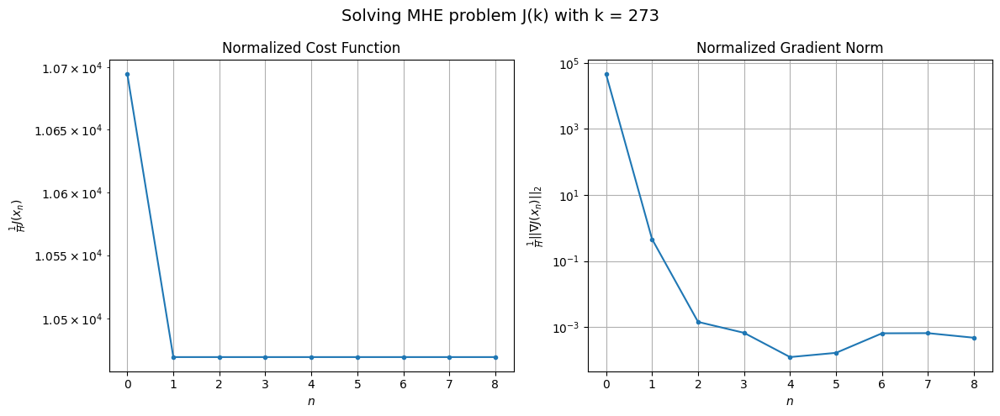

Windows:  66%|██████▌   | 235/356 [32:18<14:33,  7.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 402675.99061392
Gradient norm: 1377837.5563057433
Global estimation error: 56.00023263690672
Initial conditions estimation errors: 26.578636007253277 m, 29.582121150062406 m, 26.564640388952288 m, 29.134191453667693 m
Position estimation errors: 24.46618182405982 m, 18.18910755988081 m, 25.183240007762684 m, 13.012129918870528 m

[Gauss-Newton] Iteration 1
Cost function: 393970.83044800104 (-2.16%)
Gradient norm: 210.60169006408523 (-99.98%)
Global estimation error: 62.667001737763336 (11.90%)
Initial conditions estimation errors: 29.762004724591158 m, 32.78877342759473 m, 30.024085873715652 m, 32.631411640074504 m
Position estimation errors: 21.369040971774 m, 16.64494833076287 m, 20.78233348945148 m, 14.399638870279855 m

[Gauss-Newton] Iteration 2
Cost function: 393970.8304093761 (-0.00%)
Gradient norm: 0.11179075844608555 (-99.95%)
Global estimation error: 62.67171182176346 (0.01%)
Initial conditions estimation errors: 29.

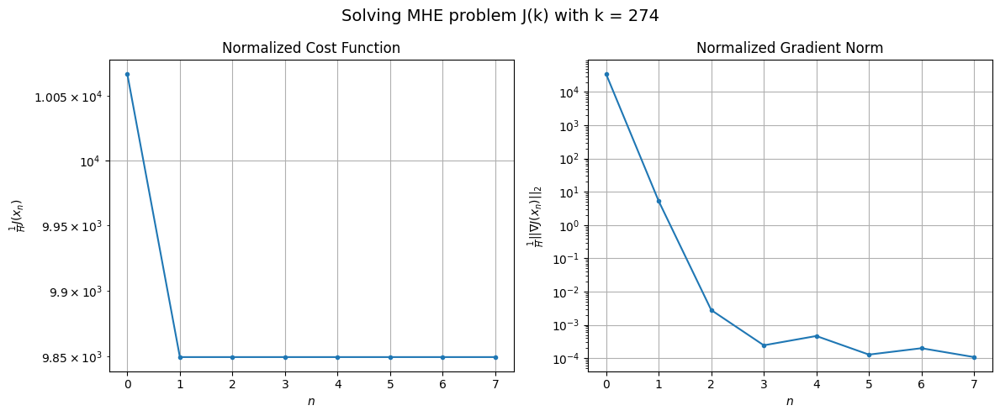

Windows:  66%|██████▋   | 236/356 [32:26<15:06,  7.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379532.72773048433
Gradient norm: 1711663.655306575
Global estimation error: 54.89616479947465
Initial conditions estimation errors: 26.113852358750822 m, 28.873024835263788 m, 26.314025292341803 m, 28.382361038269046 m
Position estimation errors: 23.88219543491129 m, 19.315810070674456 m, 23.321456500552333 m, 17.44420373593297 m

[Gauss-Newton] Iteration 1
Cost function: 371103.07029136043 (-2.22%)
Gradient norm: 69.49264097664604 (-100.00%)
Global estimation error: 61.67704532358511 (12.35%)
Initial conditions estimation errors: 29.26472352280762 m, 30.596607253925214 m, 29.409877652030616 m, 33.86034974661416 m
Position estimation errors: 20.841075506850107 m, 18.454152500223977 m, 19.645106397078454 m, 15.4268380184942 m

[Gauss-Newton] Iteration 2
Cost function: 371103.0702744988 (-0.00%)
Gradient norm: 0.0288427872219889 (-99.96%)
Global estimation error: 61.71152079333573 (0.06%)
Initial conditions estimation errors: 2

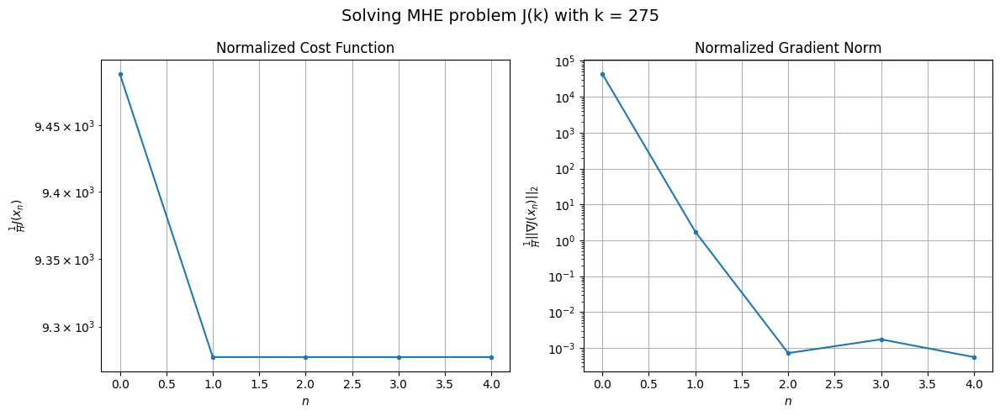

Windows:  67%|██████▋   | 237/356 [32:32<13:49,  6.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 355838.7230515336
Gradient norm: 2302519.5197152165
Global estimation error: 53.939989933446945
Initial conditions estimation errors: 25.514857431165893 m, 26.712591979080596 m, 25.50893069453002 m, 29.903655813721638 m
Position estimation errors: 23.400526981384996 m, 21.106856806295156 m, 22.337511202835184 m, 18.011495762926128 m

[Gauss-Newton] Iteration 1
Cost function: 347672.71443004214 (-2.29%)
Gradient norm: 42.02329604153788 (-100.00%)
Global estimation error: 62.101683913305294 (15.13%)
Initial conditions estimation errors: 28.642881135041435 m, 30.797079223141427 m, 31.17327739350683 m, 33.405873089101114 m
Position estimation errors: 20.41904609762674 m, 17.660267866776035 m, 16.018744691596783 m, 13.871466974411106 m

[Gauss-Newton] Iteration 2
Cost function: 347672.71442247037 (-0.00%)
Gradient norm: 0.0925564038694903 (-99.78%)
Global estimation error: 62.11777327275226 (0.03%)
Initial conditions estimation err

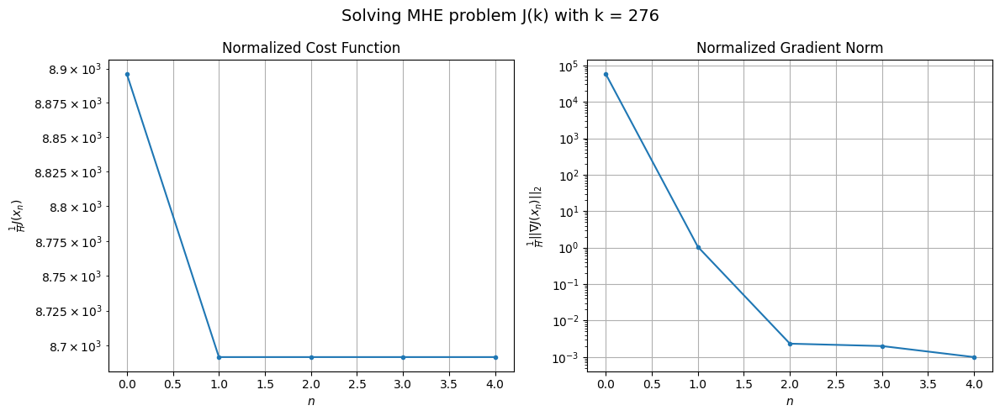

Windows:  67%|██████▋   | 238/356 [32:38<12:55,  6.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 333089.8866628715
Gradient norm: 3090272.467205895
Global estimation error: 53.925567680452964
Initial conditions estimation errors: 24.74409738675798 m, 26.761962143749 m, 26.98998749387688 m, 29.172158299290224 m
Position estimation errors: 23.03229598840408 m, 20.238853897797412 m, 18.823694871223683 m, 16.677033283350926 m

[Gauss-Newton] Iteration 1
Cost function: 325096.38937743416 (-2.40%)
Gradient norm: 914.3779003450148 (-99.97%)
Global estimation error: 60.031860856978184 (11.32%)
Initial conditions estimation errors: 27.85341878502074 m, 32.108631102294346 m, 26.985541103973166 m, 32.692570898425764 m
Position estimation errors: 20.07832948474704 m, 12.606048926110631 m, 21.411834047685144 m, 6.43879834922693 m

[Gauss-Newton] Iteration 2
Cost function: 325096.3885304345 (-0.00%)
Gradient norm: 0.16312649944008603 (-99.98%)
Global estimation error: 59.93609720814051 (-0.16%)
Initial conditions estimation errors: 27.

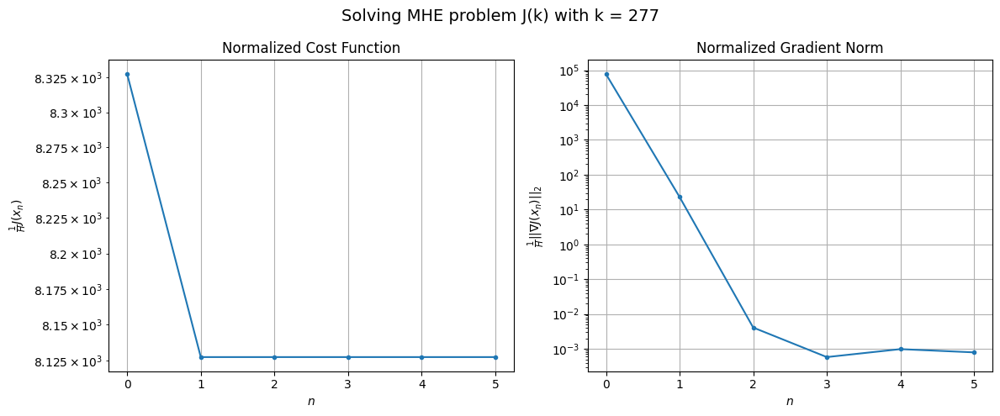

Windows:  67%|██████▋   | 239/356 [32:44<12:47,  6.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 311884.6762039941
Gradient norm: 3886645.457839723
Global estimation error: 50.832504694985005
Initial conditions estimation errors: 23.808491723072464 m, 27.469806430884685 m, 23.016213726782357 m, 27.069149451906327 m
Position estimation errors: 22.746516621099666 m, 15.579573519348909 m, 23.824351162756507 m, 10.528490540652987 m

[Gauss-Newton] Iteration 1
Cost function: 304234.1919012085 (-2.45%)
Gradient norm: 178.36610130311743 (-100.00%)
Global estimation error: 65.76197887559569 (29.37%)
Initial conditions estimation errors: 26.86481646281505 m, 34.23386964308206 m, 23.820513971376574 m, 43.16851358715206 m
Position estimation errors: 19.85214900805478 m, 9.790427240016356 m, 23.33874015960808 m, 8.762422972412928 m

[Gauss-Newton] Iteration 2
Cost function: 304234.191699691 (-0.00%)
Gradient norm: 0.040086389844867995 (-99.98%)
Global estimation error: 65.68877997719825 (-0.11%)
Initial conditions estimation errors: 

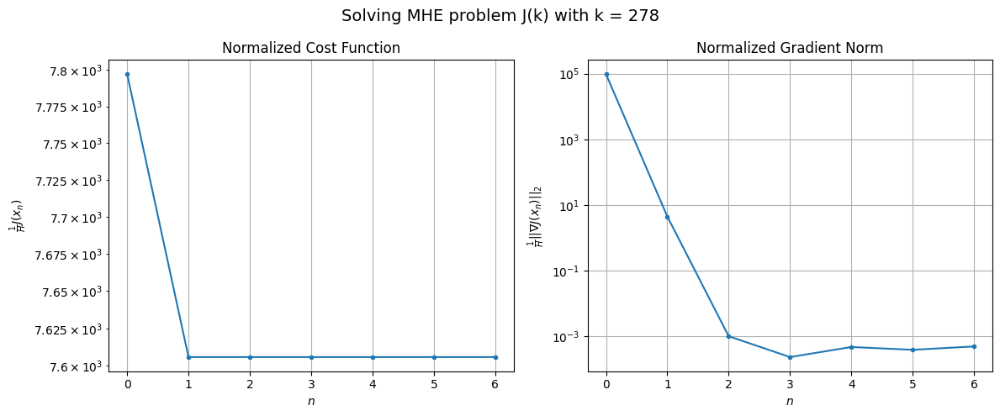

Windows:  67%|██████▋   | 240/356 [32:51<12:56,  6.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 293568.19514404755
Gradient norm: 4752371.971597778
Global estimation error: 56.540647385048054
Initial conditions estimation errors: 22.726537610965696 m, 29.522859371896374 m, 19.73658839256572 m, 37.67217708460993 m
Position estimation errors: 22.56273157302393 m, 12.775871030737596 m, 25.86369921861992 m, 9.741454465806363 m

[Gauss-Newton] Iteration 1
Cost function: 286177.80856803484 (-2.52%)
Gradient norm: 164.03437513611968 (-100.00%)
Global estimation error: 68.72493703192399 (21.55%)
Initial conditions estimation errors: 25.725979603188197 m, 33.82625661503778 m, 25.59145456155601 m, 47.56184880400912 m
Position estimation errors: 19.692214039865572 m, 9.850187049059693 m, 18.896191959568363 m, 10.2000228205683 m

[Gauss-Newton] Iteration 2
Cost function: 286177.80846243503 (-0.00%)
Gradient norm: 0.0671510656259535 (-99.96%)
Global estimation error: 68.72838042808665 (0.01%)
Initial conditions estimation errors: 25.

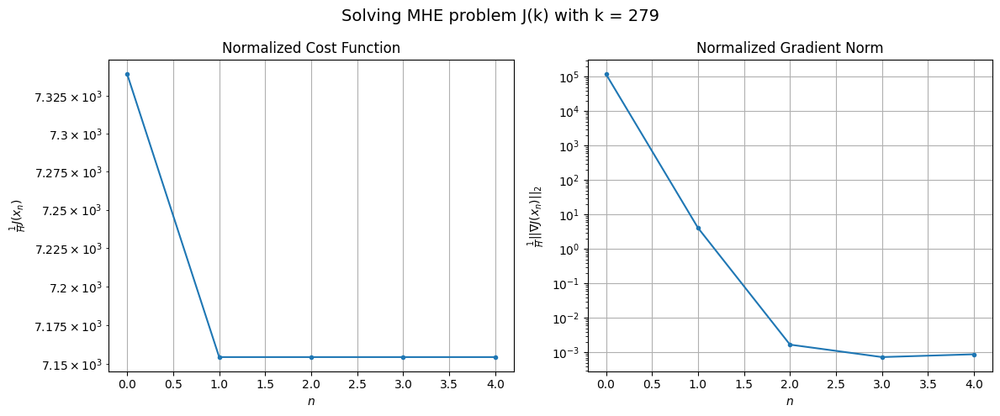

Windows:  68%|██████▊   | 241/356 [32:57<12:17,  6.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 277877.60455598444
Gradient norm: 5780236.138360082
Global estimation error: 59.9790149999132
Initial conditions estimation errors: 21.56619330639852 m, 29.256678455014125 m, 21.311720585566572 m, 42.687423804219684 m
Position estimation errors: 22.42359361294292 m, 12.86314398781466 m, 21.70495486341465 m, 11.436383271973062 m

[Gauss-Newton] Iteration 1
Cost function: 270770.20360823977 (-2.56%)
Gradient norm: 21.97819095596613 (-100.00%)
Global estimation error: 64.3372743027529 (7.27%)
Initial conditions estimation errors: 24.491732770434883 m, 32.494092364686885 m, 25.333318597261016 m, 42.91588472819146 m
Position estimation errors: 19.56886470644909 m, 10.235563353047255 m, 17.97515371061138 m, 10.71017668814074 m

[Gauss-Newton] Iteration 2
Cost function: 270770.20361153746 (0.00%)
Gradient norm: 0.007671087460408434 (-99.97%)
Global estimation error: 64.34242923718904 (0.01%)
Initial conditions estimation errors: 24.4

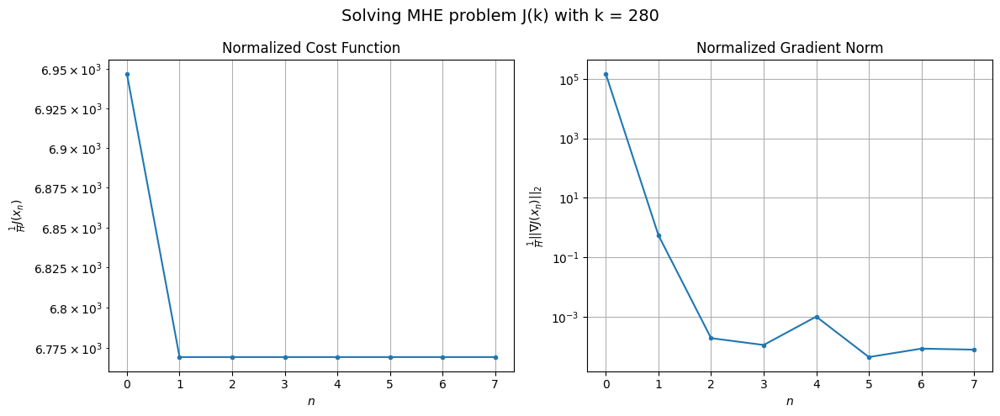

Windows:  68%|██████▊   | 242/356 [33:05<13:11,  6.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 265072.1581750809
Gradient norm: 6377520.710918953
Global estimation error: 55.57641964046236
Initial conditions estimation errors: 20.38145134067581 m, 27.925266627782033 m, 21.1555317907688 m, 38.025457506973794 m
Position estimation errors: 22.310489549344044 m, 13.529573497289485 m, 20.84140518390304 m, 12.780386134923884 m

[Gauss-Newton] Iteration 1
Cost function: 258303.2366020811 (-2.55%)
Gradient norm: 906.8850230848525 (-99.99%)
Global estimation error: 52.560933203282225 (-5.43%)
Initial conditions estimation errors: 23.226651974392368 m, 24.209788826100926 m, 30.935705340318055 m, 26.077197818757814 m
Position estimation errors: 19.487684599342234 m, 16.74579013778139 m, 12.562149112150914 m, 14.577900267407157 m

[Gauss-Newton] Iteration 2
Cost function: 258303.23545524522 (-0.00%)
Gradient norm: 0.5333161500760016 (-99.94%)
Global estimation error: 52.695491402267955 (0.26%)
Initial conditions estimation errors: 

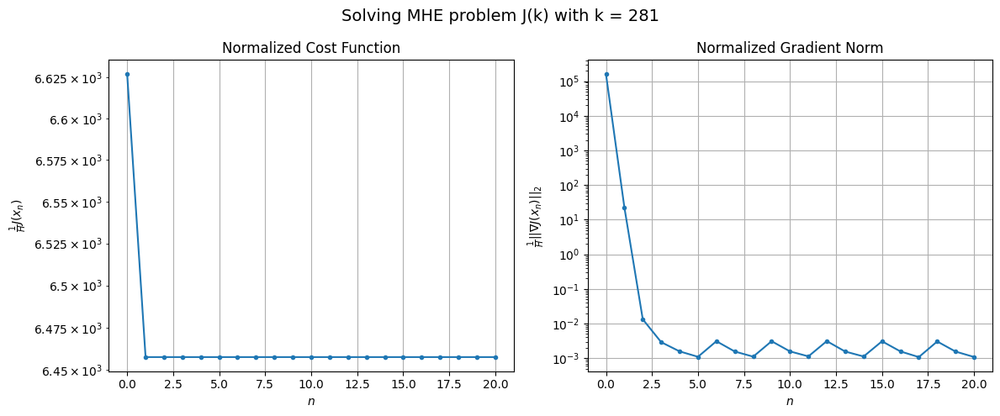

Windows:  68%|██████▊   | 243/356 [33:26<20:48, 11.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 255936.3669183503
Gradient norm: 7093254.095517507
Global estimation error: 44.27117632438166
Initial conditions estimation errors: 19.236174699147888 m, 20.079718217917765 m, 26.62666183209093 m, 21.856624448073298 m
Position estimation errors: 22.246066956714806 m, 19.743952092494354 m, 16.2298528558533 m, 17.96480565363218 m

[Gauss-Newton] Iteration 1
Cost function: 249485.82957820006 (-2.52%)
Gradient norm: 87.54163171080567 (-100.00%)
Global estimation error: 48.88008646466547 (10.41%)
Initial conditions estimation errors: 21.987253351370693 m, 22.113902888594318 m, 29.41915586105795 m, 23.47960572854327 m
Position estimation errors: 19.439466209701955 m, 18.027001755976983 m, 13.469729445903749 m, 17.365756591321343 m

[Gauss-Newton] Iteration 2
Cost function: 249485.8295700875 (-0.00%)
Gradient norm: 0.07508046255398373 (-99.91%)
Global estimation error: 48.88474285954542 (0.01%)
Initial conditions estimation errors: 2

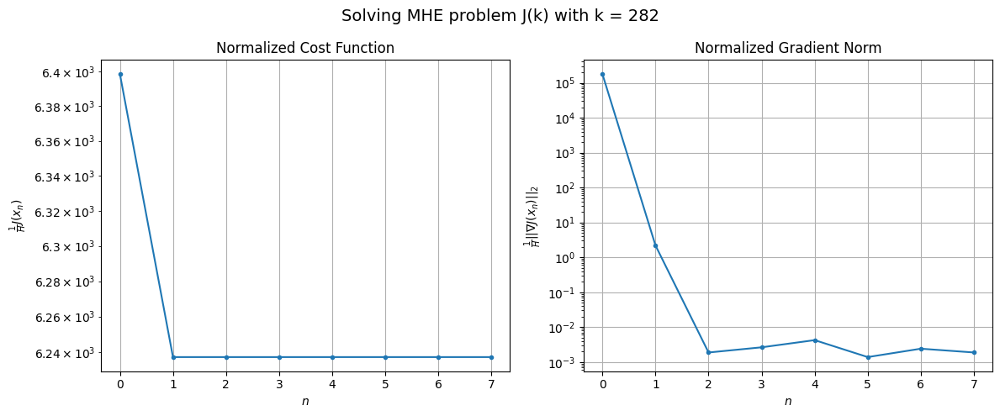

Windows:  69%|██████▊   | 244/356 [33:34<19:08, 10.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 249675.69071817433
Gradient norm: 7857821.691534314
Global estimation error: 41.08254844927271
Initial conditions estimation errors: 18.178680506376562 m, 18.135148048654216 m, 25.46740312222849 m, 19.48900183694322 m
Position estimation errors: 22.17558560293614 m, 21.110814114294044 m, 17.076298213337356 m, 20.5163575946667 m

[Gauss-Newton] Iteration 1
Cost function: 243450.99977641585 (-2.49%)
Gradient norm: 165.99389399161163 (-100.00%)
Global estimation error: 45.65885600554336 (11.14%)
Initial conditions estimation errors: 20.834120369347318 m, 21.833429351954564 m, 25.808745950019027 m, 22.535766512845978 m
Position estimation errors: 19.351778940955572 m, 15.994366206975327 m, 15.072481595642019 m, 14.852778238011817 m

[Gauss-Newton] Iteration 2
Cost function: 243450.9997084952 (-0.00%)
Gradient norm: 0.05368188572280851 (-99.97%)
Global estimation error: 45.604802002138975 (-0.12%)
Initial conditions estimation erro

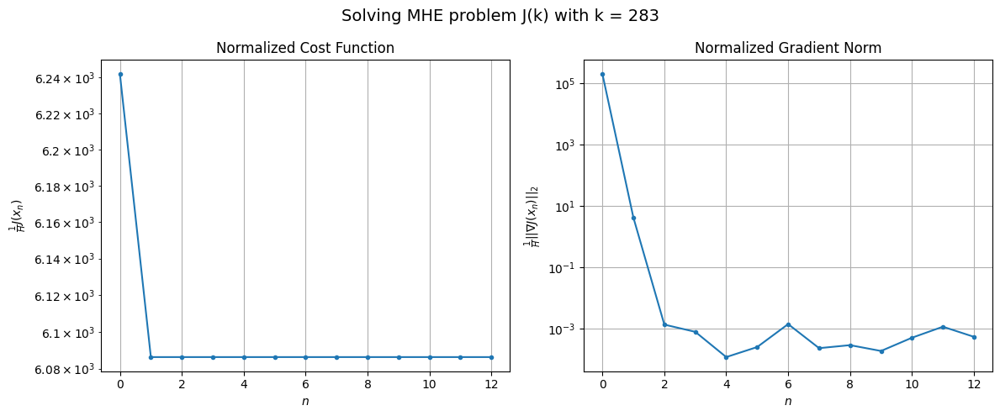

Windows:  69%|██████▉   | 245/356 [33:47<20:26, 11.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 245992.27950715576
Gradient norm: 8357702.839971917
Global estimation error: 38.03843112343829
Initial conditions estimation errors: 17.251622150939394 m, 17.84467734409022 m, 22.33073722137855 m, 18.226135208541194 m
Position estimation errors: 21.991116973605067 m, 19.078667573515094 m, 18.234910395932655 m, 18.321140666516268 m

[Gauss-Newton] Iteration 1
Cost function: 240157.7901221047 (-2.37%)
Gradient norm: 690.1082343640155 (-99.99%)
Global estimation error: 53.49655022341682 (40.64%)
Initial conditions estimation errors: 19.777946454267536 m, 26.91279361591086 m, 20.90290563519755 m, 36.1865303440524 m
Position estimation errors: 19.20617648700983 m, 11.688060431633238 m, 17.895405133447397 m, 13.595705605587057 m

[Gauss-Newton] Iteration 2
Cost function: 240157.78964303384 (-0.00%)
Gradient norm: 0.05143216475099167 (-99.99%)
Global estimation error: 53.42665785327323 (-0.13%)
Initial conditions estimation errors: 1

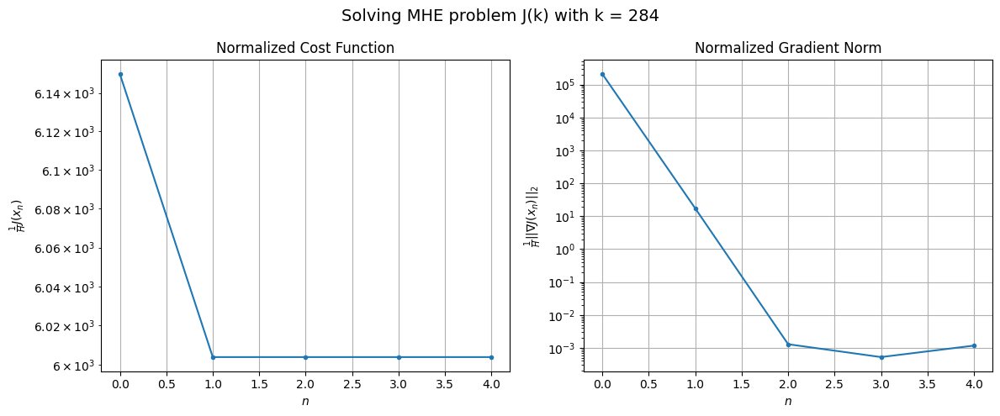

Windows:  69%|██████▉   | 246/356 [33:53<17:13,  9.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 244268.96767827432
Gradient norm: 9036012.400282571
Global estimation error: 46.344446527763225
Initial conditions estimation errors: 16.440128841337398 m, 23.06797003268888 m, 17.83630289187639 m, 32.05071030434115 m
Position estimation errors: 21.71841454071986 m, 14.746884873840976 m, 20.50734720576456 m, 15.945221819931598 m

[Gauss-Newton] Iteration 1
Cost function: 238722.34685414156 (-2.27%)
Gradient norm: 130.7402018602119 (-100.00%)
Global estimation error: 58.06209181714487 (25.28%)
Initial conditions estimation errors: 18.828648386939477 m, 28.444349599588524 m, 17.8962588456774 m, 43.4432281413435 m
Position estimation errors: 18.937562861402593 m, 11.829614816333308 m, 17.440239580055284 m, 17.378045623116137 m

[Gauss-Newton] Iteration 2
Cost function: 238722.34671724756 (-0.00%)
Gradient norm: 0.09549659676365001 (-99.93%)
Global estimation error: 58.01497353480737 (-0.08%)
Initial conditions estimation errors: 

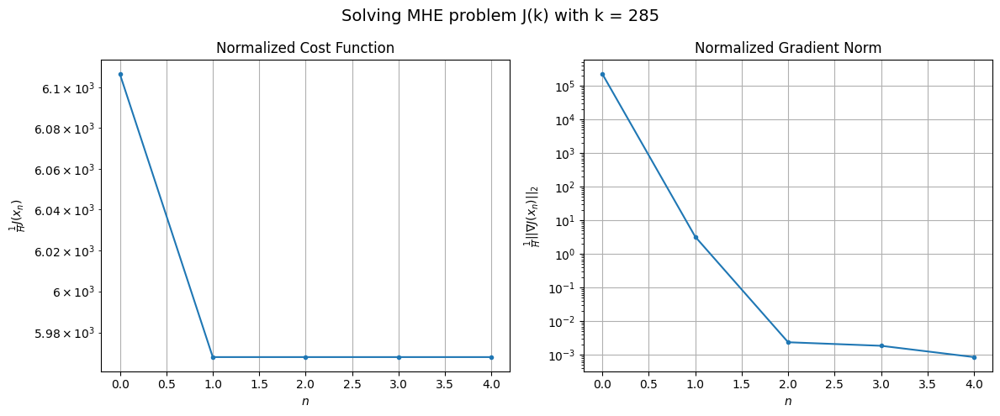

Windows:  69%|██████▉   | 247/356 [33:58<14:58,  8.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 243801.56258511991
Gradient norm: 9519406.646106701
Global estimation error: 51.865178981753076
Initial conditions estimation errors: 15.741718559632677 m, 25.015890095385156 m, 14.639747819832204 m, 40.02576979782498 m
Position estimation errors: 21.38723370305446 m, 14.824828500249962 m, 20.199094362988696 m, 19.601982384404145 m

[Gauss-Newton] Iteration 1
Cost function: 238625.27431458497 (-2.12%)
Gradient norm: 328.388578777678 (-100.00%)
Global estimation error: 52.99450559604394 (2.18%)
Initial conditions estimation errors: 17.965249903521247 m, 25.872025945846904 m, 15.275482523199477 m, 39.78629674039928 m
Position estimation errors: 18.64151032942656 m, 13.40981407713329 m, 17.70203961803347 m, 13.485292245266288 m

[Gauss-Newton] Iteration 2
Cost function: 238625.27422041245 (-0.00%)
Gradient norm: 0.07791480965673994 (-99.98%)
Global estimation error: 53.01037070572099 (0.03%)
Initial conditions estimation errors: 

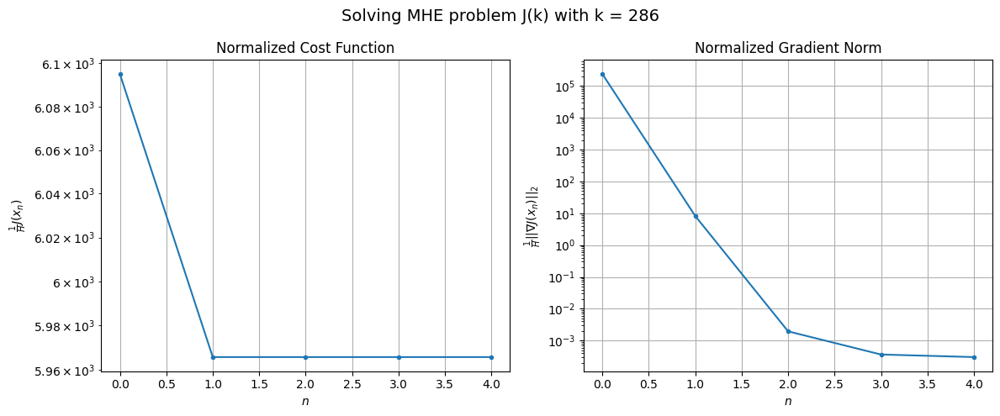

Windows:  70%|██████▉   | 248/356 [34:04<13:26,  7.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 245241.54577356952
Gradient norm: 10253146.992804956
Global estimation error: 47.79277490104022
Initial conditions estimation errors: 15.14430946477595 m, 22.93095885162223 m, 11.907758026362346 m, 37.24460940326581 m
Position estimation errors: 21.14149887041964 m, 16.426609513744655 m, 20.589000760574965 m, 16.544572122750637 m

[Gauss-Newton] Iteration 1
Cost function: 240369.65346333937 (-1.99%)
Gradient norm: 125.07266706277944 (-100.00%)
Global estimation error: 58.20053863383546 (21.78%)
Initial conditions estimation errors: 17.164219418026757 m, 29.1421599614748 m, 10.471438467915357 m, 46.19263260909757 m
Position estimation errors: 18.385999279167162 m, 11.99915868123979 m, 19.52472436773854 m, 17.99861849476547 m

[Gauss-Newton] Iteration 2
Cost function: 240369.65322040947 (-0.00%)
Gradient norm: 0.04308366206000417 (-99.97%)
Global estimation error: 58.06196312308635 (-0.24%)
Initial conditions estimation errors: 

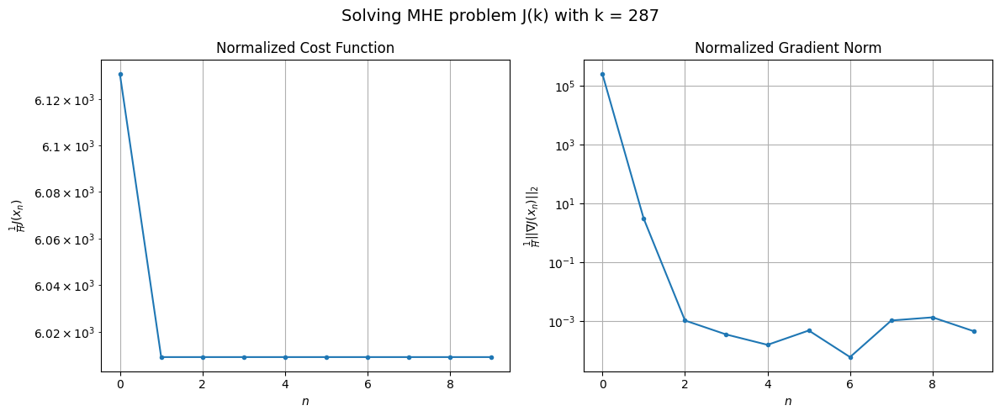

Windows:  70%|██████▉   | 249/356 [34:14<14:41,  8.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 248094.35484333118
Gradient norm: 10989055.648925634
Global estimation error: 53.550358443138784
Initial conditions estimation errors: 14.637161797199157 m, 26.32054959273966 m, 6.739548301402144 m, 43.76284136927997 m
Position estimation errors: 20.991119072738975 m, 14.966207363523832 m, 22.285890659184947 m, 20.921183734838547 m

[Gauss-Newton] Iteration 1
Cost function: 243493.49942297468 (-1.85%)
Gradient norm: 258.8334792817077 (-100.00%)
Global estimation error: 46.17675408095434 (-13.77%)
Initial conditions estimation errors: 16.442402004075984 m, 23.771238483155873 m, 11.958947956256454 m, 33.968147021301256 m
Position estimation errors: 18.213123246364024 m, 13.049299440048769 m, 18.236411981891234 m, 17.462071210289253 m

[Gauss-Newton] Iteration 2
Cost function: 243493.4988624679 (-0.00%)
Gradient norm: 0.04041808795941376 (-99.98%)
Global estimation error: 46.2401507026269 (0.14%)
Initial conditions estimation err

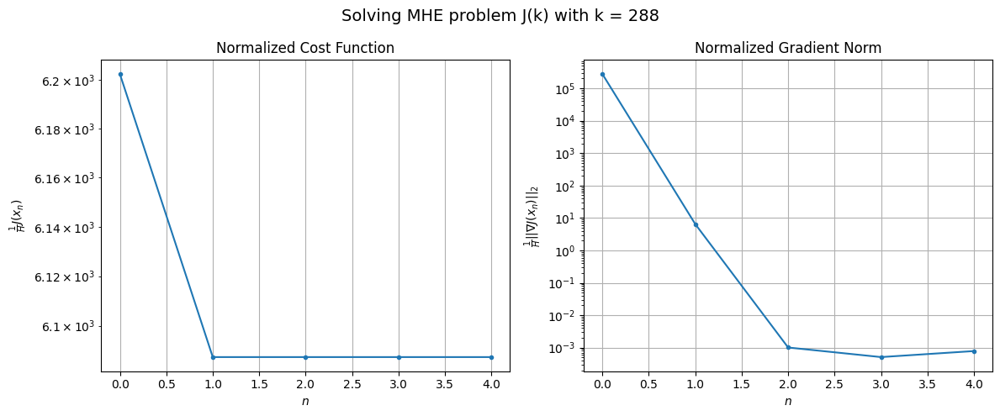

Windows:  70%|███████   | 250/356 [34:20<13:14,  7.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 252021.65702262108
Gradient norm: 11730827.495041836
Global estimation error: 41.141743538691365
Initial conditions estimation errors: 14.248194425621145 m, 21.027893479471366 m, 9.034833225690587 m, 31.077582233094017 m
Position estimation errors: 20.938905595260376 m, 16.22397766772195 m, 20.8909652659288 m, 20.409176714273755 m

[Gauss-Newton] Iteration 1
Cost function: 247663.56426831734 (-1.73%)
Gradient norm: 159.30367999899607 (-100.00%)
Global estimation error: 36.9546201079739 (-10.18%)
Initial conditions estimation errors: 15.823711765178523 m, 18.151015446512726 m, 14.817154282974602 m, 23.795607998857577 m
Position estimation errors: 18.12599364766205 m, 14.760871912172684 m, 16.563646990011698 m, 15.58597410667604 m

[Gauss-Newton] Iteration 2
Cost function: 247663.56417824415 (-0.00%)
Gradient norm: 0.04265090336155381 (-99.97%)
Global estimation error: 37.02580232072268 (0.19%)
Initial conditions estimation erro

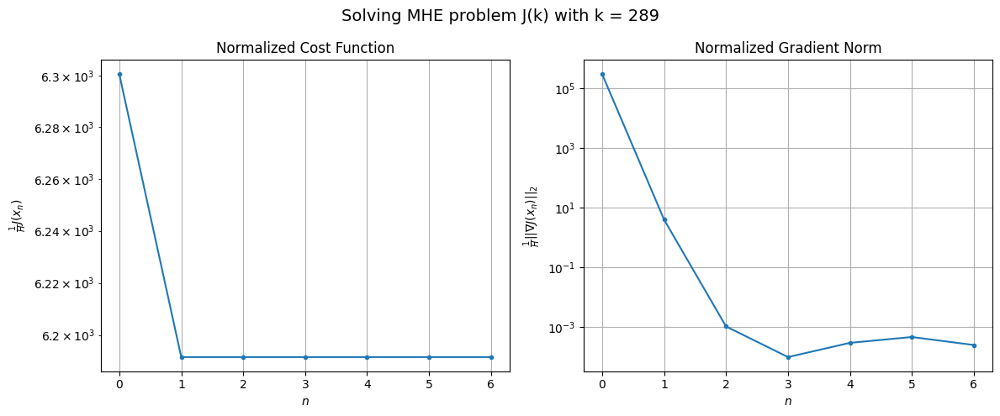

Windows:  71%|███████   | 251/356 [34:27<12:56,  7.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 257018.327589425
Gradient norm: 12363626.560004506
Global estimation error: 32.39742879258256
Initial conditions estimation errors: 13.987264271345033 m, 15.794273888170675 m, 12.66759708474947 m, 21.071514791980952 m
Position estimation errors: 21.007735952699754 m, 18.03023034978436 m, 19.694869964941255 m, 19.03851408814731 m

[Gauss-Newton] Iteration 1
Cost function: 252892.2868175792 (-1.61%)
Gradient norm: 237.6921246169602 (-100.00%)
Global estimation error: 45.923327990332766 (41.75%)
Initial conditions estimation errors: 15.346452751167075 m, 23.09995881851364 m, 11.611402142677699 m, 34.71298641334926 m
Position estimation errors: 18.161231090873233 m, 15.788702530894337 m, 16.23437825880132 m, 20.668526330255887 m

[Gauss-Newton] Iteration 2
Cost function: 252892.28645298354 (-0.00%)
Gradient norm: 0.04776748895963207 (-99.98%)
Global estimation error: 45.931012395396856 (0.02%)
Initial conditions estimation errors:

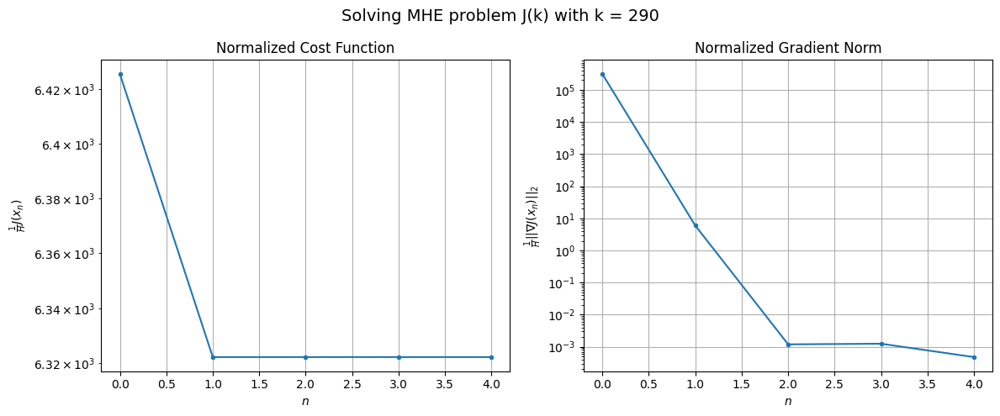

Windows:  71%|███████   | 252/356 [34:33<11:58,  6.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 263385.29545119964
Gradient norm: 13257540.080043003
Global estimation error: 42.26544764973433
Initial conditions estimation errors: 13.860462611437793 m, 21.08606000359616 m, 9.318067943241584 m, 32.60053432738005 m
Position estimation errors: 21.244666382236225 m, 19.33235232966516 m, 19.75600891579805 m, 24.18292996466646 m

[Gauss-Newton] Iteration 1
Cost function: 259266.5101377241 (-1.56%)
Gradient norm: 812.5608537995113 (-99.99%)
Global estimation error: 29.237910283054724 (-30.82%)
Initial conditions estimation errors: 15.085203847925204 m, 12.877786424076394 m, 20.061622000581927 m, 7.679381020347091 m
Position estimation errors: 18.304007551512555 m, 17.07069073572952 m, 18.122266151548757 m, 17.221425030769353 m

[Gauss-Newton] Iteration 2
Cost function: 259266.5066200396 (-0.00%)
Gradient norm: 0.056707094731827126 (-99.99%)
Global estimation error: 29.225919248455295 (-0.04%)
Initial conditions estimation errors

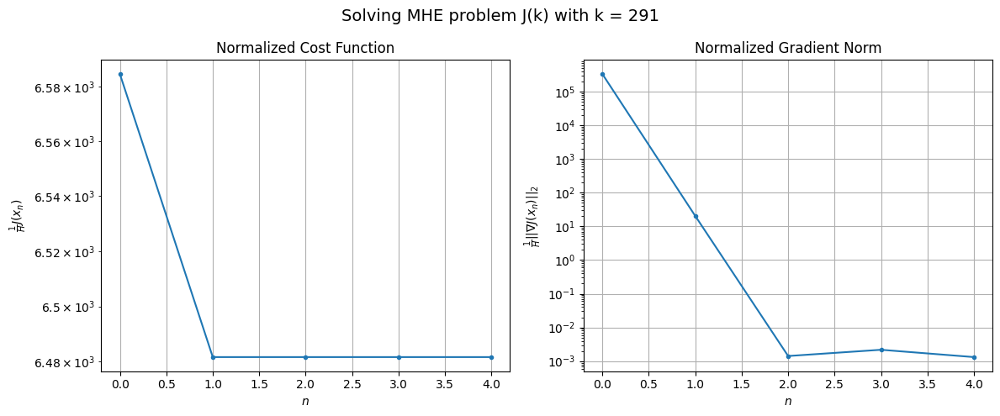

Windows:  71%|███████   | 253/356 [34:38<11:12,  6.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 271188.6657406951
Gradient norm: 13886112.56966464
Global estimation error: 26.141268057668057
Initial conditions estimation errors: 13.883916073047141 m, 11.110901353516693 m, 18.38052482798639 m, 5.412549345092487 m
Position estimation errors: 21.585293739635965 m, 20.615176072268934 m, 22.034203441700292 m, 20.698571123768794 m

[Gauss-Newton] Iteration 1
Cost function: 267082.0122143216 (-1.51%)
Gradient norm: 128.03863355266878 (-100.00%)
Global estimation error: 29.615901941282083 (13.29%)
Initial conditions estimation errors: 15.035476517708982 m, 11.713246839314527 m, 22.436770266228752 m, 3.2273566356247323 m
Position estimation errors: 18.57420897121963 m, 18.23789435425988 m, 19.61872191139019 m, 17.955918637483162 m

[Gauss-Newton] Iteration 2
Cost function: 267082.012155091 (-0.00%)
Gradient norm: 0.02341716200418279 (-99.98%)
Global estimation error: 29.622166680467423 (0.02%)
Initial conditions estimation errors

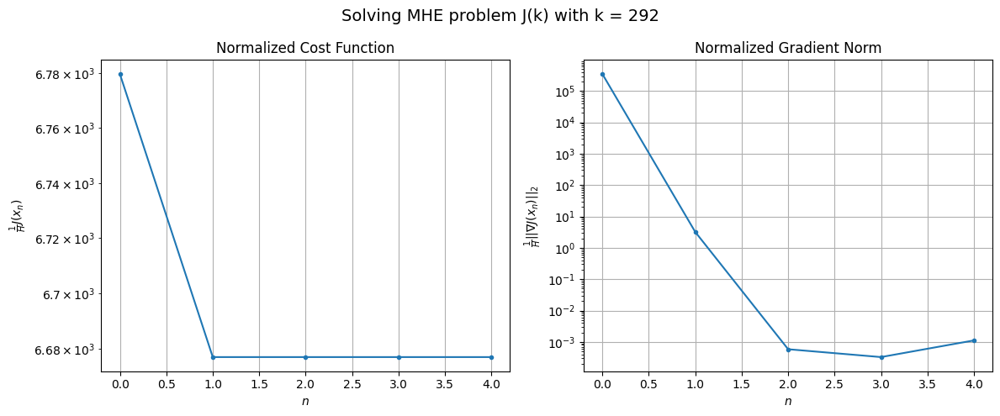

Windows:  71%|███████▏  | 254/356 [34:44<10:58,  6.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 280268.7865274751
Gradient norm: 14693524.166474238
Global estimation error: 27.706076088961115
Initial conditions estimation errors: 14.010774699792584 m, 10.368379327785204 m, 21.166683361683766 m, 3.9727754501954373 m
Position estimation errors: 22.037128337281832 m, 22.058763016413682 m, 23.744266318563373 m, 21.650818570160123 m

[Gauss-Newton] Iteration 1
Cost function: 275906.26075945713 (-1.56%)
Gradient norm: 145.02955101621737 (-100.00%)
Global estimation error: 26.39113154282384 (-4.75%)
Initial conditions estimation errors: 15.23653058380708 m, 11.88124061489797 m, 16.806636476123145 m, 6.379995490295528 m
Position estimation errors: 18.908637677082016 m, 19.267166356613114 m, 19.496706817919012 m, 19.218223871209478 m

[Gauss-Newton] Iteration 2
Cost function: 275906.2606455871 (-0.00%)
Gradient norm: 0.07994235073371836 (-99.94%)
Global estimation error: 26.362564169879892 (-0.11%)
Initial conditions estimation e

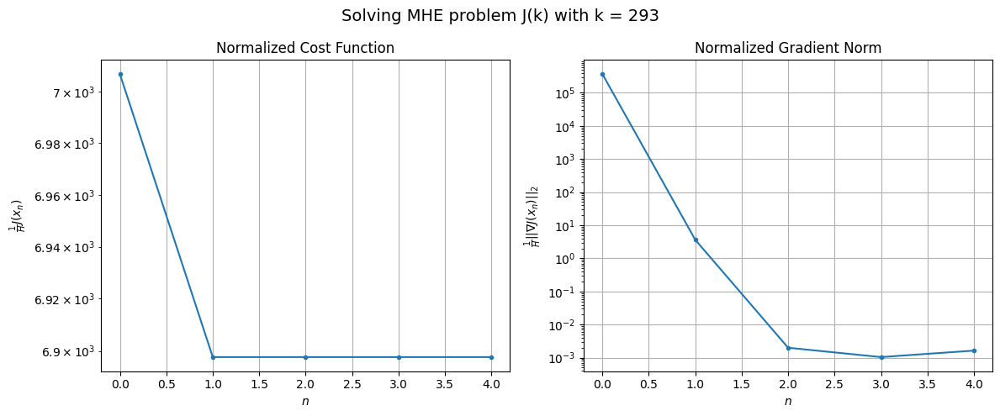

Windows:  72%|███████▏  | 255/356 [34:50<10:34,  6.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 289853.17074663175
Gradient norm: 15224150.160431558
Global estimation error: 24.80080100081689
Initial conditions estimation errors: 14.277381074569327 m, 10.965721083197483 m, 15.60364708171324 m, 6.892558788293197 m
Position estimation errors: 22.605706900814102 m, 23.126401172904547 m, 23.568604392780895 m, 22.768650379805734 m

[Gauss-Newton] Iteration 1
Cost function: 285268.0480583525 (-1.58%)
Gradient norm: 109.70759953689601 (-100.00%)
Global estimation error: 28.00523106167861 (12.92%)
Initial conditions estimation errors: 15.667662068242144 m, 10.831556449176961 m, 17.854734256973394 m, 10.133884404207295 m
Position estimation errors: 19.417146660977966 m, 19.66577721856172 m, 20.108517352319275 m, 21.858879411681723 m

[Gauss-Newton] Iteration 2
Cost function: 285268.04795817984 (-0.00%)
Gradient norm: 0.07445441786112728 (-99.93%)
Global estimation error: 28.052476600178572 (0.17%)
Initial conditions estimation er

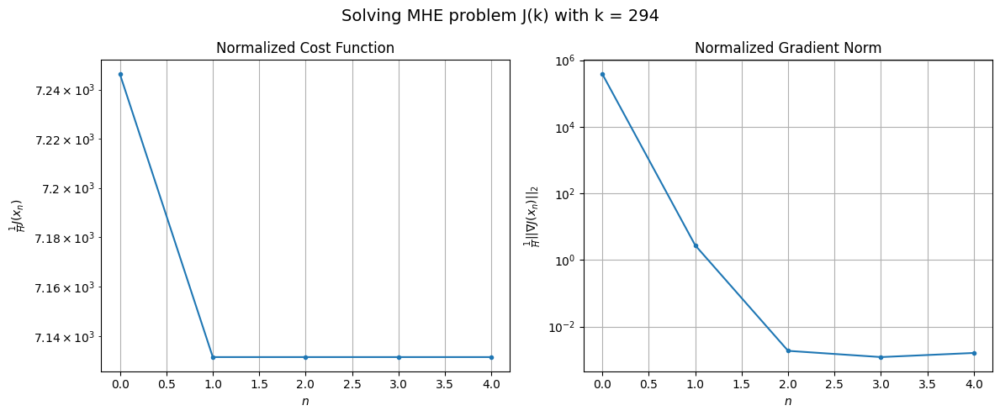

Windows:  72%|███████▏  | 256/356 [34:56<09:59,  6.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 300379.80131295515
Gradient norm: 15914191.576977435
Global estimation error: 27.639815558798507
Initial conditions estimation errors: 14.670259109460996 m, 10.296872464296708 m, 16.784518248755806 m, 12.688183157046382 m
Position estimation errors: 23.441109919032247 m, 23.701332531687317 m, 24.37653653099608 m, 25.179359427735797 m

[Gauss-Newton] Iteration 1
Cost function: 295266.8395567442 (-1.70%)
Gradient norm: 1547.902781435806 (-99.99%)
Global estimation error: 39.437747396598354 (42.68%)
Initial conditions estimation errors: 16.3561614532072 m, 20.318713460449917 m, 9.63142922889409 m, 27.96767968770112 m
Position estimation errors: 20.136746982235213 m, 20.18879151231197 m, 19.803257700297213 m, 21.358232226846 m

[Gauss-Newton] Iteration 2
Cost function: 295266.8172578291 (-0.00%)
Gradient norm: 0.057391761433736053 (-100.00%)
Global estimation error: 39.591358375616835 (0.39%)
Initial conditions estimation errors: 

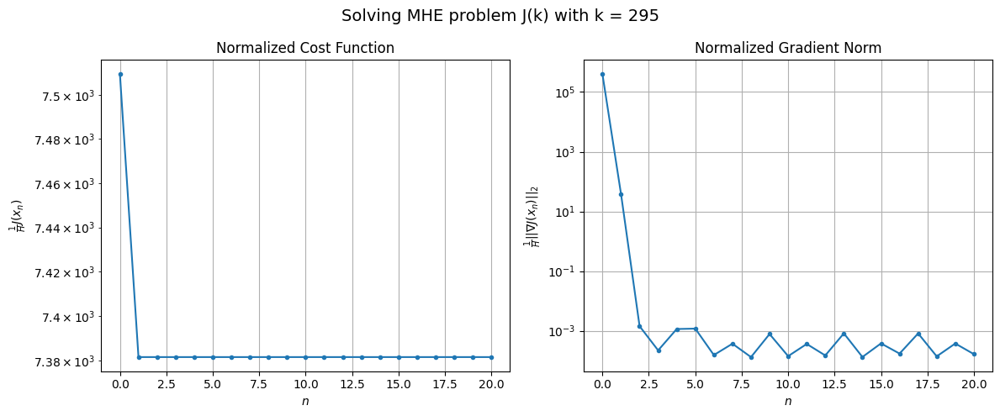

Windows:  72%|███████▏  | 257/356 [35:16<17:12, 10.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 311818.04884995916
Gradient norm: 16767552.49377013
Global estimation error: 38.004877888260076
Initial conditions estimation errors: 15.207564561578591 m, 19.17801638778678 m, 10.942091913401907 m, 26.936372669550366 m
Position estimation errors: 24.5074309929459 m, 24.691616399835297 m, 23.746558514681357 m, 26.282613375263665 m

[Gauss-Newton] Iteration 1
Cost function: 305893.0833429225 (-1.90%)
Gradient norm: 889.908143663615 (-99.99%)
Global estimation error: 31.657724785375137 (-16.70%)
Initial conditions estimation errors: 17.293414703575614 m, 16.34220563403206 m, 14.692663110750717 m, 14.839133684459501 m
Position estimation errors: 21.044724321680505 m, 21.48997087014677 m, 21.23789902672511 m, 20.677741461142322 m

[Gauss-Newton] Iteration 2
Cost function: 305893.0786327557 (-0.00%)
Gradient norm: 0.04774396468611478 (-99.99%)
Global estimation error: 31.629564120833642 (-0.09%)
Initial conditions estimation errors

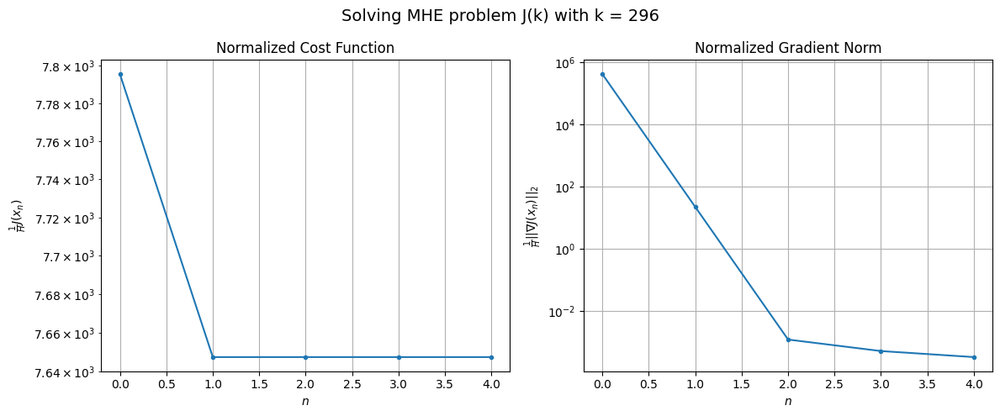

Windows:  72%|███████▏  | 258/356 [35:22<14:27,  8.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 323853.09210202633
Gradient norm: 17512906.04077027
Global estimation error: 29.00366987154621
Initial conditions estimation errors: 15.856391693887021 m, 14.796582393416536 m, 13.732417315244081 m, 13.500392635584976 m
Position estimation errors: 25.702240738726353 m, 26.186268969679432 m, 25.44871119042335 m, 25.213718689550447 m

[Gauss-Newton] Iteration 1
Cost function: 316995.33497439366 (-2.12%)
Gradient norm: 877.7162841496536 (-99.99%)
Global estimation error: 48.109439960721154 (65.87%)
Initial conditions estimation errors: 18.364555248224594 m, 22.53142594237191 m, 18.48870758225611 m, 33.58206132682639 m
Position estimation errors: 22.07086407582092 m, 23.250393669393613 m, 23.653895079622526 m, 32.041336811453924 m

[Gauss-Newton] Iteration 2
Cost function: 316995.3318122209 (-0.00%)
Gradient norm: 0.018066824685807684 (-100.00%)
Global estimation error: 48.15010986548385 (0.08%)
Initial conditions estimation error

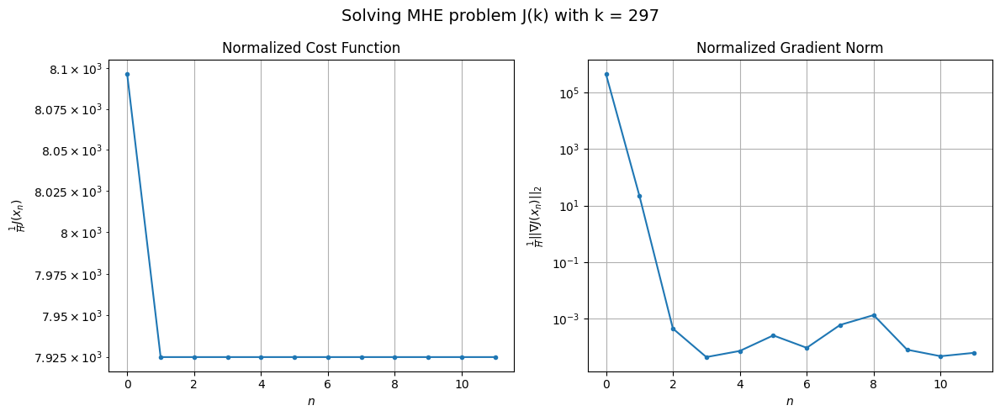

Windows:  73%|███████▎  | 259/356 [35:33<15:34,  9.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 336393.12066733977
Gradient norm: 18300547.86092965
Global estimation error: 44.80644449181911
Initial conditions estimation errors: 16.50108566544107 m, 20.496159325181353 m, 18.395883779453257 m, 31.254102714074488 m
Position estimation errors: 26.957811958602925 m, 28.242717609478827 m, 27.043811876566515 m, 37.22486915057215 m

[Gauss-Newton] Iteration 1
Cost function: 328473.0670321847 (-2.35%)
Gradient norm: 326.6741687162156 (-100.00%)
Global estimation error: 43.84299737890978 (-2.15%)
Initial conditions estimation errors: 19.42186693660056 m, 21.3077129170592 m, 19.094560492186705 m, 26.95118235779236 m
Position estimation errors: 23.136045827251188 m, 23.579440619823167 m, 22.670060241418007 m, 27.68459547452452 m

[Gauss-Newton] Iteration 2
Cost function: 328473.06695925613 (-0.00%)
Gradient norm: 0.07377077767742453 (-99.98%)
Global estimation error: 43.845198155405974 (0.01%)
Initial conditions estimation errors: 

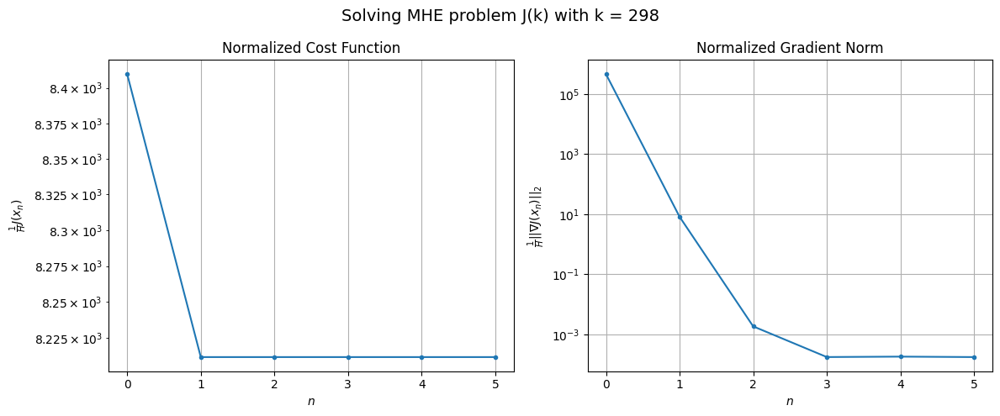

Windows:  73%|███████▎  | 260/356 [35:39<13:44,  8.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 349631.35502213123
Gradient norm: 19121802.107683506
Global estimation error: 39.539611640829406
Initial conditions estimation errors: 17.030304866647906 m, 18.841911809125587 m, 18.152121795064005 m, 24.265554380487373 m
Position estimation errors: 28.254302042069618 m, 28.797621296299678 m, 26.686587772190425 m, 33.210597990809624 m

[Gauss-Newton] Iteration 1
Cost function: 340495.43475117953 (-2.61%)
Gradient norm: 506.97191053628035 (-100.00%)
Global estimation error: 48.38340627514121 (22.37%)
Initial conditions estimation errors: 20.35872808903516 m, 22.25492326377905 m, 21.309501076830497 m, 31.2583258406849 m
Position estimation errors: 24.224335793856905 m, 23.564449528784593 m, 21.990801248272355 m, 29.443464743586098 m

[Gauss-Newton] Iteration 2
Cost function: 340495.43424793845 (-0.00%)
Gradient norm: 0.08568223016107082 (-99.98%)
Global estimation error: 48.26070792128041 (-0.25%)
Initial conditions estimation e

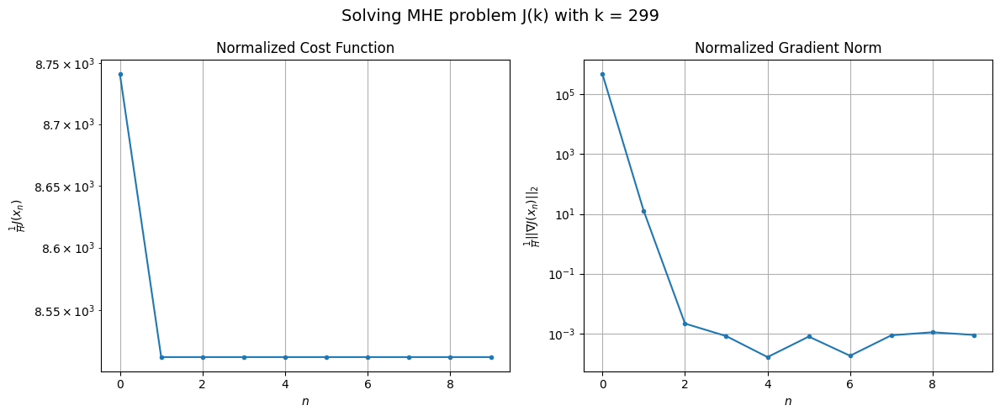

Windows:  73%|███████▎  | 261/356 [35:49<13:59,  8.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 363166.12566915696
Gradient norm: 19716177.927240115
Global estimation error: 43.67494985482776
Initial conditions estimation errors: 17.417291740522167 m, 19.409918556776535 m, 20.549950400827203 m, 28.37384133396872 m
Position estimation errors: 29.61418113685537 m, 28.97297289228026 m, 26.513823331618262 m, 35.68248584737365 m

[Gauss-Newton] Iteration 1
Cost function: 353042.6005939053 (-2.79%)
Gradient norm: 678.0125932201884 (-100.00%)
Global estimation error: 43.11358746400677 (-1.29%)
Initial conditions estimation errors: 21.048690347763134 m, 21.919903047045782 m, 20.6765259319698 m, 22.532441002133627 m
Position estimation errors: 25.421706090402175 m, 25.762340427855467 m, 23.965540509197478 m, 27.796989743760662 m

[Gauss-Newton] Iteration 2
Cost function: 353042.59722909186 (-0.00%)
Gradient norm: 0.1998454219405721 (-99.97%)
Global estimation error: 43.14606166585491 (0.08%)
Initial conditions estimation errors: 

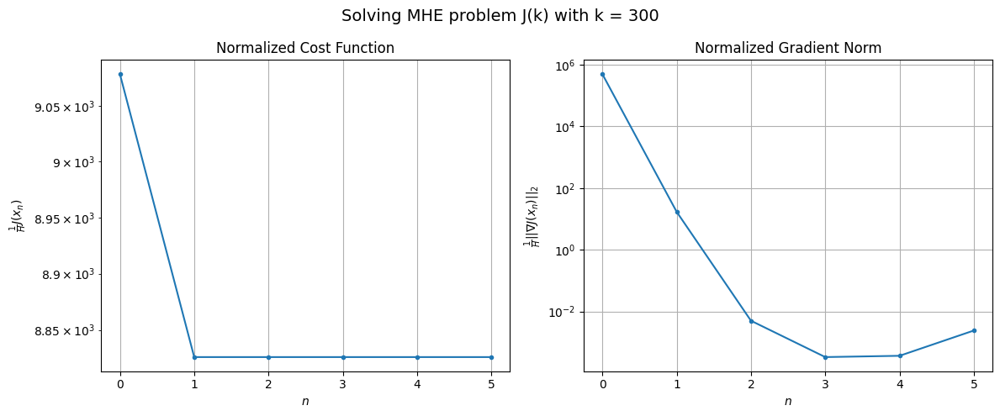

Windows:  74%|███████▎  | 262/356 [35:55<12:32,  8.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379287.754078146
Gradient norm: 20540860.766511396
Global estimation error: 36.22337122222104
Initial conditions estimation errors: 17.634854627876095 m, 18.41949032854484 m, 17.49978845901309 m, 18.85740539447528 m
Position estimation errors: 31.13260412851055 m, 31.51483313360904 m, 29.522806945860058 m, 33.68346239284937 m

[Gauss-Newton] Iteration 1
Cost function: 368100.7886088747 (-2.95%)
Gradient norm: 102.86983790485465 (-100.00%)
Global estimation error: 44.32907636996324 (22.38%)
Initial conditions estimation errors: 21.494006789928157 m, 22.583117073387466 m, 21.736558845137004 m, 22.816095026941824 m
Position estimation errors: 26.722442786778878 m, 26.046119582602323 m, 25.043621869947753 m, 26.69075299857267 m

[Gauss-Newton] Iteration 2
Cost function: 368100.7885468705 (-0.00%)
Gradient norm: 0.09434580792998165 (-99.91%)
Global estimation error: 44.33289567184319 (0.01%)
Initial conditions estimation errors: 21

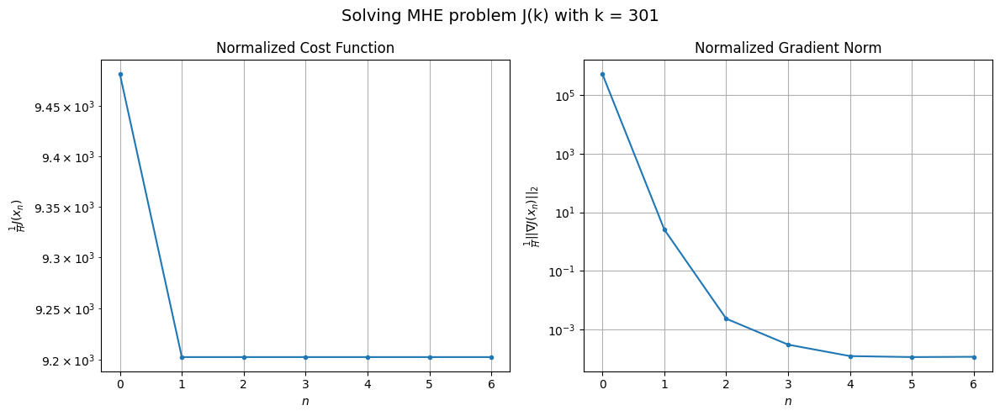

Windows:  74%|███████▍  | 263/356 [36:02<11:57,  7.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 399037.08995743445
Gradient norm: 21422457.01410796
Global estimation error: 36.96075901352478
Initial conditions estimation errors: 17.753239360633042 m, 18.99669628840945 m, 18.026074878551643 m, 19.107140585557985 m
Position estimation errors: 32.795759592922444 m, 32.118070858096615 m, 31.054120570770845 m, 32.86226934320046 m

[Gauss-Newton] Iteration 1
Cost function: 386820.44164420315 (-3.06%)
Gradient norm: 1628.858437549655 (-99.99%)
Global estimation error: 56.948235427210946 (54.08%)
Initial conditions estimation errors: 21.776836137583782 m, 27.348809703969287 m, 25.79168951274433 m, 36.81947346776698 m
Position estimation errors: 28.15630362002025 m, 26.718536837229042 m, 28.846677621308267 m, 25.173699455530194 m

[Gauss-Newton] Iteration 2
Cost function: 386820.42312653485 (-0.00%)
Gradient norm: 0.09227010035516255 (-99.99%)
Global estimation error: 56.92500861043862 (-0.04%)
Initial conditions estimation error

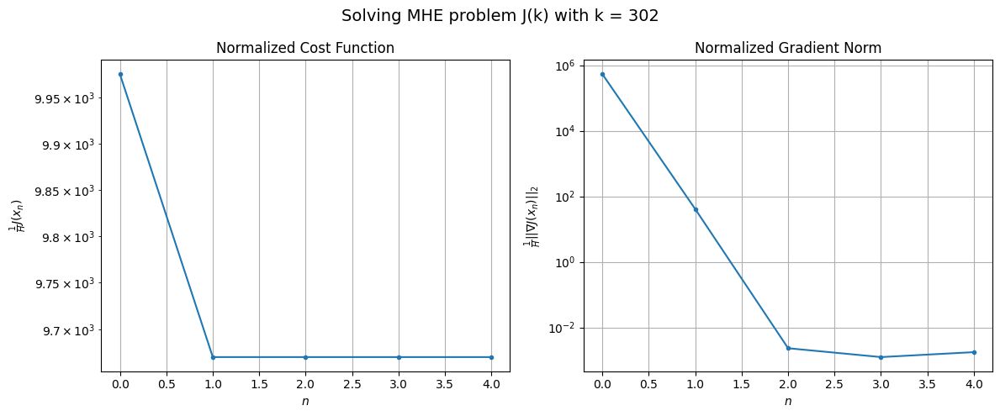

Windows:  74%|███████▍  | 264/356 [36:07<10:43,  6.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 423165.0223587899
Gradient norm: 22485429.401118584
Global estimation error: 53.09399100704443
Initial conditions estimation errors: 17.855632549390926 m, 25.42080714724273 m, 22.376640357188684 m, 36.785752804508924 m
Position estimation errors: 34.611972041094646 m, 32.97528320453229 m, 36.23771771275217 m, 30.648049492967417 m

[Gauss-Newton] Iteration 1
Cost function: 409659.64688314777 (-3.19%)
Gradient norm: 3359.229793818734 (-99.99%)
Global estimation error: 59.85000724201858 (12.72%)
Initial conditions estimation errors: 22.056351261455656 m, 28.20327049350738 m, 29.114468296779883 m, 38.11075887906779 m
Position estimation errors: 29.686636100813864 m, 29.467999919390305 m, 30.667734832223495 m, 28.11722550040627 m

[Gauss-Newton] Iteration 2
Cost function: 409659.6355668043 (-0.00%)
Gradient norm: 0.07324868331146728 (-100.00%)
Global estimation error: 59.95990779848318 (0.18%)
Initial conditions estimation errors: 

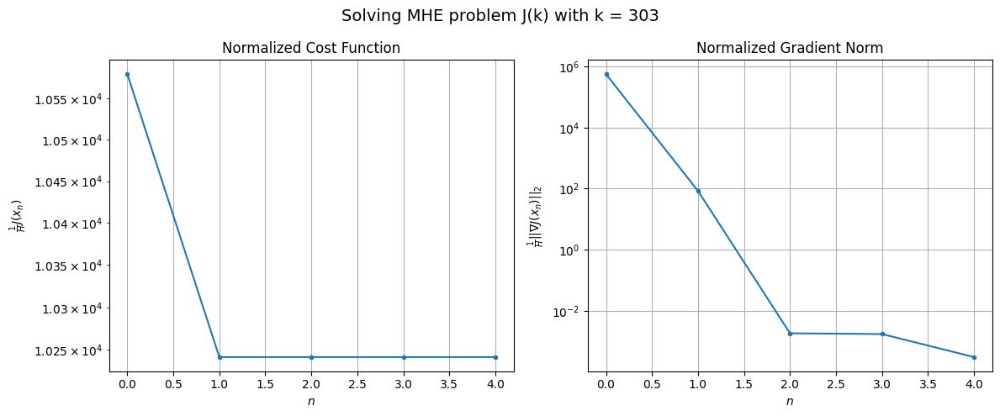

Windows:  74%|███████▍  | 265/356 [36:12<09:48,  6.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 451573.02518140303
Gradient norm: 23461879.45221396
Global estimation error: 57.879363774641625
Initial conditions estimation errors: 18.06021181462605 m, 27.181733253197024 m, 26.004850072618975 m, 40.10886542321066 m
Position estimation errors: 36.49077641748826 m, 35.72477290581155 m, 38.5468496219417 m, 32.86525323017316 m

[Gauss-Newton] Iteration 1
Cost function: 436885.55956042843 (-3.25%)
Gradient norm: 913.131553733722 (-100.00%)
Global estimation error: 52.44360607582929 (-9.39%)
Initial conditions estimation errors: 22.380438107648448 m, 26.16978472055512 m, 25.064527796011607 m, 30.599507929426277 m
Position estimation errors: 31.284383040092663 m, 31.391362296915638 m, 31.643760074928558 m, 30.839377802856912 m

[Gauss-Newton] Iteration 2
Cost function: 436885.5552199974 (-0.00%)
Gradient norm: 0.21576544488528532 (-99.98%)
Global estimation error: 52.519741020800346 (0.15%)
Initial conditions estimation errors: 2

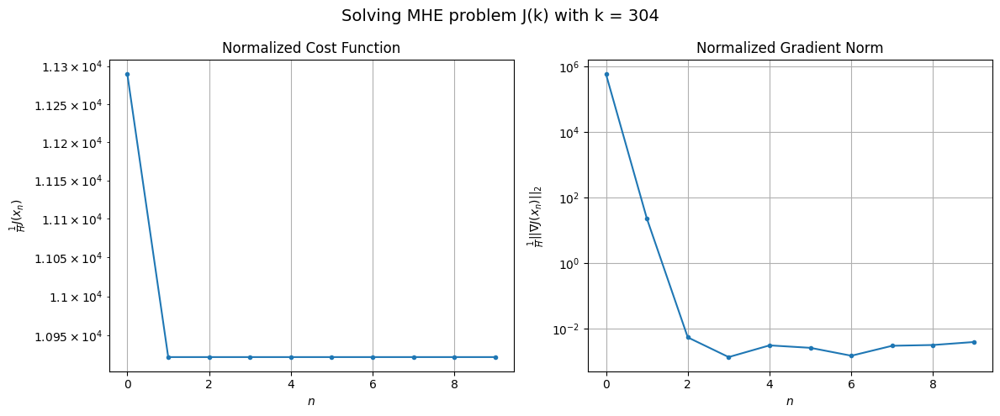

Windows:  75%|███████▍  | 266/356 [36:22<11:17,  7.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 485575.3637906846
Gradient norm: 24473458.877634123
Global estimation error: 47.58361036569072
Initial conditions estimation errors: 18.389235856958447 m, 23.83832904107694 m, 20.995174621955076 m, 30.281140645215434 m
Position estimation errors: 38.349445353860574 m, 38.15577903736292 m, 39.78628397762631 m, 36.534082456223395 m

[Gauss-Newton] Iteration 1
Cost function: 469680.5515223225 (-3.27%)
Gradient norm: 58.80320642454255 (-100.00%)
Global estimation error: 59.397833690502345 (24.83%)
Initial conditions estimation errors: 22.782182182173614 m, 28.53810261030779 m, 26.76655134643914 m, 38.44703419377226 m
Position estimation errors: 32.833692823987334 m, 31.71368176787269 m, 36.021893701928235 m, 28.94415579432189 m

[Gauss-Newton] Iteration 2
Cost function: 469680.55149565777 (-0.00%)
Gradient norm: 0.08466834175535845 (-99.86%)
Global estimation error: 59.38356423752224 (-0.02%)
Initial conditions estimation errors: 

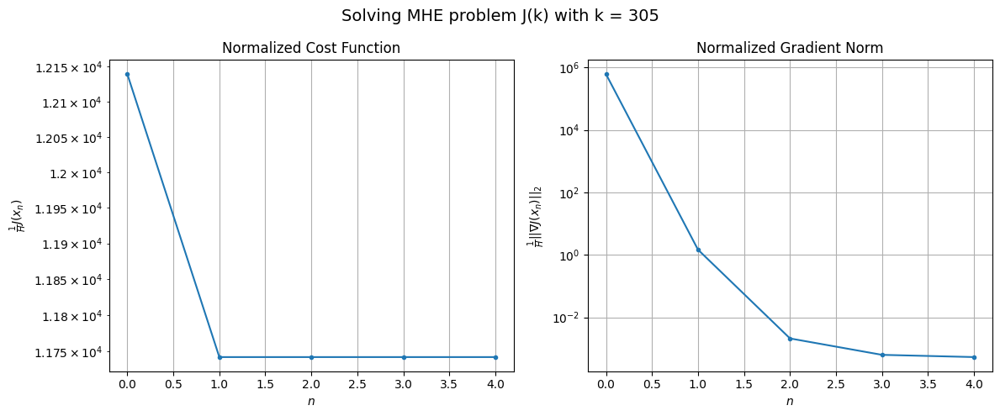

Windows:  75%|███████▌  | 267/356 [36:28<10:11,  6.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 523912.0615923852
Gradient norm: 25440753.435165387
Global estimation error: 55.59303225653414
Initial conditions estimation errors: 18.85617618533634 m, 26.67053348401163 m, 23.288700404192365 m, 38.48798161762831 m
Position estimation errors: 40.050560465107644 m, 38.639152599414864 m, 44.876990564554355 m, 34.84672623578139 m

[Gauss-Newton] Iteration 1
Cost function: 506624.2113106316 (-3.30%)
Gradient norm: 199.82222441815466 (-100.00%)
Global estimation error: 59.50350371266765 (7.03%)
Initial conditions estimation errors: 23.35604675503086 m, 28.805418805824083 m, 24.640828079127562 m, 39.47420678557169 m
Position estimation errors: 34.21282888475502 m, 31.76890459479671 m, 35.29205202328799 m, 28.68331650585513 m

[Gauss-Newton] Iteration 2
Cost function: 506624.2109828822 (-0.00%)
Gradient norm: 0.09275530454611529 (-99.95%)
Global estimation error: 59.51833439720188 (0.02%)
Initial conditions estimation errors: 23.35

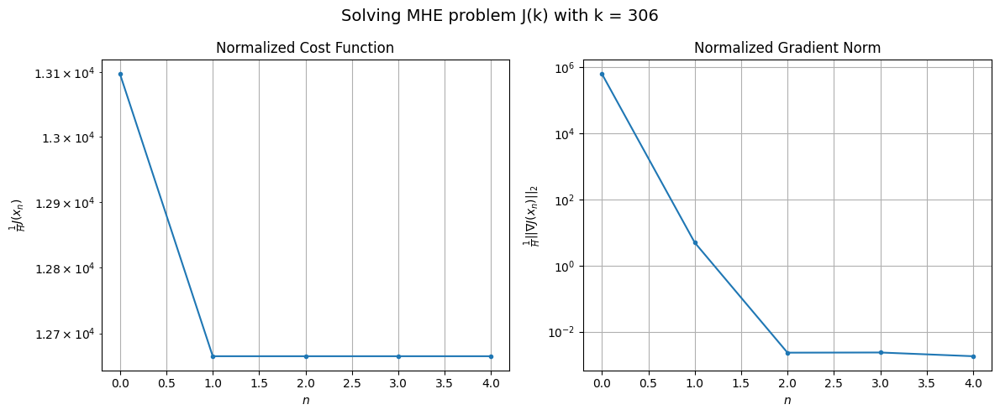

Windows:  75%|███████▌  | 268/356 [36:33<09:27,  6.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 565861.8036815741
Gradient norm: 26252541.311122652
Global estimation error: 54.79882932613881
Initial conditions estimation errors: 19.496024674619992 m, 26.710668347458174 m, 20.230669240573768 m, 38.73053455635244 m
Position estimation errors: 41.48390237790364 m, 38.808238207149 m, 43.76147242382976 m, 35.037238605918965 m

[Gauss-Newton] Iteration 1
Cost function: 547360.336263229 (-3.27%)
Gradient norm: 814.6197432094308 (-100.00%)
Global estimation error: 58.10874512881175 (6.04%)
Initial conditions estimation errors: 24.04318407338927 m, 29.106299500804393 m, 25.567107030119743 m, 36.02319821364416 m
Position estimation errors: 35.34584455458366 m, 33.15147633873254 m, 35.53587791097646 m, 32.28476004005446 m

[Gauss-Newton] Iteration 2
Cost function: 547360.335847408 (-0.00%)
Gradient norm: 0.07666948149934953 (-99.99%)
Global estimation error: 58.106446190289404 (-0.00%)
Initial conditions estimation errors: 24.04318

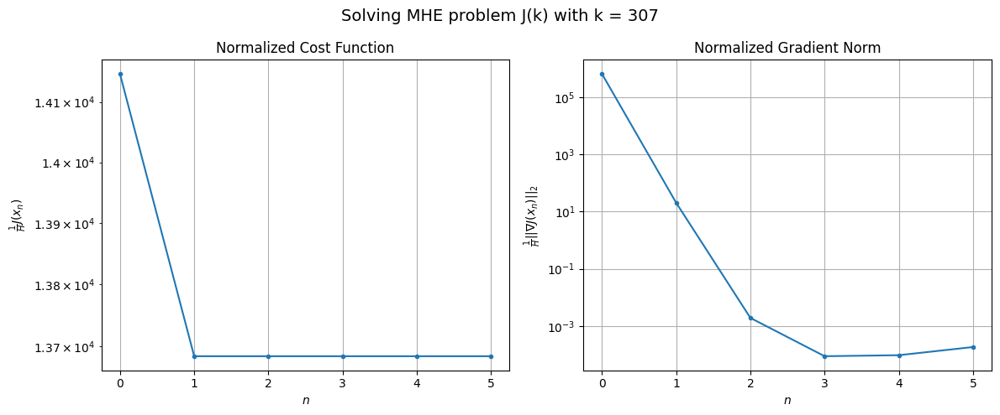

Windows:  76%|███████▌  | 269/356 [36:39<09:10,  6.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 608982.3141985214
Gradient norm: 26794903.041096006
Global estimation error: 53.316314211848066
Initial conditions estimation errors: 20.193405560358215 m, 27.079295937823957 m, 20.966258190444126 m, 35.52406987475812 m
Position estimation errors: 42.59479794055663 m, 39.907245118027724 m, 44.06646264108856 m, 37.85104242467787 m

[Gauss-Newton] Iteration 1
Cost function: 589377.9122045527 (-3.22%)
Gradient norm: 7561.481354470668 (-99.97%)
Global estimation error: 55.54736949486065 (4.18%)
Initial conditions estimation errors: 24.80751128929498 m, 27.705088148055086 m, 22.289007134824416 m, 34.72319968721203 m
Position estimation errors: 36.20723111891169 m, 33.24178908414935 m, 43.036241551585384 m, 32.32252493531578 m

[Gauss-Newton] Iteration 2
Cost function: 589377.8401322205 (-0.00%)
Gradient norm: 0.07931311149352928 (-100.00%)
Global estimation error: 55.67118961960908 (0.22%)
Initial conditions estimation errors: 24.8

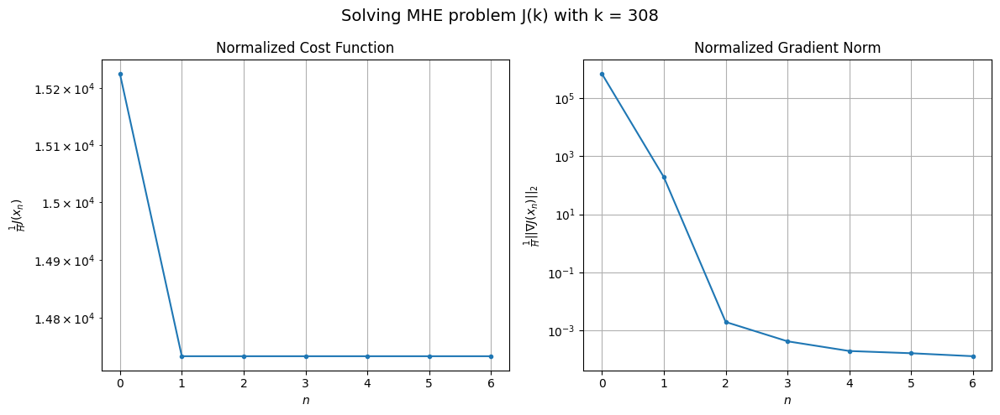

Windows:  76%|███████▌  | 270/356 [36:46<09:29,  6.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 652515.1725952615
Gradient norm: 27254493.078319807
Global estimation error: 47.96936024087782
Initial conditions estimation errors: 20.908181345068048 m, 23.98976820180842 m, 18.076679380834925 m, 31.009829203738583 m
Position estimation errors: 43.36982634551965 m, 40.67288481259792 m, 50.30591989495485 m, 39.56539262763125 m

[Gauss-Newton] Iteration 1
Cost function: 631913.3885259215 (-3.16%)
Gradient norm: 1158.990531249217 (-100.00%)
Global estimation error: 55.86835694265252 (16.47%)
Initial conditions estimation errors: 25.54781707865323 m, 29.119131577372915 m, 23.27630353787479 m, 32.84580470990512 m
Position estimation errors: 36.73931932647626 m, 33.72583853935753 m, 41.480524444827196 m, 32.44746699288692 m

[Gauss-Newton] Iteration 2
Cost function: 631913.3871348616 (-0.00%)
Gradient norm: 0.10608887923969111 (-99.99%)
Global estimation error: 55.881578875855816 (0.02%)
Initial conditions estimation errors: 25.54

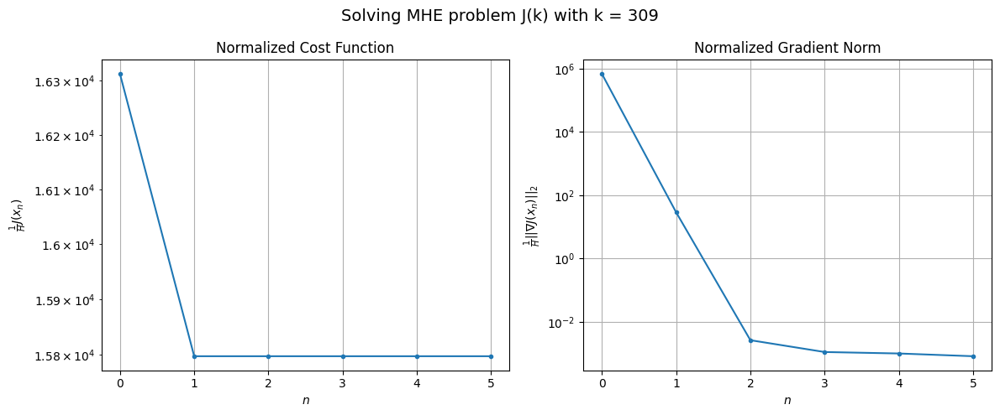

Windows:  76%|███████▌  | 271/356 [36:53<09:11,  6.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 695071.9572191259
Gradient norm: 27456633.278314944
Global estimation error: 48.68365150468848
Initial conditions estimation errors: 21.59648130412755 m, 25.685460235438104 m, 18.920030690923912 m, 29.765034680255404 m
Position estimation errors: 43.74797836524917 m, 40.871942142405764 m, 49.153535186086984 m, 39.45967490375591 m

[Gauss-Newton] Iteration 1
Cost function: 673855.4579908628 (-3.05%)
Gradient norm: 290.27462680092816 (-100.00%)
Global estimation error: 54.508943760601916 (11.97%)
Initial conditions estimation errors: 26.230450553687664 m, 28.24169344908927 m, 22.583581609354 m, 31.2338199485693 m
Position estimation errors: 36.948847383972094 m, 34.68453972569641 m, 41.49751744517645 m, 33.016132232889845 m

[Gauss-Newton] Iteration 2
Cost function: 673855.4578074422 (-0.00%)
Gradient norm: 0.04945035267958658 (-99.98%)
Global estimation error: 54.513281581076996 (0.01%)
Initial conditions estimation errors: 26.

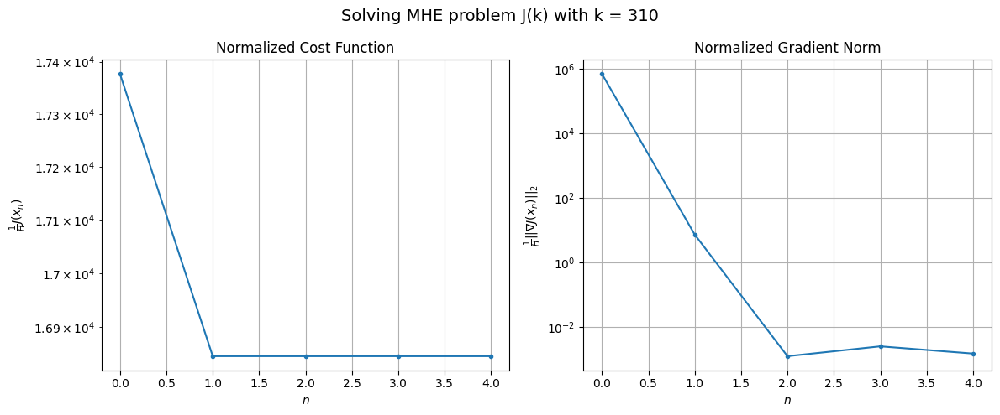

Windows:  76%|███████▋  | 272/356 [36:58<08:36,  6.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 735944.0501088309
Gradient norm: 27518062.84029505
Global estimation error: 46.5283405679523
Initial conditions estimation errors: 22.26086425664463 m, 24.28598121721955 m, 18.359906634392875 m, 27.247443214939377 m
Position estimation errors: 43.75935127301996 m, 41.76617001856917 m, 48.40635423194575 m, 40.220927741342635 m

[Gauss-Newton] Iteration 1
Cost function: 714260.428420358 (-2.95%)
Gradient norm: 5272.934103450766 (-99.98%)
Global estimation error: 55.64210900137803 (19.59%)
Initial conditions estimation errors: 26.88875027841693 m, 27.451868718466123 m, 20.190526739077587 m, 34.81016597839515 m
Position estimation errors: 36.82749949737721 m, 33.61170084170761 m, 50.25359376511744 m, 39.81530478428426 m

[Gauss-Newton] Iteration 2
Cost function: 714260.4046901865 (-0.00%)
Gradient norm: 0.11995487502225283 (-100.00%)
Global estimation error: 55.703065169203114 (0.11%)
Initial conditions estimation errors: 26.88874

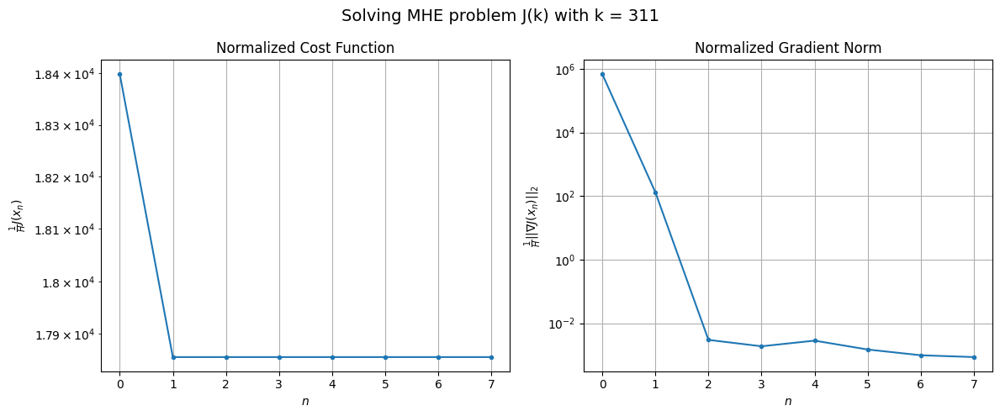

Windows:  77%|███████▋  | 273/356 [37:06<09:18,  6.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 771572.626384364
Gradient norm: 27259533.076802496
Global estimation error: 46.4355086957209
Initial conditions estimation errors: 22.916098802755698 m, 22.78334511472354 m, 16.51828839785663 m, 28.968046928179277 m
Position estimation errors: 43.43818615012255 m, 40.53183950013883 m, 54.865996162043466 m, 45.84979375524334 m

[Gauss-Newton] Iteration 1
Cost function: 749835.2005273019 (-2.82%)
Gradient norm: 3167.956175143824 (-99.99%)
Global estimation error: 60.75818748790955 (30.84%)
Initial conditions estimation errors: 27.52442649412512 m, 27.564922179969813 m, 20.492475538562392 m, 41.88269442484206 m
Position estimation errors: 36.46008792875557 m, 35.63497534483828 m, 54.02671457700484 m, 54.97589725240819 m

[Gauss-Newton] Iteration 2
Cost function: 749835.1926244344 (-0.00%)
Gradient norm: 0.4131986961084787 (-99.99%)
Global estimation error: 60.82534314024195 (0.11%)
Initial conditions estimation errors: 27.5244254

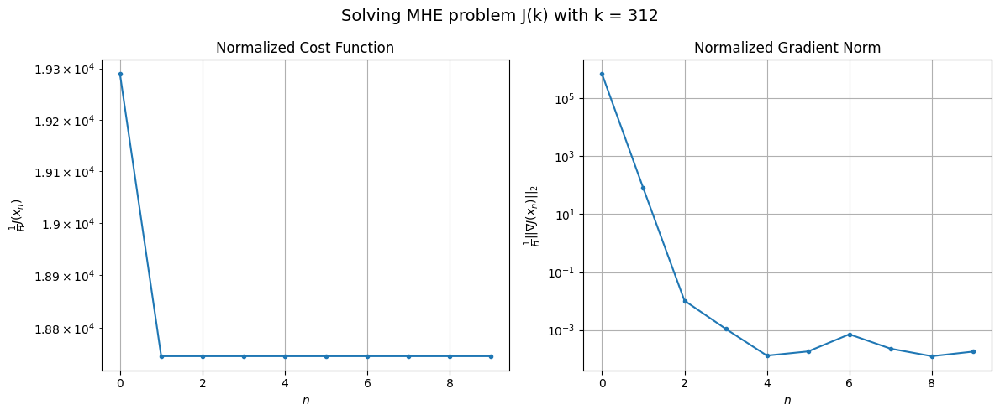

Windows:  77%|███████▋  | 274/356 [37:16<10:30,  7.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 804290.3009908882
Gradient norm: 27228387.627473313
Global estimation error: 50.52108040323429
Initial conditions estimation errors: 23.53228416080669 m, 22.406640214440397 m, 17.55885930440966 m, 34.470357094940596 m
Position estimation errors: 42.91231242576197 m, 42.10269308761686 m, 56.869058899666555 m, 58.770584592055165 m

[Gauss-Newton] Iteration 1
Cost function: 782421.5061382577 (-2.72%)
Gradient norm: 3966.3605434082315 (-99.99%)
Global estimation error: 63.436148072748516 (25.56%)
Initial conditions estimation errors: 28.11406432541555 m, 32.025733161424384 m, 21.34196970336619 m, 41.86391421616876 m
Position estimation errors: 35.867984078476006 m, 34.865076219138764 m, 46.708996655201844 m, 43.39985616363573 m

[Gauss-Newton] Iteration 2
Cost function: 782421.4816186884 (-0.00%)
Gradient norm: 0.2645468391782089 (-99.99%)
Global estimation error: 63.461981619026 (0.04%)
Initial conditions estimation errors: 28.11

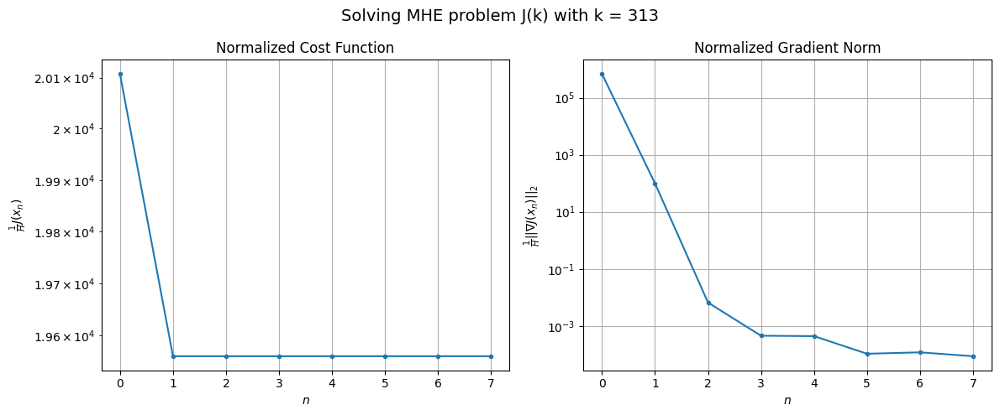

Windows:  77%|███████▋  | 275/356 [37:24<10:26,  7.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 831698.7290486437
Gradient norm: 26906769.482620418
Global estimation error: 54.2520081574329
Initial conditions estimation errors: 24.068713378939297 m, 27.335274458077603 m, 17.740465246052256 m, 36.08335273918082 m
Position estimation errors: 42.219832837382285 m, 41.50186266631457 m, 51.30689075526844 m, 48.793029997865744 m

[Gauss-Newton] Iteration 1
Cost function: 810151.9720500918 (-2.59%)
Gradient norm: 1657.5599663152677 (-99.99%)
Global estimation error: 60.125140169468416 (10.83%)
Initial conditions estimation errors: 28.630762704245395 m, 31.40371371280414 m, 24.524149599843422 m, 34.75135085442551 m
Position estimation errors: 35.22406283346242 m, 34.541855415841006 m, 38.660993822713955 m, 36.164318734069745 m

[Gauss-Newton] Iteration 2
Cost function: 810151.9702960672 (-0.00%)
Gradient norm: 0.08611029639584271 (-99.99%)
Global estimation error: 60.09905586774035 (-0.04%)
Initial conditions estimation errors: 

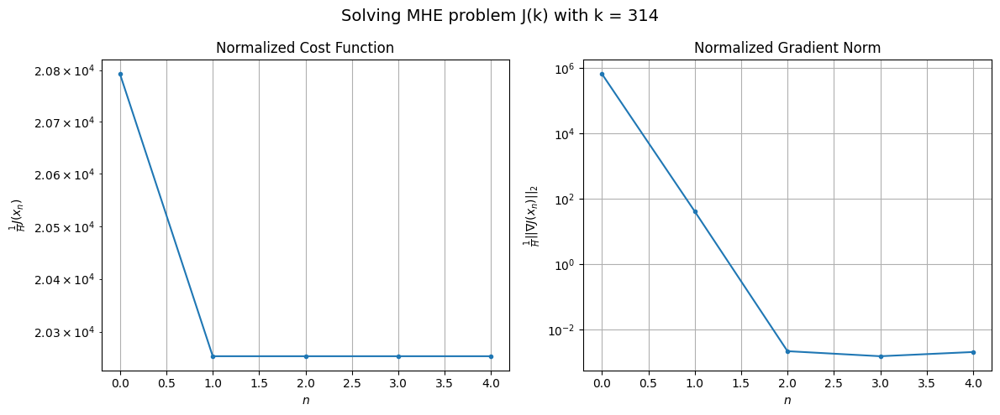

Windows:  78%|███████▊  | 276/356 [37:29<09:22,  7.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 856153.5157831818
Gradient norm: 26774128.183568545
Global estimation error: 51.188019929173315
Initial conditions estimation errors: 24.489737909704363 m, 26.810544298428486 m, 20.58181224776131 m, 29.63145721098489 m
Position estimation errors: 41.530704434113105 m, 41.21596845986055 m, 44.2650868896815 m, 42.62898959341778 m

[Gauss-Newton] Iteration 1
Cost function: 834717.1810855785 (-2.50%)
Gradient norm: 279.87280979478174 (-100.00%)
Global estimation error: 57.18128169145421 (11.71%)
Initial conditions estimation errors: 29.043120283853984 m, 30.61114320228088 m, 27.21490807128963 m, 27.35824805671416 m
Position estimation errors: 34.54400564523869 m, 34.289196094881795 m, 35.871902940833955 m, 34.99354463904006 m

[Gauss-Newton] Iteration 2
Cost function: 834717.1809926438 (-0.00%)
Gradient norm: 0.039332451498760114 (-99.99%)
Global estimation error: 57.16625579684431 (-0.03%)
Initial conditions estimation errors: 29

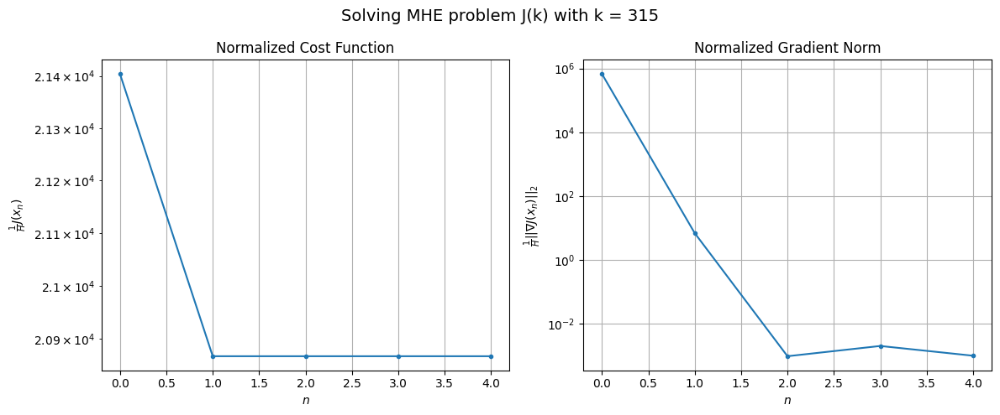

Windows:  78%|███████▊  | 277/356 [37:35<08:40,  6.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 876253.1443628496
Gradient norm: 26486542.669383626
Global estimation error: 48.194258389540416
Initial conditions estimation errors: 24.779719560603667 m, 25.885476859539313 m, 23.10768276900365 m, 22.463347709015984 m
Position estimation errors: 40.816930685137294 m, 40.855130847946725 m, 41.76905011279236 m, 41.70138104063415 m

[Gauss-Newton] Iteration 1
Cost function: 855070.3952105052 (-2.42%)
Gradient norm: 6621.41996712749 (-99.98%)
Global estimation error: 55.36987755851818 (14.89%)
Initial conditions estimation errors: 29.332913340385186 m, 27.423137304252734 m, 29.941877968989754 m, 23.597254602597772 m
Position estimation errors: 33.88206399783631 m, 36.53509220673974 m, 35.03652147953423 m, 46.30716216062009 m

[Gauss-Newton] Iteration 2
Cost function: 855070.3665580167 (-0.00%)
Gradient norm: 0.13204112170547122 (-100.00%)
Global estimation error: 55.37902416945673 (0.02%)
Initial conditions estimation errors: 29

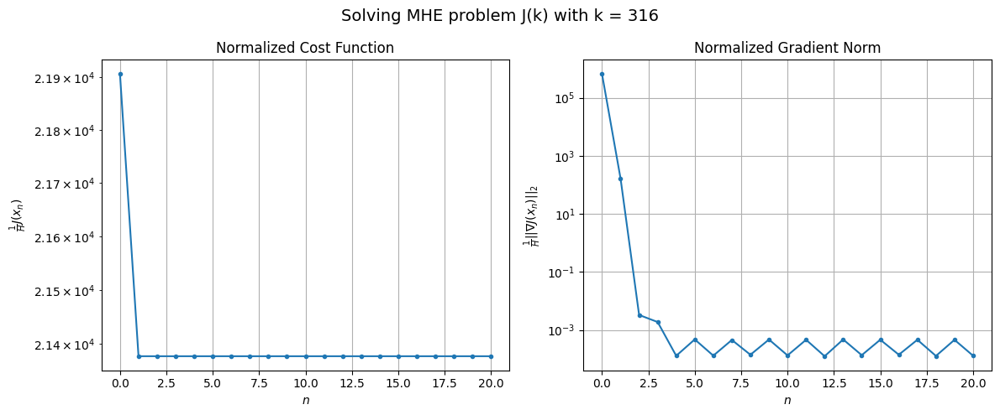

Windows:  78%|███████▊  | 278/356 [37:55<13:55, 10.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 892645.847028943
Gradient norm: 26129253.900320828
Global estimation error: 46.74567872201626
Initial conditions estimation errors: 24.96309136818047 m, 23.044898772729976 m, 24.762374812811746 m, 20.4385430202513 m
Position estimation errors: 40.08392419212845 m, 42.3661331057961 m, 41.61025553767355 m, 50.2371292060686 m

[Gauss-Newton] Iteration 1
Cost function: 871853.7892273787 (-2.33%)
Gradient norm: 412.92874801673315 (-100.00%)
Global estimation error: 55.18991841000075 (18.06%)
Initial conditions estimation errors: 29.519555366996805 m, 27.785811491558675 m, 28.388918379667253 m, 24.423592855652224 m
Position estimation errors: 33.24162010939209 m, 34.31734247002138 m, 34.945409721482044 m, 36.13490390962048 m

[Gauss-Newton] Iteration 2
Cost function: 871853.7890632442 (-0.00%)
Gradient norm: 0.04671208276668679 (-99.99%)
Global estimation error: 55.19869424910729 (0.02%)
Initial conditions estimation errors: 29.5195

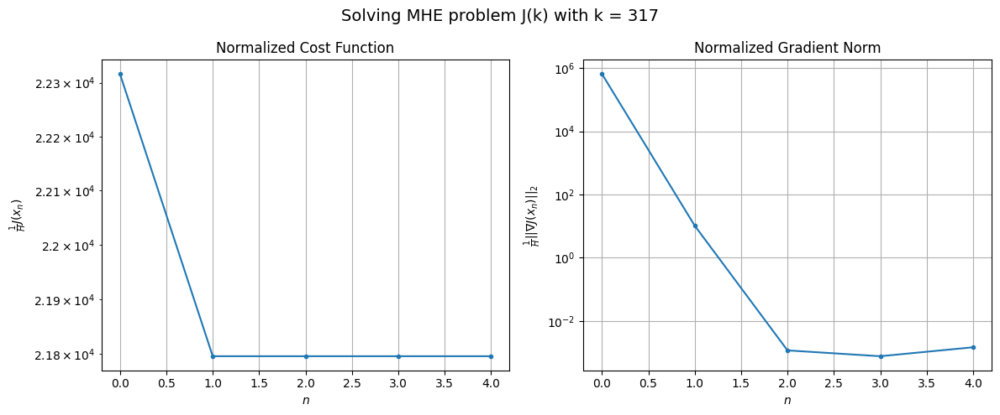

Windows:  78%|███████▊  | 279/356 [38:00<11:41,  9.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 905139.8649613559
Gradient norm: 25656422.514117163
Global estimation error: 46.40083851745563
Initial conditions estimation errors: 25.097072095422877 m, 23.4302873095465 m, 23.463800277315134 m, 20.582049020319392 m
Position estimation errors: 39.28570224639093 m, 40.19074694895605 m, 41.3119409932741 m, 40.86807892007382 m

[Gauss-Newton] Iteration 1
Cost function: 884848.1291932745 (-2.24%)
Gradient norm: 58.09284687288763 (-100.00%)
Global estimation error: 55.135081481991996 (18.82%)
Initial conditions estimation errors: 29.65173512309919 m, 27.737387665178915 m, 28.337077771950867 m, 24.25429981814593 m
Position estimation errors: 32.56047963632099 m, 32.47149107414645 m, 32.861120248707806 m, 35.50666356048803 m

[Gauss-Newton] Iteration 2
Cost function: 884848.1291568398 (-0.00%)
Gradient norm: 0.06689387846794005 (-99.88%)
Global estimation error: 55.134088104415774 (-0.00%)
Initial conditions estimation errors: 29.6

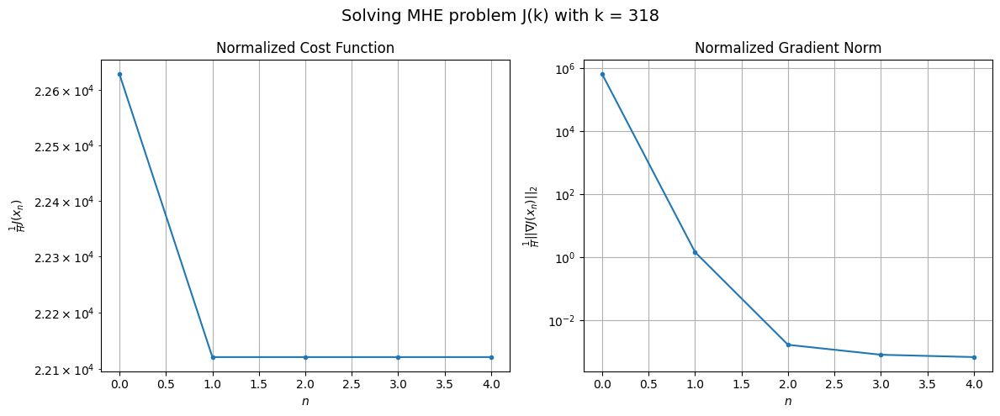

Windows:  79%|███████▊  | 280/356 [38:06<10:08,  8.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 913927.6745118736
Gradient norm: 25194981.21929981
Global estimation error: 46.59690250369263
Initial conditions estimation errors: 25.229449314329642 m, 23.476483277586247 m, 23.62661403132685 m, 20.624241057999296 m
Position estimation errors: 38.33603356399087 m, 38.0233279320039 m, 38.73993634530351 m, 39.7723978050177 m

[Gauss-Newton] Iteration 1
Cost function: 894085.2742360707 (-2.17%)
Gradient norm: 471.9814195688059 (-100.00%)
Global estimation error: 55.01648532254844 (18.07%)
Initial conditions estimation errors: 29.83115092946766 m, 26.12698796896664 m, 27.838655230628614 m, 26.06295629459026 m
Position estimation errors: 31.758416856234394 m, 32.71479826722887 m, 32.147370249114324 m, 35.837949585747026 m

[Gauss-Newton] Iteration 2
Cost function: 894085.2733396741 (-0.00%)
Gradient norm: 0.3563737434160764 (-99.92%)
Global estimation error: 55.06174907967136 (0.08%)
Initial conditions estimation errors: 29.83115

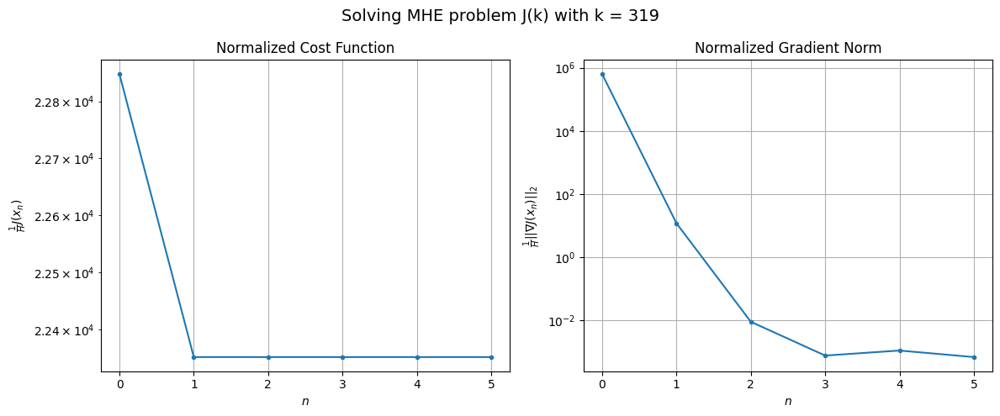

Windows:  79%|███████▉  | 281/356 [38:12<09:21,  7.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 918862.8143498366
Gradient norm: 24493975.901944563
Global estimation error: 47.42661467109176
Initial conditions estimation errors: 25.421226691889146 m, 22.197107747144095 m, 23.424226555499118 m, 23.698399018058726 m
Position estimation errors: 37.16064770914852 m, 37.94929293217261 m, 37.61340627531111 m, 40.69692467540265 m

[Gauss-Newton] Iteration 1
Cost function: 899647.7442732104 (-2.09%)
Gradient norm: 2269.5813812867186 (-99.99%)
Global estimation error: 59.89215221933883 (26.28%)
Initial conditions estimation errors: 30.06027538046851 m, 30.170892869792198 m, 27.825330252183186 m, 31.605176478083788 m
Position estimation errors: 30.770184573134976 m, 31.641907392771465 m, 31.74433419024628 m, 33.910468440722624 m

[Gauss-Newton] Iteration 2
Cost function: 899647.7409650321 (-0.00%)
Gradient norm: 0.9915405284839995 (-99.96%)
Global estimation error: 60.07200558271214 (0.30%)
Initial conditions estimation errors: 30

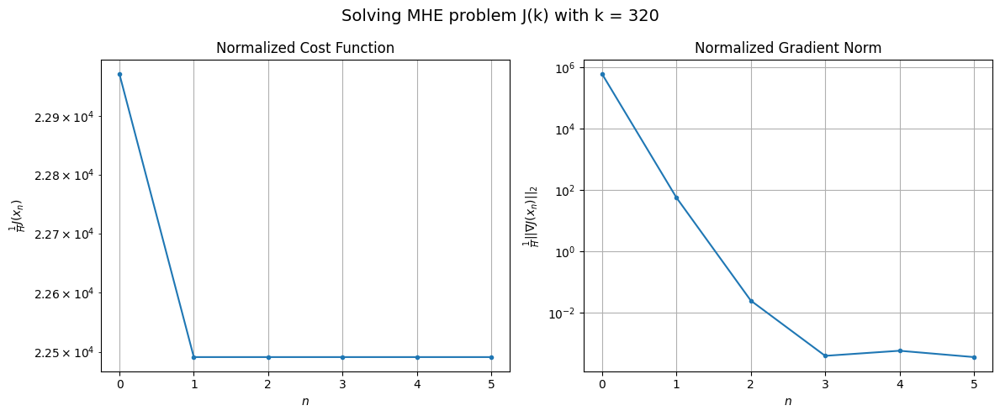

Windows:  79%|███████▉  | 282/356 [38:18<08:46,  7.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 917982.3485823382
Gradient norm: 23383213.49020588
Global estimation error: 51.00147930494045
Initial conditions estimation errors: 25.665687764207803 m, 25.633278912584544 m, 23.683324215104758 m, 26.915252144252605 m
Position estimation errors: 35.69890646730919 m, 36.6194135595729 m, 36.524054892674734 m, 38.89381372962109 m

[Gauss-Newton] Iteration 1
Cost function: 899639.8452372142 (-2.00%)
Gradient norm: 152.35392424737609 (-100.00%)
Global estimation error: 62.21631948241726 (21.99%)
Initial conditions estimation errors: 30.35175745383655 m, 30.143372336476887 m, 30.93211069251279 m, 32.92704488526547 m
Position estimation errors: 29.573656755018337 m, 30.636004690964217 m, 29.768774748032033 m, 36.547792363662154 m

[Gauss-Newton] Iteration 2
Cost function: 899639.845111861 (-0.00%)
Gradient norm: 0.08286635512983982 (-99.95%)
Global estimation error: 62.27507584524963 (0.09%)
Initial conditions estimation errors: 30.

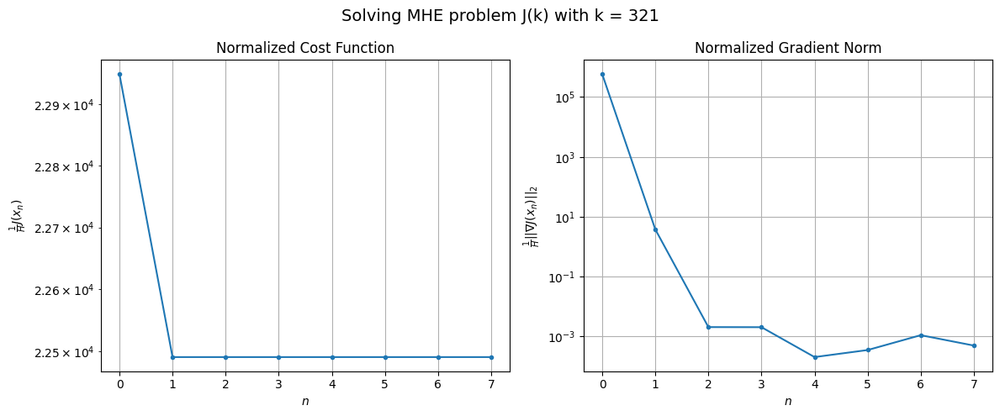

Windows:  79%|███████▉  | 283/356 [38:26<09:00,  7.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 911145.6544883479
Gradient norm: 22212062.315807108
Global estimation error: 53.05623519818508
Initial conditions estimation errors: 25.98718926110077 m, 25.633105988434764 m, 26.63953740942142 m, 27.800706063525595 m
Position estimation errors: 33.94388166383901 m, 34.99871590119038 m, 33.99882791092631 m, 40.613683228550954 m

[Gauss-Newton] Iteration 1
Cost function: 893630.9555040885 (-1.92%)
Gradient norm: 803.7997877332828 (-100.00%)
Global estimation error: 62.579887290022015 (17.95%)
Initial conditions estimation errors: 30.75463244311133 m, 30.204467590832436 m, 34.11643213192173 m, 29.901871625466264 m
Position estimation errors: 28.118679139032178 m, 28.65469954197722 m, 28.882278443477876 m, 29.568241231595586 m

[Gauss-Newton] Iteration 2
Cost function: 893630.9548139896 (-0.00%)
Gradient norm: 0.8070419339420811 (-99.90%)
Global estimation error: 62.64023933646212 (0.10%)
Initial conditions estimation errors: 30.

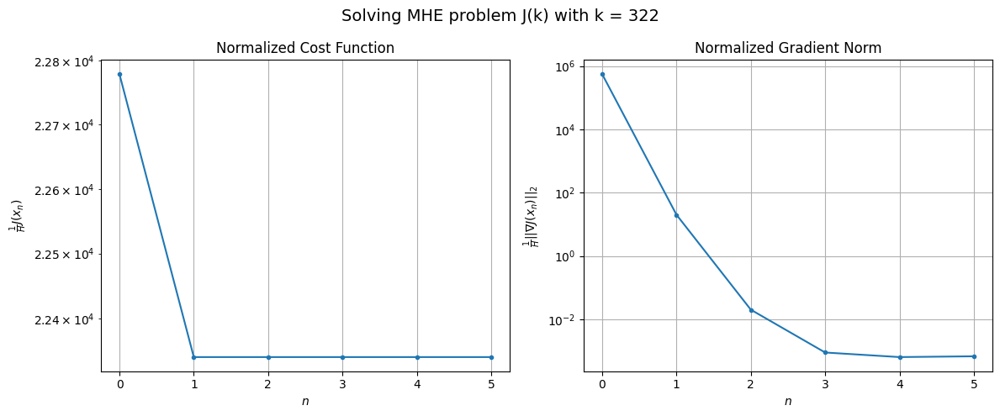

Windows:  80%|███████▉  | 284/356 [38:33<08:25,  7.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 897848.2888804051
Gradient norm: 20944107.60885603
Global estimation error: 54.547836084783576
Initial conditions estimation errors: 26.394930079116378 m, 26.244778613426476 m, 29.571788581700062 m, 26.74817926418074 m
Position estimation errors: 31.908905552029456 m, 32.46213018548866 m, 32.826313731447975 m, 33.47131242349966 m

[Gauss-Newton] Iteration 1
Cost function: 881222.0342947445 (-1.85%)
Gradient norm: 47.395237221983855 (-100.00%)
Global estimation error: 64.16029613451872 (17.62%)
Initial conditions estimation errors: 31.25157662628175 m, 30.71595580701768 m, 34.578526106589095 m, 31.633919991130853 m
Position estimation errors: 26.436908542642755 m, 25.908064490731178 m, 26.401907369764867 m, 27.436319714635722 m

[Gauss-Newton] Iteration 2
Cost function: 881222.0343115998 (0.00%)
Gradient norm: 0.10509711206777542 (-99.78%)
Global estimation error: 64.16023261822114 (-0.00%)
Initial conditions estimation errors:

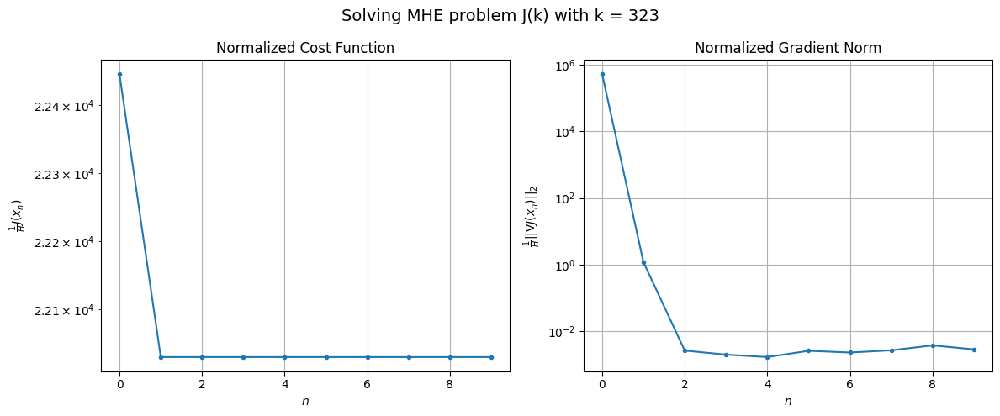

Windows:  80%|████████  | 285/356 [38:42<09:14,  7.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 875938.7330777153
Gradient norm: 19501427.66740249
Global estimation error: 56.400430771436106
Initial conditions estimation errors: 26.80523230237911 m, 27.085782876255276 m, 29.960683439741803 m, 28.83009389388916 m
Position estimation errors: 29.72077723236396 m, 29.052367432781303 m, 29.7670381399208 m, 30.80257125544581 m

[Gauss-Newton] Iteration 1
Cost function: 859980.6058344777 (-1.82%)
Gradient norm: 571.235985804276 (-100.00%)
Global estimation error: 67.64451078558226 (19.94%)
Initial conditions estimation errors: 31.819175226623003 m, 32.49224681115613 m, 35.083970935600625 m, 35.73029611828919 m
Position estimation errors: 24.63969072955007 m, 24.689294957600843 m, 26.74053178560546 m, 27.638866343246406 m

[Gauss-Newton] Iteration 2
Cost function: 859980.6055868827 (-0.00%)
Gradient norm: 0.257053044997602 (-99.96%)
Global estimation error: 67.735705304441 (0.13%)
Initial conditions estimation errors: 31.8191758

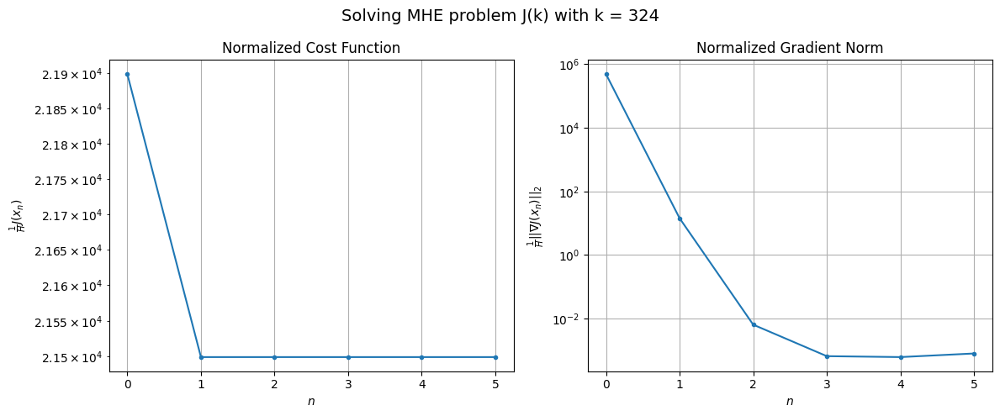

Windows:  80%|████████  | 286/356 [38:48<08:33,  7.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 847307.0536519642
Gradient norm: 18097264.303279784
Global estimation error: 59.891337334277196
Initial conditions estimation errors: 27.191731093883455 m, 28.890117898724487 m, 30.144969690621487 m, 33.22937298706701 m
Position estimation errors: 27.544050126779783 m, 27.325389258476573 m, 29.726725765452912 m, 30.2937845028536 m

[Gauss-Newton] Iteration 1
Cost function: 832043.9798173262 (-1.80%)
Gradient norm: 36.92354345700979 (-100.00%)
Global estimation error: 69.21870910395403 (15.57%)
Initial conditions estimation errors: 32.31099161532746 m, 33.4352796094493 m, 35.939993338176066 m, 36.573092248193724 m
Position estimation errors: 22.83861149965723 m, 21.941994834384086 m, 25.35144086959406 m, 24.97435757850417 m

[Gauss-Newton] Iteration 2
Cost function: 832043.9797634605 (-0.00%)
Gradient norm: 0.11103908136267421 (-99.70%)
Global estimation error: 69.1405034229469 (-0.11%)
Initial conditions estimation errors: 32.

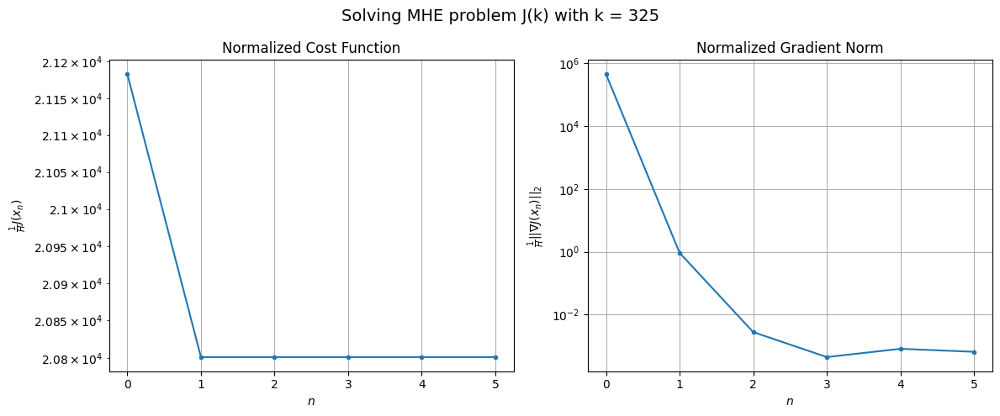

Windows:  81%|████████  | 287/356 [38:55<08:08,  7.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 812003.9653241069
Gradient norm: 16718498.836382207
Global estimation error: 60.57881872727751
Initial conditions estimation errors: 27.496167146365828 m, 29.401209997243633 m, 30.82474028656776 m, 33.153039313513666 m
Position estimation errors: 25.47588872896643 m, 24.241869953661475 m, 27.944897248195534 m, 27.089004480602824 m

[Gauss-Newton] Iteration 1
Cost function: 797408.7253148935 (-1.80%)
Gradient norm: 1695.837692919613 (-99.99%)
Global estimation error: 84.57424398062135 (39.61%)
Initial conditions estimation errors: 32.716304782548875 m, 39.21979365255431 m, 39.82617011368084 m, 54.3883354292786 m
Position estimation errors: 21.16165512831381 m, 25.482704347212085 m, 31.263013596390113 m, 42.86952257099449 m

[Gauss-Newton] Iteration 2
Cost function: 797408.7215023574 (-0.00%)
Gradient norm: 2.0186292425099235 (-99.88%)
Global estimation error: 85.3670889317015 (0.94%)
Initial conditions estimation errors: 32.716

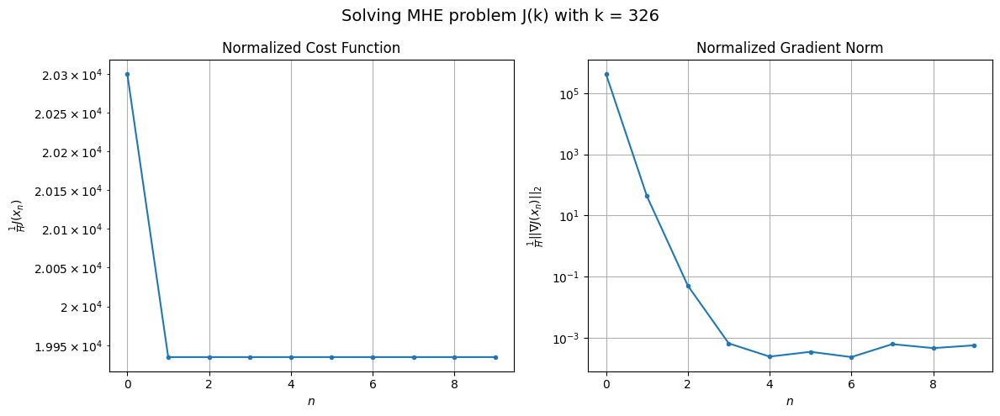

Windows:  81%|████████  | 288/356 [39:05<09:03,  8.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 772160.6062686736
Gradient norm: 15486405.88147572
Global estimation error: 78.04229883985509
Initial conditions estimation errors: 27.760331511332545 m, 35.88880343244009 m, 34.497394521259494 m, 53.30902779309366 m
Position estimation errors: 23.622944107360635 m, 27.54080914464193 m, 33.75621722985019 m, 45.08951757878673 m

[Gauss-Newton] Iteration 1
Cost function: 758116.569364765 (-1.82%)
Gradient norm: 190.15741714155385 (-100.00%)
Global estimation error: 89.61550678523459 (14.83%)
Initial conditions estimation errors: 33.063797780681504 m, 41.34671786505399 m, 41.46454812652028 m, 59.235325327725086 m
Position estimation errors: 19.655556849839762 m, 26.233841541139803 m, 34.90938633009847 m, 48.524705879343045 m

[Gauss-Newton] Iteration 2
Cost function: 758116.5693434052 (-0.00%)
Gradient norm: 0.03862584374369583 (-99.98%)
Global estimation error: 89.63558582671578 (0.02%)
Initial conditions estimation errors: 33.0

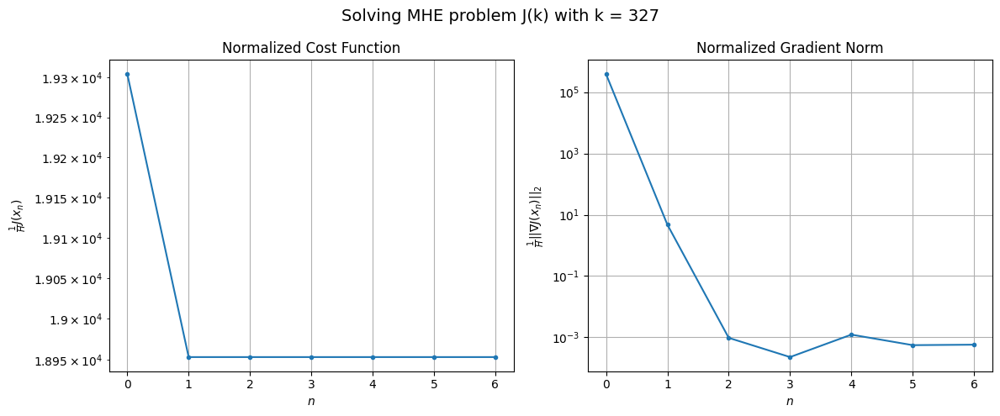

Windows:  81%|████████  | 289/356 [39:12<08:35,  7.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 728213.1473582467
Gradient norm: 14453100.586060856
Global estimation error: 81.86736725738508
Initial conditions estimation errors: 27.97590494495563 m, 37.786396958452535 m, 35.79027464767332 m, 56.66411080367552 m
Position estimation errors: 22.03645500223614 m, 27.67272580120586 m, 36.970138530676024 m, 49.32392021675471 m

[Gauss-Newton] Iteration 1
Cost function: 714462.5601649798 (-1.89%)
Gradient norm: 727.7057783202288 (-99.99%)
Global estimation error: 76.95664898914923 (-6.00%)
Initial conditions estimation errors: 33.392977254387034 m, 37.79928006511124 m, 36.50855971023113 m, 45.22754615091995 m
Position estimation errors: 18.380068185208447 m, 20.70538359654428 m, 28.784712772366 m, 31.64606504131231 m

[Gauss-Newton] Iteration 2
Cost function: 714462.5589365622 (-0.00%)
Gradient norm: 0.38016504629485026 (-99.95%)
Global estimation error: 76.75927425554804 (-0.26%)
Initial conditions estimation errors: 33.392978

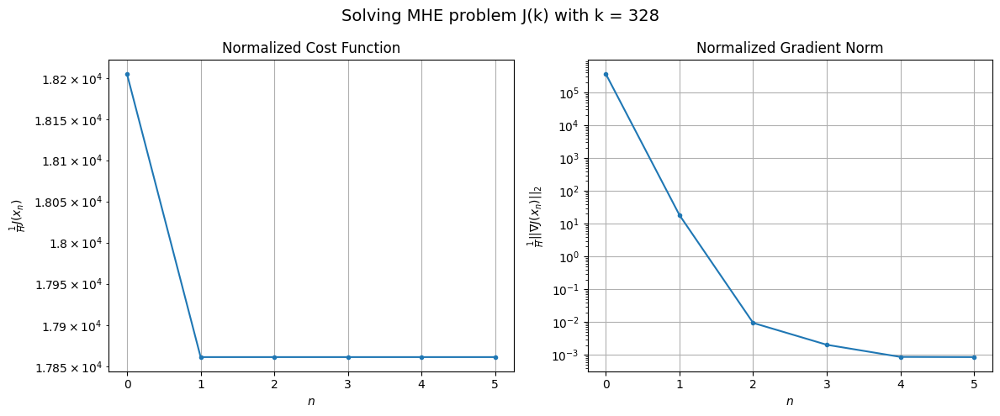

Windows:  81%|████████▏ | 290/356 [39:19<08:05,  7.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 680480.2393633244
Gradient norm: 13301995.907368517
Global estimation error: 67.23774374564258
Initial conditions estimation errors: 28.138567971630923 m, 33.452940129825876 m, 30.646929711833153 m, 40.87494948904451 m
Position estimation errors: 20.776488975603097 m, 22.230841681104717 m, 30.672479473743703 m, 31.949354371504 m

[Gauss-Newton] Iteration 1
Cost function: 667007.3519002193 (-1.98%)
Gradient norm: 620.9649691391293 (-100.00%)
Global estimation error: 71.16697604236057 (5.84%)
Initial conditions estimation errors: 33.65616567974834 m, 35.551858547719355 m, 35.1599988995089 m, 37.83905622076733 m
Position estimation errors: 17.42437545119736 m, 16.405460751849933 m, 25.398952909380306 m, 18.658188277568918 m

[Gauss-Newton] Iteration 2
Cost function: 667007.3513800874 (-0.00%)
Gradient norm: 0.2547486630179235 (-99.96%)
Global estimation error: 71.07496102955322 (-0.13%)
Initial conditions estimation errors: 33.65

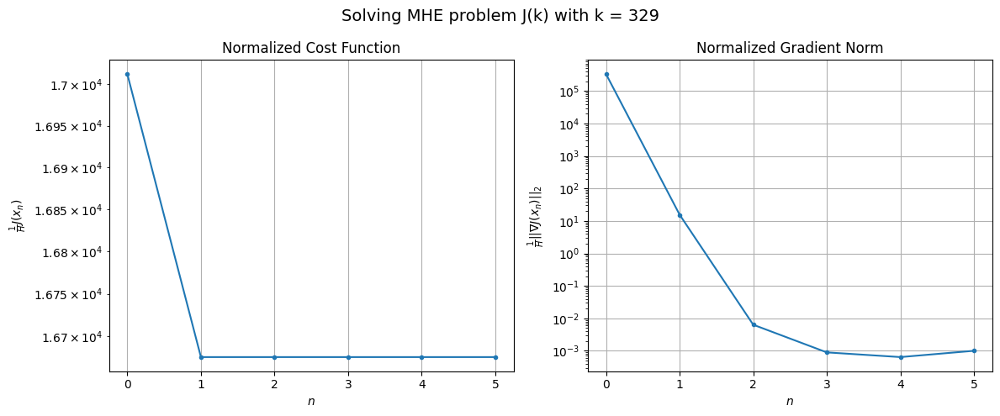

Windows:  82%|████████▏ | 291/356 [39:25<07:45,  7.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 629945.9082053767
Gradient norm: 12344346.842123324
Global estimation error: 60.28497552477033
Initial conditions estimation errors: 28.227823804165226 m, 30.6409341341939 m, 29.267142159733616 m, 32.27991554942857 m
Position estimation errors: 19.906323696298394 m, 18.436054010259717 m, 27.42031044336857 m, 20.299458845042007 m

[Gauss-Newton] Iteration 1
Cost function: 616551.686599897 (-2.13%)
Gradient norm: 137.9438589198516 (-100.00%)
Global estimation error: 71.41508632429432 (18.46%)
Initial conditions estimation errors: 33.855823244513665 m, 36.13098320796867 m, 34.68383541802145 m, 38.018826887658946 m
Position estimation errors: 16.79667777205101 m, 16.014207145807447 m, 25.96363428694623 m, 18.40979681887901 m

[Gauss-Newton] Iteration 2
Cost function: 616551.6865525164 (-0.00%)
Gradient norm: 0.01640383903373085 (-99.99%)
Global estimation error: 71.40897835973475 (-0.01%)
Initial conditions estimation errors: 33.8

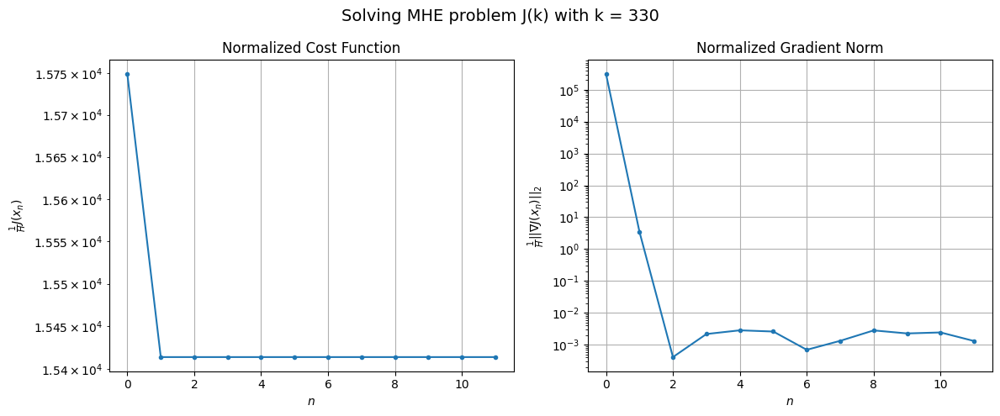

Windows:  82%|████████▏ | 292/356 [39:37<09:13,  8.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 578435.3581874943
Gradient norm: 11512646.566157958
Global estimation error: 59.93796677595138
Initial conditions estimation errors: 28.261596518128776 m, 30.878551014260584 m, 28.653544038717104 m, 31.926243291760304 m
Position estimation errors: 19.403128984303446 m, 18.00563686934253 m, 27.94092441735214 m, 19.809383215454126 m

[Gauss-Newton] Iteration 1
Cost function: 565187.7082385372 (-2.29%)
Gradient norm: 772.8869151765433 (-99.99%)
Global estimation error: 82.73906119293424 (38.04%)
Initial conditions estimation errors: 33.944308584621375 m, 41.090457960021865 m, 37.19873731399826 m, 51.198740105335354 m
Position estimation errors: 16.479282721811686 m, 20.122479869342907 m, 30.810289299624024 m, 34.05945988435216 m

[Gauss-Newton] Iteration 2
Cost function: 565187.7053882177 (-0.00%)
Gradient norm: 0.06969350336005752 (-99.99%)
Global estimation error: 82.7176315109165 (-0.03%)
Initial conditions estimation errors: 

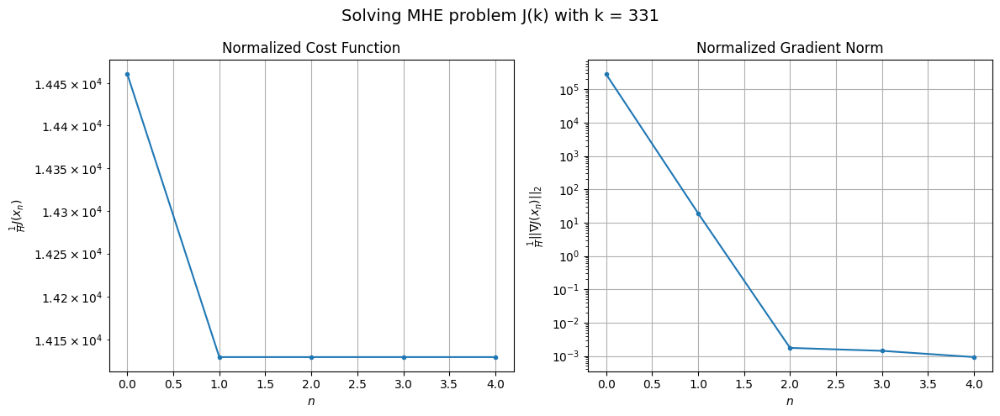

Windows:  82%|████████▏ | 293/356 [39:43<08:09,  7.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 525504.3136878697
Gradient norm: 10843929.511087209
Global estimation error: 72.230857456578
Initial conditions estimation errors: 28.149870924404013 m, 36.28392263477566 m, 30.754518168419914 m, 46.50233979547013 m
Position estimation errors: 19.224089449342653 m, 21.61086797445629 m, 33.00472899785221 m, 34.277860800044294 m

[Gauss-Newton] Iteration 1
Cost function: 512010.8746424427 (-2.57%)
Gradient norm: 616.411465117288 (-99.99%)
Global estimation error: 92.57949654668971 (28.17%)
Initial conditions estimation errors: 33.94513775053113 m, 45.20329812871987 m, 38.15325768921778 m, 62.606896288477 m
Position estimation errors: 16.403559847686672 m, 24.563239386463213 m, 34.99222931080409 m, 49.27984447836429 m

[Gauss-Newton] Iteration 2
Cost function: 512010.8742816936 (-0.00%)
Gradient norm: 0.04879985278929549 (-99.99%)
Global estimation error: 92.59513046746932 (0.02%)
Initial conditions estimation errors: 33.94513964

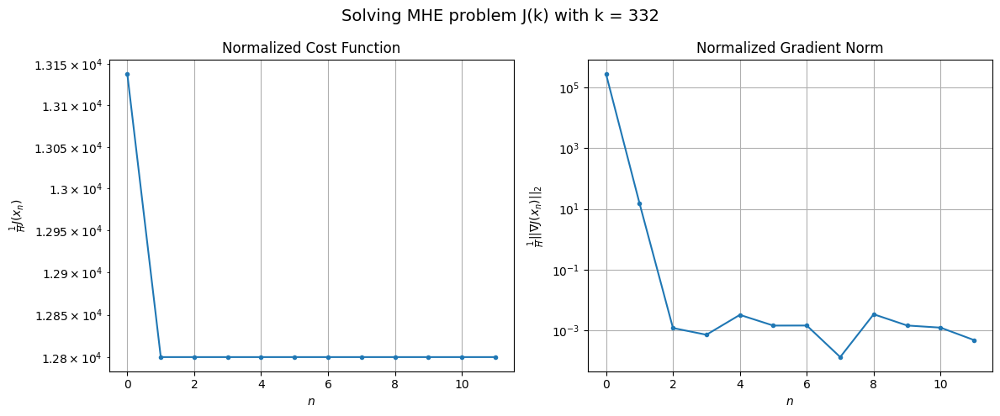

Windows:  83%|████████▎ | 294/356 [39:55<09:14,  8.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 473063.9380795058
Gradient norm: 10465279.714944977
Global estimation error: 82.23757696954512
Initial conditions estimation errors: 27.880694772597753 m, 40.473365531374434 m, 31.58776374354816 m, 57.87702946505078 m
Position estimation errors: 19.27787312371664 m, 25.413745243968872 m, 37.31475975854781 m, 48.848986703660486 m

[Gauss-Newton] Iteration 1
Cost function: 459599.6379223151 (-2.85%)
Gradient norm: 532.6472823994542 (-99.99%)
Global estimation error: 83.16651602273484 (1.13%)
Initial conditions estimation errors: 33.69217714494262 m, 41.65128208375312 m, 35.518903313203175 m, 52.77330820704688 m
Position estimation errors: 16.52482759218716 m, 19.6325009101896 m, 31.79084194026925 m, 35.62453918980491 m

[Gauss-Newton] Iteration 2
Cost function: 459599.637762006 (-0.00%)
Gradient norm: 0.01139416353543708 (-100.00%)
Global estimation error: 83.19544914129492 (0.03%)
Initial conditions estimation errors: 33.692178

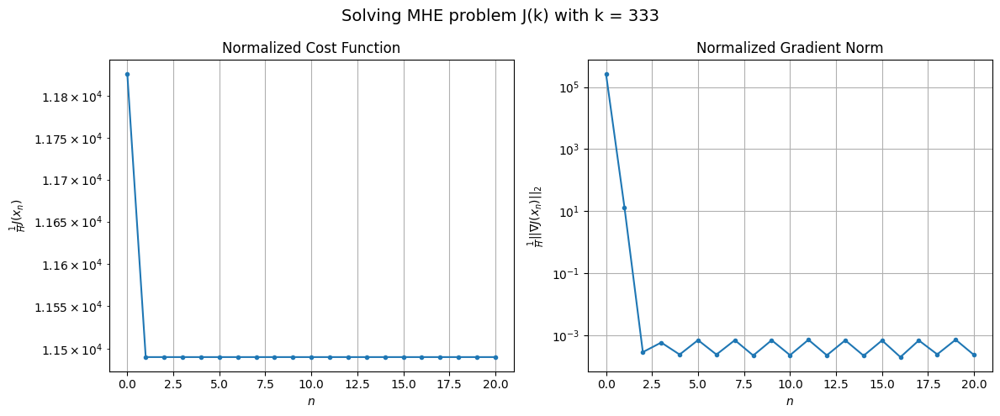

Windows:  83%|████████▎ | 295/356 [40:14<12:12, 12.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 422287.07934690255
Gradient norm: 10064798.332084285
Global estimation error: 71.73129907353749
Initial conditions estimation errors: 27.363926552353274 m, 36.34036676155372 m, 28.647026500536157 m, 47.48960563962047 m
Position estimation errors: 19.53617949307768 m, 20.87558030934936 m, 34.36352066393277 m, 35.33595166769755 m

[Gauss-Newton] Iteration 1
Cost function: 408911.40567602747 (-3.17%)
Gradient norm: 1238.514924551653 (-99.99%)
Global estimation error: 85.15156424639095 (18.71%)
Initial conditions estimation errors: 33.16489592478918 m, 42.731407798507156 m, 36.085323432261355 m, 54.979003006422275 m
Position estimation errors: 16.82706316564501 m, 18.379168550317903 m, 32.46464655210833 m, 27.251182629492277 m

[Gauss-Newton] Iteration 2
Cost function: 408911.40297347005 (-0.00%)
Gradient norm: 0.048015239015547904 (-100.00%)
Global estimation error: 85.04032205808122 (-0.13%)
Initial conditions estimation errors:

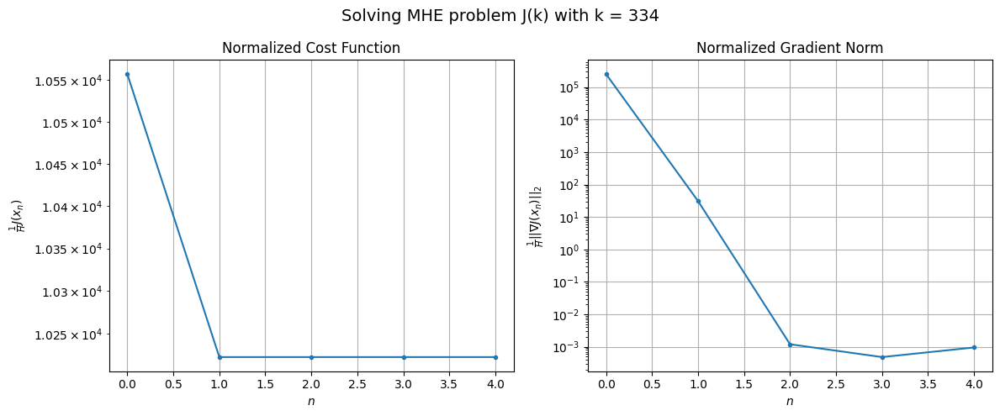

Windows:  83%|████████▎ | 296/356 [40:19<10:00, 10.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 373628.23695025285
Gradient norm: 9740122.34538469
Global estimation error: 74.98813723318638
Initial conditions estimation errors: 26.67390505289882 m, 37.73368583206506 m, 29.306351483391428 m, 51.27351609959585 m
Position estimation errors: 20.023526260177622 m, 19.943680113637015 m, 35.59187271641893 m, 28.46499946720191 m

[Gauss-Newton] Iteration 1
Cost function: 360329.9223034427 (-3.56%)
Gradient norm: 650.520907668369 (-99.99%)
Global estimation error: 80.16053168323943 (6.90%)
Initial conditions estimation errors: 32.45364214386405 m, 40.294760861686626 m, 33.708564516850316 m, 51.11234665140218 m
Position estimation errors: 17.321164508304815 m, 15.650480478645436 m, 29.520556400718515 m, 19.79967197225407 m

[Gauss-Newton] Iteration 2
Cost function: 360329.92204969923 (-0.00%)
Gradient norm: 0.044090540079860845 (-99.99%)
Global estimation error: 80.27841381698425 (0.15%)
Initial conditions estimation errors: 32.45

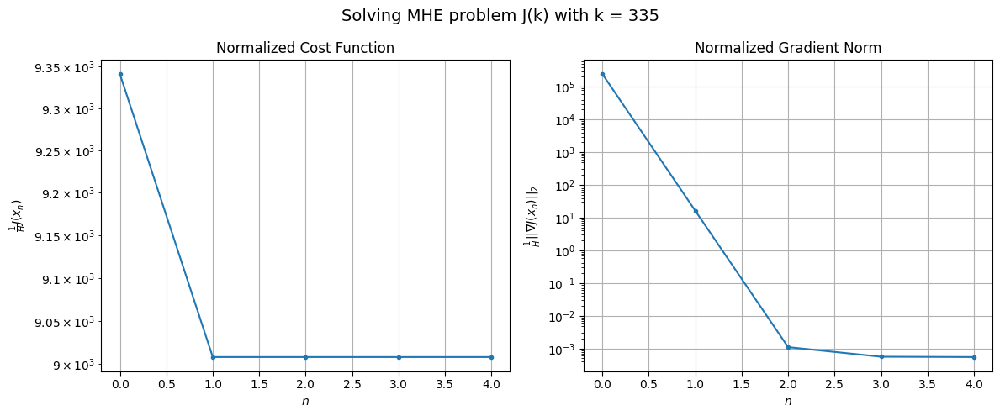

Windows:  83%|████████▎ | 297/356 [40:25<08:26,  8.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 329272.603615962
Gradient norm: 9896639.799302148
Global estimation error: 70.24525142297266
Initial conditions estimation errors: 25.903787737948523 m, 35.17264923911136 m, 26.853273269286035 m, 48.0116529541018 m
Position estimation errors: 20.727204346625 m, 18.020770320859558 m, 33.154322944016215 m, 22.03288492193128 m

[Gauss-Newton] Iteration 1
Cost function: 316362.2564186313 (-3.92%)
Gradient norm: 1195.2981778519706 (-99.99%)
Global estimation error: 99.86855828202629 (42.17%)
Initial conditions estimation errors: 31.557517139613 m, 45.765176155694824 m, 36.09873490537626 m, 74.70084663339004 m
Position estimation errors: 17.99314481639745 m, 17.17147591864959 m, 33.53355449709316 m, 28.383652455920547 m

[Gauss-Newton] Iteration 2
Cost function: 316362.2460375488 (-0.00%)
Gradient norm: 0.048911281055222605 (-100.00%)
Global estimation error: 99.76089303071868 (-0.11%)
Initial conditions estimation errors: 31.557518

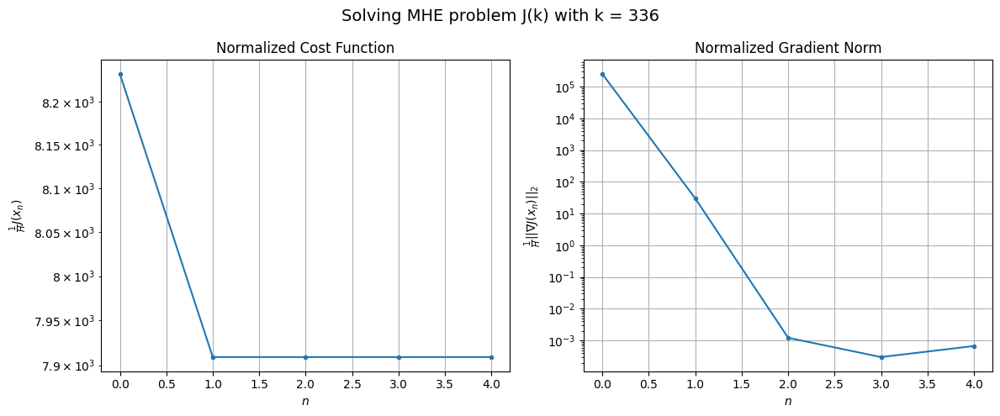

Windows:  84%|████████▎ | 298/356 [40:30<07:22,  7.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 289673.24983721634
Gradient norm: 9998671.775778944
Global estimation error: 93.39243722337609
Initial conditions estimation errors: 24.995142937433606 m, 41.34339300072175 m, 29.84669689615998 m, 74.1433162157071 m
Position estimation errors: 21.524851022871115 m, 19.555806111131616 m, 37.707227444946724 m, 31.418737657384025 m

[Gauss-Newton] Iteration 1
Cost function: 277151.57318784035 (-4.32%)
Gradient norm: 174.31895445059993 (-100.00%)
Global estimation error: 88.19699664772331 (-5.56%)
Initial conditions estimation errors: 30.51265153234637 m, 41.7005491137384 m, 32.239423053844845 m, 63.79112034768089 m
Position estimation errors: 18.75376710852812 m, 16.139043450658043 m, 33.10914051421688 m, 22.642320332351044 m

[Gauss-Newton] Iteration 2
Cost function: 277151.57295520796 (-0.00%)
Gradient norm: 0.08650094825800082 (-99.95%)
Global estimation error: 88.2438803356908 (0.05%)
Initial conditions estimation errors: 30.

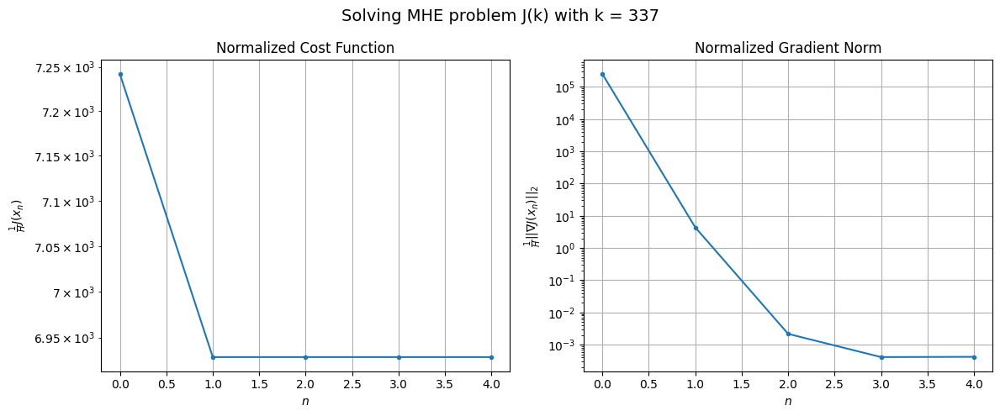

Windows:  84%|████████▍ | 299/356 [40:35<06:35,  6.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 256028.80108352838
Gradient norm: 10583463.94420119
Global estimation error: 80.57572680600471
Initial conditions estimation errors: 23.934775805546664 m, 36.99129253616252 m, 25.866426871165622 m, 62.306415431205934 m
Position estimation errors: 22.269893698652336 m, 18.703512260721144 m, 37.37102773476614 m, 25.064994171123253 m

[Gauss-Newton] Iteration 1
Cost function: 243832.92196892953 (-4.76%)
Gradient norm: 1007.5691263685152 (-99.99%)
Global estimation error: 71.39049624901656 (-11.40%)
Initial conditions estimation errors: 29.28980014142726 m, 34.880263589454984 m, 27.593027079176373 m, 47.546167863705804 m
Position estimation errors: 19.40272123160099 m, 16.70038633743473 m, 27.44701911690195 m, 16.306899918157274 m

[Gauss-Newton] Iteration 2
Cost function: 243832.92078686116 (-0.00%)
Gradient norm: 0.3992859938583648 (-99.96%)
Global estimation error: 71.79040749783685 (0.56%)
Initial conditions estimation errors:

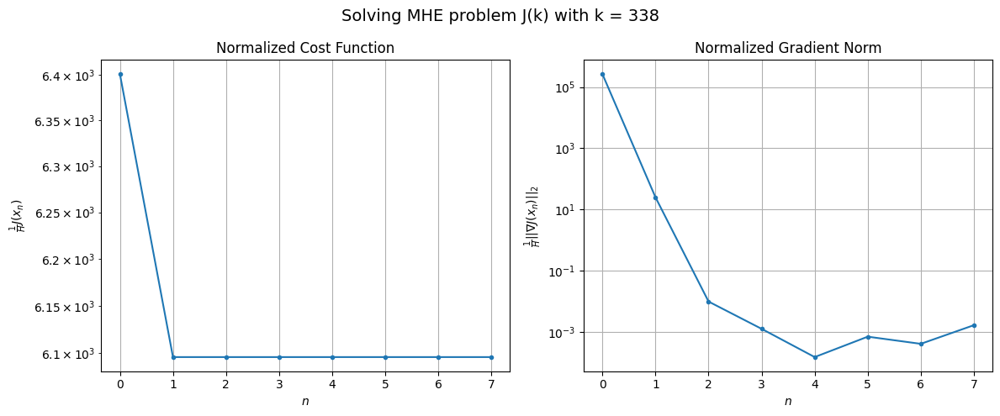

Windows:  84%|████████▍ | 300/356 [40:43<06:37,  7.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 227364.03792456133
Gradient norm: 11061528.632968402
Global estimation error: 62.579505341109005
Initial conditions estimation errors: 22.709385428388448 m, 29.58012428075108 m, 20.56422207753735 m, 45.853585307377635 m
Position estimation errors: 22.800935529301988 m, 19.79207703653631 m, 31.59964903636794 m, 18.664855976012827 m

[Gauss-Newton] Iteration 1
Cost function: 215847.98061745922 (-5.07%)
Gradient norm: 639.507155345962 (-99.99%)
Global estimation error: 56.88047955699998 (-9.11%)
Initial conditions estimation errors: 27.80743465943262 m, 28.293495882202244 m, 25.485117253343994 m, 31.812879619032728 m
Position estimation errors: 19.874138527568995 m, 21.786182185278076 m, 24.729371696402012 m, 23.973590908165953 m

[Gauss-Newton] Iteration 2
Cost function: 215847.97950530137 (-0.00%)
Gradient norm: 0.260166485628888 (-99.96%)
Global estimation error: 57.07895686359746 (0.35%)
Initial conditions estimation errors: 

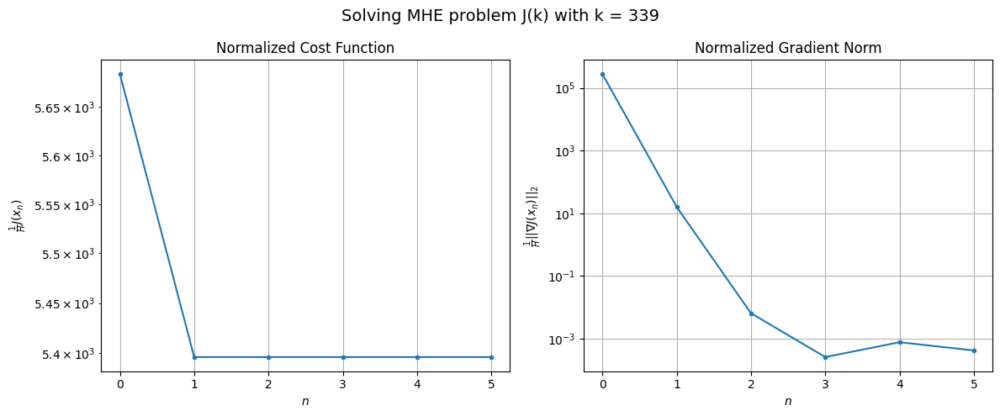

Windows:  85%|████████▍ | 301/356 [40:49<06:08,  6.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 203713.9678209829
Gradient norm: 11340679.594160128
Global estimation error: 45.47889858200964
Initial conditions estimation errors: 21.274676323077433 m, 22.191938165944713 m, 18.357288599555098 m, 28.039123988913154 m
Position estimation errors: 23.1380452901342 m, 24.901678239442862 m, 28.51082736973431 m, 25.9680953911565 m

[Gauss-Newton] Iteration 1
Cost function: 192836.7493872062 (-5.34%)
Gradient norm: 611.6235946790647 (-99.99%)
Global estimation error: 67.09267911661692 (47.52%)
Initial conditions estimation errors: 26.111641686155153 m, 32.4456475837937 m, 23.10051329220282 m, 47.256701009721255 m
Position estimation errors: 20.141437293528313 m, 17.938621484849666 m, 28.418410018813244 m, 18.79442806077117 m

[Gauss-Newton] Iteration 2
Cost function: 192836.74700754718 (-0.00%)
Gradient norm: 0.09056906613140335 (-99.99%)
Global estimation error: 66.89523360155603 (-0.29%)
Initial conditions estimation errors: 26.

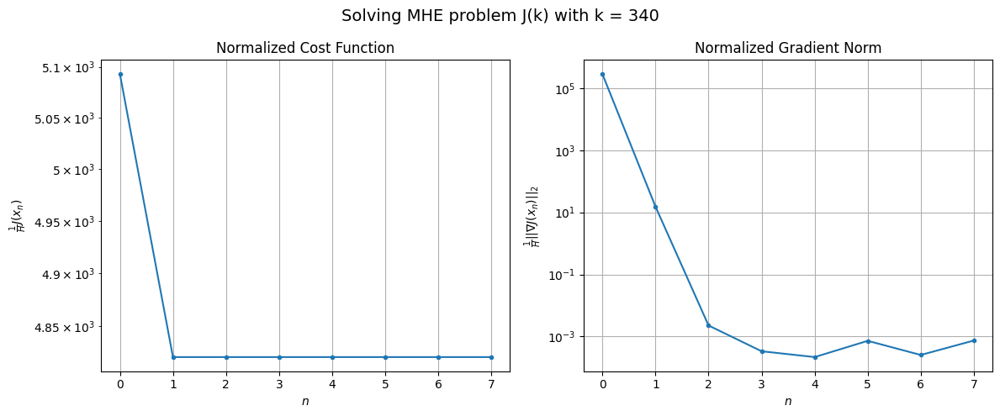

Windows:  85%|████████▍ | 302/356 [40:56<06:15,  6.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 185678.2828547068
Gradient norm: 11789074.06414062
Global estimation error: 59.394750220071614
Initial conditions estimation errors: 19.707094748116944 m, 27.402667454850423 m, 16.45388528365732 m, 46.01826317131724 m
Position estimation errors: 23.294339318464562 m, 20.801440381433203 m, 32.22573884628309 m, 19.874594007575187 m

[Gauss-Newton] Iteration 1
Cost function: 175700.44262235094 (-5.37%)
Gradient norm: 1865.3957594490012 (-99.98%)
Global estimation error: 44.38693539577058 (-25.27%)
Initial conditions estimation errors: 24.18415409928746 m, 22.370787481889575 m, 21.59248057807021 m, 20.45932963405506 m
Position estimation errors: 20.240312071633014 m, 22.904123007567293 m, 23.916849544837618 m, 29.747248180494978 m

[Gauss-Newton] Iteration 2
Cost function: 175700.41180294837 (-0.00%)
Gradient norm: 0.09770031674288923 (-99.99%)
Global estimation error: 44.35476934798443 (-0.07%)
Initial conditions estimation error

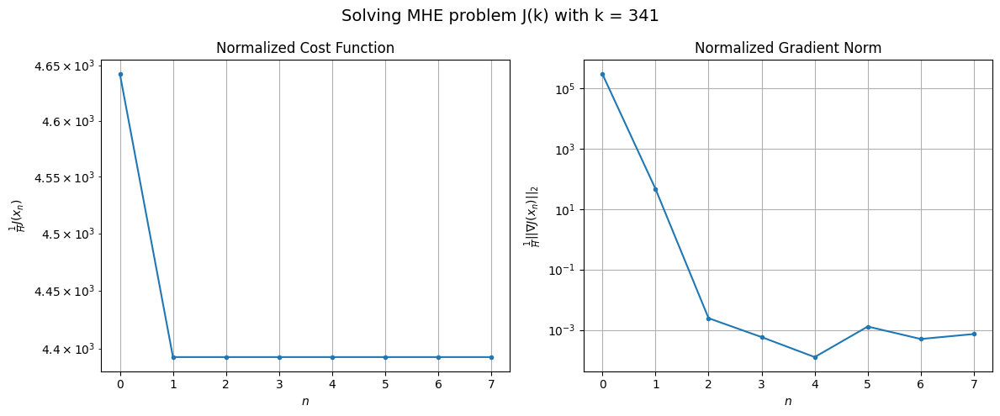

Windows:  85%|████████▌ | 303/356 [41:04<06:17,  7.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 173725.07209451502
Gradient norm: 12024264.740810178
Global estimation error: 31.92705132599028
Initial conditions estimation errors: 18.025988117095658 m, 15.956164389839024 m, 15.581883638470321 m, 14.034322846235632 m
Position estimation errors: 23.28280236377379 m, 26.07302580422877 m, 26.770788683300733 m, 32.73685982315424 m

[Gauss-Newton] Iteration 1
Cost function: 164779.8693822457 (-5.15%)
Gradient norm: 922.1318659832879 (-99.99%)
Global estimation error: 41.19995603929322 (29.04%)
Initial conditions estimation errors: 22.088290894700208 m, 18.48064209825634 m, 21.94326187225517 m, 19.65839778567478 m
Position estimation errors: 20.198452565151587 m, 25.897233451303645 m, 22.72353867832176 m, 27.63366460698903 m

[Gauss-Newton] Iteration 2
Cost function: 164779.86694018068 (-0.00%)
Gradient norm: 0.01908733051162212 (-100.00%)
Global estimation error: 41.16814882277415 (-0.08%)
Initial conditions estimation errors: 

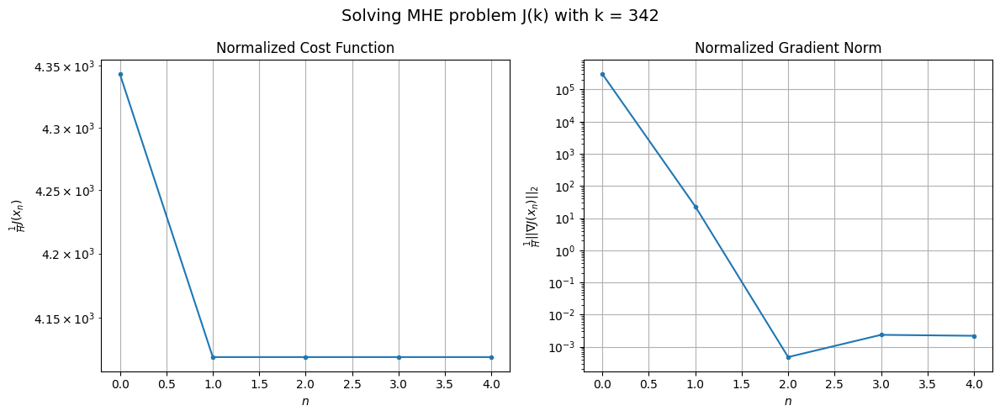

Windows:  85%|████████▌ | 304/356 [41:09<05:41,  6.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 167377.87826809328
Gradient norm: 11816463.080090044
Global estimation error: 30.992957338728917
Initial conditions estimation errors: 16.32445081174632 m, 12.350876645012034 m, 17.257784641951627 m, 15.609680624683696 m
Position estimation errors: 23.119958580239636 m, 29.28588334843778 m, 25.018594891353285 m, 31.86072920076781 m

[Gauss-Newton] Iteration 1
Cost function: 159448.57148067284 (-4.74%)
Gradient norm: 504.52369409814037 (-100.00%)
Global estimation error: 38.75225715154863 (25.04%)
Initial conditions estimation errors: 19.97118066268138 m, 16.609667901545297 m, 21.301238847270817 m, 19.318930138495183 m
Position estimation errors: 20.037216876821752 m, 22.32266855568647 m, 22.55409988144254 m, 22.76305822431226 m

[Gauss-Newton] Iteration 2
Cost function: 159448.5712098526 (-0.00%)
Gradient norm: 0.053496719819082654 (-99.99%)
Global estimation error: 38.73421762965879 (-0.05%)
Initial conditions estimation erro

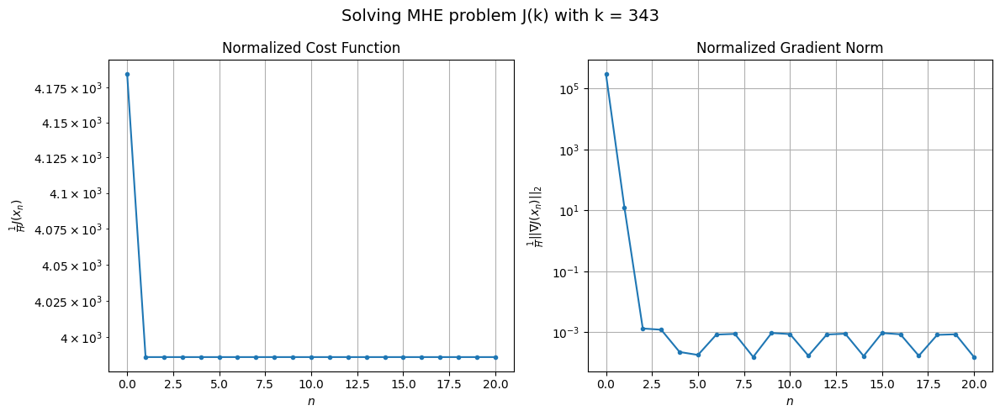

Windows:  86%|████████▌ | 305/356 [41:28<08:47, 10.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 165350.5548210375
Gradient norm: 11547592.464583267
Global estimation error: 30.684110400982664
Initial conditions estimation errors: 14.736633815441012 m, 10.883762173914944 m, 17.55493536993797 m, 17.253444917723996 m
Position estimation errors: 22.828870653321893 m, 25.774243401998643 m, 24.410301923043427 m, 27.59201283096392 m

[Gauss-Newton] Iteration 1
Cost function: 158329.39741197633 (-4.25%)
Gradient norm: 556.7492026228865 (-100.00%)
Global estimation error: 35.00462860942385 (14.08%)
Initial conditions estimation errors: 17.985474653159837 m, 15.661063973884655 m, 18.223267867524854 m, 18.012553929714198 m
Position estimation errors: 19.76861484669368 m, 18.18434675342874 m, 25.12009864576226 m, 18.175293504191963 m

[Gauss-Newton] Iteration 2
Cost function: 158329.39724824918 (-0.00%)
Gradient norm: 0.06066741491533335 (-99.99%)
Global estimation error: 34.96047201824922 (-0.13%)
Initial conditions estimation erro

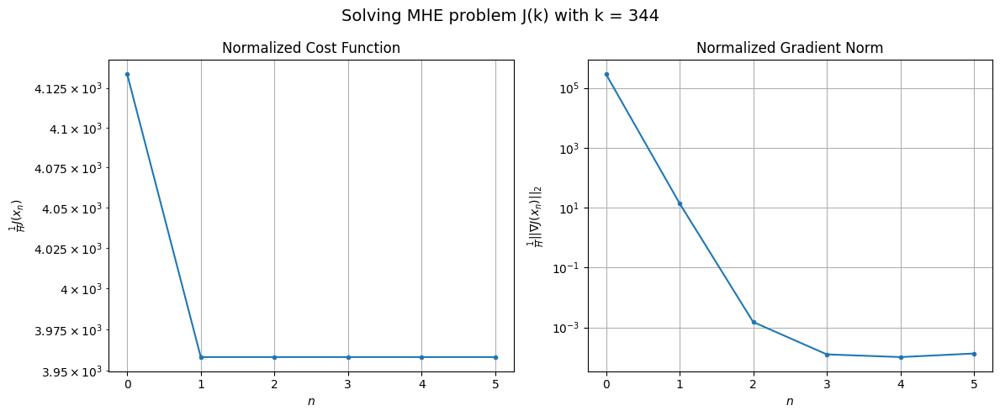

Windows:  86%|████████▌ | 306/356 [41:34<07:30,  9.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 167573.70488282153
Gradient norm: 11265412.634351239
Global estimation error: 27.727007769300997
Initial conditions estimation errors: 13.353538948791673 m, 10.270646003715342 m, 15.034174800025538 m, 16.091285785141537 m
Position estimation errors: 22.433663940370625 m, 21.52289934510995 m, 26.73089204535969 m, 22.91580997747231 m

[Gauss-Newton] Iteration 1
Cost function: 161400.00057769637 (-3.68%)
Gradient norm: 16.939282469606887 (-100.00%)
Global estimation error: 31.95077935245907 (15.23%)
Initial conditions estimation errors: 16.193530044087183 m, 14.006517642924035 m, 17.49944446165997 m, 16.0055823651376 m
Position estimation errors: 19.407725443009138 m, 17.238044881799528 m, 24.098480685960023 m, 18.86883471359847 m

[Gauss-Newton] Iteration 2
Cost function: 161400.00057598783 (-0.00%)
Gradient norm: 0.04156995155651732 (-99.75%)
Global estimation error: 31.941666359730142 (-0.03%)
Initial conditions estimation err

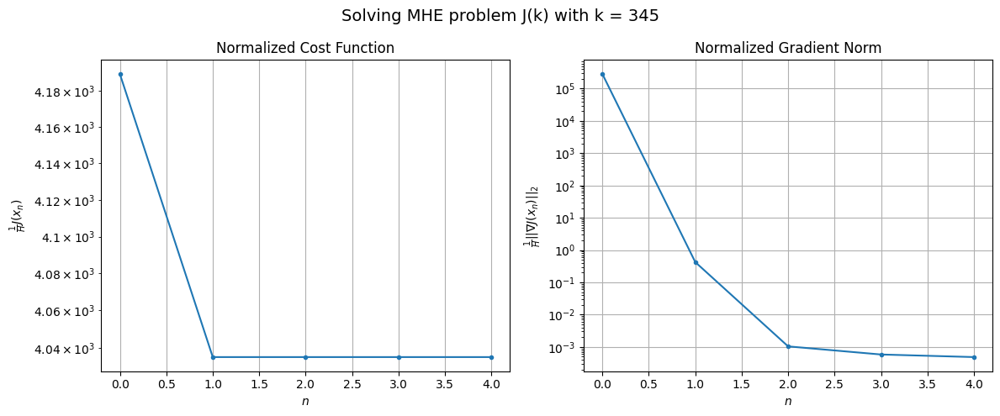

Windows:  86%|████████▌ | 307/356 [41:39<06:28,  7.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 172521.30444440874
Gradient norm: 10584312.430007959
Global estimation error: 26.335048442966396
Initial conditions estimation errors: 12.17963609353143 m, 9.183469882871709 m, 14.879554453219818 m, 15.473601372269744 m
Position estimation errors: 21.95407348842053 m, 20.483917742042667 m, 25.546783819985663 m, 23.543296825765506 m

[Gauss-Newton] Iteration 1
Cost function: 167135.4467892852 (-3.12%)
Gradient norm: 4531.9991032976795 (-99.96%)
Global estimation error: 39.45490633992952 (49.82%)
Initial conditions estimation errors: 14.656337451993814 m, 20.364833459059852 m, 9.318232452470918 m, 28.98807515728933 m
Position estimation errors: 19.02547654614508 m, 15.860699800076272 m, 28.89491790911202 m, 16.264778501806838 m

[Gauss-Newton] Iteration 2
Cost function: 167135.36286358716 (-0.00%)
Gradient norm: 0.5909317404111308 (-99.99%)
Global estimation error: 39.34169052152208 (-0.29%)
Initial conditions estimation errors:

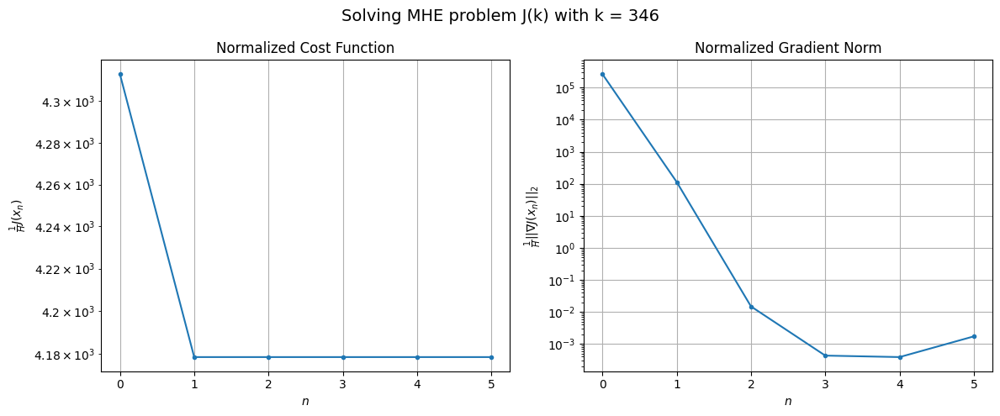

Windows:  87%|████████▋ | 308/356 [41:46<05:55,  7.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 179168.14064214635
Gradient norm: 9652598.317986012
Global estimation error: 34.687437114612244
Initial conditions estimation errors: 11.242207630560506 m, 16.99692499283203 m, 6.047200545558491 m, 27.41087470777427 m
Position estimation errors: 21.478226030840133 m, 18.427529346118764 m, 31.31044124518333 m, 17.227585822660703 m

[Gauss-Newton] Iteration 1
Cost function: 174493.21825554364 (-2.61%)
Gradient norm: 1030.9409910679144 (-99.99%)
Global estimation error: 49.097253976413484 (41.54%)
Initial conditions estimation errors: 13.403147166024436 m, 21.415526395921507 m, 8.155865819032833 m, 41.300624201283114 m
Position estimation errors: 18.691094379956603 m, 15.296132167793964 m, 26.17830980400427 m, 13.806862024382541 m

[Gauss-Newton] Iteration 2
Cost function: 174493.21564204182 (-0.00%)
Gradient norm: 0.22384629306689893 (-99.98%)
Global estimation error: 48.97590558392488 (-0.25%)
Initial conditions estimation erro

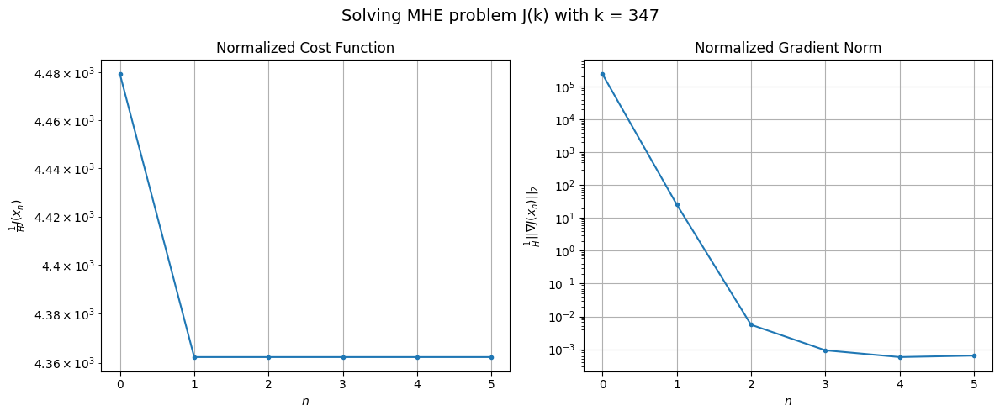

Windows:  87%|████████▋ | 309/356 [41:52<05:32,  7.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 187560.53470851094
Gradient norm: 8720297.806770815
Global estimation error: 47.60479414494646
Initial conditions estimation errors: 10.555970493574387 m, 19.165854787703495 m, 5.890516145369277 m, 41.86588771994578 m
Position estimation errors: 21.081304793344547 m, 17.414081940610433 m, 28.95204856447041 m, 12.66763853095489 m

[Gauss-Newton] Iteration 1
Cost function: 183421.02025839218 (-2.21%)
Gradient norm: 240.86949966135268 (-100.00%)
Global estimation error: 49.31619898054632 (3.60%)
Initial conditions estimation errors: 12.469766794985633 m, 19.173355022947028 m, 10.486774756877844 m, 42.41455278443082 m
Position estimation errors: 18.432200466157656 m, 15.399206741367808 m, 20.373785572747177 m, 12.157482675223662 m

[Gauss-Newton] Iteration 2
Cost function: 183421.02022796 (-0.00%)
Gradient norm: 0.052903214239996735 (-99.98%)
Global estimation error: 49.26803632905724 (-0.10%)
Initial conditions estimation errors:

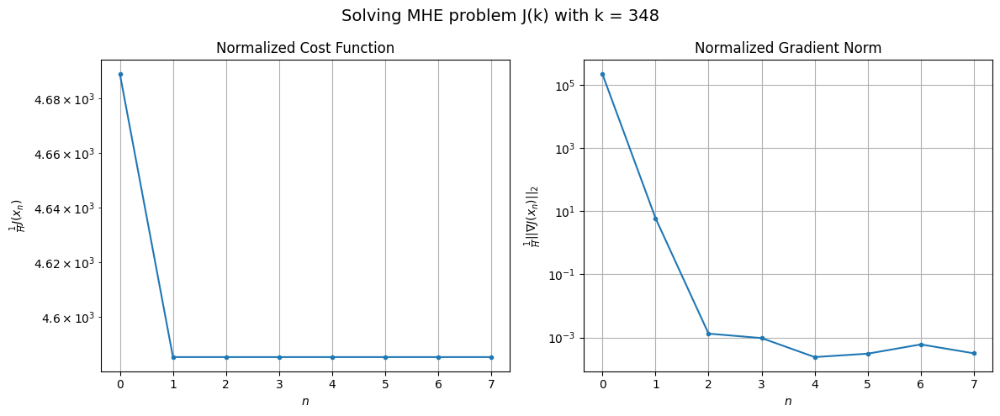

Windows:  87%|████████▋ | 310/356 [41:59<05:31,  7.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 197019.8618570804
Gradient norm: 7734150.297228713
Global estimation error: 48.39641165826578
Initial conditions estimation errors: 10.138612547646881 m, 17.35311186488656 m, 7.88930719563912 m, 43.31332778833625 m
Position estimation errors: 20.768559516935287 m, 17.404666818572878 m, 23.062265590474883 m, 11.220924397393954 m

[Gauss-Newton] Iteration 1
Cost function: 193238.70757653884 (-1.92%)
Gradient norm: 441.9307115323034 (-99.99%)
Global estimation error: 49.3421396421937 (1.95%)
Initial conditions estimation errors: 11.890785942338262 m, 17.16142929422163 m, 11.25012028798835 m, 43.26857894804957 m
Position estimation errors: 18.245706629604435 m, 16.723512044736115 m, 17.540868943058793 m, 15.128023368348446 m

[Gauss-Newton] Iteration 2
Cost function: 193238.70744324723 (-0.00%)
Gradient norm: 0.06464198899852384 (-99.99%)
Global estimation error: 49.28979294465732 (-0.11%)
Initial conditions estimation errors: 11.

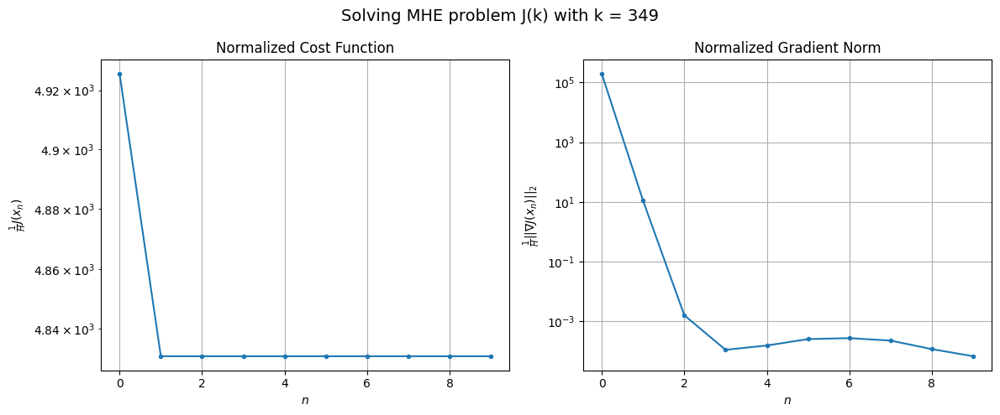

Windows:  87%|████████▋ | 311/356 [42:09<05:52,  7.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 207122.07206377943
Gradient norm: 6635207.341054703
Global estimation error: 49.7730337245042
Initial conditions estimation errors: 10.006436435081971 m, 16.05585198809811 m, 8.848089879206315 m, 45.17900561706271 m
Position estimation errors: 20.502531594507033 m, 18.37167180414045 m, 20.291959841757237 m, 13.048968888452864 m

[Gauss-Newton] Iteration 1
Cost function: 203660.51288122436 (-1.67%)
Gradient norm: 625.6448701913529 (-99.99%)
Global estimation error: 30.89004365950455 (-37.94%)
Initial conditions estimation errors: 11.66823183664981 m, 14.766814371376345 m, 14.105406352570052 m, 20.025537096252073 m
Position estimation errors: 18.139788413157948 m, 15.724229783981306 m, 15.895820330223291 m, 25.21762003404407 m

[Gauss-Newton] Iteration 2
Cost function: 203660.5093615865 (-0.00%)
Gradient norm: 0.05260746975805575 (-99.99%)
Global estimation error: 30.94632266559199 (0.18%)
Initial conditions estimation errors: 1

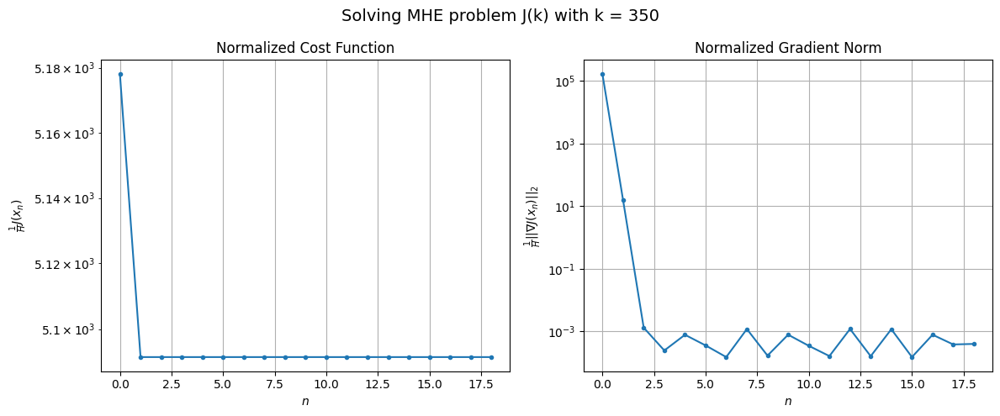

Windows:  88%|████████▊ | 312/356 [42:26<07:56, 10.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 217738.85905377349
Gradient norm: 5529353.443865525
Global estimation error: 29.73707551317441
Initial conditions estimation errors: 10.144304554494957 m, 13.523648956657274 m, 12.27940484503645 m, 21.159183119259872 m
Position estimation errors: 20.272681465273557 m, 17.64542309581602 m, 18.164080115117994 m, 24.95026835392078 m

[Gauss-Newton] Iteration 1
Cost function: 214520.98954783374 (-1.48%)
Gradient norm: 667.1492737724823 (-99.99%)
Global estimation error: 32.392727220595305 (8.93%)
Initial conditions estimation errors: 11.754415910206903 m, 14.588573547938864 m, 14.168699203940044 m, 22.305598946672752 m
Position estimation errors: 18.055526817959514 m, 17.44463545781913 m, 15.526938900724659 m, 33.50633950713027 m

[Gauss-Newton] Iteration 2
Cost function: 214520.98909518754 (-0.00%)
Gradient norm: 0.29696459823043303 (-99.96%)
Global estimation error: 32.503348381973204 (0.34%)
Initial conditions estimation errors

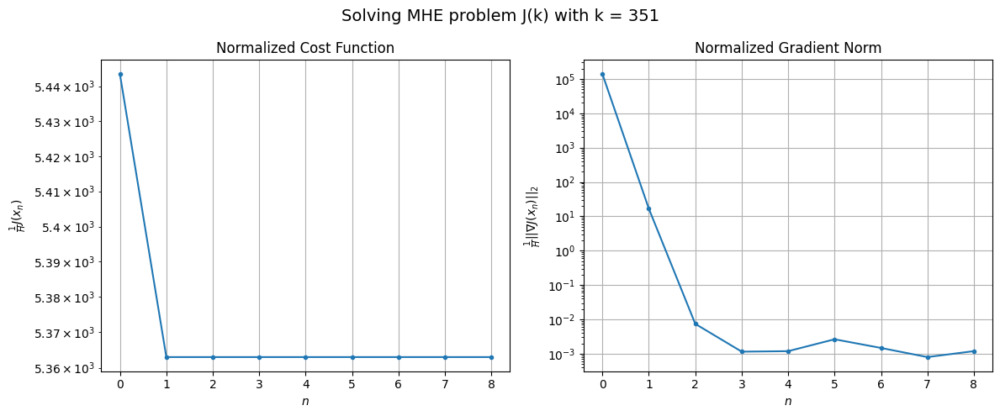

Windows:  88%|████████▊ | 313/356 [42:36<07:26, 10.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 227669.54896663502
Gradient norm: 4185670.752979214
Global estimation error: 32.863038843036826
Initial conditions estimation errors: 10.491153830052234 m, 13.916993900961526 m, 12.381479044836684 m, 24.95851308124601 m
Position estimation errors: 20.02950993506887 m, 19.07056792590299 m, 17.63666407094465 m, 32.11721696414304 m

[Gauss-Newton] Iteration 1
Cost function: 224579.69110840242 (-1.36%)
Gradient norm: 4982.670243982273 (-99.88%)
Global estimation error: 41.269530629376554 (25.58%)
Initial conditions estimation errors: 12.132093475672146 m, 17.27806366798908 m, 13.316519381850881 m, 32.86522015145702 m
Position estimation errors: 17.94424837378938 m, 12.734235839429209 m, 18.872214375151835 m, 10.238374011340081 m

[Gauss-Newton] Iteration 2
Cost function: 224579.67079228206 (-0.00%)
Gradient norm: 0.8016246520537241 (-99.98%)
Global estimation error: 41.29879048708984 (0.07%)
Initial conditions estimation errors: 1

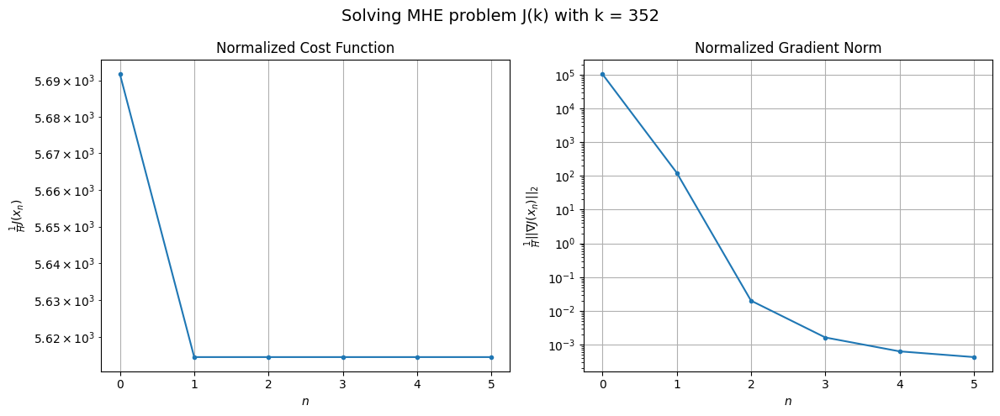

Windows:  88%|████████▊ | 314/356 [42:42<06:26,  9.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 237054.9691371282
Gradient norm: 3131859.3274934953
Global estimation error: 39.29375373314331
Initial conditions estimation errors: 11.018461008491286 m, 15.942387326564061 m, 12.313812797815837 m, 31.88731136733673 m
Position estimation errors: 19.762703219260732 m, 14.212391616542336 m, 20.580340331791 m, 10.776154826455176 m

[Gauss-Newton] Iteration 1
Cost function: 234059.88318040883 (-1.26%)
Gradient norm: 35.82447444025084 (-100.00%)
Global estimation error: 42.152696775184765 (7.28%)
Initial conditions estimation errors: 12.683512880085118 m, 14.695527935228855 m, 14.291426808548465 m, 34.57994670283416 m
Position estimation errors: 17.777643031397606 m, 14.425511829644556 m, 17.954756640980822 m, 9.51810156632294 m

[Gauss-Newton] Iteration 2
Cost function: 234059.88318627316 (0.00%)
Gradient norm: 0.051652038335440756 (-99.86%)
Global estimation error: 42.158517384855784 (0.01%)
Initial conditions estimation errors:

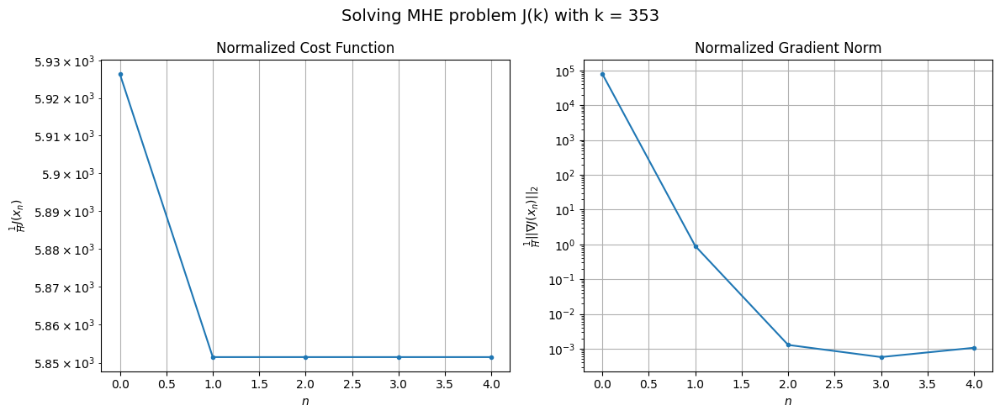

Windows:  88%|████████▊ | 315/356 [42:48<05:29,  8.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 244931.57987188143
Gradient norm: 2079073.4521932763
Global estimation error: 40.388849451324965
Initial conditions estimation errors: 11.619386018512103 m, 13.424041888341373 m, 13.335650533051593 m, 33.73725835225413 m
Position estimation errors: 19.504148015313316 m, 16.096987596510676 m, 19.48428237716466 m, 9.439979979587621 m

[Gauss-Newton] Iteration 1
Cost function: 241975.95292475226 (-1.21%)
Gradient norm: 16636.482349036734 (-99.20%)
Global estimation error: 32.23760211138287 (-20.18%)
Initial conditions estimation errors: 13.32764472166014 m, 10.261072759415256 m, 13.543520396310685 m, 23.93536921137164 m
Position estimation errors: 17.594899690886148 m, 9.341567333620901 m, 29.13967403816805 m, 45.47715778149035 m

[Gauss-Newton] Iteration 2
Cost function: 241975.6199262731 (-0.00%)
Gradient norm: 20.244726444710242 (-99.88%)
Global estimation error: 32.72121950254152 (1.50%)
Initial conditions estimation errors: 

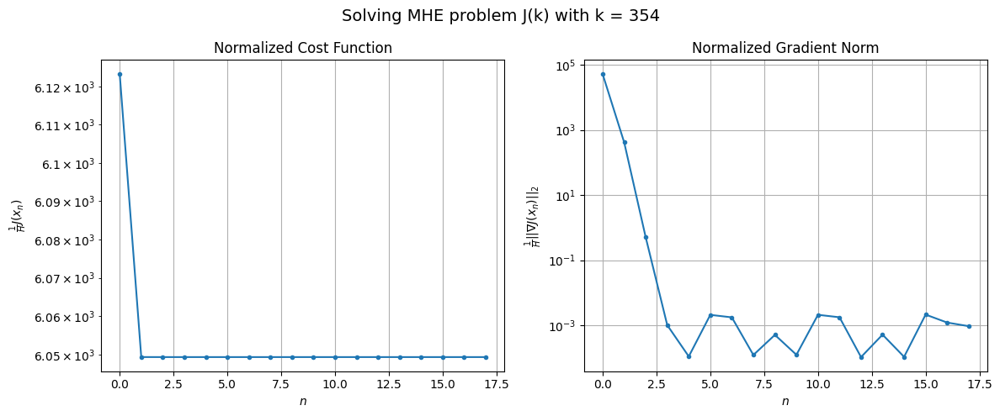

Windows:  89%|████████▉ | 316/356 [43:04<07:03, 10.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 251995.78164280334
Gradient norm: 1589261.4830837382
Global estimation error: 26.690359087665342
Initial conditions estimation errors: 12.237140329211142 m, 7.696931368058721 m, 13.829864829896799 m, 17.666365827623103 m
Position estimation errors: 19.35963227615093 m, 10.273028695157336 m, 30.537500162820738 m, 40.57099939942665 m

[Gauss-Newton] Iteration 1
Cost function: 248975.47047909605 (-1.20%)
Gradient norm: 7967.999056330275 (-99.50%)
Global estimation error: 40.157747188730326 (50.46%)
Initial conditions estimation errors: 14.00424450419326 m, 11.803219026832847 m, 12.397047030777507 m, 33.5183521432176 m
Position estimation errors: 17.470739217658583 m, 9.70673313444652 m, 40.90383390764781 m, 82.94765002899187 m

[Gauss-Newton] Iteration 2
Cost function: 248975.4254462221 (-0.00%)
Gradient norm: 1.2397096117237603 (-99.98%)
Global estimation error: 40.333871752821025 (0.44%)
Initial conditions estimation errors: 14

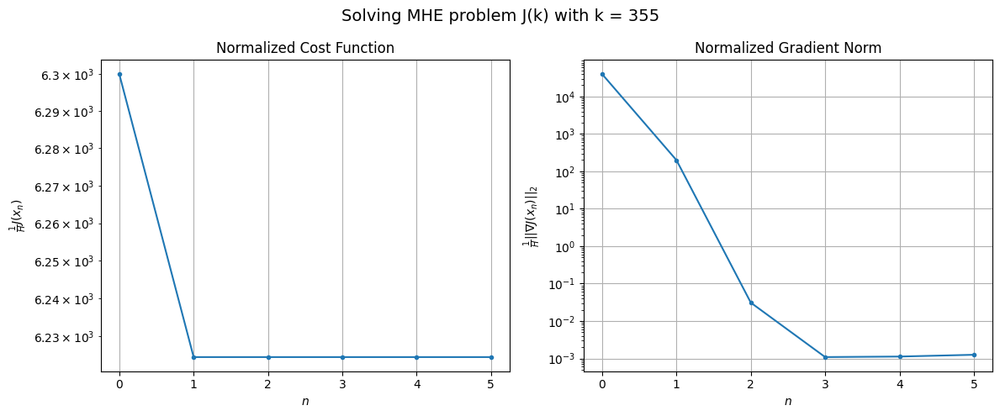

Windows:  89%|████████▉ | 317/356 [43:11<06:04,  9.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 258410.19676991718
Gradient norm: 1341301.9878008433
Global estimation error: 31.11093549865912
Initial conditions estimation errors: 12.840182643724033 m, 8.032249487127844 m, 13.16706112551318 m, 23.77157438435401 m
Position estimation errors: 19.453858062971428 m, 6.636444044097003 m, 41.578884344836545 m, 72.82324338545008 m

[Gauss-Newton] Iteration 1
Cost function: 255234.8295041267 (-1.23%)
Gradient norm: 641.9115221117381 (-99.95%)
Global estimation error: 50.24239579045162 (61.49%)
Initial conditions estimation errors: 14.681287883473074 m, 17.518196894237203 m, 9.986716945228158 m, 43.61298896598932 m
Position estimation errors: 17.540987812383314 m, 13.14545018047267 m, 48.174933754313486 m, 90.21518518255047 m

[Gauss-Newton] Iteration 2
Cost function: 255234.82853146375 (-0.00%)
Gradient norm: 0.1711482676745763 (-99.97%)
Global estimation error: 50.144481650610054 (-0.19%)
Initial conditions estimation errors: 14

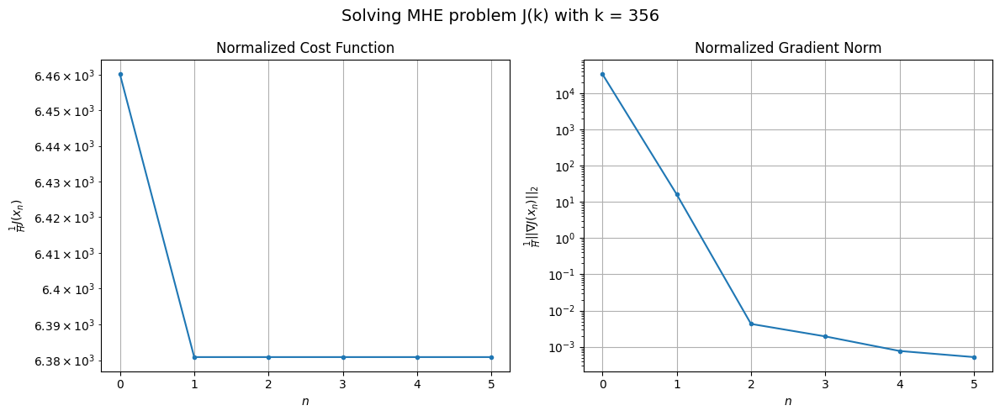

Windows:  89%|████████▉ | 318/356 [43:17<05:17,  8.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 264624.05846401275
Gradient norm: 1230022.372583397
Global estimation error: 39.03080326090268
Initial conditions estimation errors: 13.429917245487683 m, 13.238322845615958 m, 10.221861264951091 m, 32.607621528363005 m
Position estimation errors: 19.89531484539195 m, 8.040361343723443 m, 48.90569428147027 m, 79.42524911420747 m

[Gauss-Newton] Iteration 1
Cost function: 261263.16156929775 (-1.27%)
Gradient norm: 1410.104945673906 (-99.89%)
Global estimation error: 32.28142443950864 (-17.29%)
Initial conditions estimation errors: 15.342984281842124 m, 8.47764191490328 m, 16.211399517291483 m, 21.724798416941027 m
Position estimation errors: 17.93762045852099 m, 4.818523276531759 m, 37.645922763750455 m, 61.09565369915368 m

[Gauss-Newton] Iteration 2
Cost function: 261263.1605145438 (-0.00%)
Gradient norm: 0.06939292535011682 (-100.00%)
Global estimation error: 32.28360728081184 (0.01%)
Initial conditions estimation errors: 15

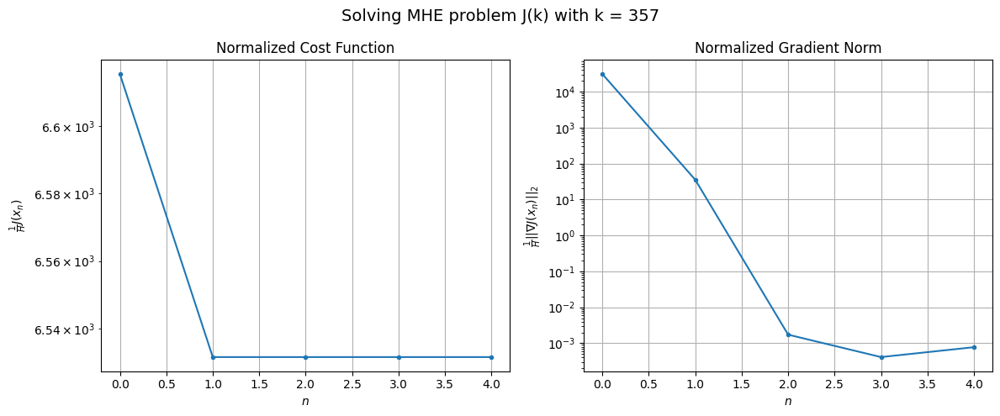

Windows:  90%|████████▉ | 319/356 [43:22<04:36,  7.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 271115.46191184234
Gradient norm: 1211435.8354132194
Global estimation error: 26.989572049379202
Initial conditions estimation errors: 14.02011267056743 m, 5.133858428866953 m, 16.9698725192258 m, 14.748009500510667 m
Position estimation errors: 20.726700240723403 m, 7.818353070073173 m, 38.810828838256676 m, 50.556762341435075 m

[Gauss-Newton] Iteration 1
Cost function: 267358.8011585505 (-1.39%)
Gradient norm: 3146.190119384209 (-99.74%)
Global estimation error: 27.768072188447285 (2.88%)
Initial conditions estimation errors: 16.056611684634703 m, 8.770275090529793 m, 15.095085586860904 m, 14.437831993275319 m
Position estimation errors: 18.662531233450963 m, 10.166511022378936 m, 33.62936452746521 m, 32.58192729514925 m

[Gauss-Newton] Iteration 2
Cost function: 267358.7888770838 (-0.00%)
Gradient norm: 0.894667888575353 (-99.97%)
Global estimation error: 27.82067712766291 (0.19%)
Initial conditions estimation errors: 16.0

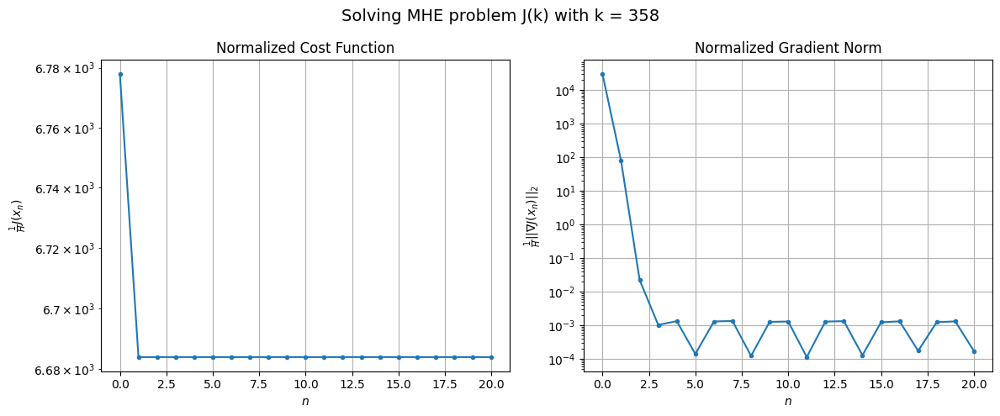

Windows:  90%|████████▉ | 320/356 [43:41<06:38, 11.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 278296.5631330611
Gradient norm: 1334411.103550926
Global estimation error: 24.11513725879005
Initial conditions estimation errors: 14.6954187476474 m, 6.111646757058219 m, 15.277262701271312 m, 9.737399187431139 m
Position estimation errors: 21.85464810539617 m, 15.106607253021387 m, 35.564256512348635 m, 24.227065426647687 m

[Gauss-Newton] Iteration 1
Cost function: 274192.42366068636 (-1.47%)
Gradient norm: 316.36294258340325 (-99.98%)
Global estimation error: 32.09422482901471 (33.09%)
Initial conditions estimation errors: 16.83555886631607 m, 12.546542325873485 m, 21.744277117820573 m, 10.78687924468743 m
Position estimation errors: 19.699143419826367 m, 11.695524512078759 m, 28.027411015666967 m, 20.363492330581025 m

[Gauss-Newton] Iteration 2
Cost function: 274192.42353489605 (-0.00%)
Gradient norm: 0.12573751761545457 (-99.96%)
Global estimation error: 32.102580037105845 (0.03%)
Initial conditions estimation errors: 

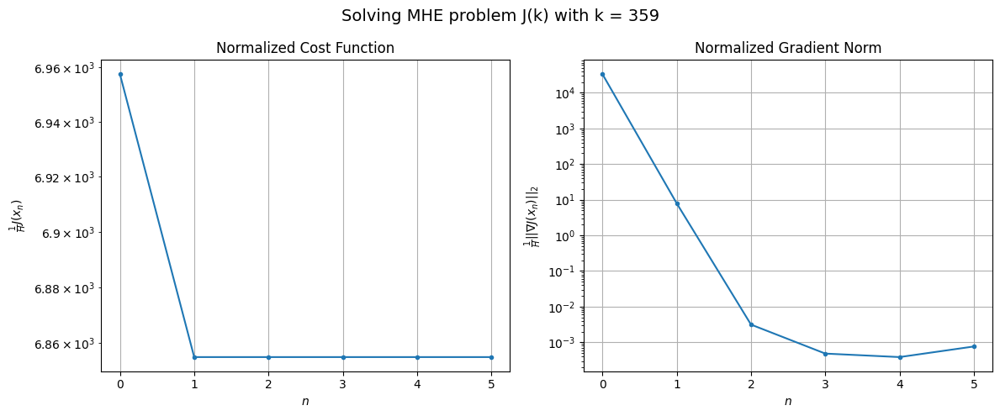

Windows:  90%|█████████ | 321/356 [43:48<05:35,  9.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 286799.5839060263
Gradient norm: 1667955.7431167548
Global estimation error: 30.016353062509598
Initial conditions estimation errors: 15.466139838564056 m, 10.053350488431276 m, 21.77899409027403 m, 9.29346133083482 m
Position estimation errors: 23.208600795213137 m, 16.61199624630184 m, 30.17894751323617 m, 14.214916410304745 m

[Gauss-Newton] Iteration 1
Cost function: 282184.0831734863 (-1.61%)
Gradient norm: 6378.577431322343 (-99.62%)
Global estimation error: 41.10051691833932 (36.93%)
Initial conditions estimation errors: 17.75514221282298 m, 6.687131579140487 m, 32.917336009879534 m, 15.675849399507065 m
Position estimation errors: 20.92855173400805 m, 29.07522965287291 m, 13.985306446657004 m, 30.24024272789216 m

[Gauss-Newton] Iteration 2
Cost function: 282184.0564034324 (-0.00%)
Gradient norm: 0.30571591102114665 (-100.00%)
Global estimation error: 40.99388404780325 (-0.26%)
Initial conditions estimation errors: 17.

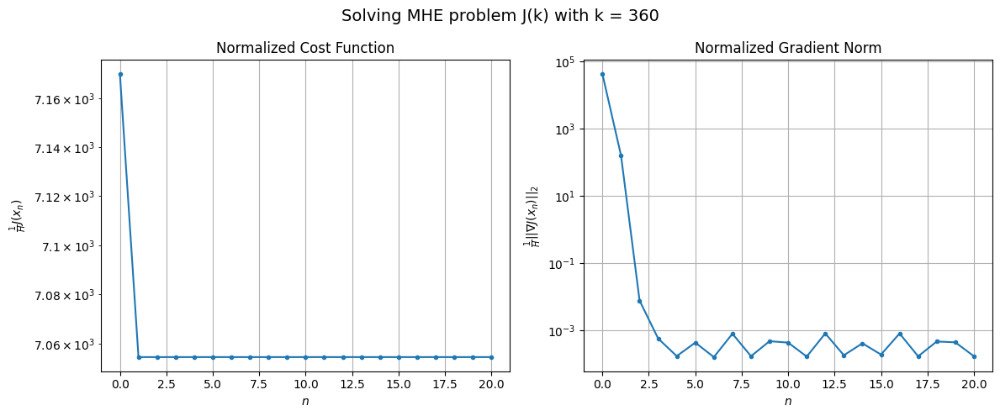

Windows:  90%|█████████ | 322/356 [44:07<07:00, 12.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 296606.68057365733
Gradient norm: 2140119.0027626143
Global estimation error: 41.30466816062982
Initial conditions estimation errors: 16.37544910151874 m, 7.099519726872797 m, 31.95725152982007 m, 19.137520452462773 m
Position estimation errors: 24.645721914916482 m, 33.79648295000401 m, 16.735400815694085 m, 36.64740794632616 m

[Gauss-Newton] Iteration 1
Cost function: 291399.12043358106 (-1.76%)
Gradient norm: 2416.9987864073673 (-99.89%)
Global estimation error: 45.080619322106095 (9.14%)
Initial conditions estimation errors: 18.842234151765435 m, 8.207477891640817 m, 37.19190948478962 m, 15.05418660127999 m
Position estimation errors: 22.238050410528956 m, 38.110004757293765 m, 7.756373573068678 m, 51.15650891216918 m

[Gauss-Newton] Iteration 2
Cost function: 291399.1146194281 (-0.00%)
Gradient norm: 0.547979794330025 (-99.98%)
Global estimation error: 44.95496619439919 (-0.28%)
Initial conditions estimation errors: 18.8

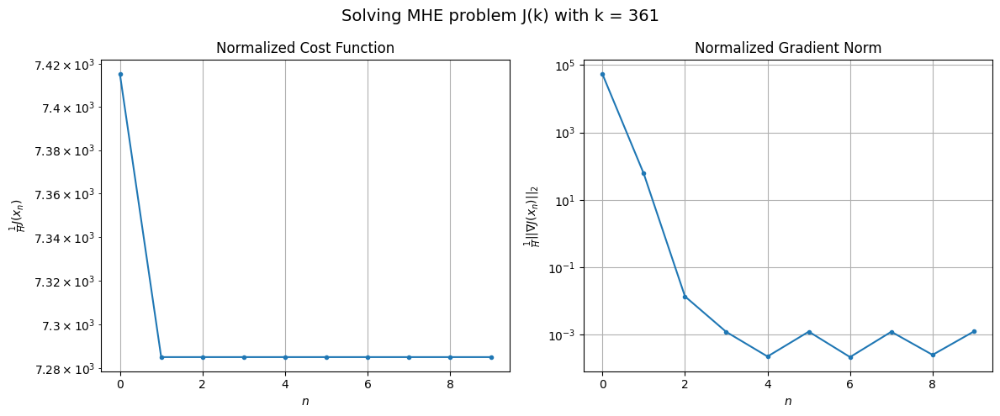

Windows:  91%|█████████ | 323/356 [44:16<06:16, 11.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 307286.3521677628
Gradient norm: 2654519.9082779083
Global estimation error: 43.56052117044171
Initial conditions estimation errors: 17.399593457653943 m, 8.551732590528303 m, 35.450511584381786 m, 16.27570891977814 m
Position estimation errors: 26.059609779730774 m, 42.306211004428086 m, 11.069864637339924 m, 55.47150651008882 m

[Gauss-Newton] Iteration 1
Cost function: 301325.2509498911 (-1.94%)
Gradient norm: 1533.8424149811656 (-99.94%)
Global estimation error: 54.8103482523449 (25.83%)
Initial conditions estimation errors: 20.07467460928883 m, 9.764966964282545 m, 44.78516465035759 m, 22.363197240371193 m
Position estimation errors: 23.499920334603246 m, 44.583053656235606 m, 1.8288508000192962 m, 72.26674450729426 m

[Gauss-Newton] Iteration 2
Cost function: 301325.24951208686 (-0.00%)
Gradient norm: 0.28915140047364274 (-99.98%)
Global estimation error: 54.74695390179012 (-0.12%)
Initial conditions estimation errors: 2

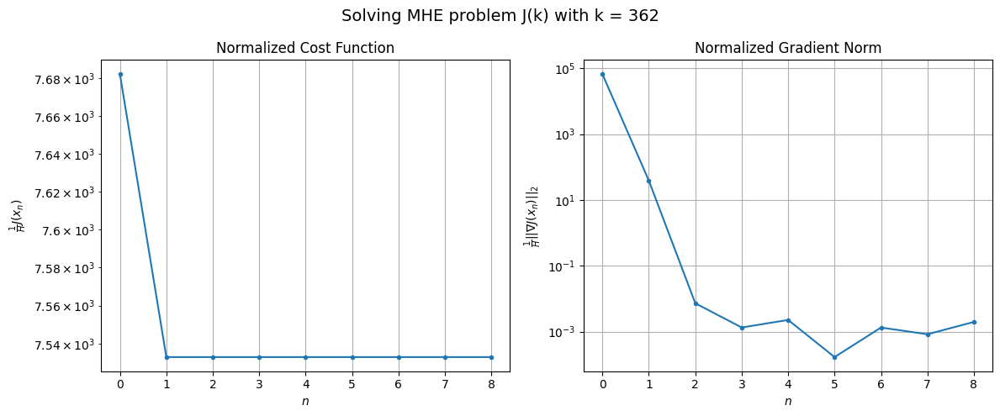

Windows:  91%|█████████ | 324/356 [44:24<05:36, 10.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 318667.436807471
Gradient norm: 3131002.295839508
Global estimation error: 52.203595706897644
Initial conditions estimation errors: 18.474660289905366 m, 9.790754023706622 m, 42.34009923890434 m, 22.25657331986856 m
Position estimation errors: 27.356658733740645 m, 48.43871421416558 m, 3.6236442468888015 m, 75.5963973815245 m

[Gauss-Newton] Iteration 1
Cost function: 312090.8868904063 (-2.06%)
Gradient norm: 451.0021253265218 (-99.99%)
Global estimation error: 54.00347362742657 (3.45%)
Initial conditions estimation errors: 21.31690557595149 m, 12.911915331626233 m, 46.581487563764036 m, 11.19850540520275 m
Position estimation errors: 24.684236372285287 m, 42.76536787531503 m, 5.34830238246999 m, 72.08951435262698 m

[Gauss-Newton] Iteration 2
Cost function: 312090.8863027069 (-0.00%)
Gradient norm: 0.218856883004274 (-99.95%)
Global estimation error: 53.95513150956763 (-0.09%)
Initial conditions estimation errors: 21.31690463

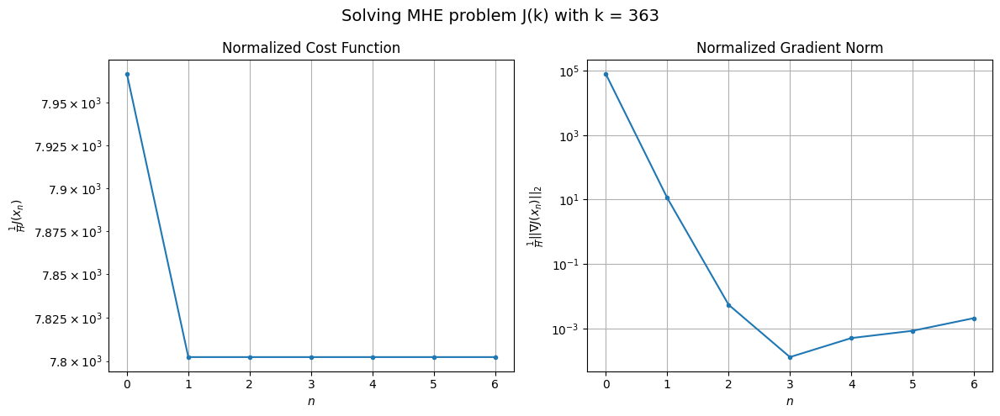

Windows:  91%|█████████▏| 325/356 [44:31<04:49,  9.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 330900.5953646652
Gradient norm: 3624721.548035368
Global estimation error: 50.15931614342784
Initial conditions estimation errors: 19.463588264567264 m, 12.058128648976677 m, 43.38964626838405 m, 10.443134232893891 m
Position estimation errors: 28.54805511732347 m, 45.97989324228298 m, 4.065547193752437 m, 73.93021766861398 m

[Gauss-Newton] Iteration 1
Cost function: 323554.42104287836 (-2.22%)
Gradient norm: 578.8186509090542 (-99.98%)
Global estimation error: 61.04066104428308 (21.69%)
Initial conditions estimation errors: 22.50007875051719 m, 14.361011082926733 m, 52.09684106160574 m, 17.3026242976557 m
Position estimation errors: 25.744538395826275 m, 47.17381859389636 m, 11.18477781335256 m, 85.60990632646345 m

[Gauss-Newton] Iteration 2
Cost function: 323554.4208378219 (-0.00%)
Gradient norm: 0.10424982582210796 (-99.98%)
Global estimation error: 61.07913323373979 (0.06%)
Initial conditions estimation errors: 22.50007

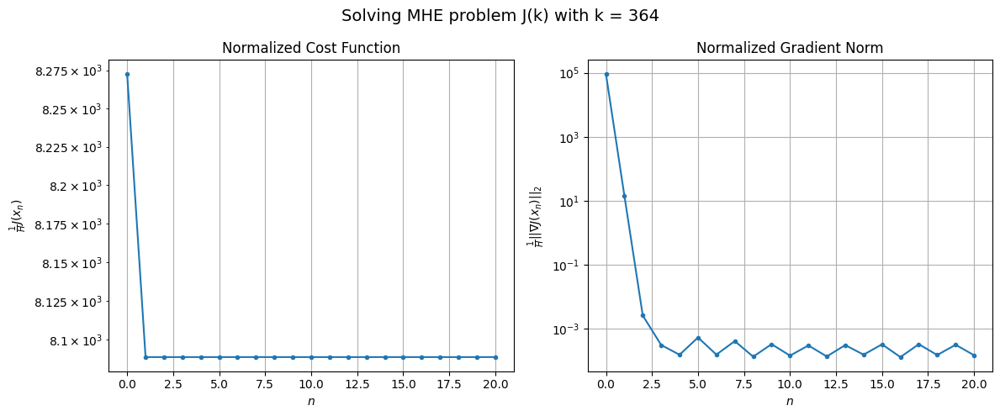

Windows:  92%|█████████▏| 326/356 [44:50<06:07, 12.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 341671.25611662795
Gradient norm: 3787488.3675331115
Global estimation error: 56.266499034853695
Initial conditions estimation errors: 20.32591505406417 m, 13.170507241291885 m, 48.25794589179848 m, 15.826387967449346 m
Position estimation errors: 29.59768605217925 m, 50.21927768529521 m, 8.657544411793461 m, 87.38899813889034 m

[Gauss-Newton] Iteration 1
Cost function: 333514.86619757564 (-2.39%)
Gradient norm: 553.5296051205821 (-99.99%)
Global estimation error: 49.6558536515601 (-11.75%)
Initial conditions estimation errors: 23.556343930114416 m, 19.729847878819278 m, 37.218508048034806 m, 11.67511484828882 m
Position estimation errors: 26.666901680944417 m, 41.741511824094374 m, 4.96474876826682 m, 70.3809308106904 m

[Gauss-Newton] Iteration 2
Cost function: 333514.8646545097 (-0.00%)
Gradient norm: 0.40490528973851675 (-99.93%)
Global estimation error: 49.71230968640832 (0.11%)
Initial conditions estimation errors: 23.5

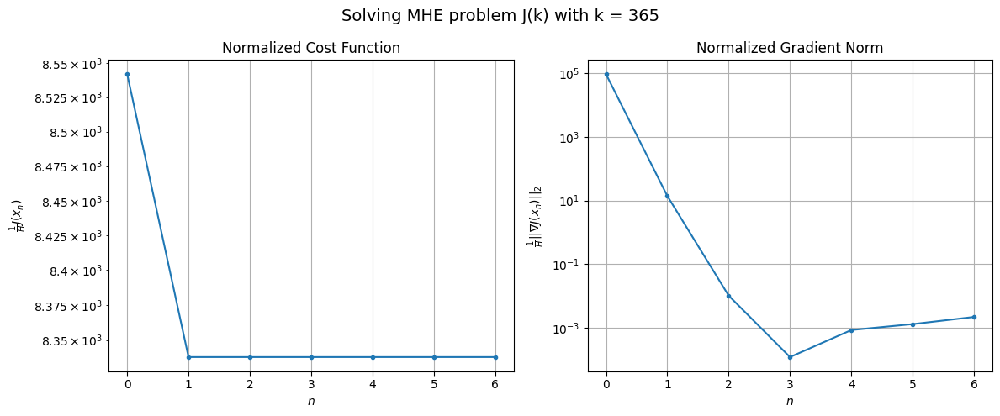

Windows:  92%|█████████▏| 327/356 [44:56<05:06, 10.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 352289.11885250564
Gradient norm: 4230612.880202023
Global estimation error: 45.08109434353189
Initial conditions estimation errors: 21.035094657390644 m, 18.209120442337493 m, 33.37307702303934 m, 12.02015956907515 m
Position estimation errors: 30.473706120806572 m, 44.622767098499814 m, 8.982265483602104 m, 71.6184648880815 m

[Gauss-Newton] Iteration 1
Cost function: 343488.5876839553 (-2.50%)
Gradient norm: 392.1734522621053 (-99.99%)
Global estimation error: 54.94341973090309 (21.88%)
Initial conditions estimation errors: 24.406245016820996 m, 21.2227136095832 m, 42.54710790467845 m, 12.745234462428847 m
Position estimation errors: 27.440440116250148 m, 43.884712742952004 m, 5.702697434102138 m, 77.50388947055086 m

[Gauss-Newton] Iteration 2
Cost function: 343488.5875707248 (-0.00%)
Gradient norm: 0.02835532156622514 (-99.99%)
Global estimation error: 54.964700202379774 (0.04%)
Initial conditions estimation errors: 24.40

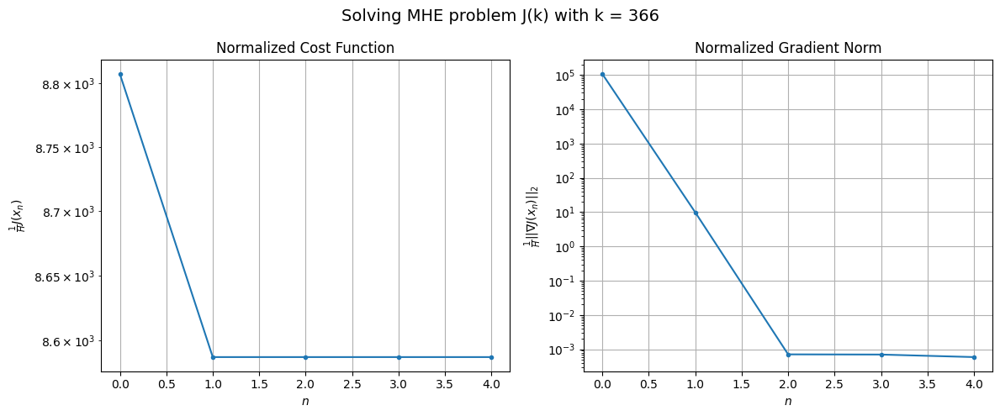

Windows:  92%|█████████▏| 328/356 [45:02<04:12,  9.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 362160.95417902846
Gradient norm: 4402486.137536831
Global estimation error: 49.69304943436885
Initial conditions estimation errors: 21.561087251219433 m, 19.477896902581204 m, 37.96213615053446 m, 13.564350261904979 m
Position estimation errors: 31.143663171223324 m, 46.36624621535369 m, 7.139898215714524 m, 77.50332450565072 m

[Gauss-Newton] Iteration 1
Cost function: 352785.9523145508 (-2.59%)
Gradient norm: 197.770987820292 (-100.00%)
Global estimation error: 55.184145331790674 (11.05%)
Initial conditions estimation errors: 25.049573845955347 m, 18.44668459738741 m, 44.20532709700878 m, 11.108685242359368 m
Position estimation errors: 28.02079603921256 m, 46.54634087807108 m, 5.914444188537011 m, 78.83020267121798 m

[Gauss-Newton] Iteration 2
Cost function: 352785.9520398769 (-0.00%)
Gradient norm: 0.05952062801425894 (-99.97%)
Global estimation error: 55.17508626925813 (-0.02%)
Initial conditions estimation errors: 25.0

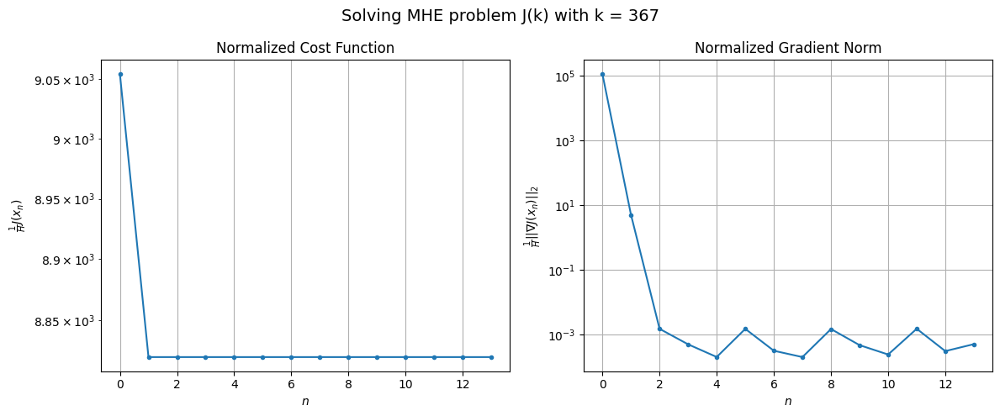

Windows:  92%|█████████▏| 329/356 [45:15<04:36, 10.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 371590.3604815213
Gradient norm: 4613338.974453972
Global estimation error: 49.10337840608304
Initial conditions estimation errors: 21.9380219104894 m, 16.328202624177614 m, 39.451800739679335 m, 10.334143994091423 m
Position estimation errors: 31.569099364393207 m, 49.12108677591003 m, 7.718239718247571 m, 79.57609863891311 m

[Gauss-Newton] Iteration 1
Cost function: 361916.78072464507 (-2.60%)
Gradient norm: 1129.0888548685834 (-99.98%)
Global estimation error: 58.20604954133295 (18.54%)
Initial conditions estimation errors: 25.472850217666302 m, 21.90619553940766 m, 45.55152031547519 m, 13.573499121780618 m
Position estimation errors: 28.39071583807498 m, 39.67876427745556 m, 4.714886640552885 m, 61.83323638619422 m

[Gauss-Newton] Iteration 2
Cost function: 361916.77947554406 (-0.00%)
Gradient norm: 0.12042309111028981 (-99.99%)
Global estimation error: 58.24633959861606 (0.07%)
Initial conditions estimation errors: 25.47

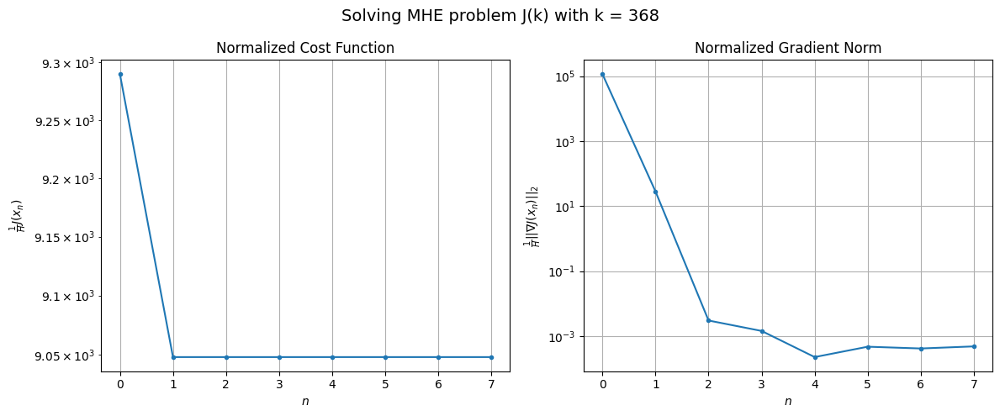

Windows:  93%|█████████▎| 330/356 [45:23<04:06,  9.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379986.19370955834
Gradient norm: 4891662.828366916
Global estimation error: 52.03766499749582
Initial conditions estimation errors: 22.17015624155007 m, 19.282097273547073 m, 41.13064084157853 m, 12.363558978313412 m
Position estimation errors: 31.75340766060053 m, 42.36472366491752 m, 7.563917149584654 m, 63.477433018180825 m

[Gauss-Newton] Iteration 1
Cost function: 370092.6779680104 (-2.60%)
Gradient norm: 1983.9805910194807 (-99.96%)
Global estimation error: 61.77569937630912 (18.71%)
Initial conditions estimation errors: 25.734021774644063 m, 30.598745137439433 m, 26.84952723415555 m, 38.688495995520256 m
Position estimation errors: 28.535254316186446 m, 29.409903857255024 m, 20.591348780091277 m, 33.168701341489445 m

[Gauss-Newton] Iteration 2
Cost function: 370092.6727081595 (-0.00%)
Gradient norm: 0.09477395918706949 (-100.00%)
Global estimation error: 61.766842071736946 (-0.01%)
Initial conditions estimation errors

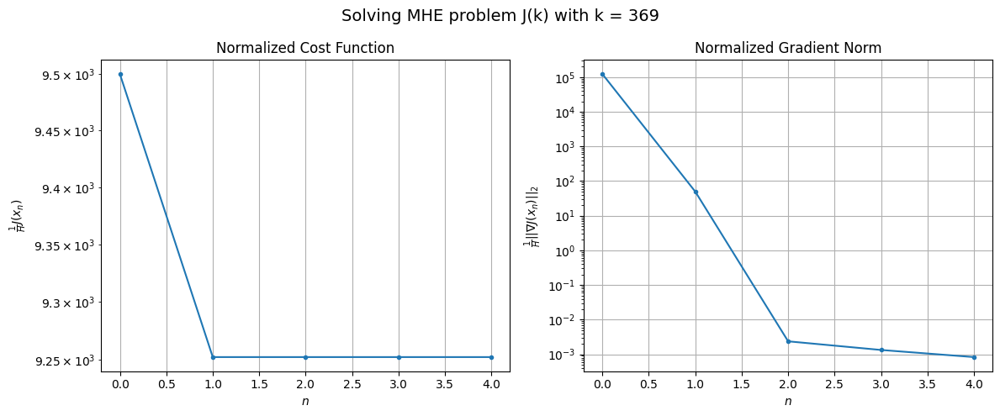

Windows:  93%|█████████▎| 331/356 [45:28<03:27,  8.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 386880.461045381
Gradient norm: 4846107.674077667
Global estimation error: 56.4152448089084
Initial conditions estimation errors: 22.308893921221422 m, 27.838689470657208 m, 22.819547017096326 m, 37.27266690546058 m
Position estimation errors: 31.70495667396949 m, 31.783244731286437 m, 24.45103179463171 m, 33.949891191896455 m

[Gauss-Newton] Iteration 1
Cost function: 377094.710289963 (-2.53%)
Gradient norm: 178.28965521389438 (-100.00%)
Global estimation error: 70.48947311291236 (24.95%)
Initial conditions estimation errors: 25.829703352815272 m, 36.40931999778386 m, 18.771509315864368 m, 51.22075342261339 m
Position estimation errors: 28.490930511395675 m, 24.313522807953632 m, 27.68371088100077 m, 22.37432401456814 m

[Gauss-Newton] Iteration 2
Cost function: 377094.70994097705 (-0.00%)
Gradient norm: 0.3315448296000481 (-99.81%)
Global estimation error: 70.65749728370149 (0.24%)
Initial conditions estimation errors: 25.82

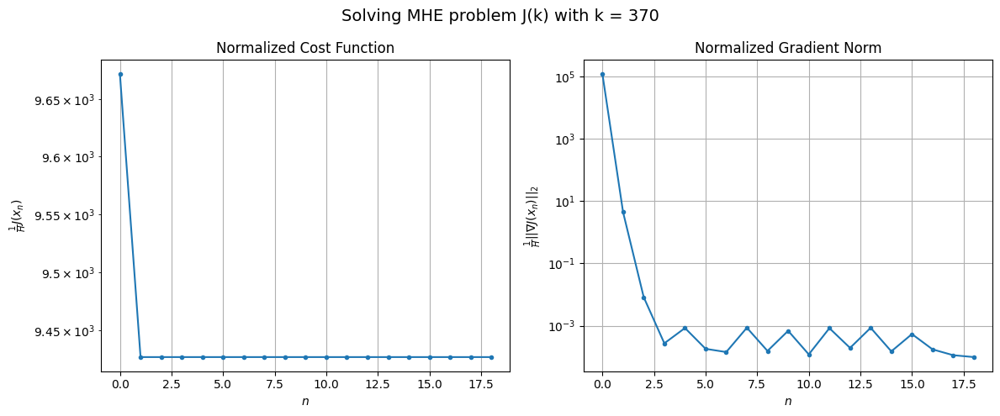

Windows:  93%|█████████▎| 332/356 [45:46<04:24, 11.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 392995.8312948343
Gradient norm: 4897735.661044721
Global estimation error: 66.13605346092729
Initial conditions estimation errors: 22.35575695902765 m, 33.85431872010804 m, 14.759952652120338 m, 50.10198228698608 m
Position estimation errors: 31.484705078397617 m, 26.220510033391413 m, 31.939953256465028 m, 22.323019883693828 m

[Gauss-Newton] Iteration 1
Cost function: 383144.47505842056 (-2.51%)
Gradient norm: 1027.7841240033076 (-99.98%)
Global estimation error: 63.80415068182002 (-3.53%)
Initial conditions estimation errors: 25.85807939988917 m, 30.785593322519222 m, 31.122461248407387 m, 38.54800352142974 m
Position estimation errors: 28.24876821258411 m, 30.926429745981245 m, 14.187564756405658 m, 35.70819590852033 m

[Gauss-Newton] Iteration 2
Cost function: 383144.4734666873 (-0.00%)
Gradient norm: 0.7925804337216242 (-99.92%)
Global estimation error: 63.52768401931697 (-0.43%)
Initial conditions estimation errors: 25

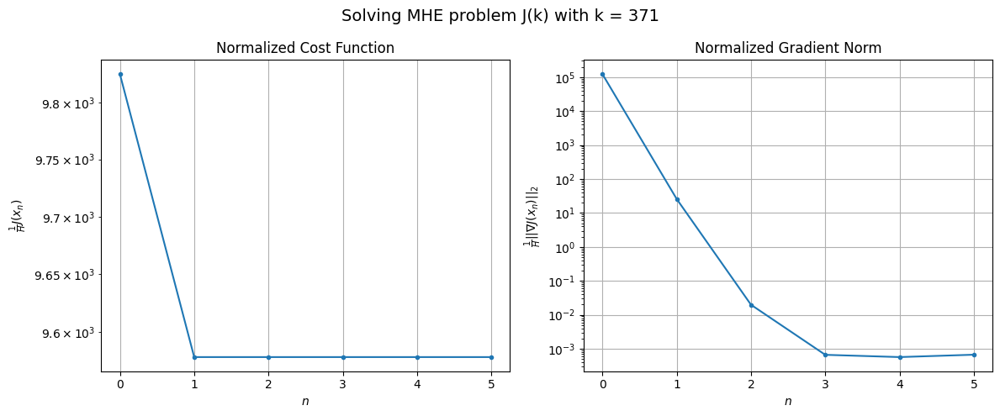

Windows:  94%|█████████▎| 333/356 [45:52<03:41,  9.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 397828.8567874698
Gradient norm: 5093585.240485677
Global estimation error: 57.95139065812484
Initial conditions estimation errors: 22.40413723860094 m, 27.811846131538722 m, 26.92247896781 m, 36.85213752034592 m
Position estimation errors: 31.103497592193968 m, 33.18121152070523 m, 17.72565038794322 m, 36.59679974978476 m

[Gauss-Newton] Iteration 1
Cost function: 388085.9212368932 (-2.45%)
Gradient norm: 838.6567508906458 (-99.98%)
Global estimation error: 55.28932802960622 (-4.59%)
Initial conditions estimation errors: 25.841071600026996 m, 22.040989250970764 m, 39.85825821814825 m, 17.73815303380884 m
Position estimation errors: 27.862880970868034 m, 38.88738845809254 m, 7.1776726824683905 m, 55.28749212002383 m

[Gauss-Newton] Iteration 2
Cost function: 388085.9197034869 (-0.00%)
Gradient norm: 0.030133327370032104 (-100.00%)
Global estimation error: 55.28900613286187 (-0.00%)
Initial conditions estimation errors: 25.8410

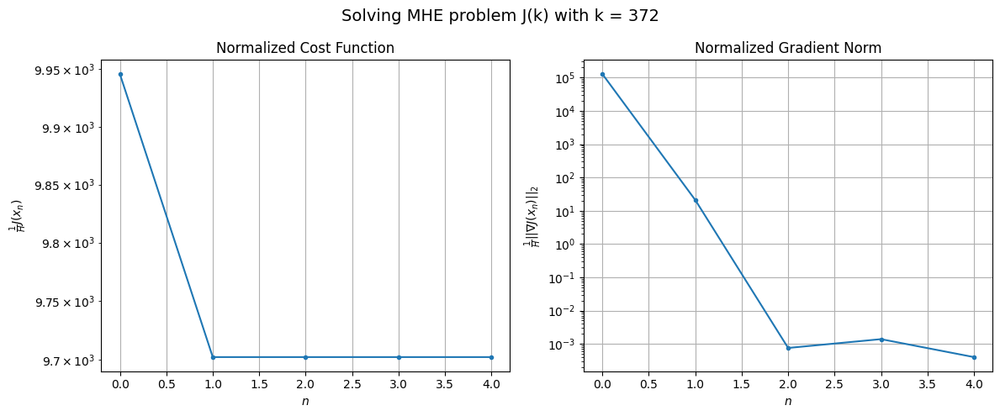

Windows:  94%|█████████▍| 334/356 [45:57<03:04,  8.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 401951.622580164
Gradient norm: 4844285.359740704
Global estimation error: 48.90614933114973
Initial conditions estimation errors: 22.47092964951706 m, 19.21249989812638 m, 35.338509518293144 m, 16.39872989606929 m
Position estimation errors: 30.624656752468642 m, 41.09120758356356 m, 10.279269204224459 m, 56.24343948628196 m

[Gauss-Newton] Iteration 1
Cost function: 392470.3192200373 (-2.36%)
Gradient norm: 3190.018736553176 (-99.93%)
Global estimation error: 61.112604593003454 (24.96%)
Initial conditions estimation errors: 25.812594485337684 m, 30.05047513503944 m, 26.324355605289067 m, 38.37234262532301 m
Position estimation errors: 27.403235790584688 m, 25.951688856640764 m, 22.014542649541486 m, 23.697098116517093 m

[Gauss-Newton] Iteration 2
Cost function: 392470.313463206 (-0.00%)
Gradient norm: 0.20086995418911327 (-99.99%)
Global estimation error: 61.15812876765235 (0.07%)
Initial conditions estimation errors: 25.81

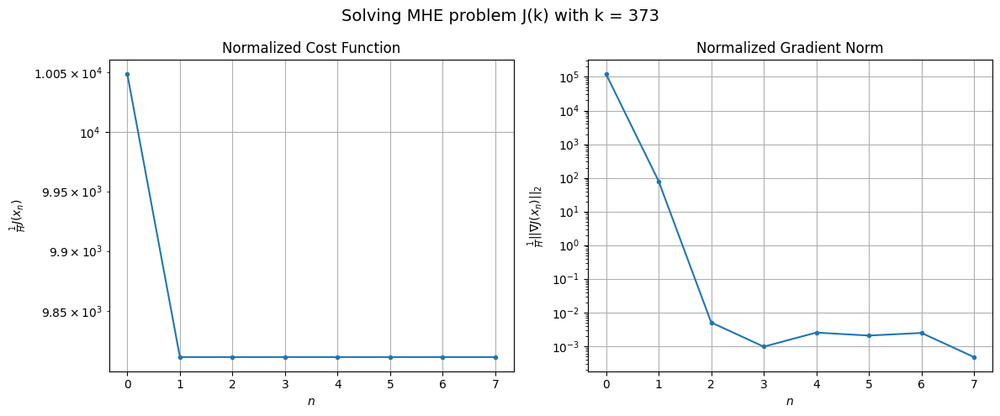

Windows:  94%|█████████▍| 335/356 [46:05<02:54,  8.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 405267.82797027135
Gradient norm: 4891886.836450112
Global estimation error: 55.49031509753928
Initial conditions estimation errors: 22.574288851973705 m, 27.234651801843953 m, 22.45880777379303 m, 36.3790091622868 m
Position estimation errors: 30.11692056719433 m, 28.20308451742121 m, 25.46702898125083 m, 24.85896263706625 m

[Gauss-Newton] Iteration 1
Cost function: 395987.80402282503 (-2.29%)
Gradient norm: 2054.428735783545 (-99.96%)
Global estimation error: 70.06689359523313 (26.27%)
Initial conditions estimation errors: 25.82006264373543 m, 37.300986914892675 m, 17.015268459451704 m, 50.61411351181283 m
Position estimation errors: 26.8957662925698 m, 14.539713444362157 m, 35.04629897693256 m, 3.824702410950954 m

[Gauss-Newton] Iteration 2
Cost function: 395987.8012548848 (-0.00%)
Gradient norm: 1.0909765569959438 (-99.95%)
Global estimation error: 70.46469723446563 (0.57%)
Initial conditions estimation errors: 25.820061

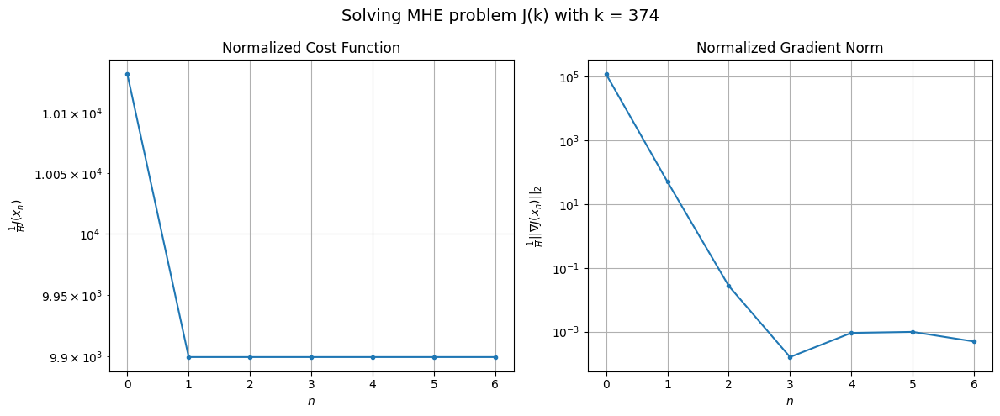

Windows:  94%|█████████▍| 336/356 [46:12<02:37,  7.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 406389.01803873805
Gradient norm: 4713148.662026557
Global estimation error: 64.60687317065175
Initial conditions estimation errors: 22.757685571676355 m, 34.55142709141884 m, 13.742353007490786 m, 47.680830215716696 m
Position estimation errors: 29.58876829038643 m, 16.7749358749461 m, 38.48587175625965 m, 5.097054799192977 m

[Gauss-Newton] Iteration 1
Cost function: 397368.0910004762 (-2.22%)
Gradient norm: 557.8835965645692 (-99.99%)
Global estimation error: 84.53131769898856 (30.84%)
Initial conditions estimation errors: 25.91104505191698 m, 44.55622179806686 m, 12.293523561535078 m, 65.86160445364406 m
Position estimation errors: 26.383948106100117 m, 7.013377907306536 m, 41.67323436034809 m, 18.749717867311393 m

[Gauss-Newton] Iteration 2
Cost function: 397368.0906647747 (-0.00%)
Gradient norm: 0.16957334534266733 (-99.97%)
Global estimation error: 84.6631072127068 (0.16%)
Initial conditions estimation errors: 25.91104

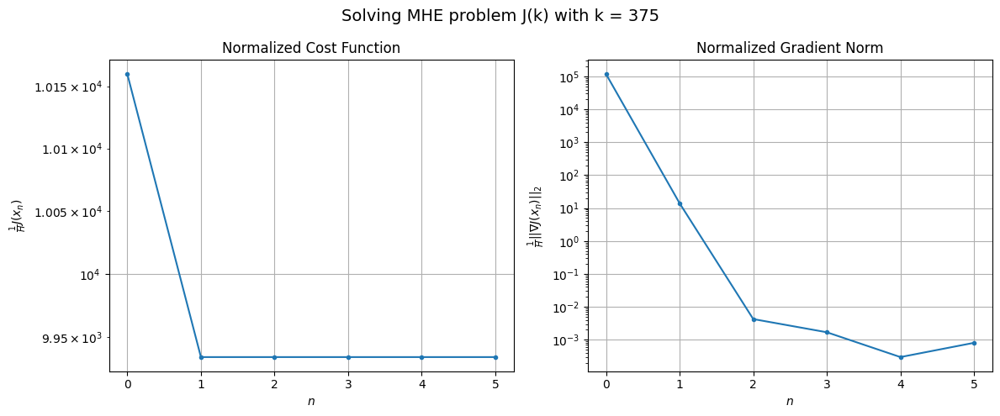

Windows:  95%|█████████▍| 337/356 [46:19<02:20,  7.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 406429.5260431186
Gradient norm: 4676129.870111583
Global estimation error: 78.88846319986368
Initial conditions estimation errors: 23.060301001909934 m, 41.58428208802539 m, 9.742458938968273 m, 62.18861368849724 m
Position estimation errors: 29.075017240069386 m, 9.30379907816306 m, 44.84323645790223 m, 17.272147979368746 m

[Gauss-Newton] Iteration 1
Cost function: 397690.35343824356 (-2.15%)
Gradient norm: 120.3084947799251 (-100.00%)
Global estimation error: 80.05081410816001 (1.47%)
Initial conditions estimation errors: 26.122674376129854 m, 43.58809825154839 m, 13.480975138470969 m, 60.366026957406795 m
Position estimation errors: 25.89490774467533 m, 5.881201440615914 m, 42.12109086403025 m, 20.14171767442306 m

[Gauss-Newton] Iteration 2
Cost function: 397690.3533843557 (-0.00%)
Gradient norm: 0.08511098607343942 (-99.93%)
Global estimation error: 80.0787304736729 (0.03%)
Initial conditions estimation errors: 26.12267

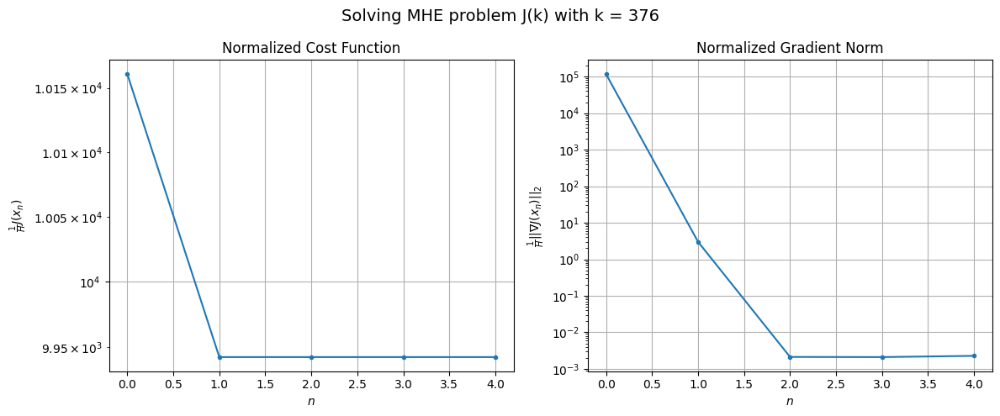

Windows:  95%|█████████▍| 338/356 [46:24<02:01,  6.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 404438.3611308305
Gradient norm: 4690512.87456112
Global estimation error: 73.76626256842871
Initial conditions estimation errors: 23.47551173686446 m, 40.29841578678473 m, 11.238431220733998 m, 56.03639358068859 m
Position estimation errors: 28.607522819634138 m, 8.34996125669307 m, 44.741888530853295 m, 17.830249660403776 m

[Gauss-Newton] Iteration 1
Cost function: 395887.3798216705 (-2.11%)
Gradient norm: 1730.8854774788063 (-99.96%)
Global estimation error: 58.566925609273426 (-20.60%)
Initial conditions estimation errors: 26.48867410154211 m, 31.58678603495291 m, 26.191162682097982 m, 32.32203321736646 m
Position estimation errors: 25.444066117446535 m, 16.096485056961846 m, 26.98728234173617 m, 9.263080595364338 m

[Gauss-Newton] Iteration 2
Cost function: 395887.3763147571 (-0.00%)
Gradient norm: 0.4970704600339756 (-99.97%)
Global estimation error: 58.39324752463225 (-0.30%)
Initial conditions estimation errors: 26.48

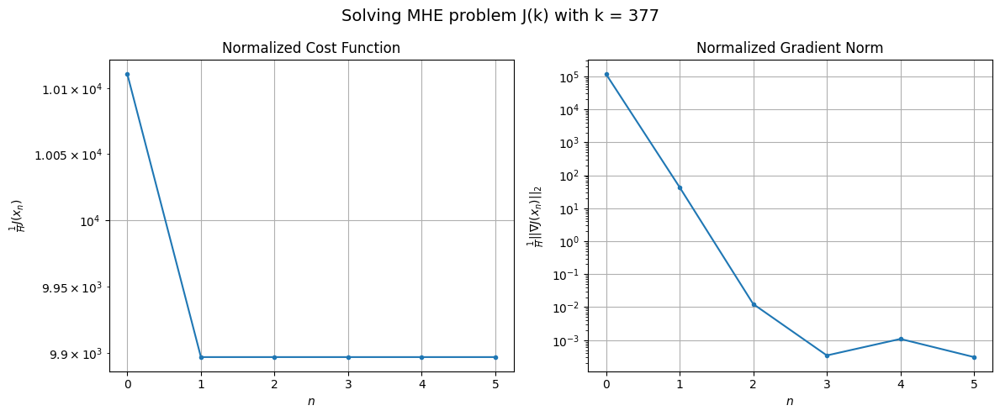

Windows:  95%|█████████▌| 339/356 [46:30<01:51,  6.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 400422.2330638723
Gradient norm: 4838748.541451209
Global estimation error: 52.45820696826919
Initial conditions estimation errors: 23.99473253164417 m, 28.330644390084625 m, 24.308967921688165 m, 27.974066819865488 m
Position estimation errors: 28.20453578626809 m, 19.42866458676132 m, 29.15422324058993 m, 13.460780642392299 m

[Gauss-Newton] Iteration 1
Cost function: 391764.8734926473 (-2.16%)
Gradient norm: 1424.511999185312 (-99.97%)
Global estimation error: 66.48581289304556 (26.74%)
Initial conditions estimation errors: 27.025919266649474 m, 36.71462608925235 m, 21.730103622387393 m, 43.24097782552193 m
Position estimation errors: 25.011816110690486 m, 8.912406965686863 m, 36.55774660618433 m, 12.281956854792194 m

[Gauss-Newton] Iteration 2
Cost function: 391764.87229570333 (-0.00%)
Gradient norm: 0.08650892776535944 (-99.99%)
Global estimation error: 66.53318877522987 (0.07%)
Initial conditions estimation errors: 27.0

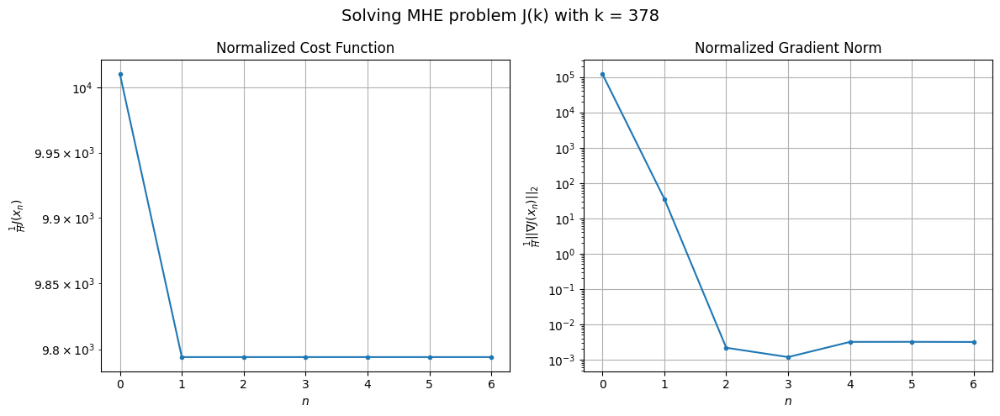

Windows:  96%|█████████▌| 340/356 [46:37<01:47,  6.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 394786.6277001975
Gradient norm: 5055657.973503553
Global estimation error: 59.88337436373022
Initial conditions estimation errors: 24.602658401844565 m, 33.26054577788966 m, 19.909471881435667 m, 38.445527418767234 m
Position estimation errors: 27.842154362907017 m, 12.246997624574885 m, 38.87670273447658 m, 10.788492956873837 m

[Gauss-Newton] Iteration 1
Cost function: 386185.2095741829 (-2.18%)
Gradient norm: 737.6225960119925 (-99.99%)
Global estimation error: 64.00468828989277 (6.88%)
Initial conditions estimation errors: 27.62781057263925 m, 33.2117809420276 m, 26.837836141401425 m, 38.858675962424286 m
Position estimation errors: 24.659794580836795 m, 14.78184430296767 m, 29.287069291220448 m, 7.664279982396353 m

[Gauss-Newton] Iteration 2
Cost function: 386185.209173166 (-0.00%)
Gradient norm: 0.043450714601636325 (-99.99%)
Global estimation error: 63.99734943597165 (-0.01%)
Initial conditions estimation errors: 27.6

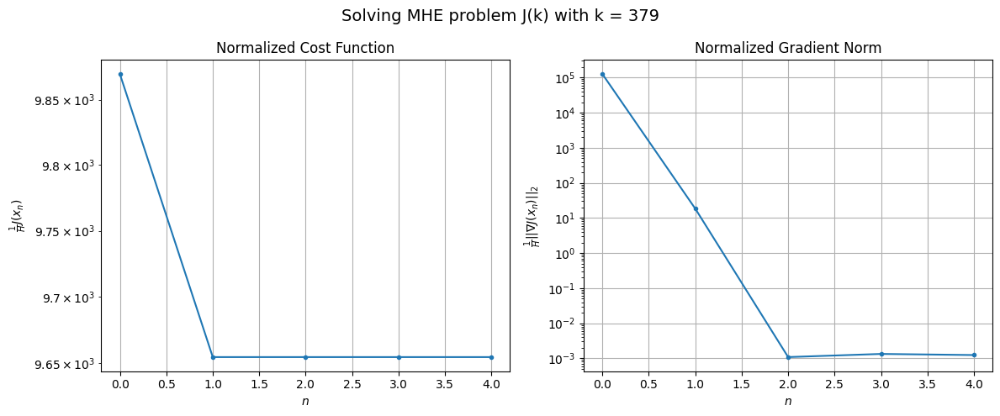

Windows:  96%|█████████▌| 341/356 [46:42<01:33,  6.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 385454.4483169591
Gradient norm: 5306471.226626897
Global estimation error: 58.04493138225969
Initial conditions estimation errors: 25.181420031948765 m, 30.00562050615498 m, 24.922585921902506 m, 34.837087253191356 m
Position estimation errors: 27.57472126681959 m, 18.30268969407582 m, 31.723849882030336 m, 10.868891219019053 m

[Gauss-Newton] Iteration 1
Cost function: 376722.54314994026 (-2.27%)
Gradient norm: 758.4590666997632 (-99.99%)
Global estimation error: 54.49154089000484 (-6.12%)
Initial conditions estimation errors: 28.23647333921374 m, 22.19968537594831 m, 38.567727469699314 m, 13.846262227564875 m
Position estimation errors: 24.376078072362343 m, 24.168186677340618 m, 21.013539826020494 m, 24.911919954048837 m

[Gauss-Newton] Iteration 2
Cost function: 376722.541550128 (-0.00%)
Gradient norm: 0.1723395253842903 (-99.98%)
Global estimation error: 54.539086052027784 (0.09%)
Initial conditions estimation errors: 28

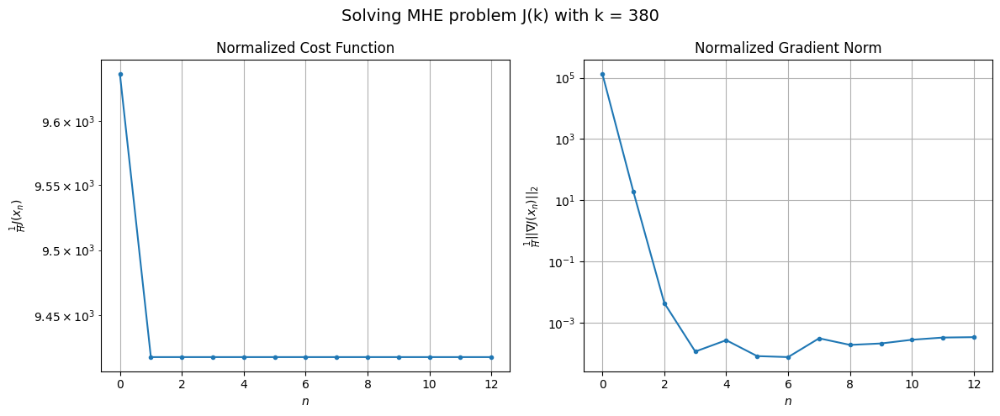

Windows:  96%|█████████▌| 342/356 [46:54<01:51,  7.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 375255.48755060486
Gradient norm: 5897284.110985934
Global estimation error: 49.6321739474596
Initial conditions estimation errors: 25.674413243174783 m, 19.137723703726426 m, 36.569494097231406 m, 10.029053042660935 m
Position estimation errors: 27.394051971738985 m, 27.871393610048273 m, 23.572234592851846 m, 29.460080494948528 m

[Gauss-Newton] Iteration 1
Cost function: 366336.64469100896 (-2.38%)
Gradient norm: 124.85344346876721 (-100.00%)
Global estimation error: 53.99121739068274 (8.78%)
Initial conditions estimation errors: 28.749556786243645 m, 25.65912369769336 m, 31.113710936911637 m, 21.4952552605307 m
Position estimation errors: 24.155528812894392 m, 23.01094621490868 m, 25.837515586033657 m, 20.721426575122713 m

[Gauss-Newton] Iteration 2
Cost function: 366336.64453690726 (-0.00%)
Gradient norm: 0.042106385020306204 (-99.97%)
Global estimation error: 54.0237225870575 (0.06%)
Initial conditions estimation errors

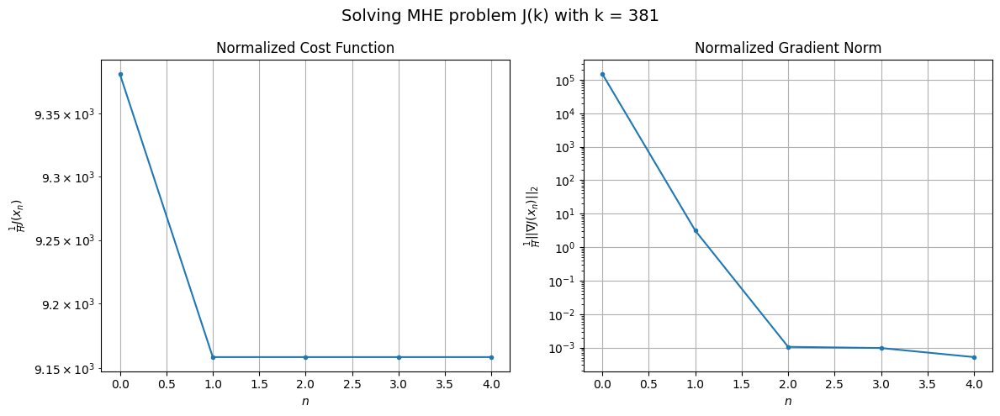

Windows:  96%|█████████▋| 343/356 [47:00<01:33,  7.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 362789.98800801166
Gradient norm: 6380110.522637819
Global estimation error: 48.17989577615936
Initial conditions estimation errors: 25.994242849584733 m, 22.485313118543864 m, 28.817360247101302 m, 17.594218805308255 m
Position estimation errors: 27.31115041126809 m, 26.564273154317817 m, 28.7304361375826 m, 25.175818132250818 m

[Gauss-Newton] Iteration 1
Cost function: 353885.16103280854 (-2.45%)
Gradient norm: 119.27202876555572 (-100.00%)
Global estimation error: 51.74457553916544 (7.40%)
Initial conditions estimation errors: 29.056457864031383 m, 19.5591447309652 m, 36.68829689490656 m, 10.228223273280273 m
Position estimation errors: 24.07435683251943 m, 28.110198276789465 m, 24.645092550297907 m, 30.232903265055402 m

[Gauss-Newton] Iteration 2
Cost function: 353885.16092934366 (-0.00%)
Gradient norm: 0.013712786888777055 (-99.99%)
Global estimation error: 51.743853198600625 (-0.00%)
Initial conditions estimation error

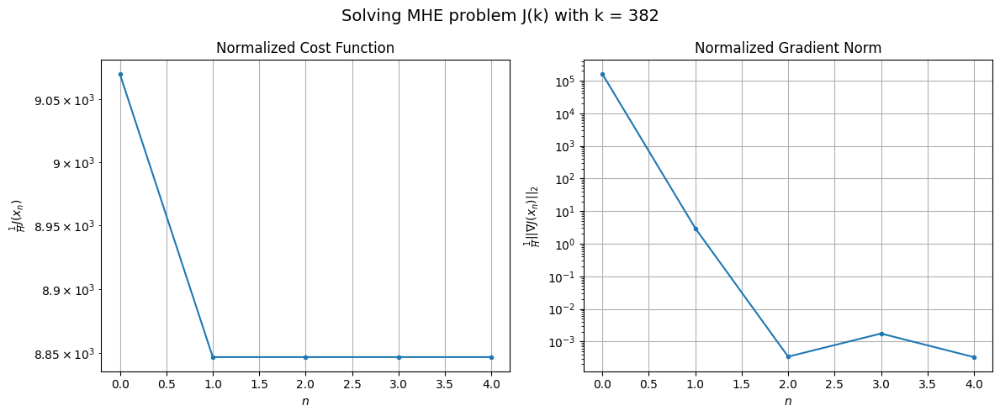

Windows:  97%|█████████▋| 344/356 [47:05<01:19,  6.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 349499.0884832248
Gradient norm: 7216290.902716921
Global estimation error: 46.676930224271615
Initial conditions estimation errors: 26.059285436012647 m, 16.255043647333462 m, 34.58961806034132 m, 6.242182868631951 m
Position estimation errors: 27.4120829737114 m, 32.08692957645035 m, 27.390296253760464 m, 35.170856760638415 m

[Gauss-Newton] Iteration 1
Cost function: 340330.6670485844 (-2.62%)
Gradient norm: 823.7744094997885 (-99.99%)
Global estimation error: 58.369608012034334 (25.05%)
Initial conditions estimation errors: 29.12972928796507 m, 9.015241889185415 m, 46.91932183430746 m, 16.605916148361512 m
Position estimation errors: 24.101129821423605 m, 38.26067439621752 m, 19.076278011702673 m, 53.36788163158048 m

[Gauss-Newton] Iteration 2
Cost function: 340330.6656789415 (-0.00%)
Gradient norm: 0.07310772483556947 (-99.99%)
Global estimation error: 58.51491339628348 (0.25%)
Initial conditions estimation errors: 29.12

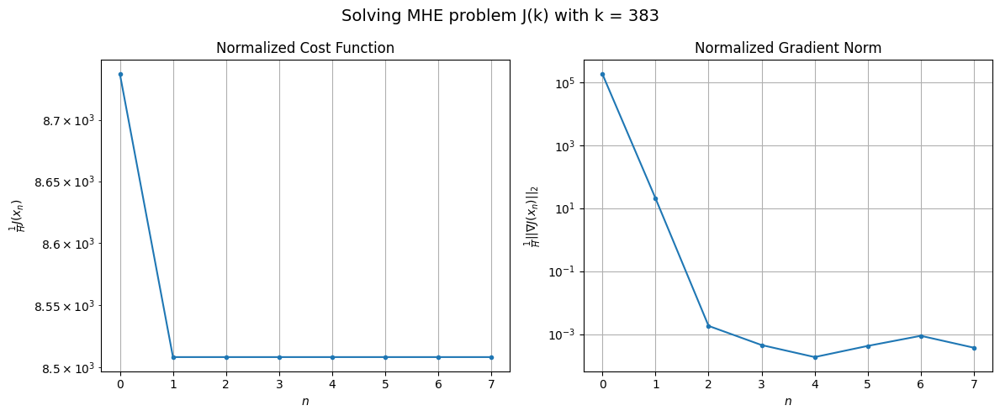

Windows:  97%|█████████▋| 345/356 [47:13<01:16,  6.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 335737.4619605823
Gradient norm: 7669760.452259975
Global estimation error: 56.11845040356986
Initial conditions estimation errors: 25.881091610549174 m, 6.555457451694792 m, 44.75957706226585 m, 20.809585007436393 m
Position estimation errors: 27.641296911079078 m, 42.68546448715149 m, 22.069768823905832 m, 59.005187512975475 m

[Gauss-Newton] Iteration 1
Cost function: 326579.5134859227 (-2.73%)
Gradient norm: 71.68062116802304 (-100.00%)
Global estimation error: 56.606012492693246 (0.87%)
Initial conditions estimation errors: 28.923786732655948 m, 9.489833545334573 m, 45.119857581626086 m, 15.549290079013884 m
Position estimation errors: 24.313777464454446 m, 40.451701970707816 m, 19.49556781372752 m, 57.23674101516573 m

[Gauss-Newton] Iteration 2
Cost function: 326579.51347633847 (-0.00%)
Gradient norm: 0.05312174635374655 (-99.93%)
Global estimation error: 56.62817402856695 (0.04%)
Initial conditions estimation errors: 2

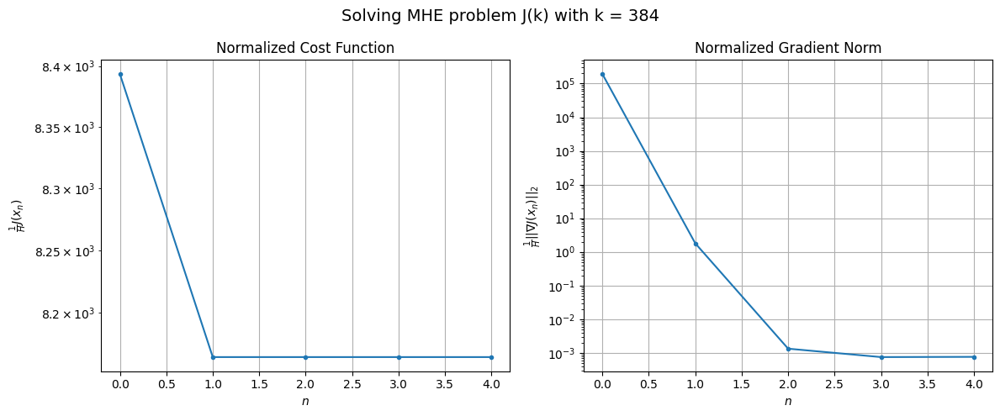

Windows:  97%|█████████▋| 346/356 [47:18<01:04,  6.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 323883.77260708273
Gradient norm: 8515074.223415436
Global estimation error: 53.582972082699705
Initial conditions estimation errors: 25.458632740771026 m, 7.231293511016714 m, 42.40632710146921 m, 19.297354870454438 m
Position estimation errors: 28.05868165605924 m, 44.65596979242718 m, 22.983673672613477 m, 62.209324657586535 m

[Gauss-Newton] Iteration 1
Cost function: 314676.58994823706 (-2.84%)
Gradient norm: 1565.0262808308908 (-99.98%)
Global estimation error: 53.64886214913264 (0.12%)
Initial conditions estimation errors: 28.465630367240824 m, 24.937023538267283 m, 27.124681334069084 m, 26.65123825807539 m
Position estimation errors: 24.678048958094323 m, 31.316100711145474 m, 25.337879230072314 m, 31.620490652697963 m

[Gauss-Newton] Iteration 2
Cost function: 314676.57016956125 (-0.00%)
Gradient norm: 0.5340885402009139 (-99.97%)
Global estimation error: 53.98677567375175 (0.63%)
Initial conditions estimation errors:

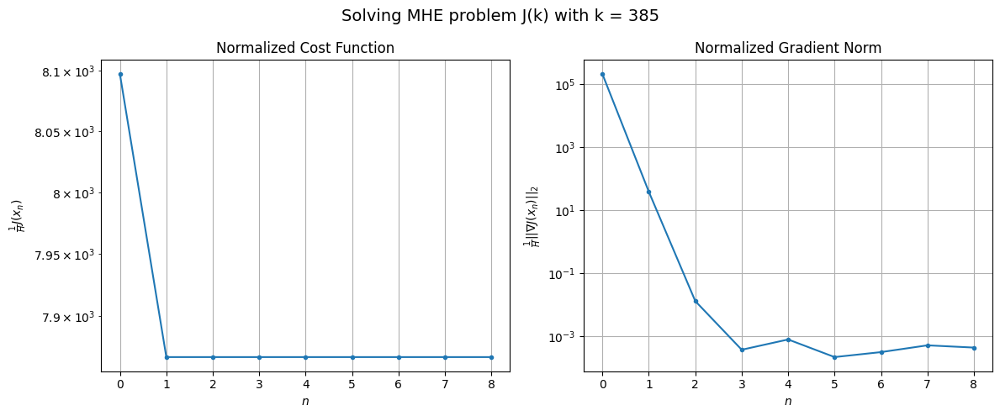

Windows:  97%|█████████▋| 347/356 [47:27<01:03,  7.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 314747.74134133576
Gradient norm: 9528651.350814117
Global estimation error: 47.48597691506105
Initial conditions estimation errors: 24.861144623856525 m, 22.276440941396064 m, 23.162843174773567 m, 24.577789272684107 m
Position estimation errors: 28.619398298632998 m, 34.580245968991115 m, 29.778214702458868 m, 34.42947677582131 m

[Gauss-Newton] Iteration 1
Cost function: 305533.9328746642 (-2.93%)
Gradient norm: 1926.5601014380636 (-99.98%)
Global estimation error: 90.80702011484328 (91.23%)
Initial conditions estimation errors: 27.813002920327037 m, 43.56093245585056 m, 7.639946256794482 m, 74.27254499419374 m
Position estimation errors: 25.17122460959701 m, 20.582249567926947 m, 32.854746480428034 m, 16.1894573728275 m

[Gauss-Newton] Iteration 2
Cost function: 305533.90541509015 (-0.00%)
Gradient norm: 0.29761194110117234 (-99.98%)
Global estimation error: 91.28721183769377 (0.53%)
Initial conditions estimation errors: 2

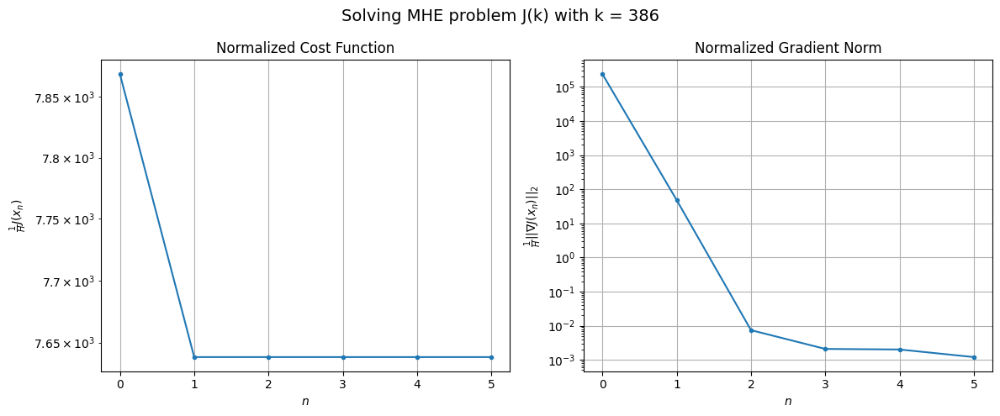

Windows:  98%|█████████▊| 348/356 [47:33<00:54,  6.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 310534.91003924253
Gradient norm: 10411845.461680733
Global estimation error: 86.82938953755516
Initial conditions estimation errors: 24.166734328669225 m, 41.051845317017566 m, 4.431975231333151 m, 72.45963248841335 m
Position estimation errors: 29.309016376245367 m, 23.554596614182223 m, 38.46056605921388 m, 19.793322322173786 m

[Gauss-Newton] Iteration 1
Cost function: 301225.2891437092 (-3.00%)
Gradient norm: 585.3169950742434 (-99.99%)
Global estimation error: 68.52977175450708 (-21.08%)
Initial conditions estimation errors: 27.08890934032363 m, 33.206064138890966 m, 15.218636480096226 m, 51.26649683826328 m
Position estimation errors: 25.778461086576318 m, 25.199812482959597 m, 33.302658429541594 m, 17.03966407608602 m

[Gauss-Newton] Iteration 2
Cost function: 301225.28597269056 (-0.00%)
Gradient norm: 0.09957349257663044 (-99.98%)
Global estimation error: 68.38331470270266 (-0.21%)
Initial conditions estimation errors

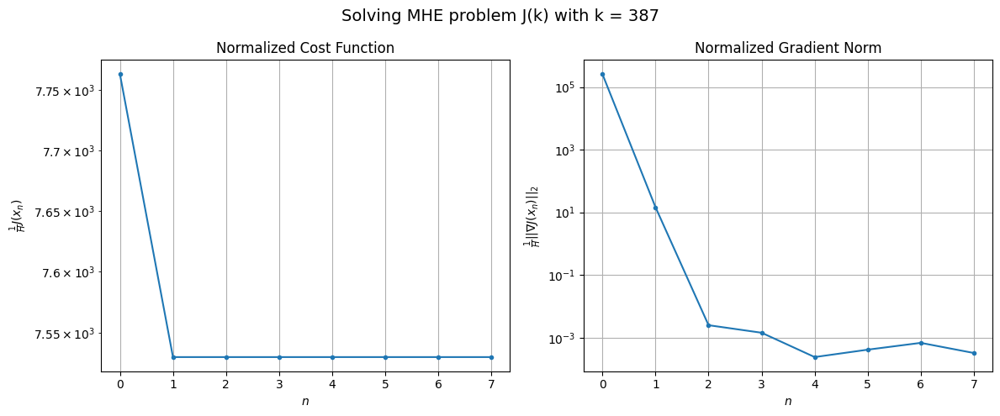

Windows:  98%|█████████▊| 349/356 [47:40<00:48,  6.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 310626.7133843036
Gradient norm: 11116931.323597135
Global estimation error: 62.40700368626579
Initial conditions estimation errors: 23.47682455817675 m, 30.05278578839787 m, 11.776829765241201 m, 47.97491448968022 m
Position estimation errors: 30.127182779281096 m, 29.075470469199974 m, 38.035577615190626 m, 21.08933323408949 m

[Gauss-Newton] Iteration 1
Cost function: 301148.41762031947 (-3.05%)
Gradient norm: 368.4974626560161 (-100.00%)
Global estimation error: 73.81608600628118 (18.28%)
Initial conditions estimation errors: 26.410880954056633 m, 37.25305030784409 m, 5.830642894200534 m, 57.70163035670051 m
Position estimation errors: 26.51393791475516 m, 25.076824662291486 m, 39.1250710374977 m, 18.183997743359935 m

[Gauss-Newton] Iteration 2
Cost function: 301148.4169258055 (-0.00%)
Gradient norm: 0.10079320901926586 (-99.97%)
Global estimation error: 73.54353949070804 (-0.37%)
Initial conditions estimation errors: 26.

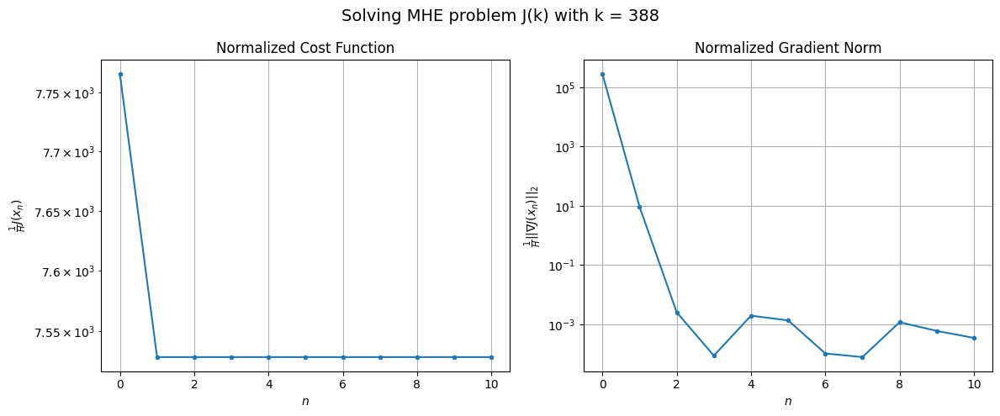

Windows:  98%|█████████▊| 350/356 [47:50<00:47,  7.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 314394.5095319792
Gradient norm: 11809802.434799042
Global estimation error: 69.074090088352
Initial conditions estimation errors: 22.86003080805333 m, 34.44105536916941 m, 5.3431978423589275 m, 55.08082959955624 m
Position estimation errors: 31.096005127093395 m, 28.68096166817541 m, 44.27176686097953 m, 22.055752663969223 m

[Gauss-Newton] Iteration 1
Cost function: 304740.36565361917 (-3.07%)
Gradient norm: 96.49878245207144 (-100.00%)
Global estimation error: 75.18233131641827 (8.84%)
Initial conditions estimation errors: 25.8420668502377 m, 38.621423416961875 m, 6.694163757306662 m, 58.72076646183558 m
Position estimation errors: 27.412904899893856 m, 22.61199009562036 m, 42.23493314294145 m, 18.263984416183252 m

[Gauss-Newton] Iteration 2
Cost function: 304740.3656368917 (-0.00%)
Gradient norm: 0.08548261537127584 (-99.91%)
Global estimation error: 75.24339921960481 (0.08%)
Initial conditions estimation errors: 25.84206

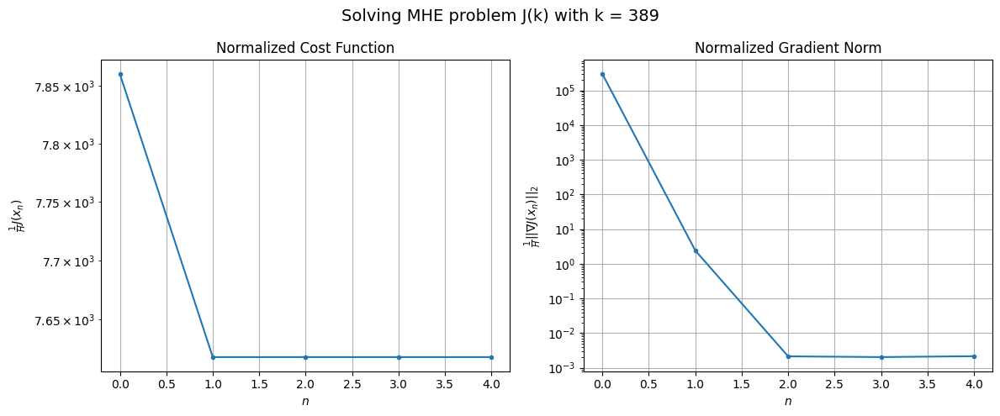

Windows:  99%|█████████▊| 351/356 [47:56<00:35,  7.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 323757.3820320837
Gradient norm: 12942208.695946854
Global estimation error: 70.35307532985124
Initial conditions estimation errors: 22.336246453735633 m, 35.70091551080939 m, 7.180053478776418 m, 55.897433962368794 m
Position estimation errors: 32.25855571798784 m, 26.645132580147866 m, 47.52649250864252 m, 22.638785689758805 m

[Gauss-Newton] Iteration 1
Cost function: 313516.5624353174 (-3.16%)
Gradient norm: 328.86654047130816 (-100.00%)
Global estimation error: 63.69288226078177 (-9.47%)
Initial conditions estimation errors: 25.426041329331426 m, 36.742480010027585 m, 10.242946753412 m, 44.21939724489936 m
Position estimation errors: 28.41489685906568 m, 21.865206503759765 m, 43.50222307155655 m, 20.70223440597798 m

[Gauss-Newton] Iteration 2
Cost function: 313516.5619327593 (-0.00%)
Gradient norm: 0.02388625616844253 (-99.99%)
Global estimation error: 63.57449950365848 (-0.19%)
Initial conditions estimation errors: 25.4

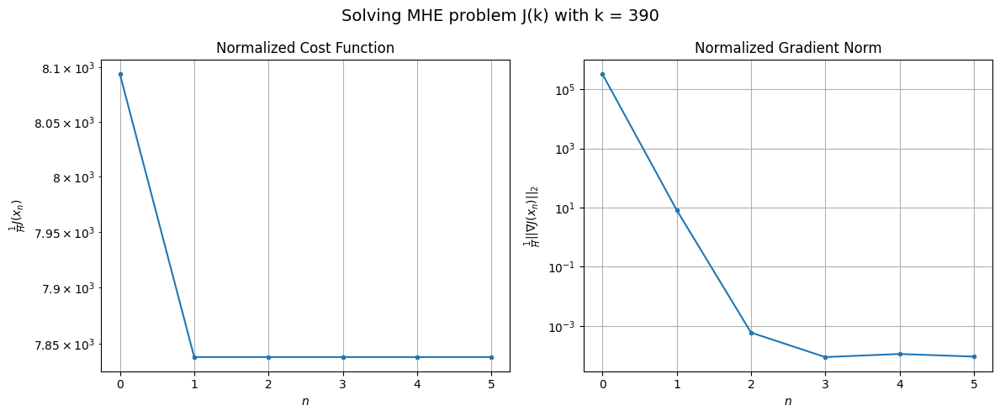

Windows:  99%|█████████▉| 352/356 [48:01<00:26,  6.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 337129.3704314437
Gradient norm: 14001486.158210263
Global estimation error: 57.527552562357
Initial conditions estimation errors: 21.927074051936597 m, 33.18294912420939 m, 8.781000164102501 m, 40.625016192279105 m
Position estimation errors: 33.554012999769505 m, 26.88522759573823 m, 48.326464990852806 m, 25.83074004837005 m

[Gauss-Newton] Iteration 1
Cost function: 326320.2055371819 (-3.21%)
Gradient norm: 2404.682756729147 (-99.98%)
Global estimation error: 91.63714826642106 (59.29%)
Initial conditions estimation errors: 25.147953353780185 m, 48.37073667950173 m, 18.036566626712673 m, 71.41348699826698 m
Position estimation errors: 29.559962453597556 m, 21.878251498671414 m, 50.83006725850158 m, 20.97636251022149 m

[Gauss-Newton] Iteration 2
Cost function: 326320.17114287906 (-0.00%)
Gradient norm: 0.21434149859612497 (-99.99%)
Global estimation error: 91.55735389873942 (-0.09%)
Initial conditions estimation errors: 25.1

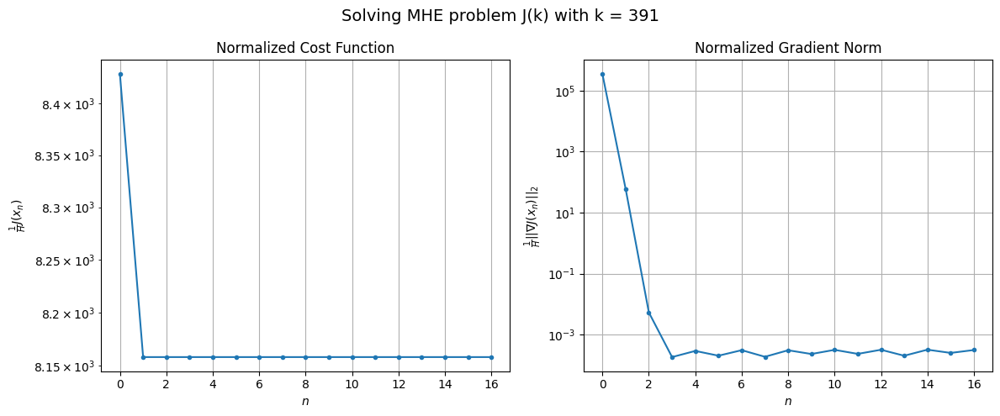

Windows:  99%|█████████▉| 353/356 [48:17<00:28,  9.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 355649.09362283256
Gradient norm: 15374942.797083462
Global estimation error: 89.09519238667805
Initial conditions estimation errors: 21.61994134973883 m, 45.93616288076356 m, 22.24431623825039 m, 69.75367667222545 m
Position estimation errors: 35.027458406576294 m, 26.416157410831406 m, 56.93092878193623 m, 26.21537065700033 m

[Gauss-Newton] Iteration 1
Cost function: 343952.1076336602 (-3.29%)
Gradient norm: 3532.7660182390405 (-99.98%)
Global estimation error: 46.147568463181614 (-48.20%)
Initial conditions estimation errors: 25.017328823969546 m, 26.652585103426873 m, 15.381445801757305 m, 23.59586587260109 m
Position estimation errors: 30.819121315864695 m, 29.563760145167077 m, 44.604178594127 m, 32.00352528102272 m

[Gauss-Newton] Iteration 2
Cost function: 343951.99607931514 (-0.00%)
Gradient norm: 0.05512125552713861 (-100.00%)
Global estimation error: 46.25619363254528 (0.24%)
Initial conditions estimation errors: 2

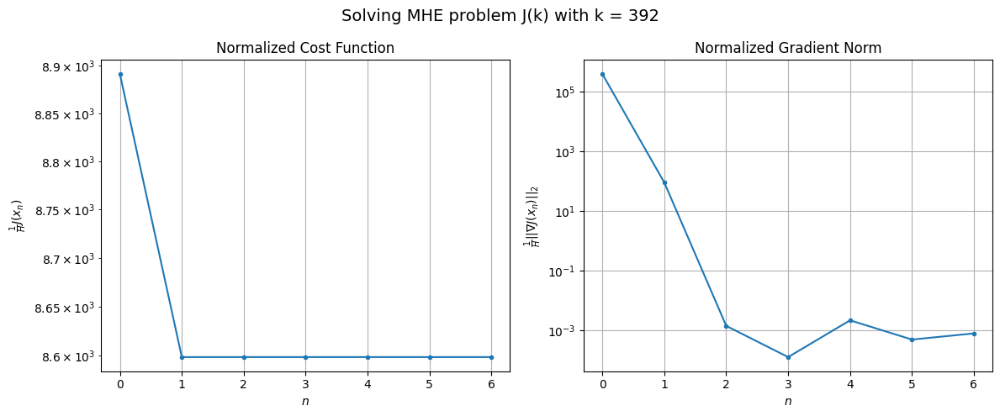

Windows:  99%|█████████▉| 354/356 [48:25<00:17,  8.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379503.59630218707
Gradient norm: 16680339.65801909
Global estimation error: 39.635841332850184
Initial conditions estimation errors: 21.425634152234657 m, 23.111601227236548 m, 12.910482250539001 m, 20.27555745621415 m
Position estimation errors: 36.64848376633259 m, 35.37709821393297 m, 49.19458653241177 m, 37.53978472126111 m

[Gauss-Newton] Iteration 1
Cost function: 366758.9624822167 (-3.36%)
Gradient norm: 1181.697227341587 (-99.99%)
Global estimation error: 45.62711844154928 (15.12%)
Initial conditions estimation errors: 25.012538869430262 m, 20.569414721668682 m, 29.10920282580459 m, 13.62854684437202 m
Position estimation errors: 32.197960243938105 m, 29.335728313607444 m, 39.68331618713192 m, 29.967025795887178 m

[Gauss-Newton] Iteration 2
Cost function: 366758.95703134744 (-0.00%)
Gradient norm: 0.07208472086260097 (-99.99%)
Global estimation error: 45.60503767110139 (-0.05%)
Initial conditions estimation errors: 2

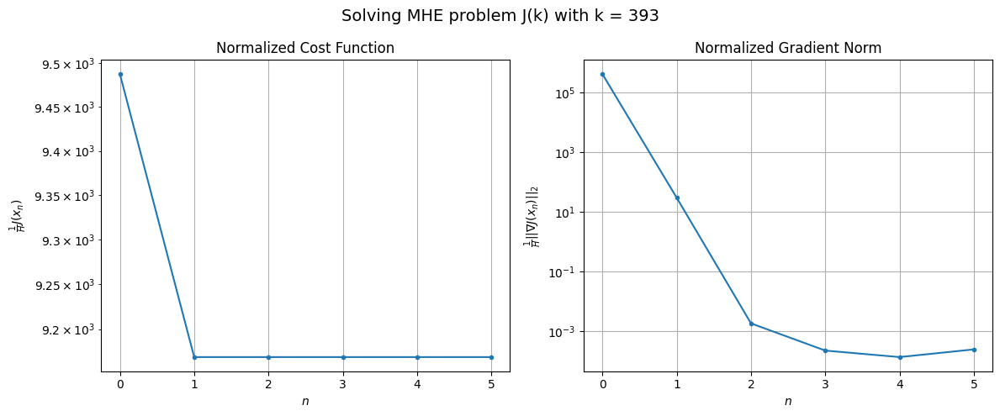

Windows: 100%|█████████▉| 355/356 [48:31<00:08,  8.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 409381.50221087434
Gradient norm: 18244959.520250406
Global estimation error: 39.3450694041594
Initial conditions estimation errors: 21.336993738519272 m, 16.261879139009036 m, 26.927990505971287 m, 10.15773799603069 m
Position estimation errors: 38.42499755889025 m, 36.21297253046033 m, 44.12516549962005 m, 37.2999076018972 m

[Gauss-Newton] Iteration 1
Cost function: 395432.0343796849 (-3.41%)
Gradient norm: 271.44326783964283 (-100.00%)
Global estimation error: 41.544598385448644 (5.59%)
Initial conditions estimation errors: 25.07924093692906 m, 18.027381536721688 m, 24.48106027906132 m, 13.139837284330293 m
Position estimation errors: 33.681915664371104 m, 35.94534591520143 m, 46.711047030938445 m, 41.14262989224363 m

[Gauss-Newton] Iteration 2
Cost function: 395432.03432637535 (-0.00%)
Gradient norm: 0.09886796602610323 (-99.96%)
Global estimation error: 41.52390303273839 (-0.05%)
Initial conditions estimation errors: 25

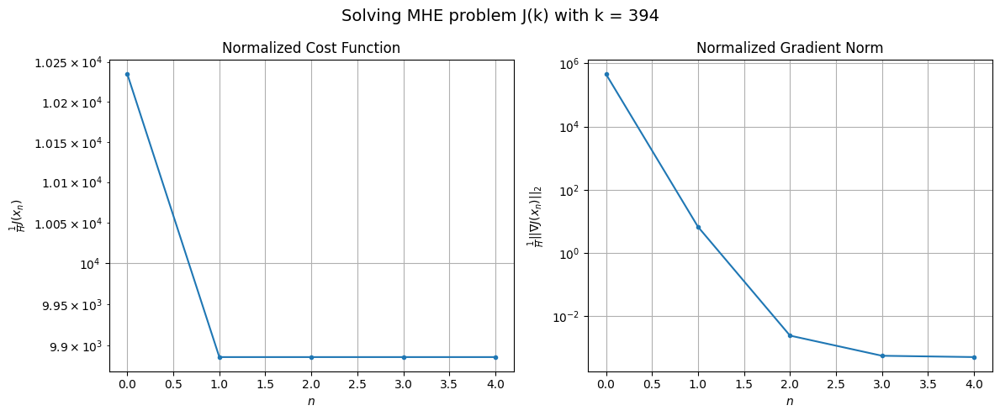

This Monte Carlo run RMSE for 356 timestamps:
RMSE_1 = 31.698493396992923
RMSE_2 = 31.116423532271593
RMSE_3 = 32.77130106774887
RMSE_4 = 35.08426822204884
CentralizedNewton applied to J(H - 1) converged with [] iterations.
CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with nan iterations on average.


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [7]:
first_round_stop_iteration = []
K_minus_H_next_rounds_stop_iteration = []

# Cold-start
x_init = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))

# Apply the algorithm
X_est = np.zeros((n, 1, K))
for k in tqdm(range(H - 1, K), desc="Windows", leave=False):
    centralized_newton.cost_values, centralized_newton.gradient_norm_values = [], []
    x_init, x_est = centralized_newton.solve_MHE_problem(k, dt, Y, x_init, X_true[:, :, k - H + 1],  X_true[:, :, k])
    X_est[:, :, k] = x_est
    
    plots(k, centralized_newton)

    # Warm-start
    x_init = dyn.f(dt, x_init)

# After each Monte Carlo Run compute the RMSE_m for each K - H + 1 timestamps
position_estimation_error_1, position_estimation_error_2, position_estimation_error_3, position_estimation_error_4 = [], [], [], []
for k in range(H - 1, K):
    position_estimation_error_1.append(np.linalg.norm(X_est[:n_p, :, k] - X_true[:n_p, :, k]))
    position_estimation_error_2.append(np.linalg.norm(X_est[n_x:n_x + n_p, :, k] - X_true[n_x:n_x + n_p, :, k]))
    position_estimation_error_3.append(np.linalg.norm(X_est[2*n_x:2*n_x + n_p, :, k] - X_true[2*n_x:2*n_x + n_p, :, k]))
    position_estimation_error_4.append(np.linalg.norm(X_est[3*n_x:3*n_x + n_p, :, k] - X_true[3*n_x:3*n_x + n_p, :, k]))
rmse_1 = np.sqrt(np.mean(np.array(position_estimation_error_1) ** 2))
rmse_2 = np.sqrt(np.mean(np.array(position_estimation_error_2) ** 2))
rmse_3 = np.sqrt(np.mean(np.array(position_estimation_error_3) ** 2))
rmse_4 = np.sqrt(np.mean(np.array(position_estimation_error_4) ** 2))
print(f'This Monte Carlo run RMSE for {K - H + 1} timestamps:')
print(f'RMSE_1 = {np.mean(rmse_1)}\nRMSE_2 = {np.mean(rmse_2)}\nRMSE_3 = {np.mean(rmse_3)}\nRMSE_4 = {np.mean(rmse_4)}')
print(f'CentralizedNewton applied to J(H - 1) converged with {first_round_stop_iteration} iterations.')
print(f'CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with {np.mean(K_minus_H_next_rounds_stop_iteration)} iterations on average.')

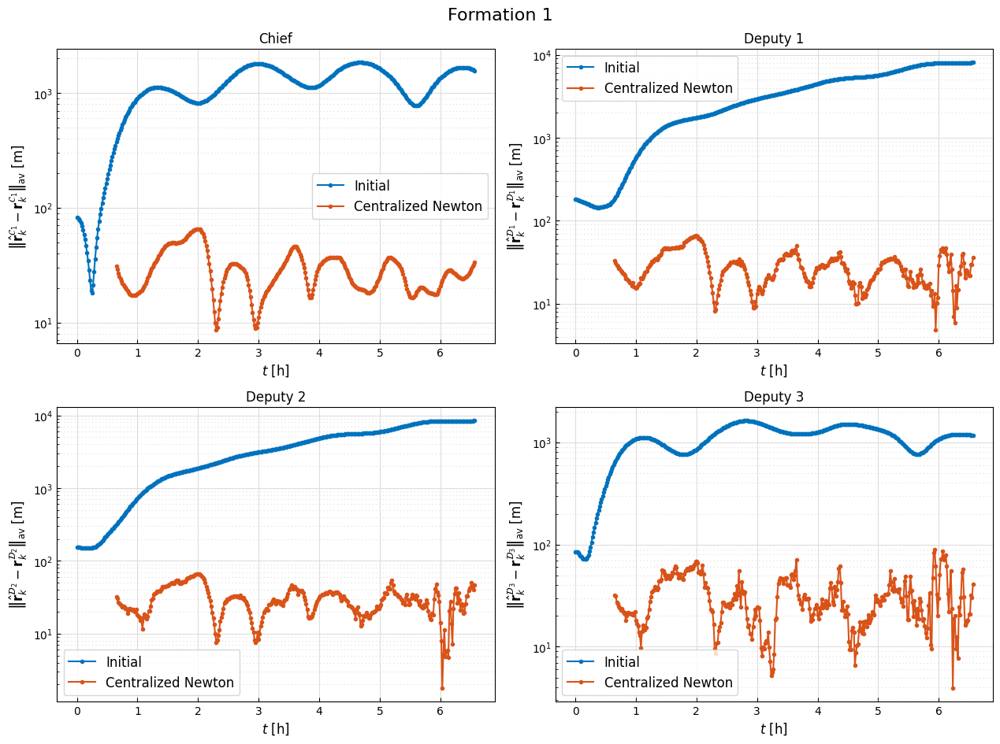

In [8]:
# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, K) / dt
algorithm = "Centralized Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, position_estimation_error_1_initial, ".-", label="Initial")
axs[0, 0].plot(time[H - 1:], position_estimation_error_1, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, position_estimation_error_2_initial, ".-", label="Initial")
axs[0, 1].plot(time[H - 1:], position_estimation_error_2, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, position_estimation_error_3_initial, ".-", label="Initial")
axs[1, 0].plot(time[H - 1:], position_estimation_error_3, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, position_estimation_error_4_initial, ".-", label="Initial")
axs[1, 1].plot(time[H - 1:], position_estimation_error_4, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [9]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["H"] = H
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(f'gauss_newton_H{H}_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl', "wb") as file:
    pickle.dump(data, file)